In [1]:
%matplotlib notebook
import os, sys, inspect, warnings
curr_dir = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe()))) # script directory
main_dir = '/'.join(curr_dir.split('/')[:-1])
sub_dir = os.path.join(main_dir, 'RGCPD/')
# core_pp = os.path.join(main_dir, 'RGCPD/core')
if main_dir not in sys.path:
    sys.path.append(main_dir)
    sys.path.append(sub_dir)
import numpy as np
import math
from pathlib import Path
from collections import Counter
import statsmodels.api as sm 
import pandas as pd 
import math
import matplotlib.pyplot as plt 
plt.rcParams['figure.figsize'] = (15.0, 8.0)
import itertools as it
import pywt as wv
from scipy.fft import fft, fftfreq
from scipy.special import chdtri
from copy import deepcopy
from statsmodels.tsa.arima_process import  arma_generate_sample, ArmaProcess
from pprint import pprint as pp 
from pandas.plotting import register_matplotlib_converters
from RGCPD import RGCPD
from RGCPD import BivariateMI
from df_ana_class import DataFrameAnalysis, VisualizeAnalysis
import core_pp
from plot_signal_decomp import *
from plot_coeffs import * 
import wave_ana as wa 
register_matplotlib_converters()
plt.style.use('seaborn')

Could not import rpy package
Could not import r-package RCIT


# Preparing RGCPD 

In [2]:
path_data = os.path.join(main_dir, 'data')
current_analysis_path = os.path.join(main_dir, 'Jier_analysis')
target= 3
target_path = os.path.join(path_data, 'tf5_nc5_dendo_80d77.nc')
precursor_path = os.path.join(path_data,'sst_1979-2018_2.5deg_Pacific.nc')
list_of_name_path = [(target, target_path), 
                    ('sst', precursor_path )]
list_for_MI = [BivariateMI(name='sst', func=BivariateMI.corr_map, 
                          kwrgs_func={'alpha':.0001, 'FDR_control':True}, 
                          distance_eps=700, min_area_in_degrees2=5)]
rg = RGCPD(list_of_name_path=list_of_name_path,
           list_for_MI=list_for_MI,
           start_end_TVdate=('06-01', '08-31'),
           path_outmain=os.path.join(current_analysis_path,'tigramite_output'),
           append_pathsub='baseline')

## Setting up sampling frequency

In [3]:
rg.pp_precursors(detrend=True, anomaly=True, selbox=None)
rg.pp_TV()
rg.traintest(method='no_train_test_split')
rg.calc_corr_maps()
rg.cluster_list_MI()
rg.get_ts_prec(precur_aggr=1)

Loaded pre-processed data of sst

original tfreq of imported response variable is converted to desired tfreq 10
Daily input freq
No train test split

sst - calculating correlation maps
Progress traintest set 100%, trainsize=(400dp, 100%)

redefine target variable on 1 day means
Selecting subset as defined by start_end_date
Daily input freq
No train test split

Getting MI timeseries
There are [2] regions in total (list of different splits)


## Defining alpha and tau_max

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


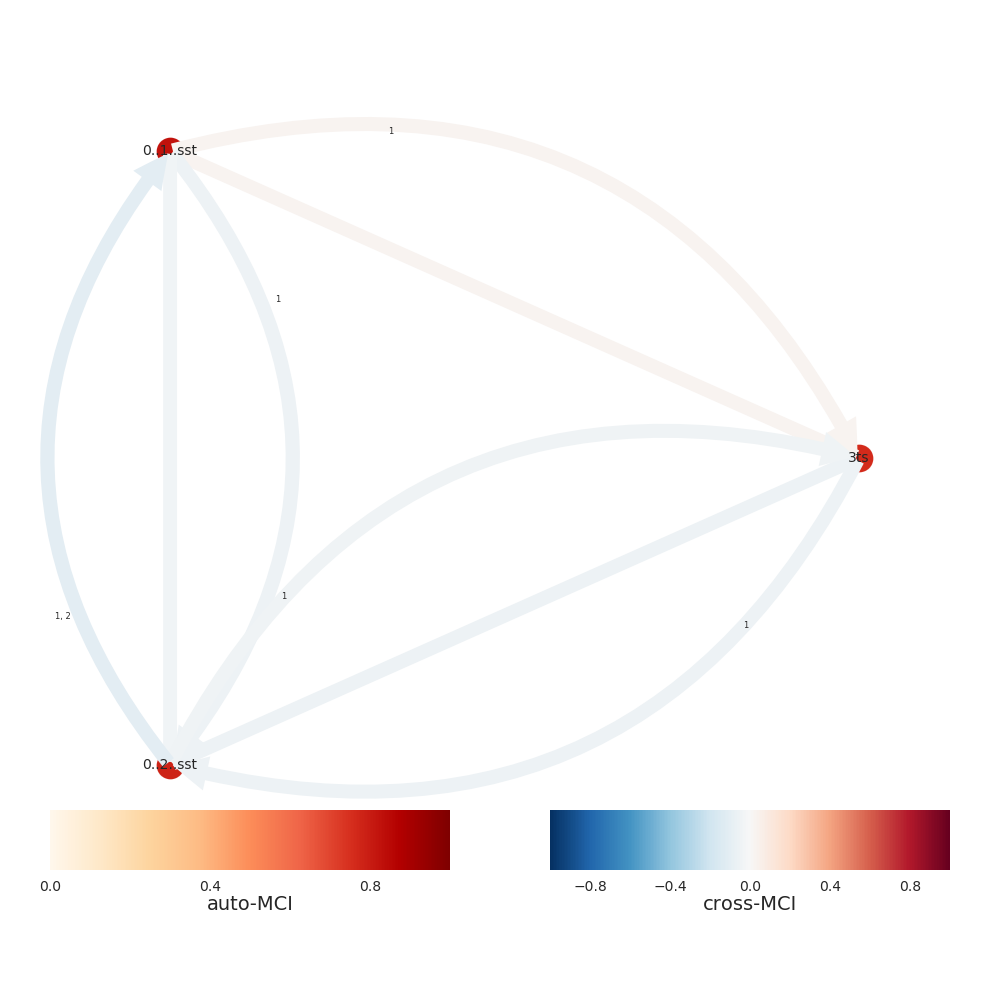

In [4]:
rg.PCMCI_df_data(tau_max=2, pc_alpha=0.05)
rg.PCMCI_get_links()
rg.df_MCIc
rg.PCMCI_plot_graph()

## Extracting data from RGCPD

In [5]:
rg_data  = rg.df_data.loc[:,rg.df_data.columns[rg.df_data.dtypes != bool]]
rg_index = rg_data.index.levels[1]
prec1_arr, prec2_arr = None, None
prec_list_arr = None
if len(rg_data.columns[1:].tolist()) == 2:    
    prec1_arr = rg_data.iloc[:,1].values
    prec2_arr = rg_data.iloc[:,2].values
more_precursors = False 
if len(rg_data.columns[1:].tolist()) > 2:
    more_precursors = True
    prec_list_arr = [rg_data.iloc[:,i].values
      for i in range(1, len(rg_data.columns[1:].tolist())+1)
      if len(rg_data.columns[1:].tolist()) > 2 ]

target_arr = rg_data.iloc[:,0].values
target_df = rg_data.iloc[:,0]

# Wavelet

## Choice wavelet

In [6]:
Path('Report/Wavelet/Methods/').mkdir(parents=True, exist_ok=True)
Path('Report/Wavelet/Experiment_vanilla/').mkdir(parents=True, exist_ok=True)
Path('Report/Wavelet/Experiment_sensitivity/').mkdir(parents=True, exist_ok=True)

### Set up wave type to MODWT/DWT

In [6]:
la8 = wa.create_least_asymmetric_filter(mode='dwt')
la8_modwt = wa.create_least_asymmetric_filter()
waves = ['sym2', 'sym4', 'sym8', la8]

### Visualize MRA function

In [7]:

def plot_dwt_default(data, w, title, level, mode, method='wavedec'):

    assert isinstance(w, wv.Wavelet)
    a = data
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        print(f"Appropriate level is changed to {level}")
    else:
        level_ = None
        
    if method == 'coeff':
        plot_coeffs(data, w, mode, title, level)
        return
    elif method =='recon':
        plot_signal_decomp(data, w, mode, title, level)
        return
    elif method =='modwt':
        plot_modwt(data, w, title, level)
        return
    else:
        coeffs =  wv.wavedec(a, w, level=level, mode=mode)

        ylim = [a.min(), a.max()]

        fig, axes = plt.subplots(len(coeffs) + 1, figsize=(10, 8), constrained_layout=True)
        axes[0].set_title(title)
        axes[0].plot(a, 'k', label='Original signal')
        axes[0].set_ylabel(r'C$^{\circ}$')
        axes[0].set_xlim(0, len(a) - 1)
        axes[0].set_ylim(ylim[0], ylim[1])
        axes[0].legend(loc=0)

        for i, _ in enumerate(coeffs):
            ax = axes[-i - 1]
            if i == 0:
                ax.set_ylabel("A%d" % (len(coeffs) - 1))
                ax.plot( coeffs[i], 'r')
            else:
                ax.set_ylabel("D%d" % (len(coeffs) - i))
                ax.plot( coeffs[i], 'g')

<IPython.core.display.Javascript object>


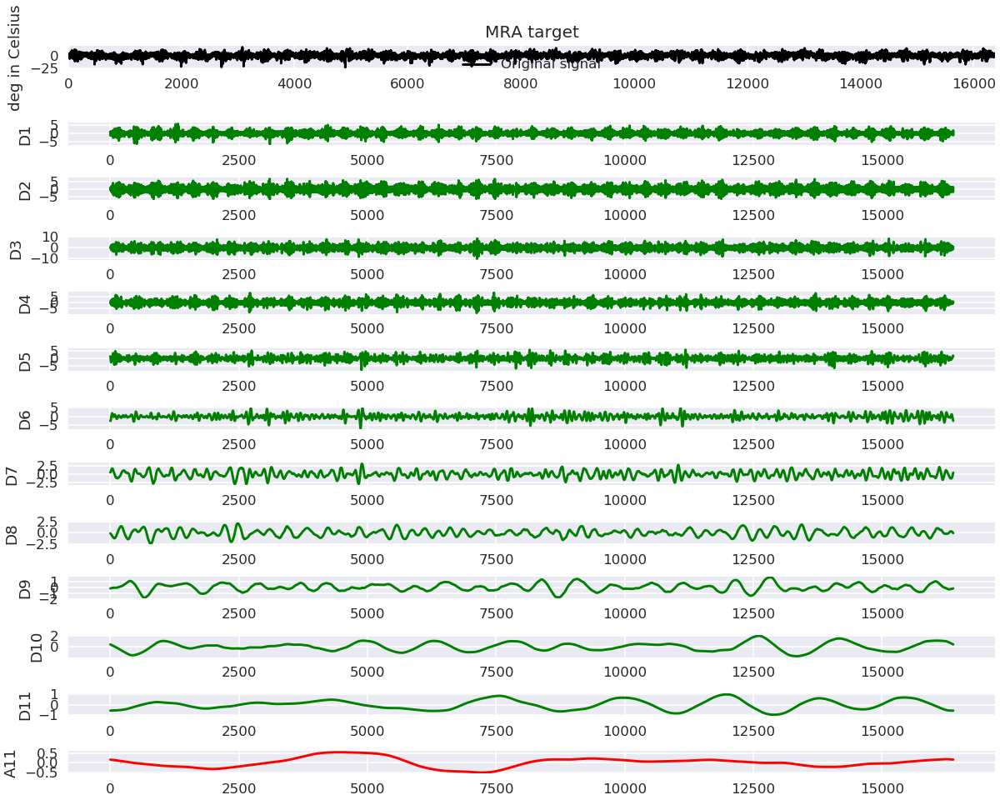

In [17]:
plot_dwt_default(data=target_arr, w=la8_modwt, title='MRA target', level=11, mode='periodic', method='modwt')

<IPython.core.display.Javascript object>


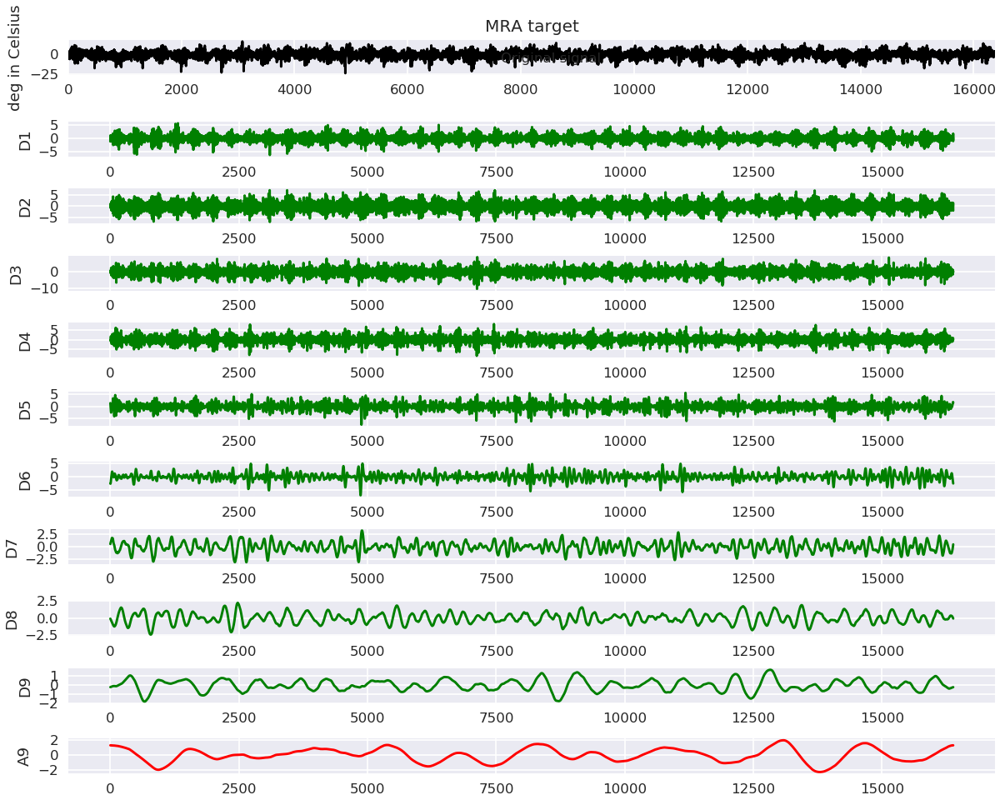

In [18]:
plot_dwt_default(data=target_arr, w=la8, title='MRA target', level=9, mode='periodic', method='modwt')

### Show evolution wavelet and scale function during MRA

In [8]:
def wave_info(wavelet, level, figsize=(9, 8), debug=False):
    data = wavelet.wavefun(level)
    if len(data) == 2:
        x = data[1]
        psi = data[0]
        fig = plt.figure(figsize=figsize, constrained_layout=True)
        axis  = []
        if wavelet.complex_cwt:
            ax1 =fig.add_subplot(211)
            ax1.set_title(wavelet.name+' real part')
            mi, ma = np.real(psi).min(), np.real(psi).max()
            margin = (ma - mi) * 0.05
            ax1.plot(x,np.real(psi))
            ax1.set_ylim(mi - margin, ma + margin)
            ax1.set_xlim(x[0], x[-1])
            axis.append(ax1)
            ax2 = fig.add_subplot(212)
            ax2.set_title(wavelet.name+' imag part')
            mi, ma = np.imag(psi).min(), np.imag(psi).max()
            margin = (ma - mi) * 0.05
            ax2.plot(x,np.imag(psi))
            ax2.set_ylim(mi - margin, ma + margin)
            ax2.set_xlim(x[0], x[-1])
            axis.append(ax2)
        else:
            mi, ma = psi.min(), psi.max()
            margin = (ma - mi) * 0.05
            ax = fig.add_subplot(111)
            ax.plot(x,psi)
            ax.set_title(wavelet.name)
            ax.set_ylim(mi - margin, ma + margin)
            ax.set_xlim(x[0], x[-1])
            axis.append(ax)
        if not debug:
            return ax
        else:
            plt.show()
    else:
        funcs, x = data[:-1], data[-1]
        labels = [r"Scaling function $\phi$", r"Wavelet function $\psi$",
                  "r. scaling function (phi)", "r. wavelet function (psi)"]
        colors = ("r", "g", "r", "g")
        fig = plt.figure(figsize=figsize, constrained_layout=True)
        axis = []
        for i, (d, label, color) in enumerate(zip(funcs, labels, colors)):
            mi, ma = d.min(), d.max()
            margin = (ma - mi) * 0.05
            ax = fig.add_subplot((len(data) - 1) // 2, 2, 1 + i)

            ax.plot(x, d, color, label='Level '+str(level-1))
            ax.set_title(label)
            ax.set_ylim(mi - margin, ma + margin)
            ax.set_xlim(x[0], x[-1])
            ax.set_xlabel('Length filter')
            ax.legend(loc=0)
            axis.append(ax)

        if not debug:
            return axis
        else:
            plt.show()

In [9]:
def show_evolution_wavelet(wavelet, levels,title="Evolution wavelet", figsize=(9, 8), intermediate=False):
    output = [wave_info(wavelet, i, figsize, debug=False) for i in range(1, levels+1)]
    if intermediate:
        output[0][0]
        output[-1][-1]
        plt.show()
    else:
        for i, ax in enumerate(output):
            ax[i]
        plt.show()   

<IPython.core.display.Javascript object>


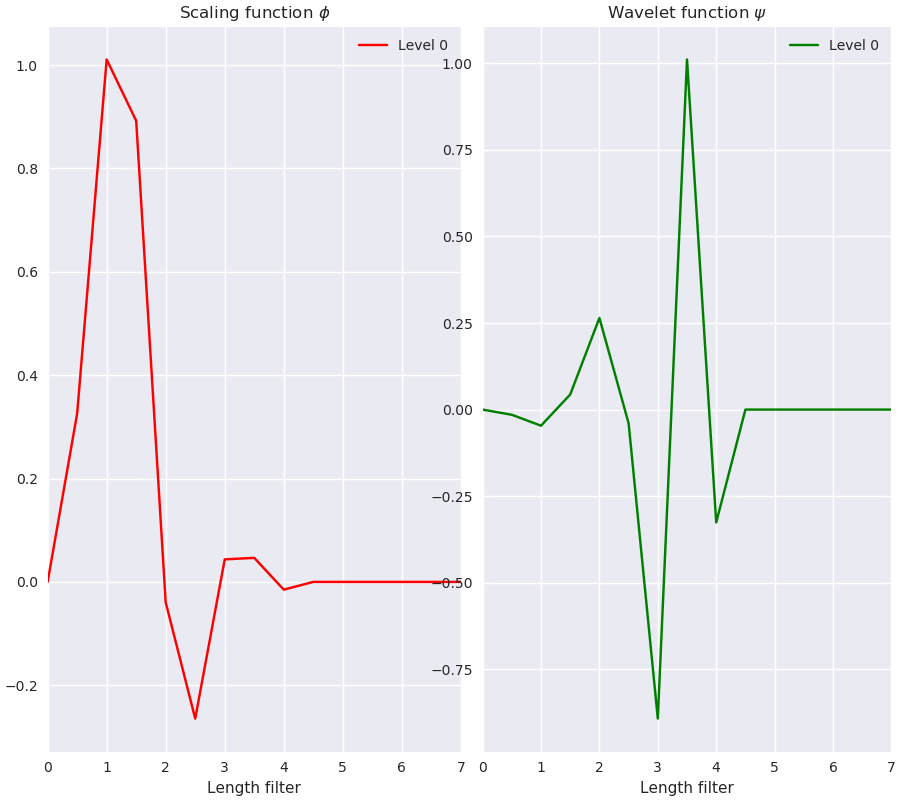

<IPython.core.display.Javascript object>


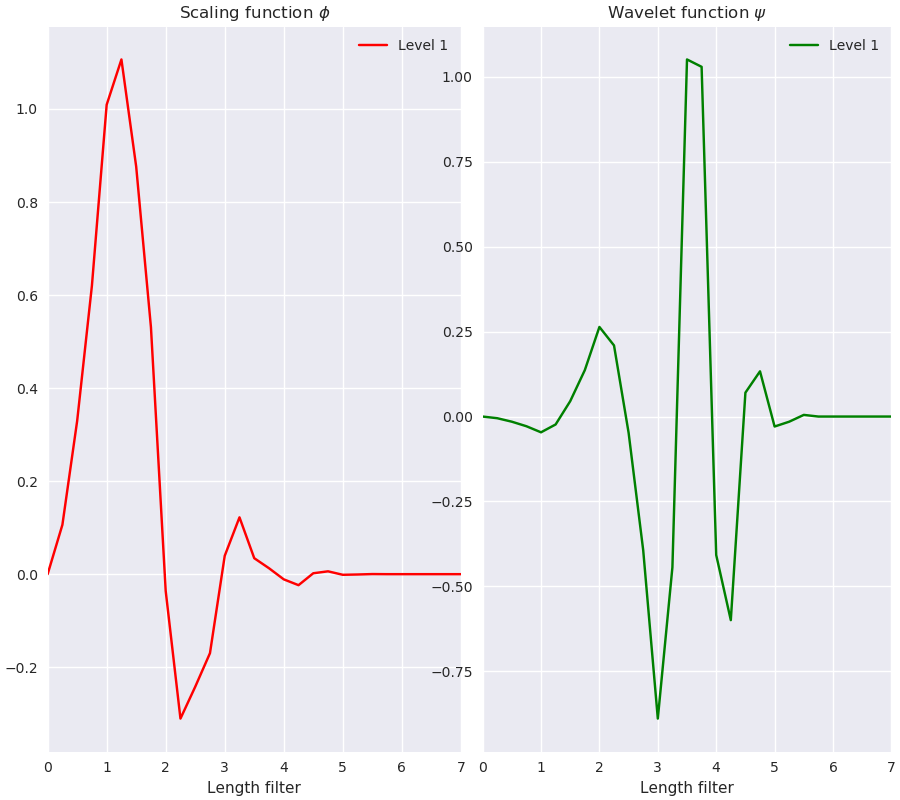

<IPython.core.display.Javascript object>


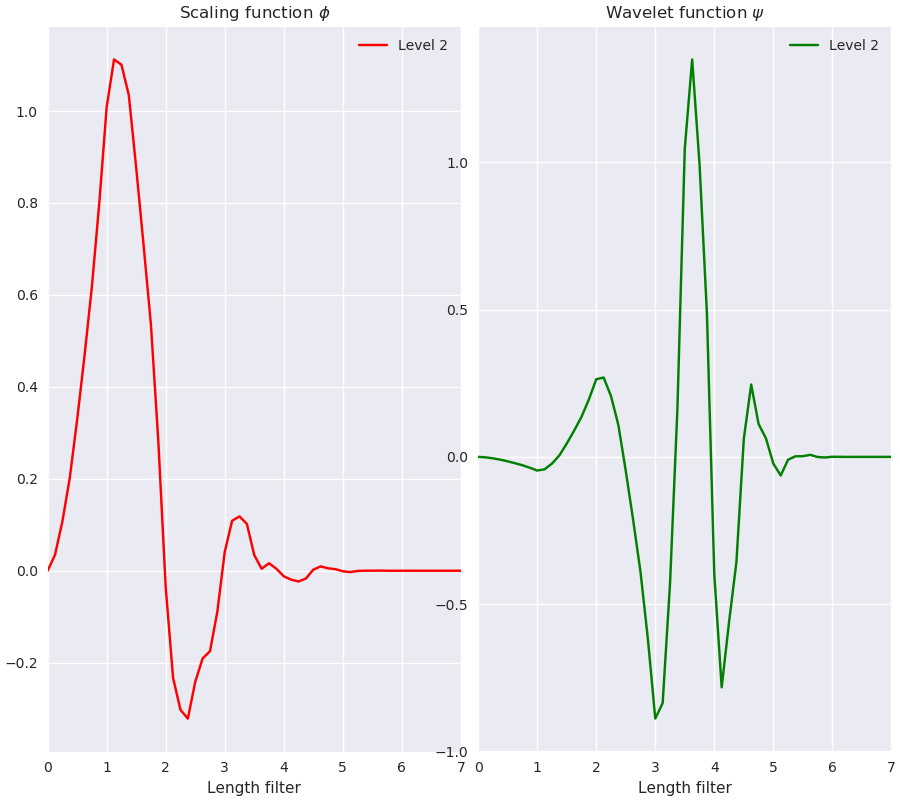

<IPython.core.display.Javascript object>


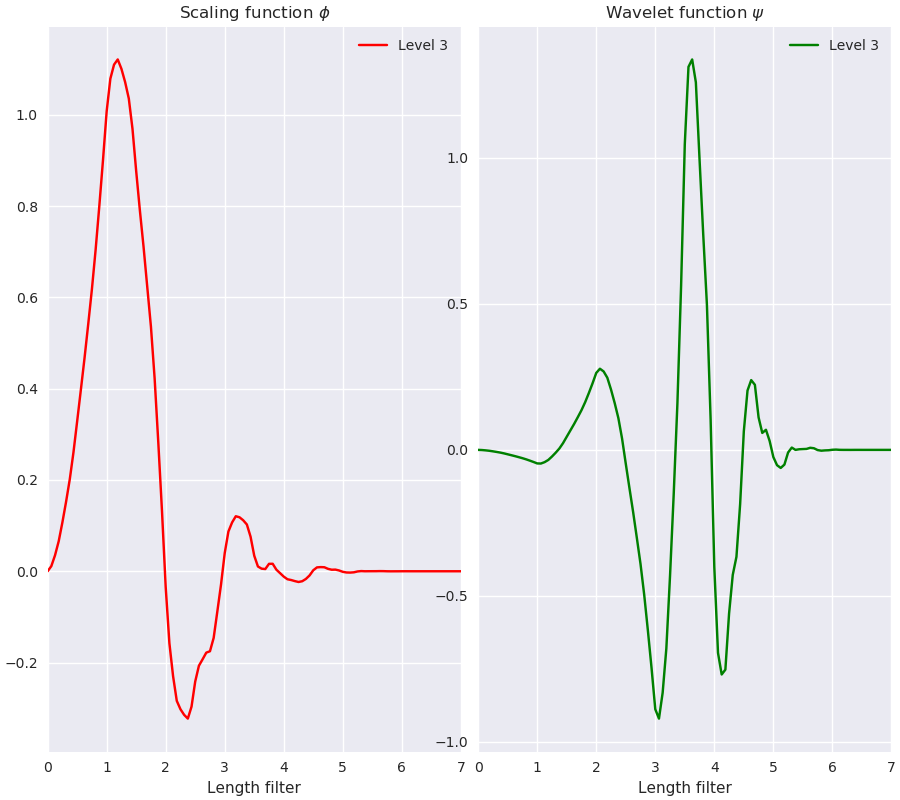

<IPython.core.display.Javascript object>


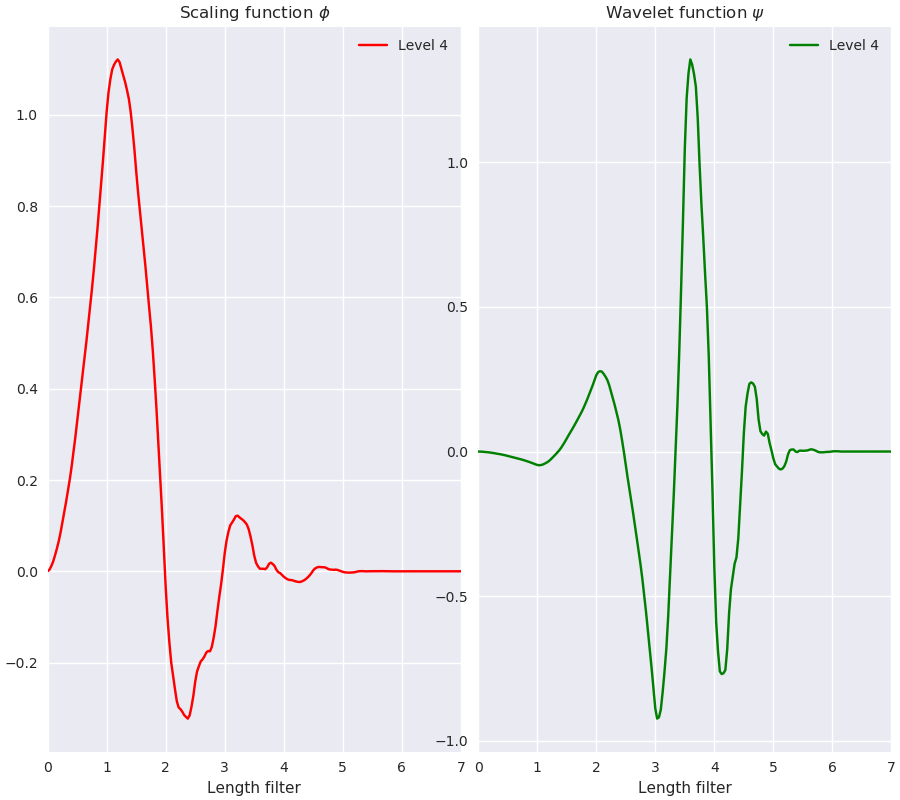

<IPython.core.display.Javascript object>


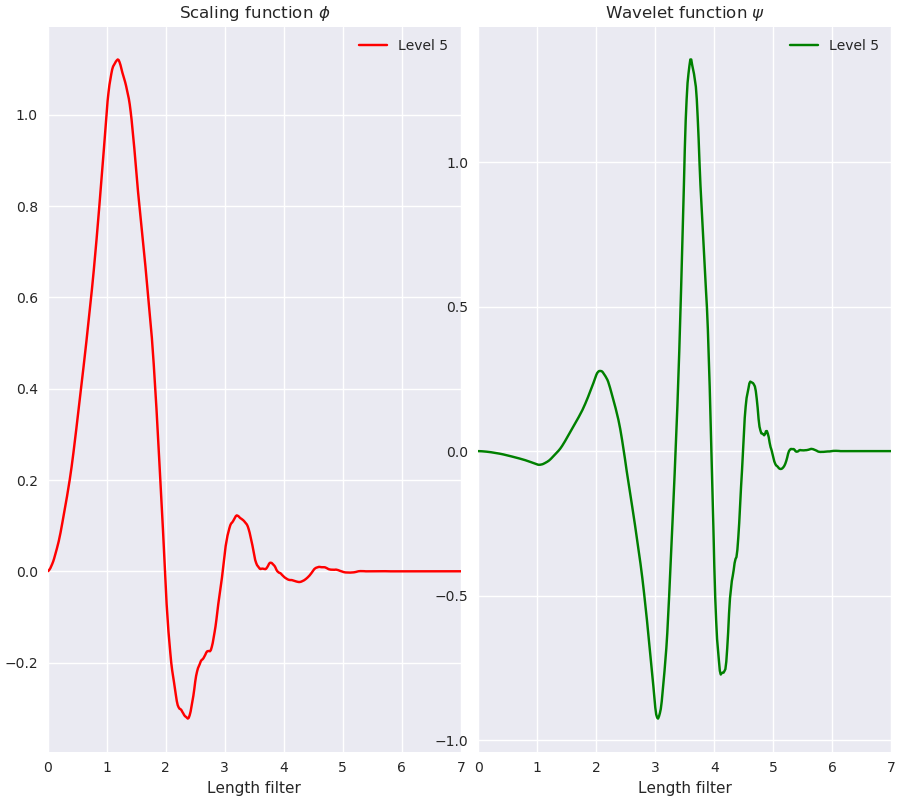

<IPython.core.display.Javascript object>


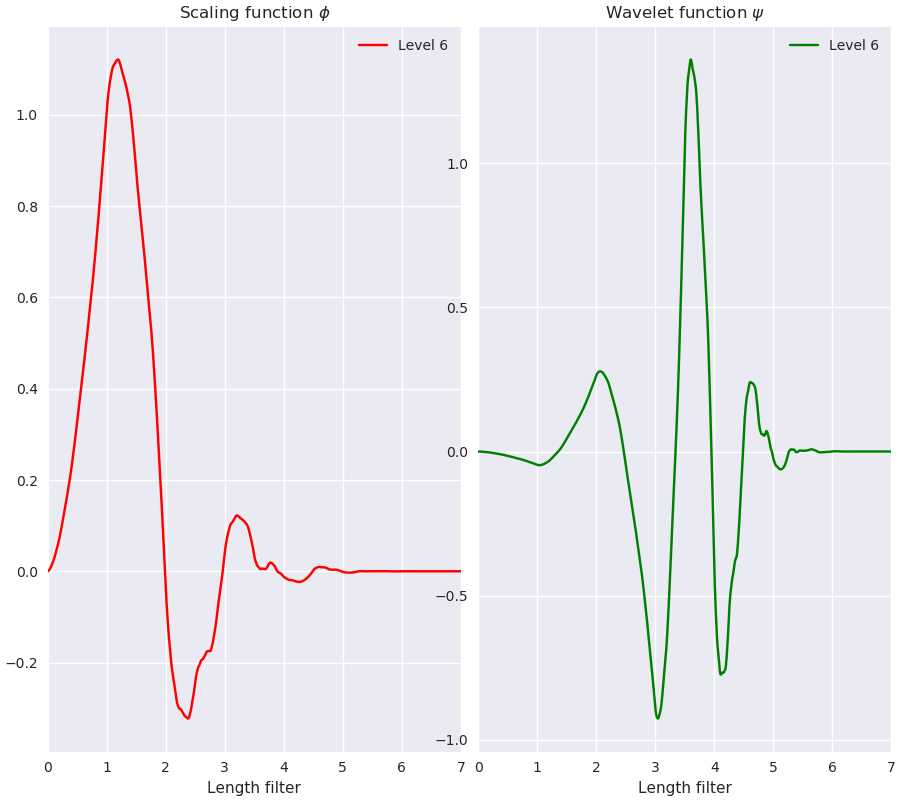

<IPython.core.display.Javascript object>


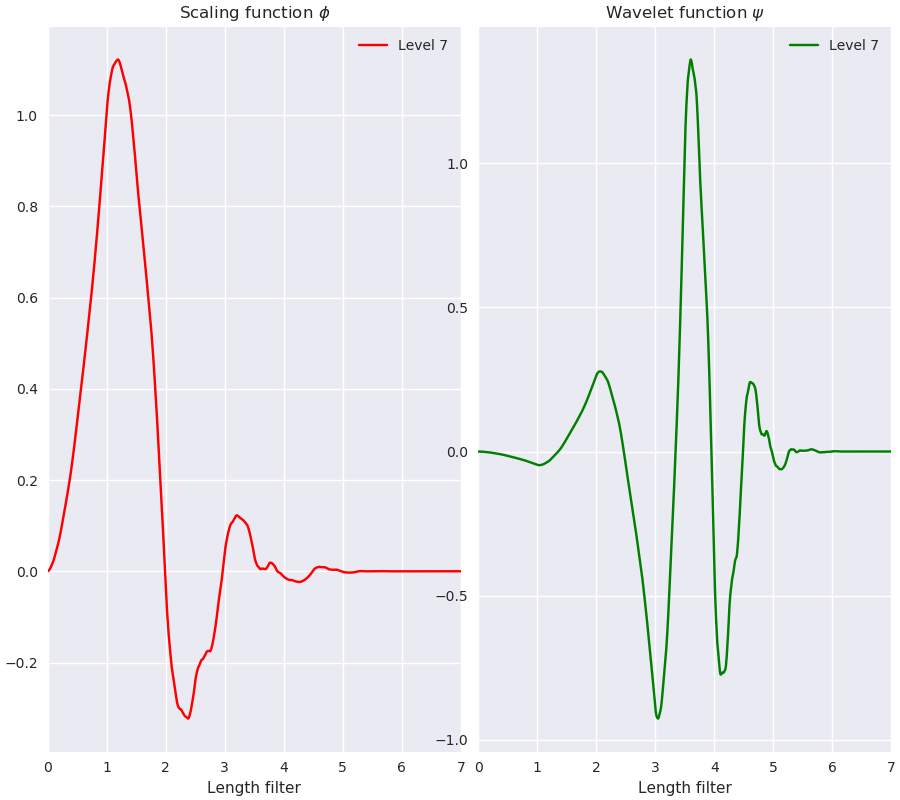

<IPython.core.display.Javascript object>


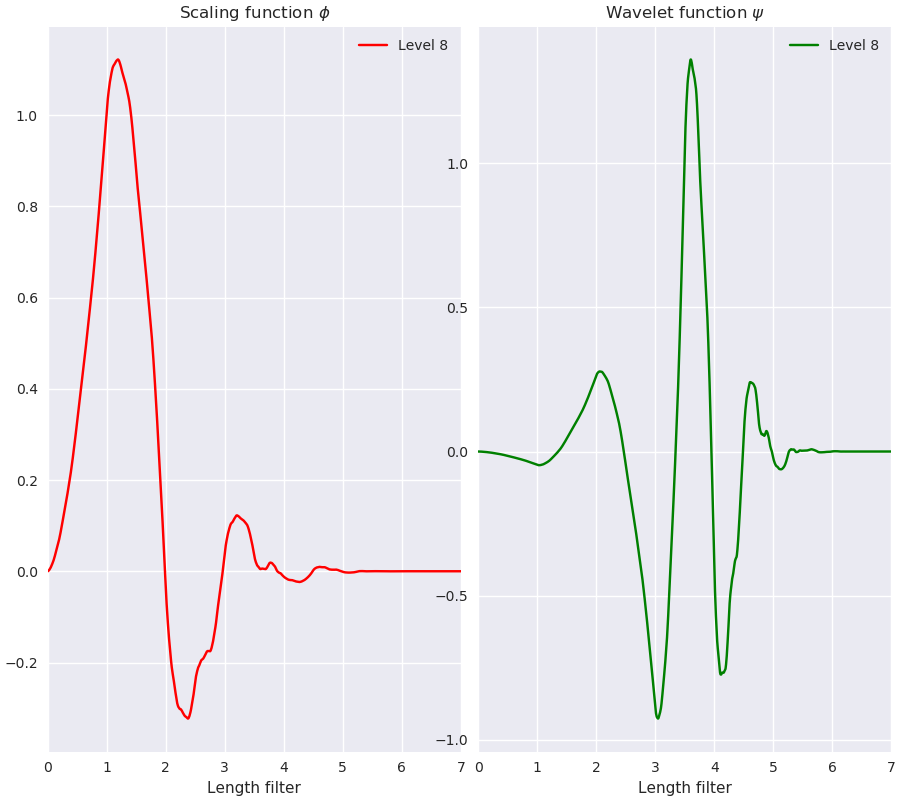

<IPython.core.display.Javascript object>


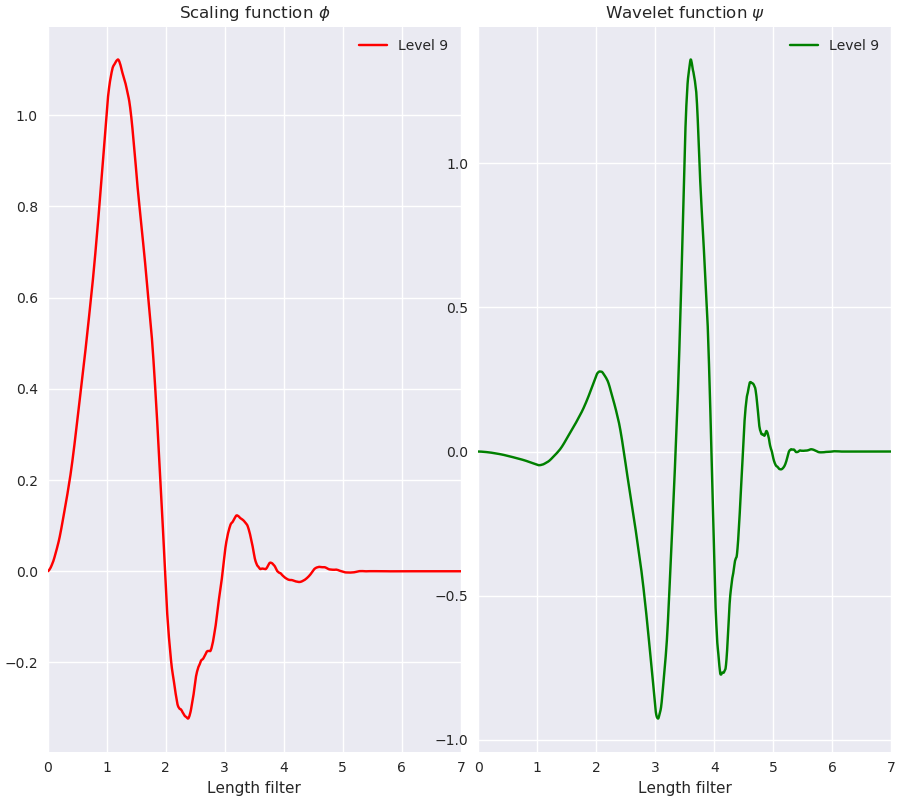

<IPython.core.display.Javascript object>


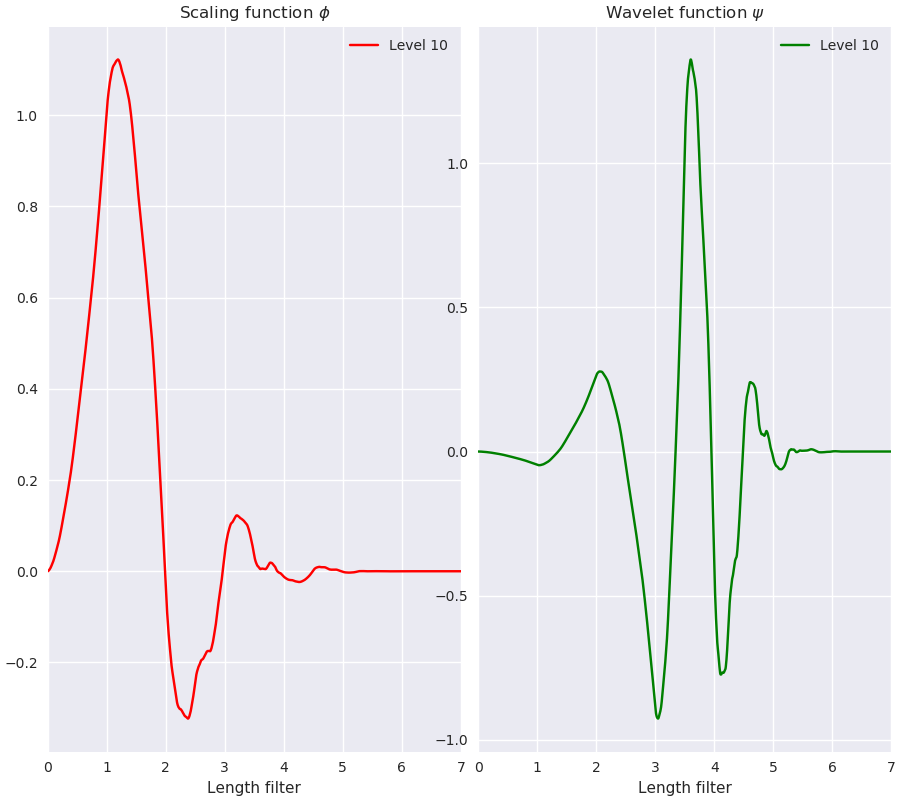

<IPython.core.display.Javascript object>


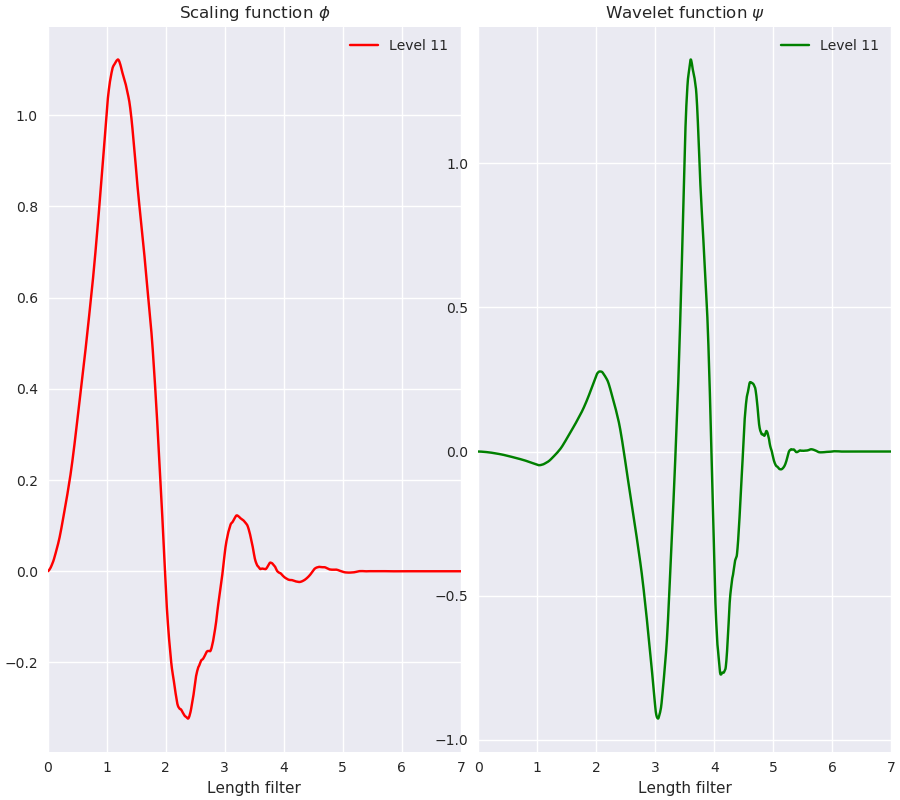

In [10]:
show_evolution_wavelet(wv.Wavelet('db4'), 12, intermediate=True)

<IPython.core.display.Javascript object>


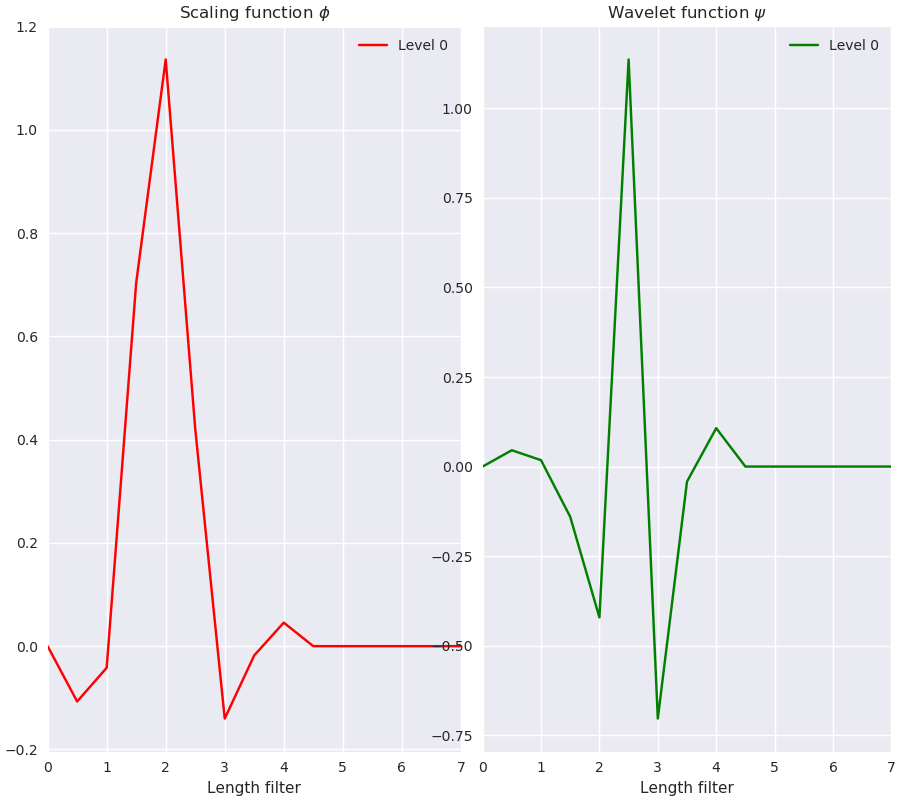

<IPython.core.display.Javascript object>


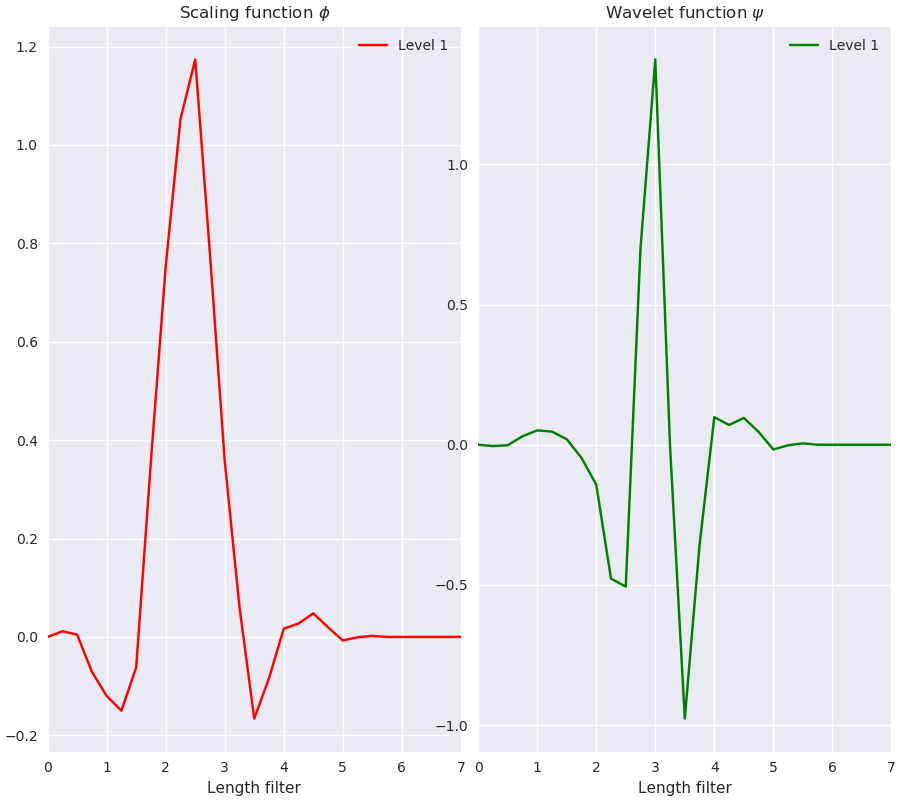

<IPython.core.display.Javascript object>


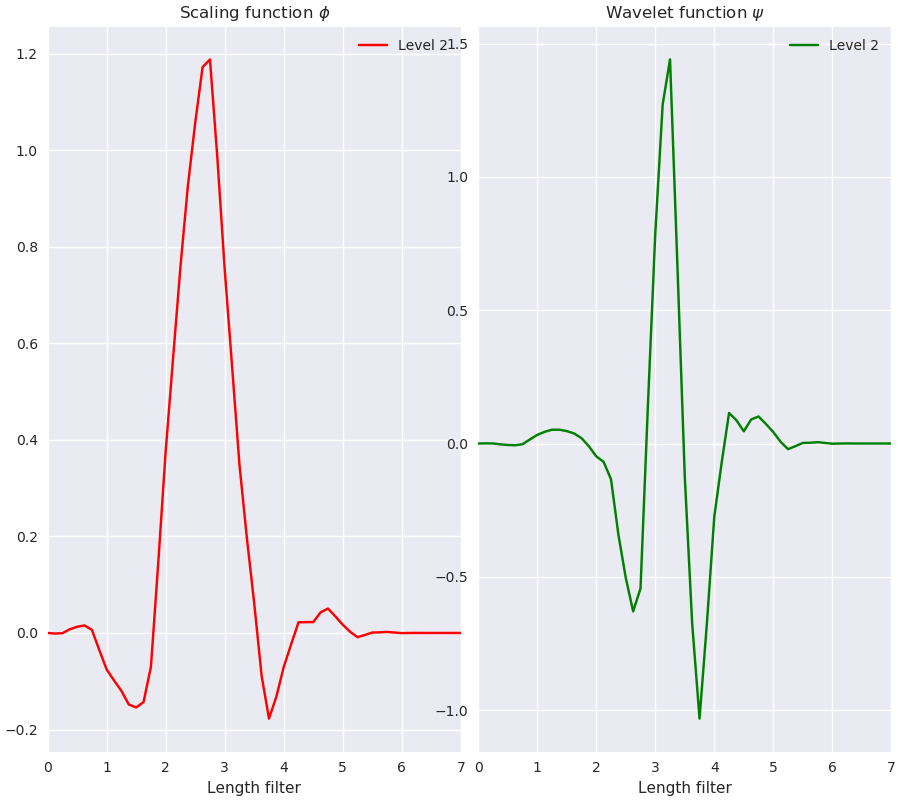

<IPython.core.display.Javascript object>


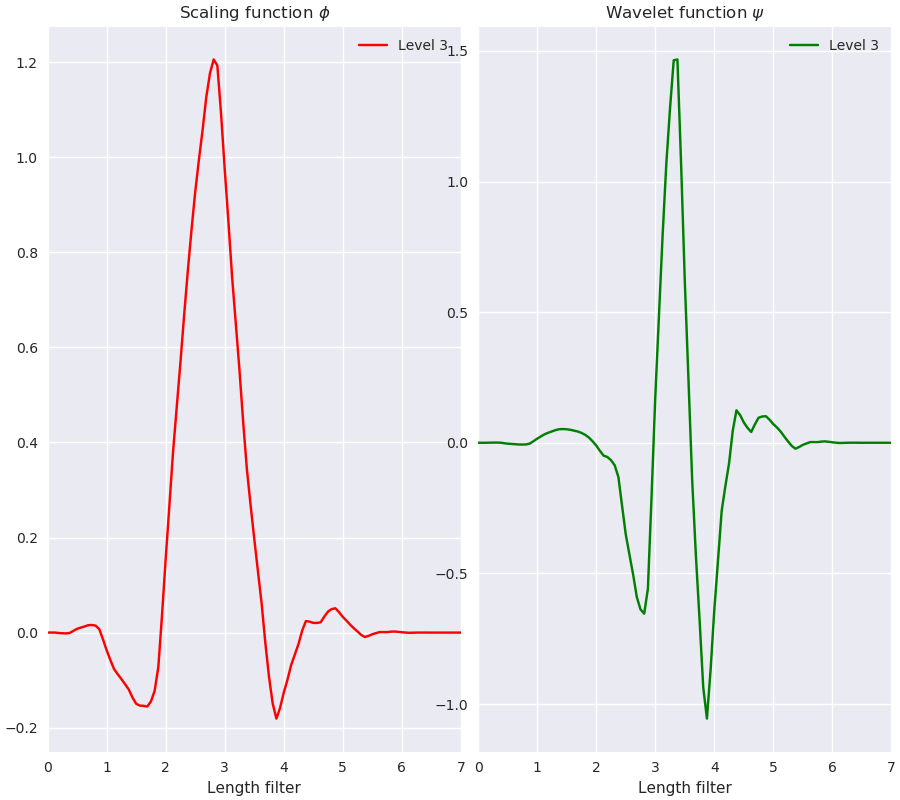

<IPython.core.display.Javascript object>


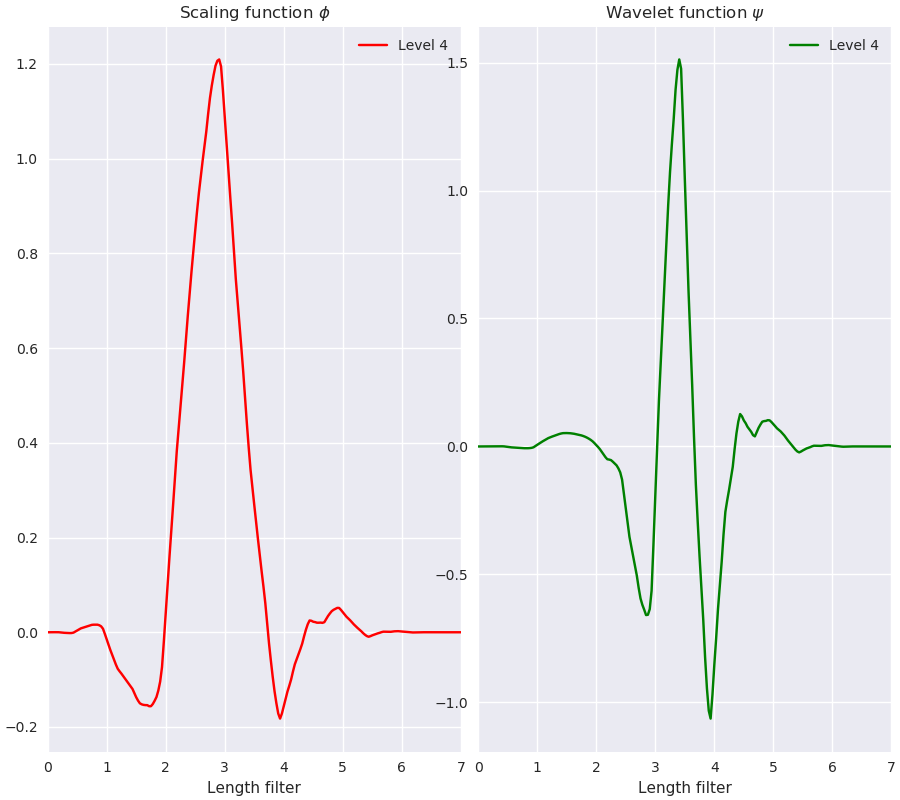

<IPython.core.display.Javascript object>


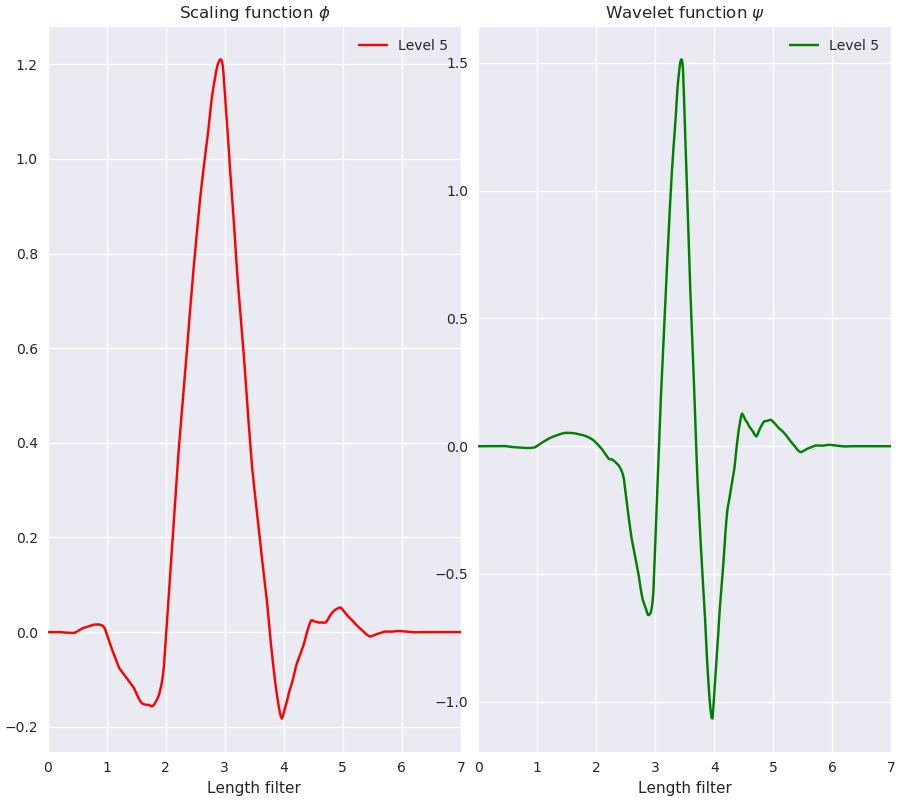

<IPython.core.display.Javascript object>


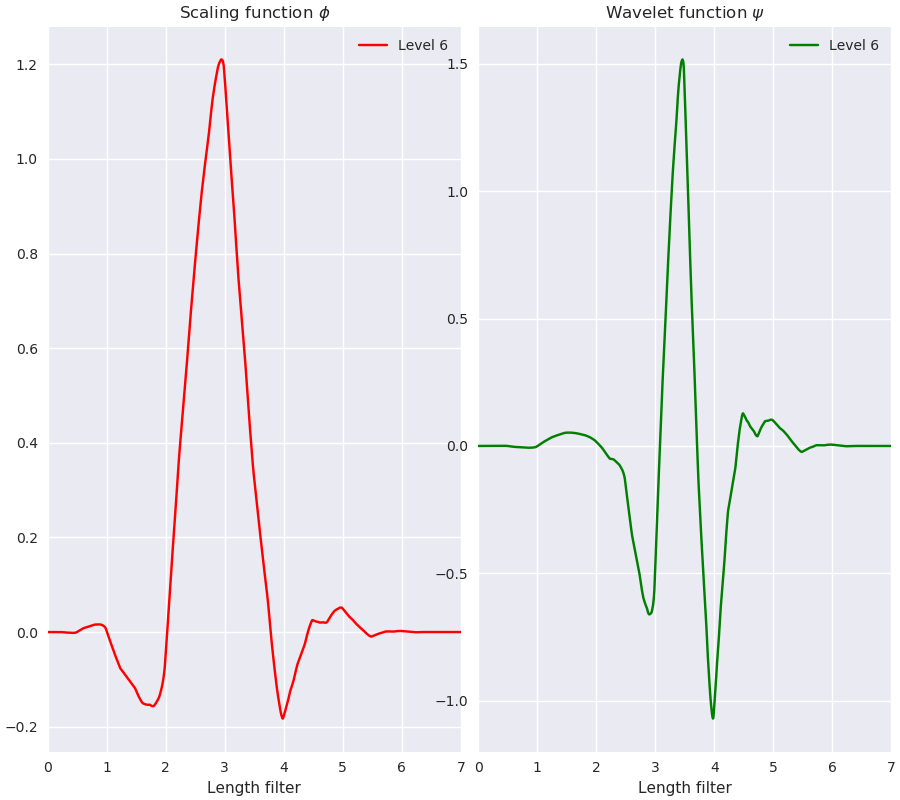

<IPython.core.display.Javascript object>


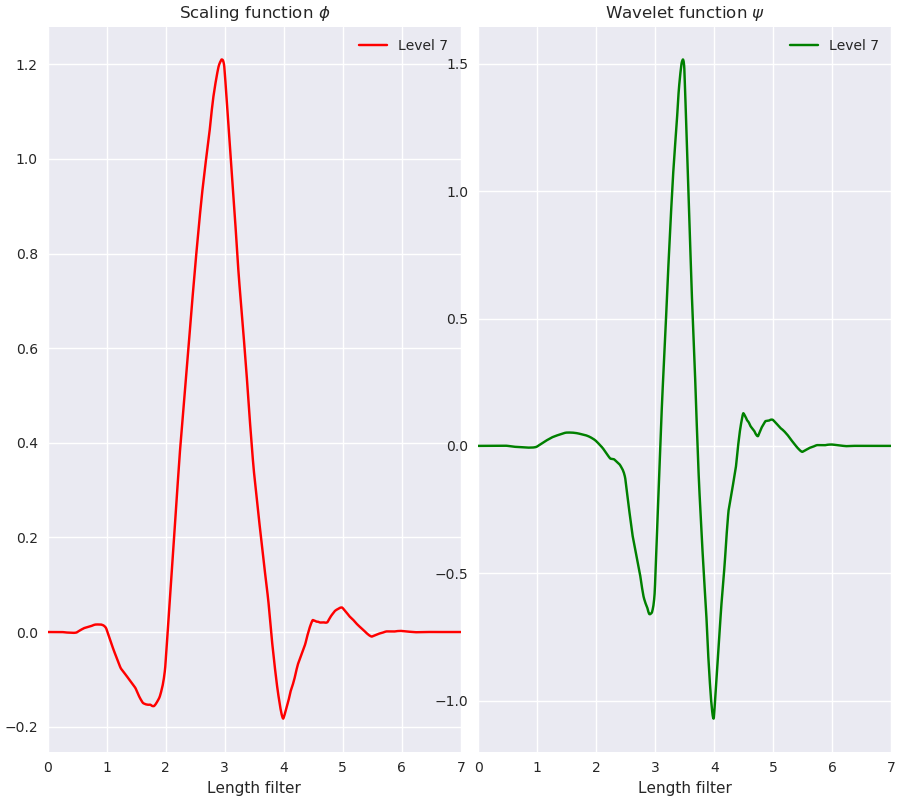

<IPython.core.display.Javascript object>


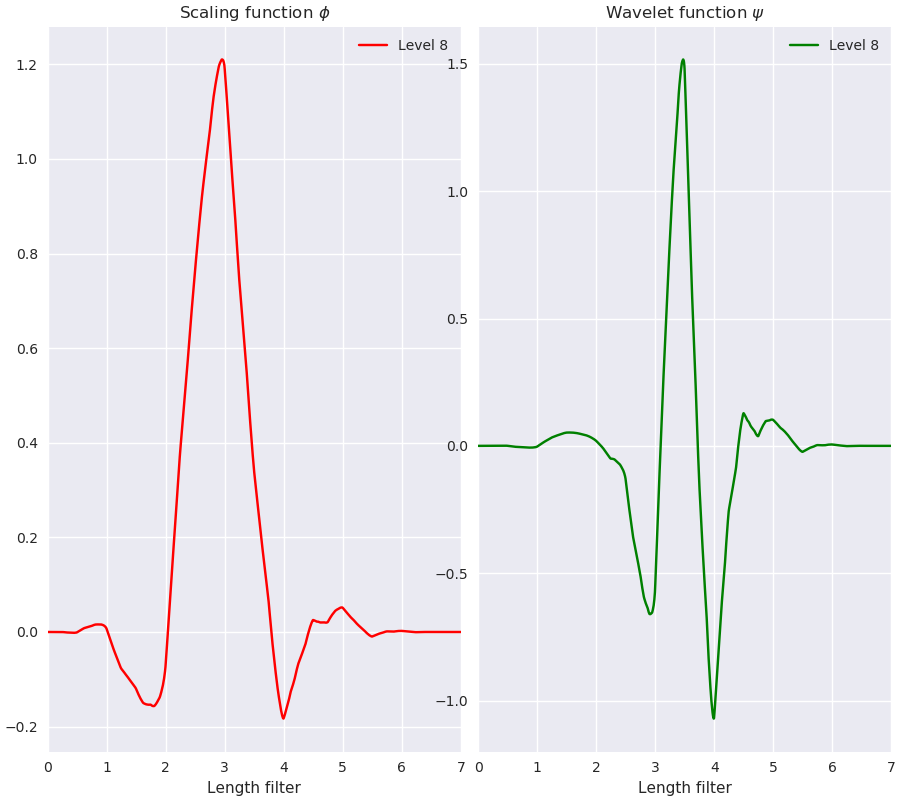

<IPython.core.display.Javascript object>


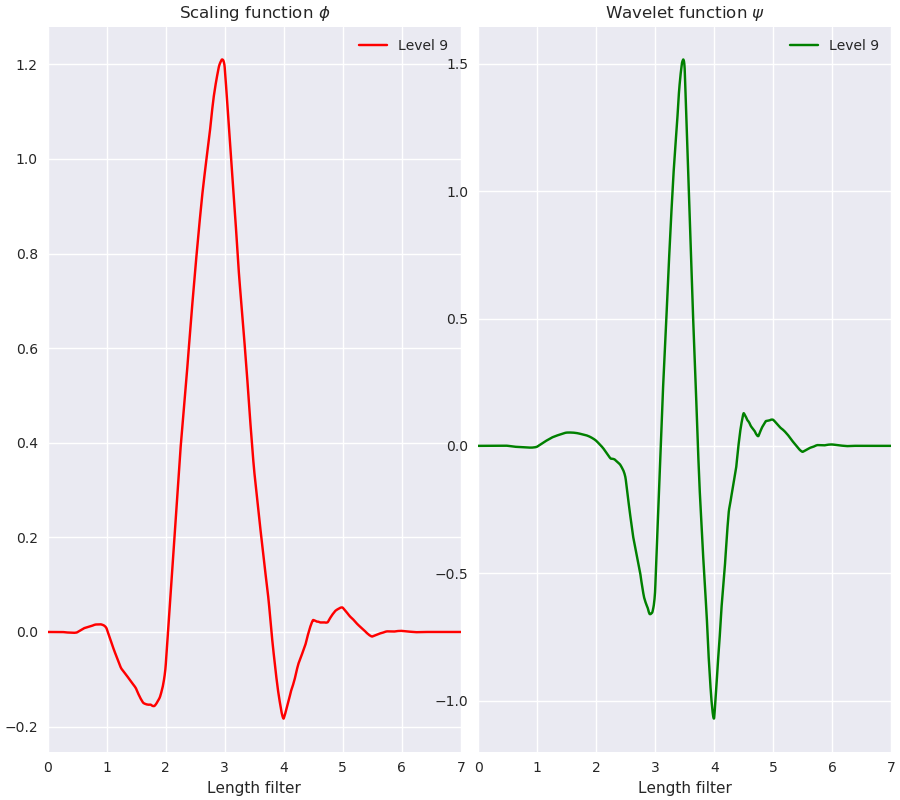

<IPython.core.display.Javascript object>


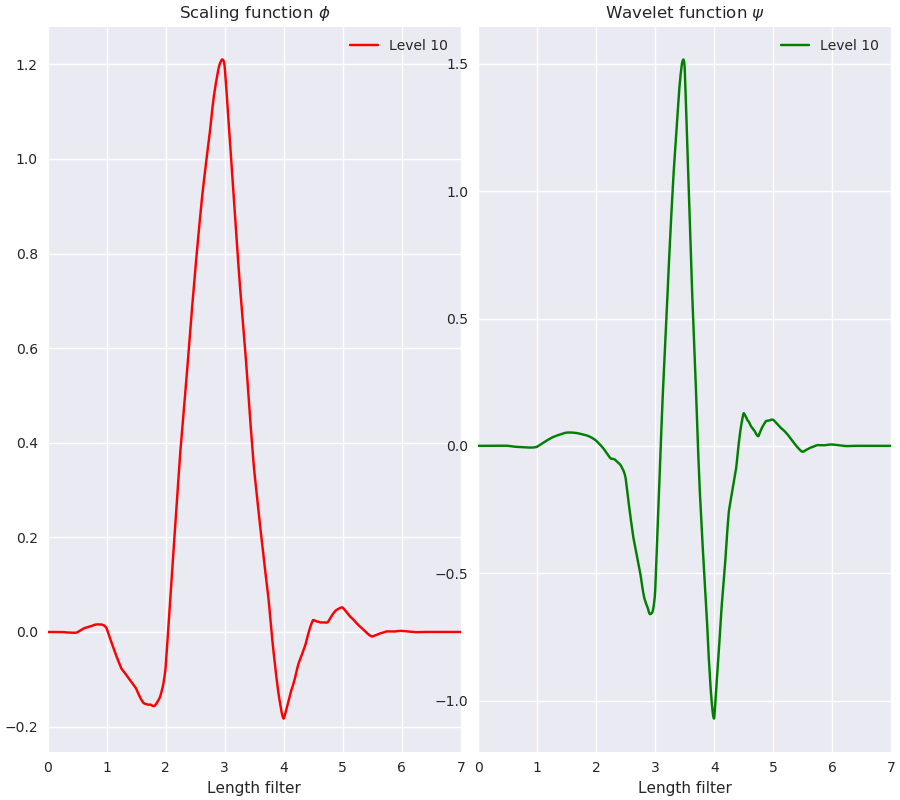

<IPython.core.display.Javascript object>


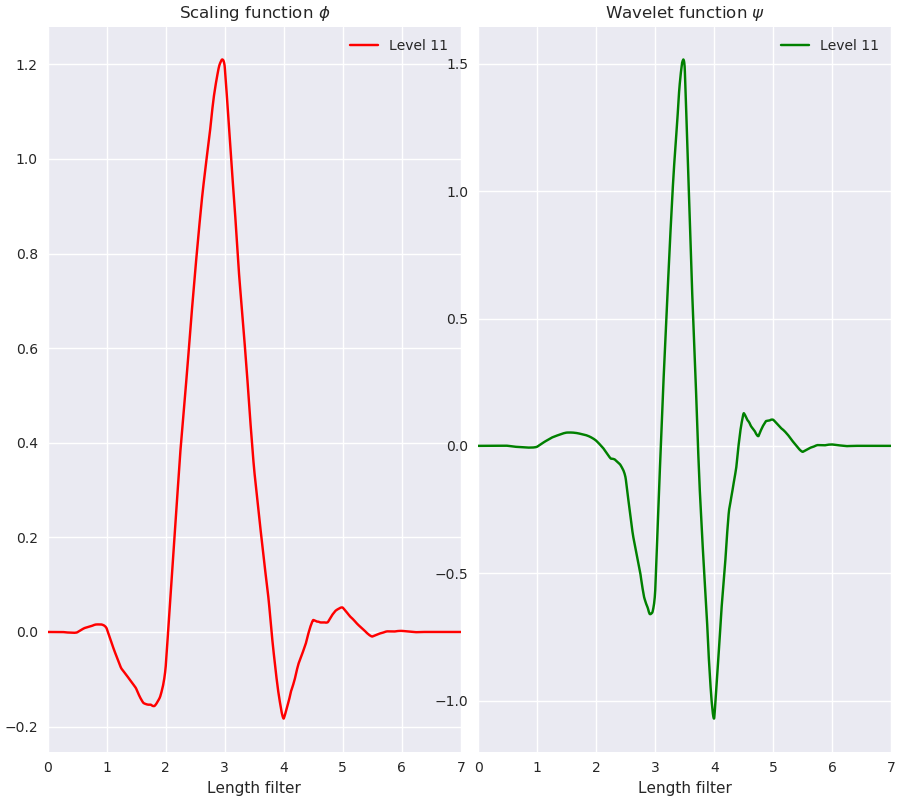

In [11]:
show_evolution_wavelet(la8, 12, intermediate=True)

<IPython.core.display.Javascript object>


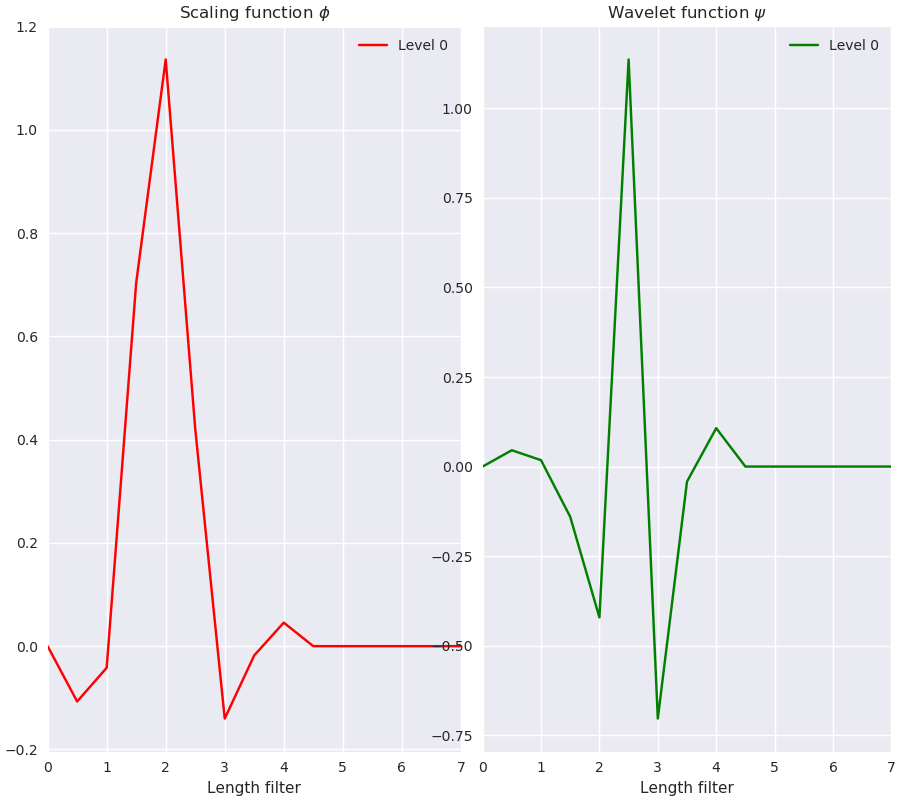

<IPython.core.display.Javascript object>


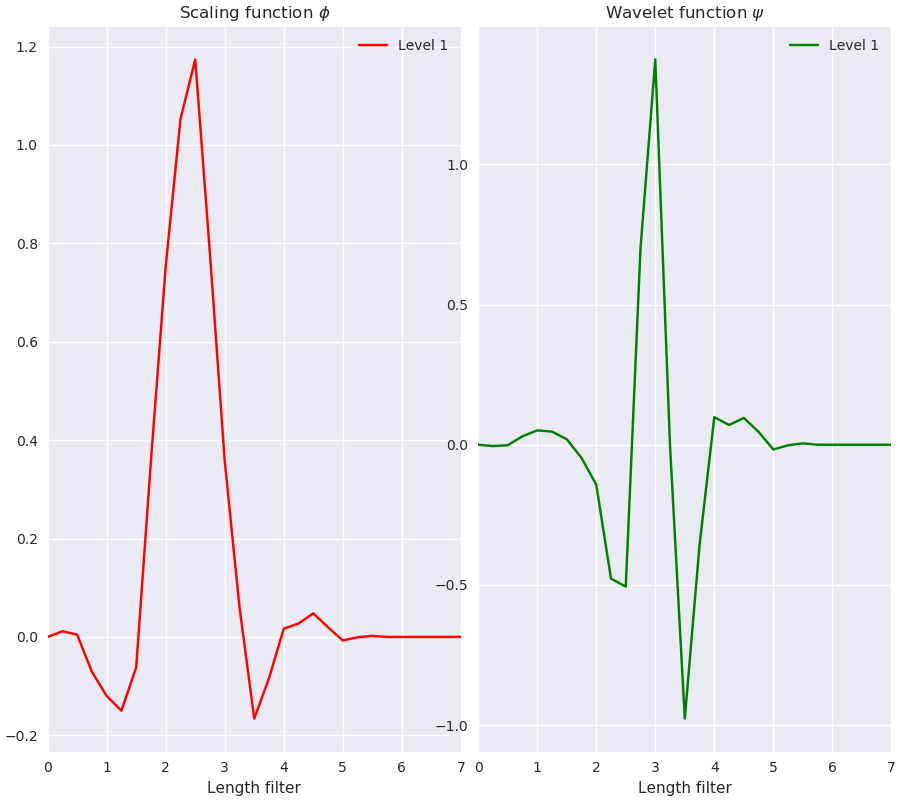

<IPython.core.display.Javascript object>


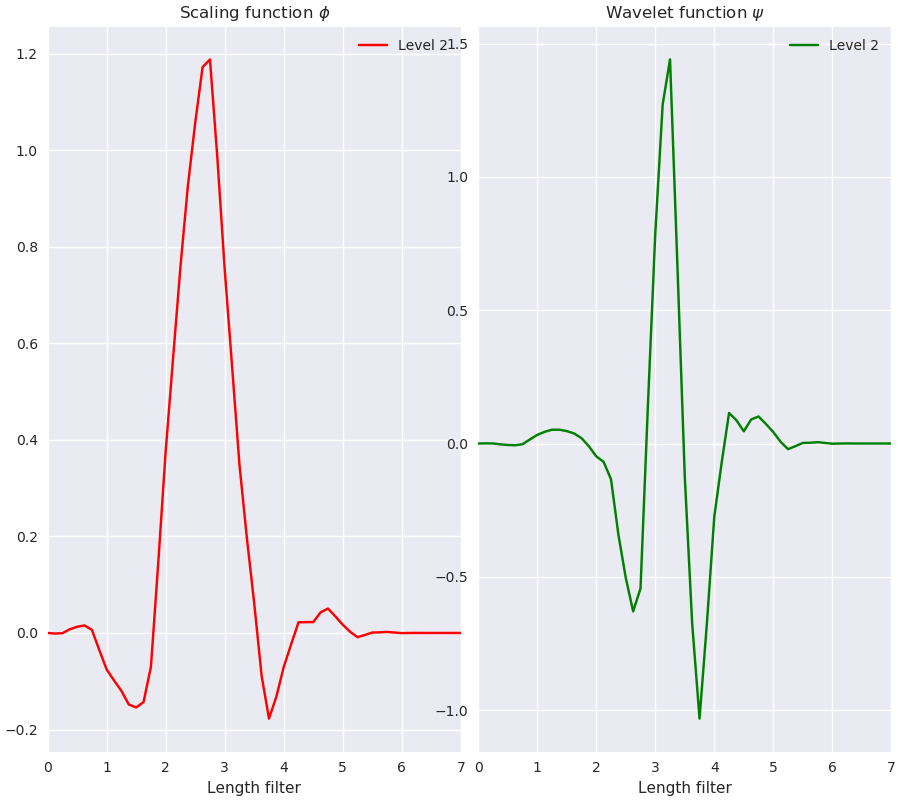

<IPython.core.display.Javascript object>


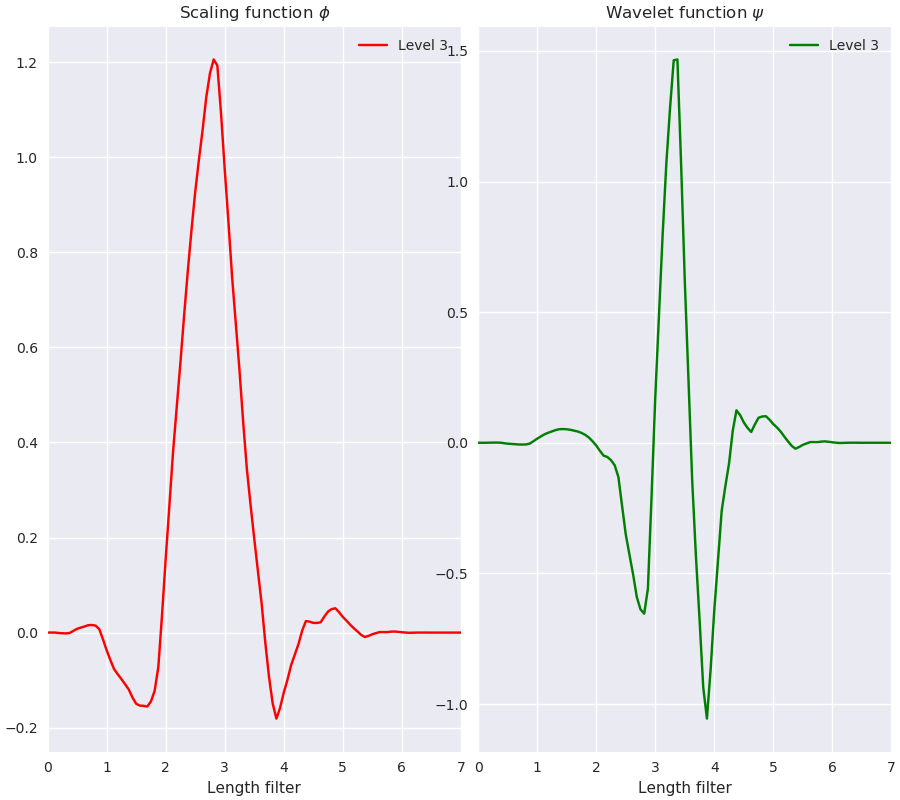

<IPython.core.display.Javascript object>


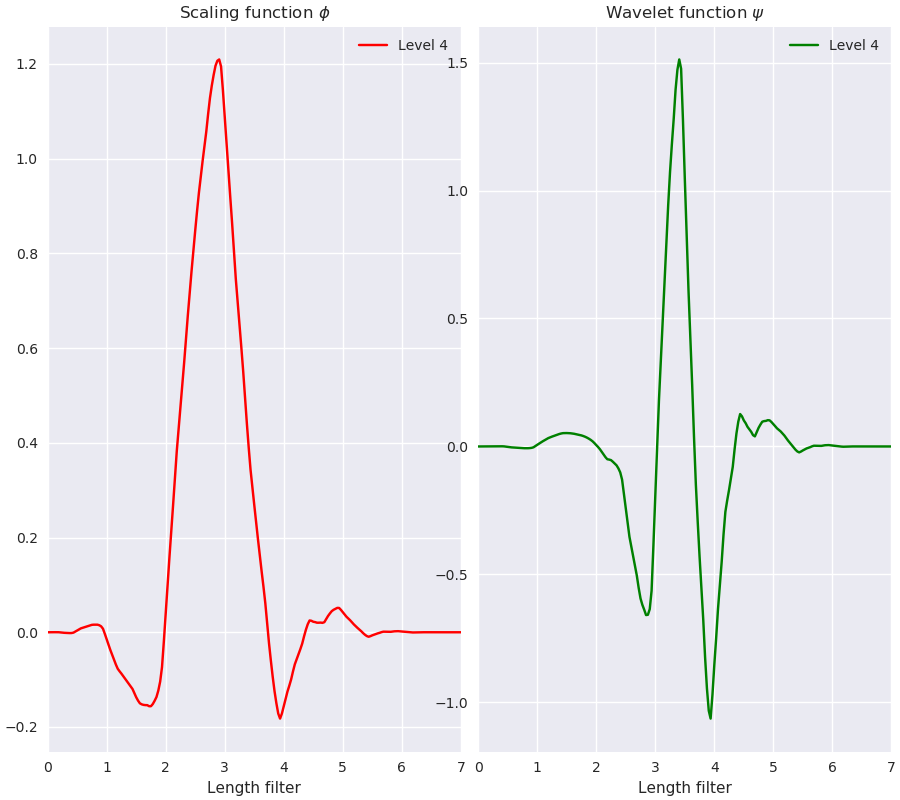

<IPython.core.display.Javascript object>


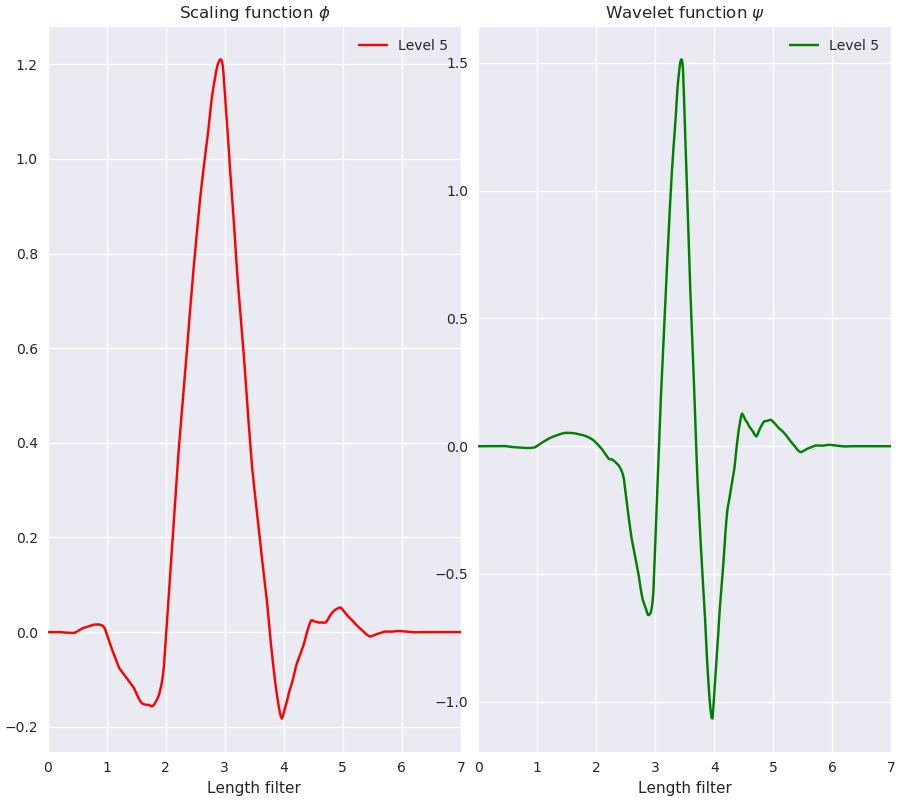

<IPython.core.display.Javascript object>


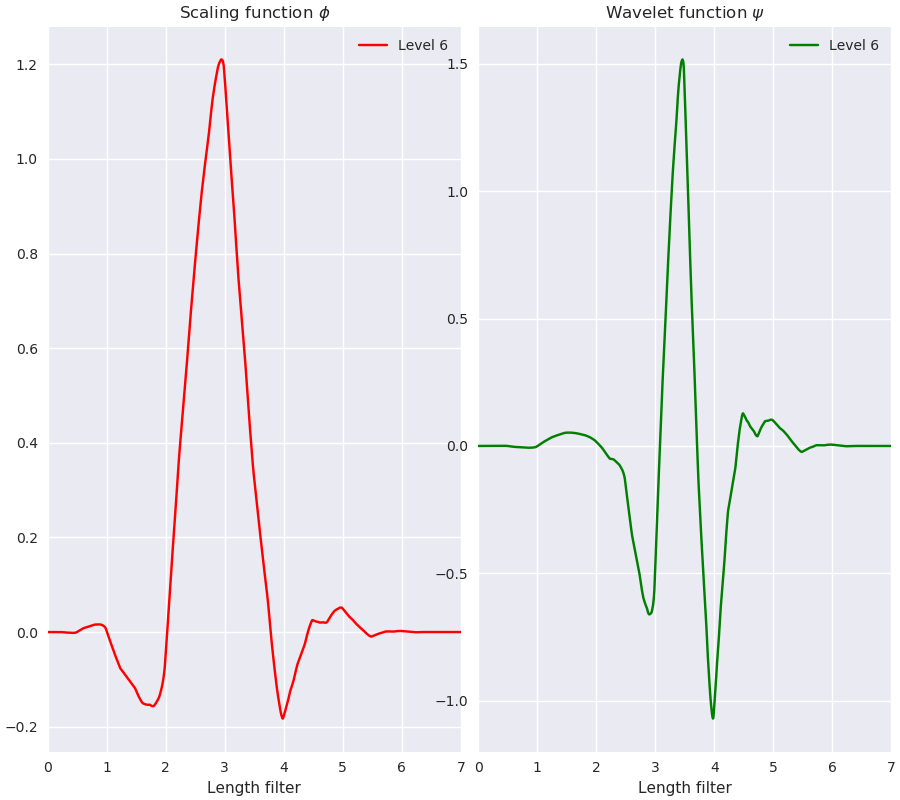

<IPython.core.display.Javascript object>


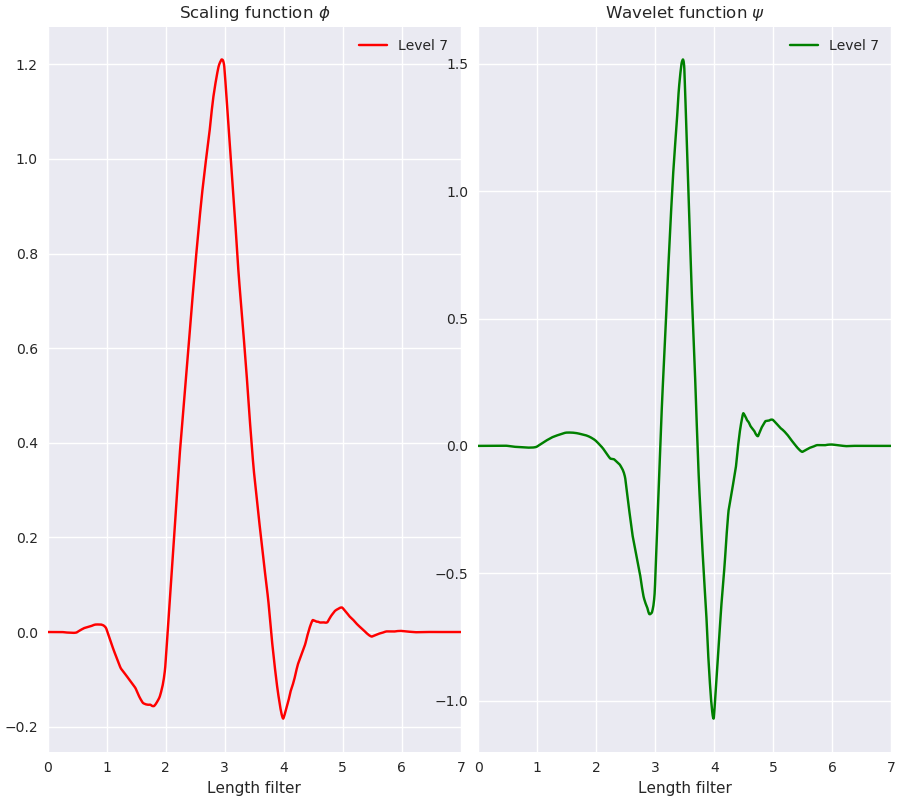

<IPython.core.display.Javascript object>


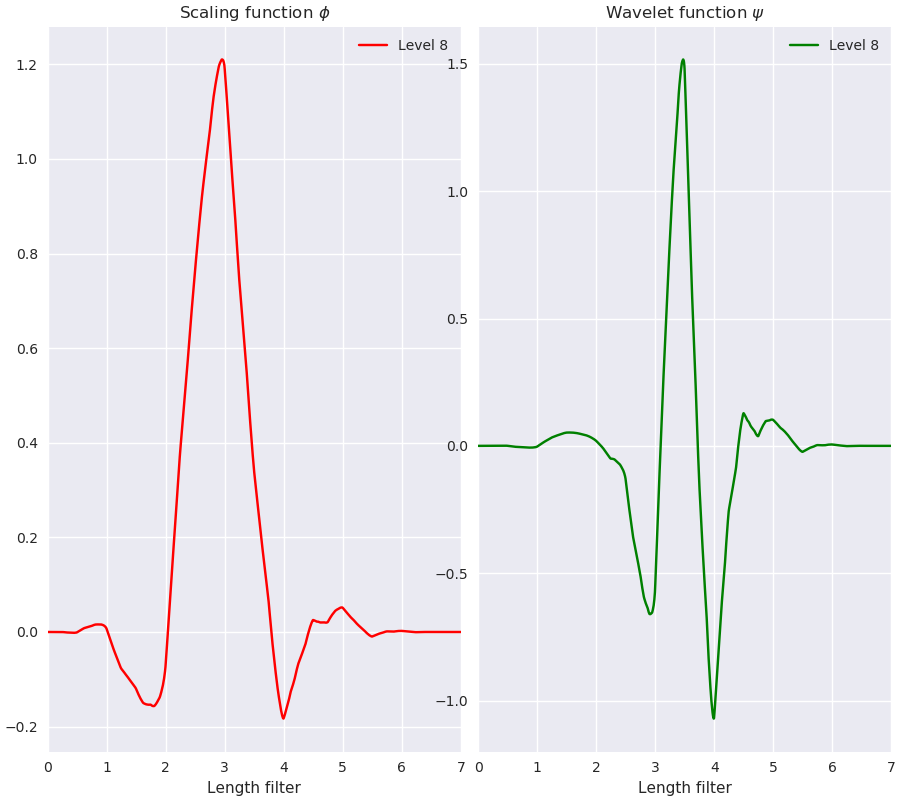

<IPython.core.display.Javascript object>


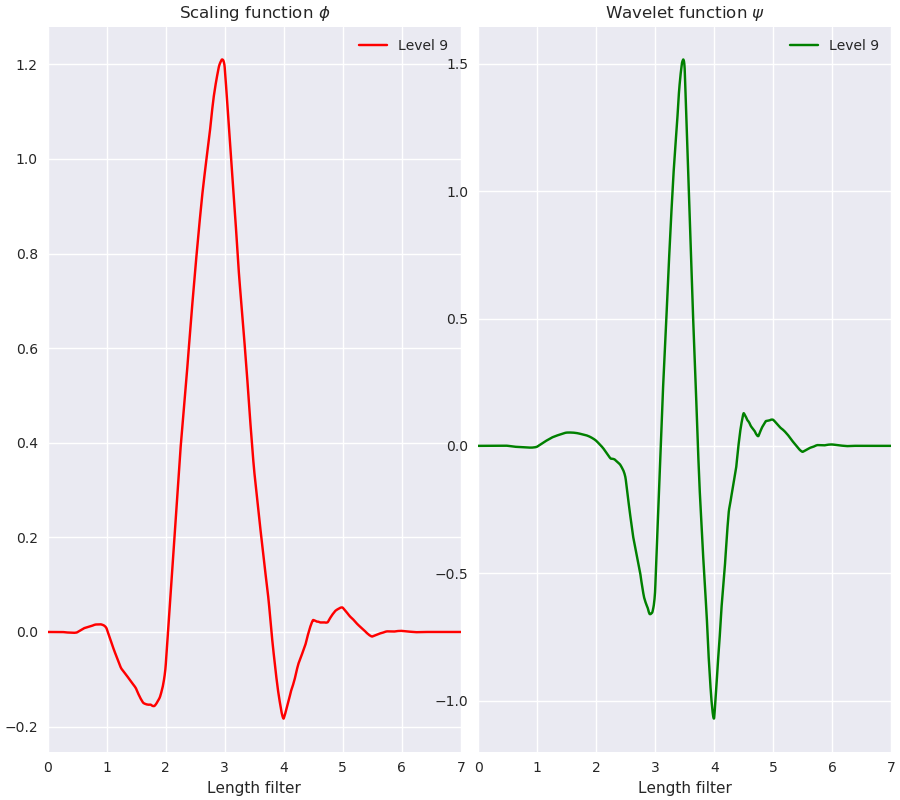

<IPython.core.display.Javascript object>


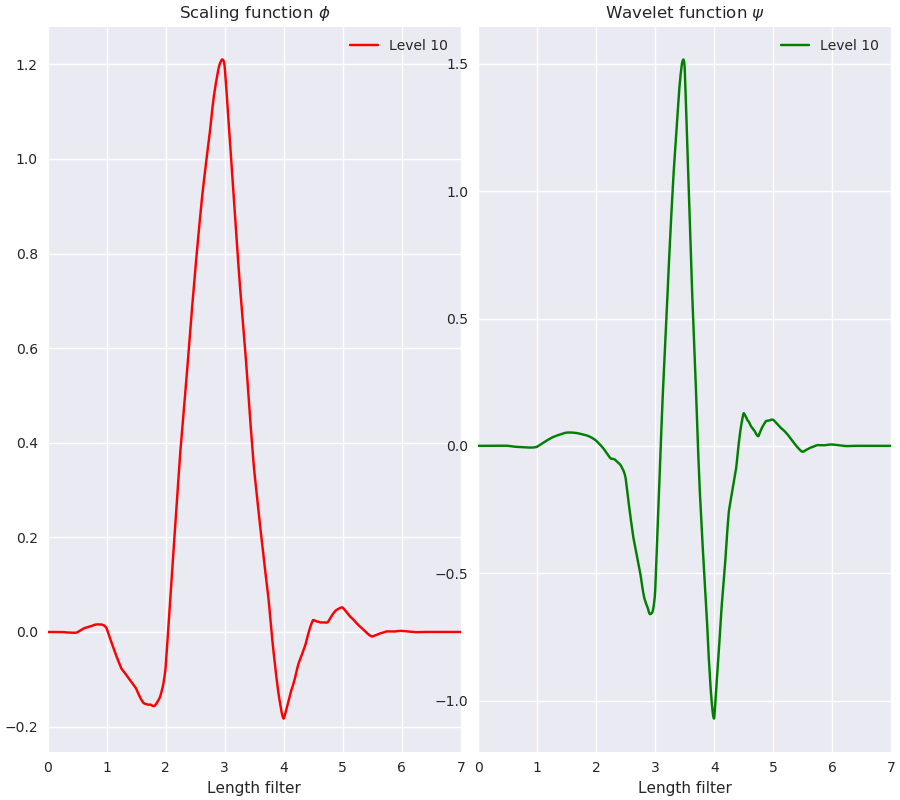

<IPython.core.display.Javascript object>


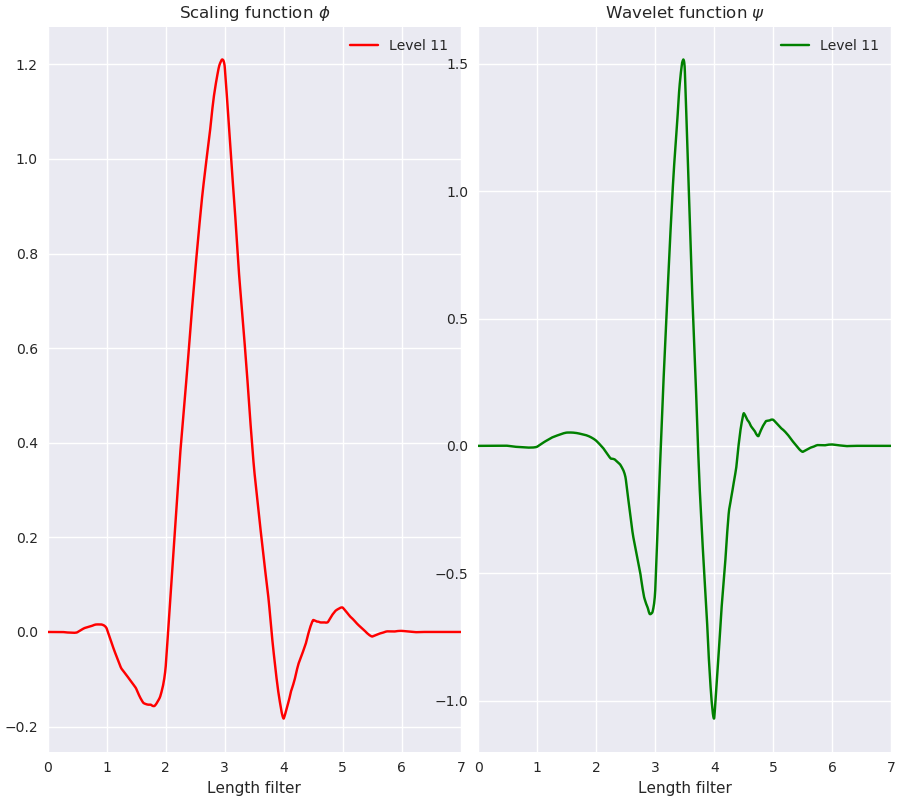

In [12]:
show_evolution_wavelet(la8_modwt, 12, intermediate=True)

In [12]:
wv.central_frequency(la8)

0.7142857142857143

### Show continuous version of wavelet function

<IPython.core.display.Javascript object>


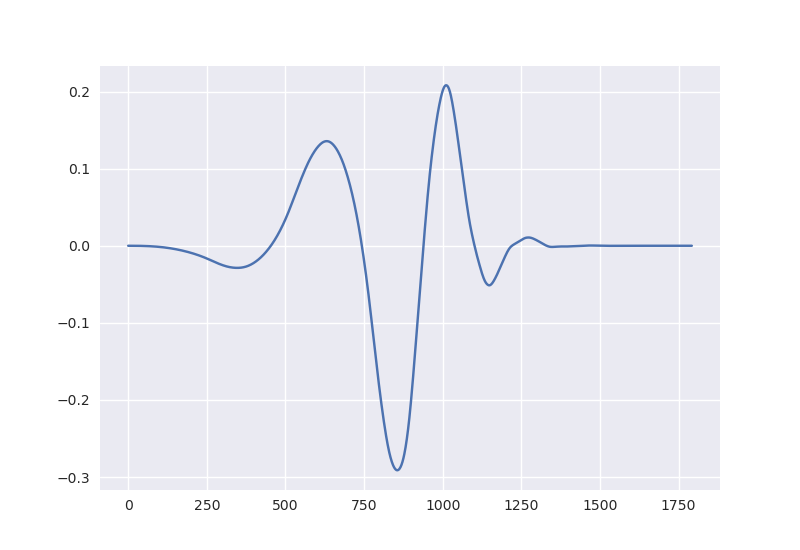

In [13]:
%matplotlib notebook
a, b = wv.integrate_wavelet(wv.Wavelet('db4'))
plt.plot(a)
# plt.plot(b)
plt.show()

### Inspect central frequency of wavelet and plot for MRA

In [14]:
fre_la8 = []
for i in range(1, 12):
    fre_la8.append(wv.scale2frequency(la8, scale=i, precision=4))
    print(f" Centrale frequency op level {str(i)} with value {str(wv.scale2frequency(wv.Wavelet('db4'), scale=i, precision=4))}")

 Centrale frequency op level 1 with value 0.7142857142857143
 Centrale frequency op level 2 with value 0.35714285714285715
 Centrale frequency op level 3 with value 0.2380952380952381
 Centrale frequency op level 4 with value 0.17857142857142858
 Centrale frequency op level 5 with value 0.14285714285714285
 Centrale frequency op level 6 with value 0.11904761904761905
 Centrale frequency op level 7 with value 0.10204081632653061
 Centrale frequency op level 8 with value 0.08928571428571429
 Centrale frequency op level 9 with value 0.07936507936507936
 Centrale frequency op level 10 with value 0.07142857142857142
 Centrale frequency op level 11 with value 0.06493506493506494


In [15]:
fre_la8_mdwt = []
for i in range(1, 12):
    fre_la8_mdwt.append(wv.scale2frequency(la8_modwt, scale=i, precision=4))

<IPython.core.display.Javascript object>


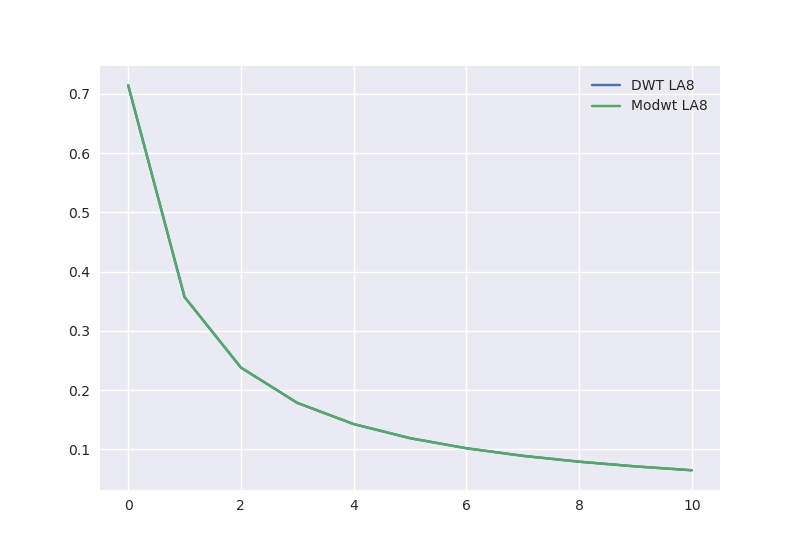

In [16]:
%matplotlib notebook
plt.plot(fre_la8, label='DWT LA8')
plt.plot(fre_la8_mdwt, label='Modwt LA8')
plt.legend(loc=0)
plt.show()

### Investigate shift invariance with ECG signal

In [17]:
from scipy.signal import find_peaks

In [18]:
ecg = wv.data.ecg()
peak = find_peaks(ecg, height=0)[0]

<IPython.core.display.Javascript object>


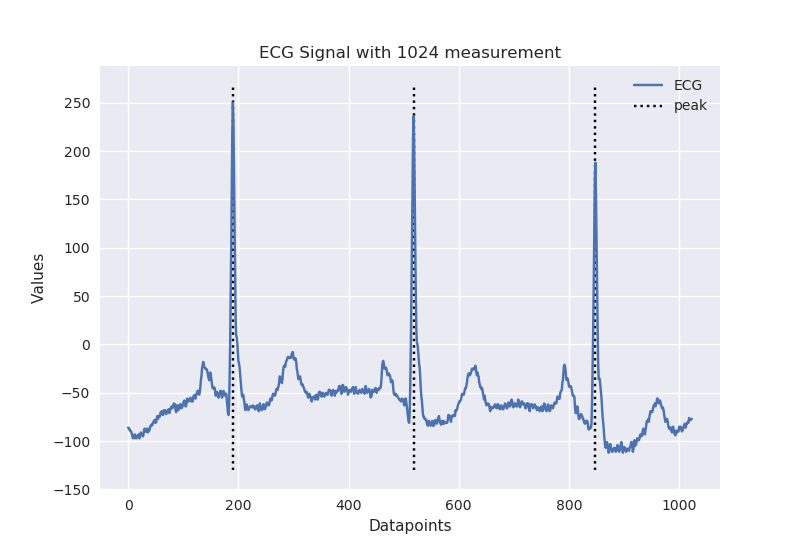

In [19]:
%matplotlib notebook
plt.plot(ecg, label="ECG")
plt.vlines(peak, ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted', label='peak')
plt.xlabel('Datapoints')
plt.ylabel('Values')
plt.title('ECG Signal with 1024 measurement')
plt.savefig('Report/Wavelet/Methods/'+'ECG'+'.pdf', dpi=120)
plt.savefig('Report/Wavelet/Methods/'+'ECG'+'.png', dpi=120)
plt.legend()
plt.show()

In [21]:
from functools import partial, reduce

In [20]:
def translated_inv_modwt(data, w, level):
#     https://github.com/PyWavelets/pywt/pull/527/files
    assert isinstance(w, wv.Wavelet)
#     a = get_pad_data(data=data)
    kwargs = dict(wavelet=w, norm=True)
    forward = partial(wv.swt, level=level, trim_approx=True, **kwargs)
    wav_coeffs = forward(data)
    inverse = partial(wv.iswt, **kwargs)
    is_swt = True
    mra_coeffs = []
    nc = len(wav_coeffs)

    if is_swt:
        # replicate same zeros array to save memory
        z = np.zeros_like(wav_coeffs[0])
        tmp = [z, ] * nc
    else:
        # zero arrays have variable size in DWT case
        tmp = [np.zeros_like(c) for c in wav_coeffs]

    for j in range(nc):
        # tmp has arrays of zeros except for the jth entry
        tmp[j] = wav_coeffs[j]

        # reconstruct
        rec = inverse(tmp)
        if rec.shape != data.shape:
            # trim any excess coefficients
            rec = rec[tuple([slice(sz) for sz in data.shape])]
        mra_coeffs.append(rec)

        # restore zeros
        if is_swt:
            tmp[j] = z
        else:
            tmp[j] = np.zeros_like(tmp[j])
    return mra_coeffs

In [22]:
mra = translated_inv_modwt(ecg, la8, 5)
mra_mdwt = translated_inv_modwt(ecg, la8_modwt, 5)

In [23]:
def plot_percival_modwt(data, coeffs, title, level, figsize=(9, 8)):
#     https://github.com/PyWavelets/pywt/pull/527/files
#     a = get_pad_data(data=data)
    ylim = [data.min(), data.max()]
    peak = find_peaks(data, height=0)[0]
#     coeffs = None
#     if not no_pad:
#         coeffs =  wv.swt(a, w, level=level, trim_approx=True, norm=True) #[(cAn, (cDn, ...,cDn-1, cD1)]
#     else:
#         coeffs = wv.swt(data, w, level=level, trim_approx=True, norm=True)

    _, axes = plt.subplots(len(coeffs) + 1, figsize=figsize, dpi=90)
    axes[0].set_title(title)
    axes[0].plot(data,  label='Original signal')
    axes[0].vlines(peak, ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted')
    axes[0].set_ylabel('deg in Celsius')
    axes[0].set_xlim(0, len(data) - 1)
    axes[0].set_ylim(ylim[0], ylim[1])
    axes[0].legend(loc=0)


    for i, _ in enumerate(coeffs):
        ax = axes[-i - 1]
        if i == 0:
            ax.set_ylabel("A%d" % (len(coeffs) - 1))
            ax.plot( coeffs[i], 'r')
            ax.vlines(peak, ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted')
        else:
            ax.set_ylabel("D%d" % (len(coeffs) - i))
            ax.plot( coeffs[i], 'g')
            ax.vlines(peak, ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted')
        # Scale axes
        ax.set_xlim(0, len(data) - 1)
        ax.set_ylim(ylim[0], ylim[1])
    plt.tight_layout()
    plt.show()


<IPython.core.display.Javascript object>


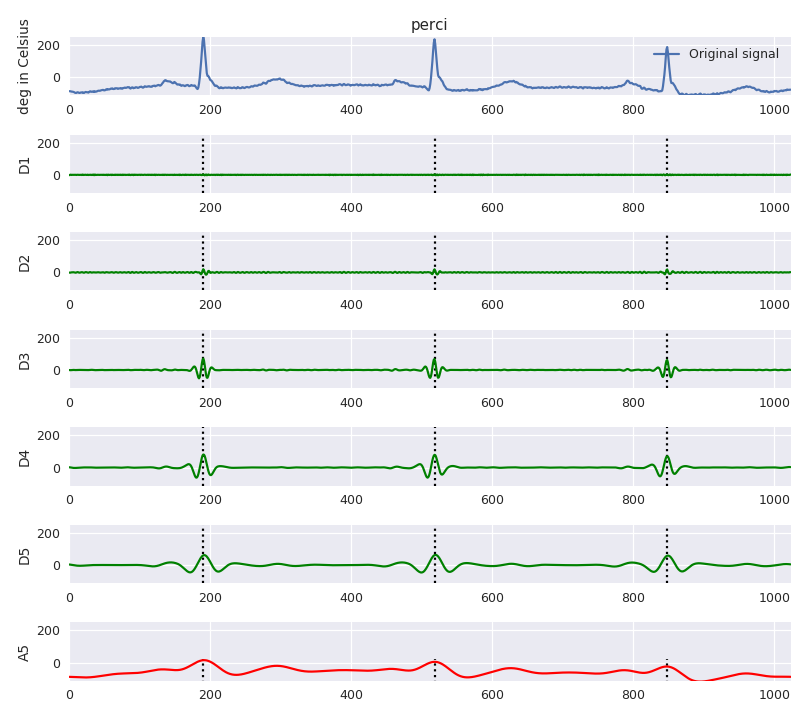

In [24]:
plot_percival_modwt(ecg, mra, "perci", 5 )

<IPython.core.display.Javascript object>


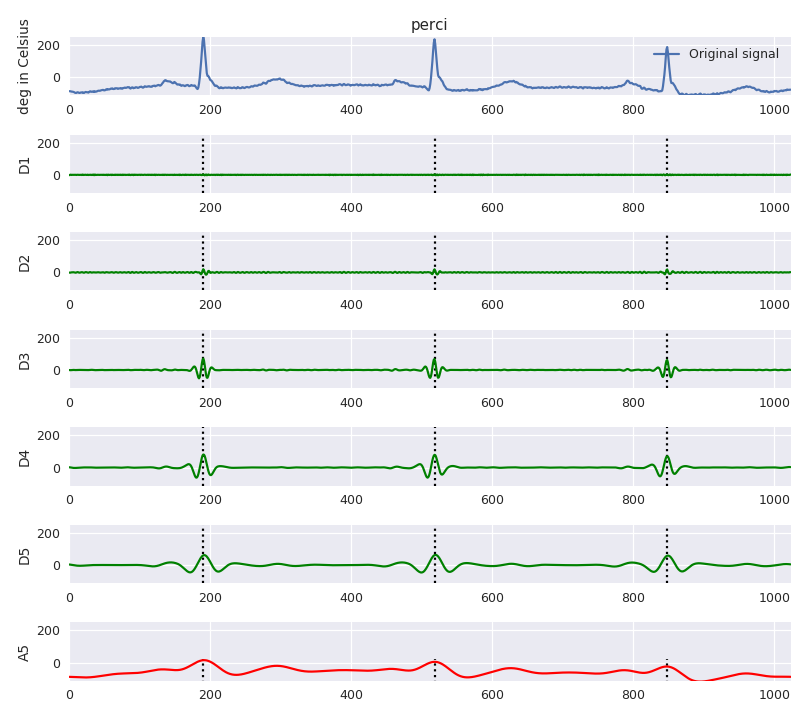

In [25]:
plot_percival_modwt(ecg, mra_mdwt, "perci", 5 )

In [13]:
def plot_modwt_(data, w, title, level, figsize=(10, 8), no_pad=False):

    assert isinstance(w, wv.Wavelet)

    coeffs = None
    if not no_pad:
        a = get_pad_data(data=data)
        ylim = [a.min(), a.max()]
        peak = find_peaks(a, height=0)[0]
        coeffs =  wv.swt(a, w, level=level, trim_approx=True, norm=True) #[(cAn, (cDn, ...,cDn-1, cD1)]
    else:
        a = data
        ylim = [a.min(), a.max()]
        peak = find_peaks(a, height=0)[0]
        coeffs = wv.swt(data, w, level=level, trim_approx=True, norm=True)

    _, axes = plt.subplots(len(coeffs) + 1, figsize=figsize, dpi=90)
    axes[0].set_title(title)
    axes[0].plot(a,  label='Original signal')
    axes[0].vlines(peak, ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted')
    axes[0].set_ylabel('deg in Celsius')
    axes[0].set_xlim(0, len(a) - 1)
    axes[0].set_ylim(ylim[0], ylim[1])
    axes[0].legend(loc=0)


    for i, _ in enumerate(coeffs):
        ax = axes[-i - 1]
        if i == 0:
            ax.set_ylabel("A%d" % (len(coeffs) - 1))
            ax.plot( coeffs[i], 'r')
            ax.vlines(peak, ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted')
        else:
            ax.set_ylabel("D%d" % (len(coeffs) - i))
            ax.plot( coeffs[i], 'g')
            ax.vlines(peak, ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted')
        # Scale axes
        ax.set_xlim(0, len(a) - 1)
        ax.set_ylim(ylim[0], ylim[1])

    plt.tight_layout()
    plt.savefig('Report/Wavelet/Methods/'+title+'.pdf', dpi=120)
    plt.savefig('Report/Wavelet/Methods/'+title+'.png', dpi=120)
    plt.show()


<IPython.core.display.Javascript object>


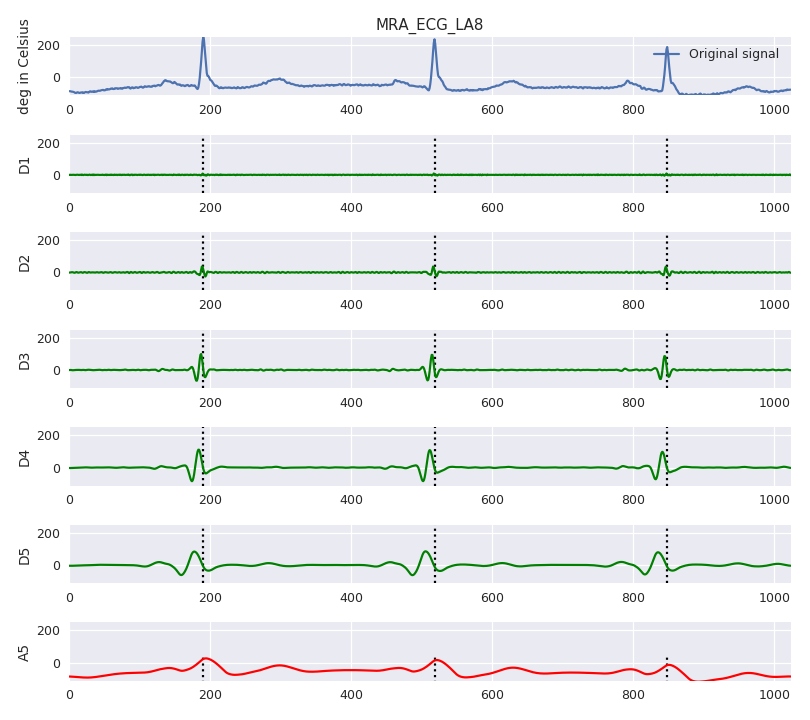

In [28]:
plot_modwt_(ecg, la8, "MRA_ECG_LA8", 5, figsize=(9, 8))

<IPython.core.display.Javascript object>


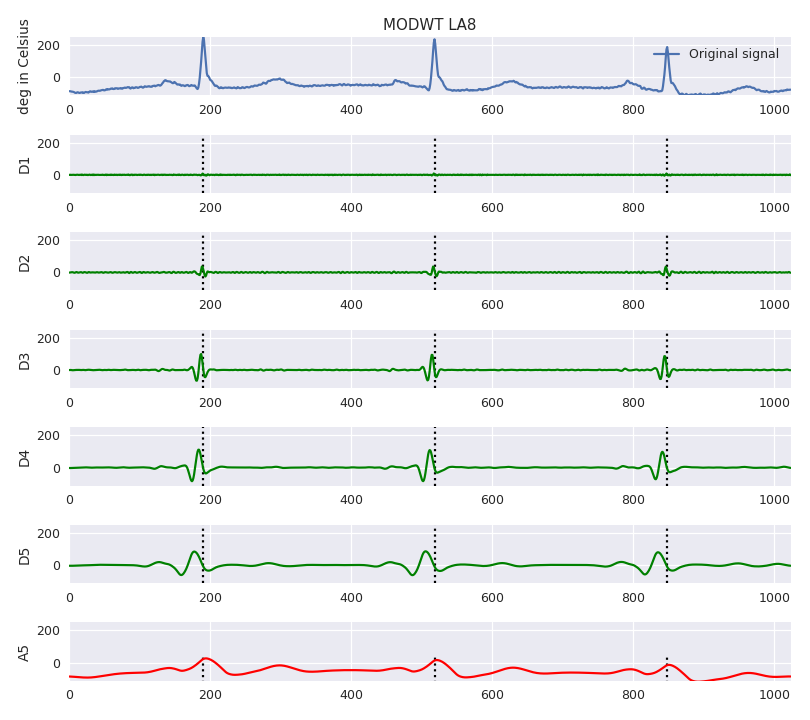

In [29]:
plot_modwt_(ecg, la8_modwt, "MODWT LA8", 5, figsize=(9, 8))

<IPython.core.display.Javascript object>


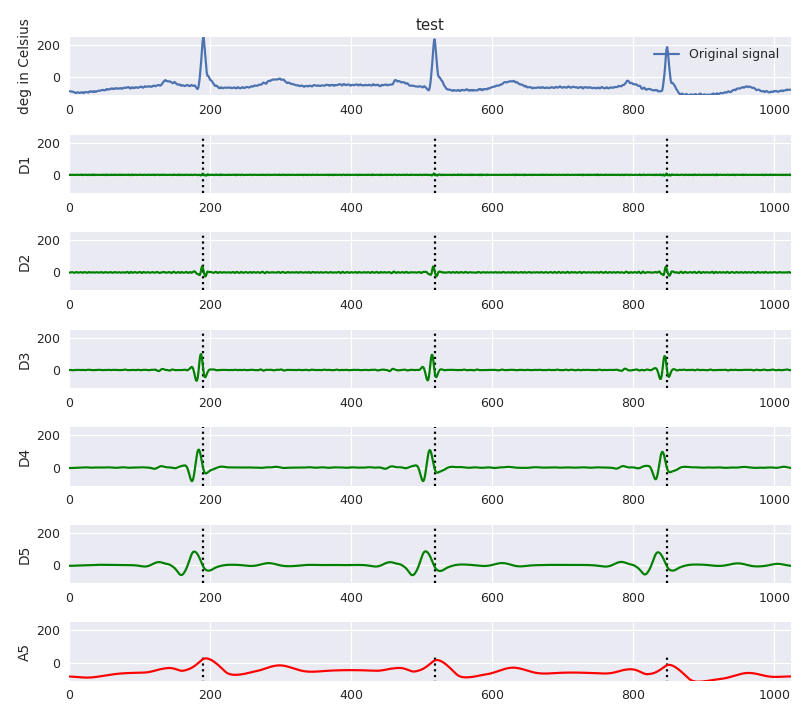

In [30]:
plot_modwt_(ecg, la8, "test", 5, figsize=(9, 8), no_pad=True)

<IPython.core.display.Javascript object>


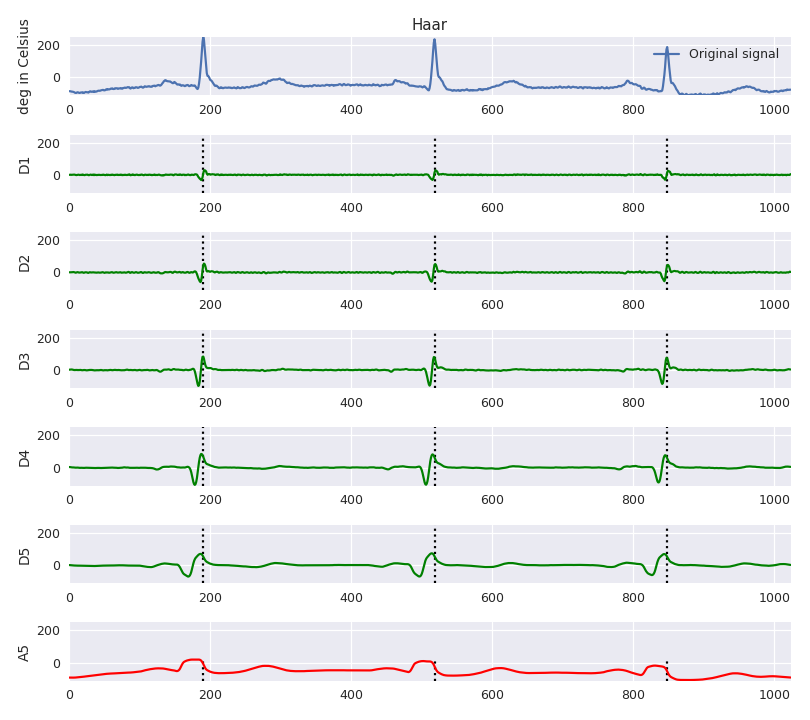

In [31]:
plot_modwt_(ecg, wv.Wavelet('haar'), "Haar", 5, figsize=(9, 8), no_pad=True)

<IPython.core.display.Javascript object>


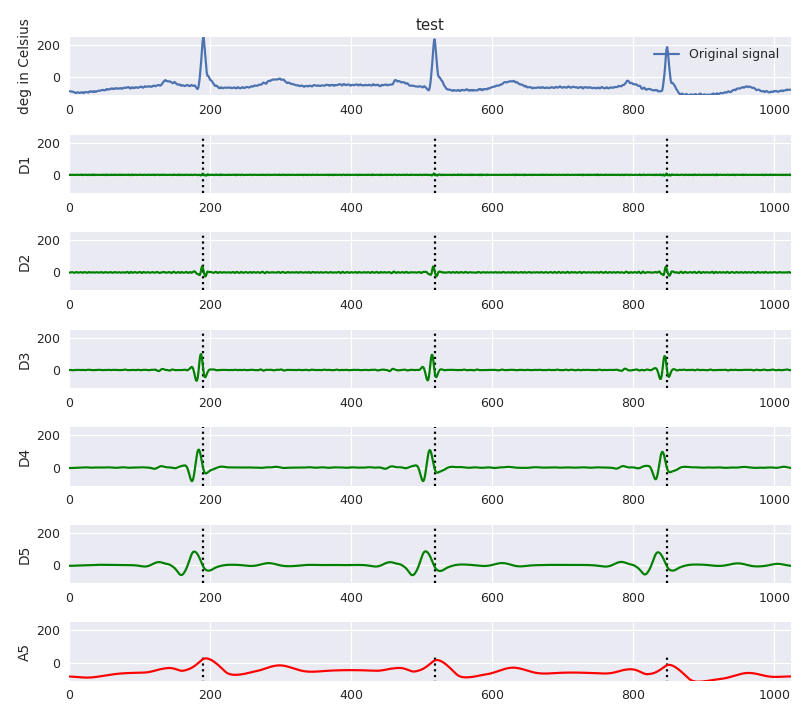

In [32]:
plot_modwt_(ecg, la8_modwt, "test", 5, figsize=(9, 8), no_pad=True)

### Investigate Variance of wavelet on scale and per scale

In [33]:
def show_level_variance(data, w, level_, title="Test", method="var", savefig=False, alpha=0.05):
#     from scipy.stats import skew Not useful
    assert isinstance(w, wv.Wavelet)
    data = get_pad_data(data)
    coeffs = wv.swt(data, wavelet=w,level=level_, trim_approx=True, norm=True)
    mra = translated_inv_modwt(data, w, level_)
    mra_details = mra[1:]
    ca = coeffs[0]
    details = coeffs[1:]

    print("Variance of the signal = {} std dev ={} ".format(np.var(data, ddof=1), np.std(data, ddof=1)))

    variances = [np.var(c, ddof=1) for c in coeffs]
    eta3 = [max( (len(data) - 2**(i - 1) + 1)/(2**(i)),1) for i in range(level_)]
    sample_var = [np.dot(c, c)/len(c) for c in details]
    perci_sm_var = [np.dot(c, c)/(len(data) - 2**(i - 1) + 1) for i, c in enumerate(details)]
    perci_std_lvl = [np.std(i, ddof=1) for _, i in enumerate(details)]
#     perci_skw_lvl = [skew(i) for _, i in enumerate(details)]
    perci_sc_var = [np.var(data, ddof=1)/(2*(2**(i - 1))) for i in range(level_)]
    appr_var = np.dot(ca, ca)/len(ca)
    mra_var = [np.var(c, ddof=1) for c in mra]
    mra_det_var = mra_var[1:]
    detail_variances = variances[1:]
    
    perci_sample_sum_var = np.sum(sample_var)+np.sum(appr_var) - np.mean(data)**2
    print("Sum of variance across all MODWT coefficients = {} and Percival mra_var = {} sample good var = {}  eta3 = {} Diff-org-sample good var = {}".format(
        np.sum(variances), np.sum(mra_var), perci_sample_sum_var, eta3, np.sum(variances) -perci_sample_sum_var))
    print("\n Stdev details per level = {} and approximation = {}".format(perci_std_lvl, 
                                                                                   np.std(ca, ddof=1)))
#     print("\n Skewness per level = {} and approx = {}".format(perci_skw_lvl, skew(ca)))
    
    conf_intv = np.zeros((len(coeffs)-1,2))
    if method == 'var':
        conf_intv[:,0] = (np.array(eta3)*np.array(perci_sm_var))/chdtri(eta3, 1 - alpha)
        conf_intv[:,1] = (np.array(eta3)*np.array(perci_sm_var))/chdtri(eta3, alpha)

    if method =='scale':
        conf_intv[:,0] = (np.array(eta3)*np.array(perci_sc_var))/chdtri(eta3, 1 - alpha)
        conf_intv[:,1] = (np.array(eta3)*np.array(perci_sc_var))/chdtri(eta3, alpha)
    
    
    # reorder from first to last level of coefficients
    level = np.arange(1, len(detail_variances) + 1)

#     # create a plot of the variance as a function of level
    plt.figure(figsize=(8, 6))
    fontdict = dict(fontsize=16, fontweight='bold')
#     plt.plot(level, detail_variances[::-1], 'k.', label='Sample Var unnormalised')
#     plt.plot(level, mra_det_var[::-1],'*', label='MRA')
    
    ci_low, ci_high = conf_intv[:,0], conf_intv[:,1]
    
    if method == "var":
#         plt.plot(level, sample_var, '-*', label='Sample Var')
        plt.plot(level, perci_sm_var,'--', label='Sample Var')
        plt.fill_between(level, ((perci_sm_var - ci_low)), (perci_sm_var + ci_high), 
                               color='r', alpha=0.3, label=r'95 % confidence interval')

    if method =="scale":
        plt.plot(level, perci_sc_var, label='Scale Var data per level')
        plt.fill_between(level, ((perci_sc_var - ci_low)), (perci_sc_var + ci_high), 
                               color='r', alpha=0.3, label=r'95 % confidence interval')
    plt.xlabel("Decomposition level", fontdict=fontdict)
    plt.ylabel("Variance", fontdict=fontdict)
    plt.title(title, fontdict=fontdict)
    plt.legend(loc=0)
    if savefig:
        plt.savefig('Report/Wavelet/Methods/'+title+'.pdf', dpi=120)
        plt.savefig('Report/Wavelet/Methods/'+title+'.png', dpi=120)
    plt.show()

Variance of the signal = 1575.5434384164223 std dev =39.69311575596482 
Sum of variance across all MODWT coefficients = 1575.5434384183634 and Percival mra_var = 1115.8024994602488 sample good var = 1574.0048217792855  eta3 = [1024.5, 512.0, 255.75, 127.625, 63.5625, 31.53125] Diff-org-sample good var = 1.5386166390778726

 Stdev details per level = [16.64204714424082, 19.65514333066146, 17.50926571833261, 12.192262669383219, 4.154673158760017, 1.1196936620258453] and approximation = 20.94087791786841


<IPython.core.display.Javascript object>


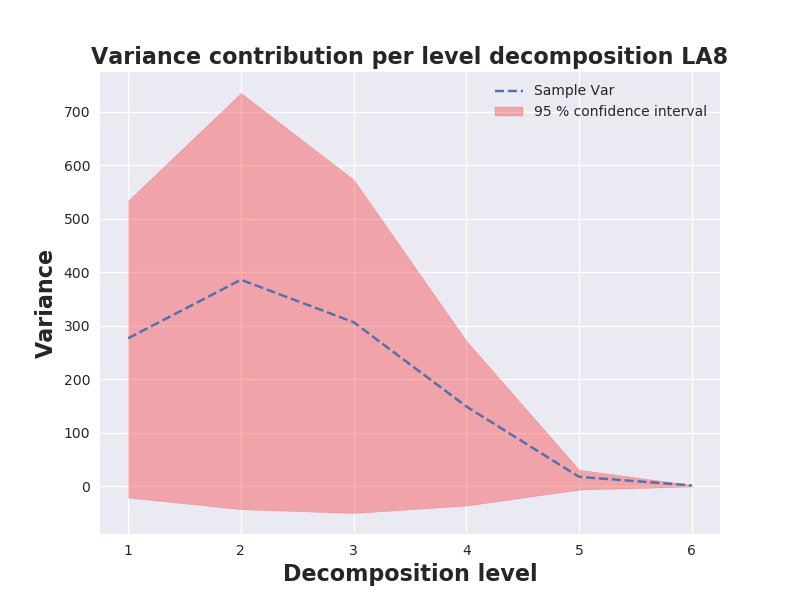

In [34]:
# %matplotlib notebook 
show_level_variance(ecg, la8, 6, title=f'Variance contribution per level decomposition LA8')

Variance of the signal = 1575.5434384164223 std dev =39.69311575596482 
Sum of variance across all MODWT coefficients = 1575.543438418107 and Percival mra_var = 1198.5755387011727 sample good var = 1574.00482177903  eta3 = [1024.5, 512.0, 255.75, 127.625, 63.5625] Diff-org-sample good var = 1.538616639076963

 Stdev details per level = [19.65514333066146, 17.50926571833261, 12.192262669383219, 4.154673158760017, 1.1196936620258453] and approximation = 26.748422404357726


<IPython.core.display.Javascript object>


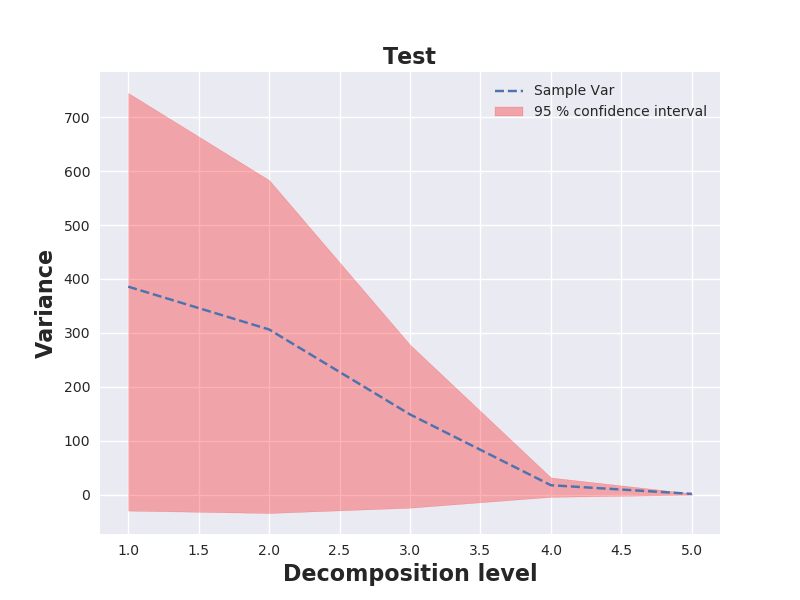

In [35]:
show_level_variance(ecg, la8, 5)

### Evaluate decomposition accuratedness by Normalized partial energy sequence

In [36]:
plt.get_cmap('hsv')

In [37]:
def npess(data):
    # https://pdfs.semanticscholar.org/0c8b/e141c9092ed389b9931ac09ec2e852d437c6.pdf appendix A3
    'Normalized partial energy sequence'
    U  = np.empty(len(data))

    for i, elem in np.ndenumerate(data):
        U[i] = elem**2

    U = np.array(sorted(U, reverse=True))

    return np.divide(np.cumsum(U),sum(U))

def plot_npess(npess, wave_coeff, wave_name,  title='Test', savefig=False):
    cmap = plt.get_cmap('hsv')
    my_colors = [cmap(i) for i in np.linspace(0, 1, len(wave_coeff))]
#     my_linestyles= ['-*'*i for i in range(len(wave_coeff))]
    for i, coeff in enumerate(wave_coeff):
        plt.plot(np.arange(len(npess)),coeff, '-x', color=my_colors[i], label='NPESS Wave_'+ wave_name+'_level_'+str(i))
    plt.plot(np.arange(len(npess)), npess, '-.', color='k', label='Original data')    
    plt.legend(loc=0)
    plt.xlabel('#Datapoints')
    plt.ylabel('Parital Energy')
    plt.title(title)
    if savefig == True:
        plt.savefig('Report/Wavelet/Methods/'+title+'_npess_analysis .pdf', dpi=120)
        plt.savefig('Report/Wavelet/Methods/'+title+'_npess_analysis .png', dpi=120)
#         plt.clf()
#         plt.close()
    plt.show()

<IPython.core.display.Javascript object>


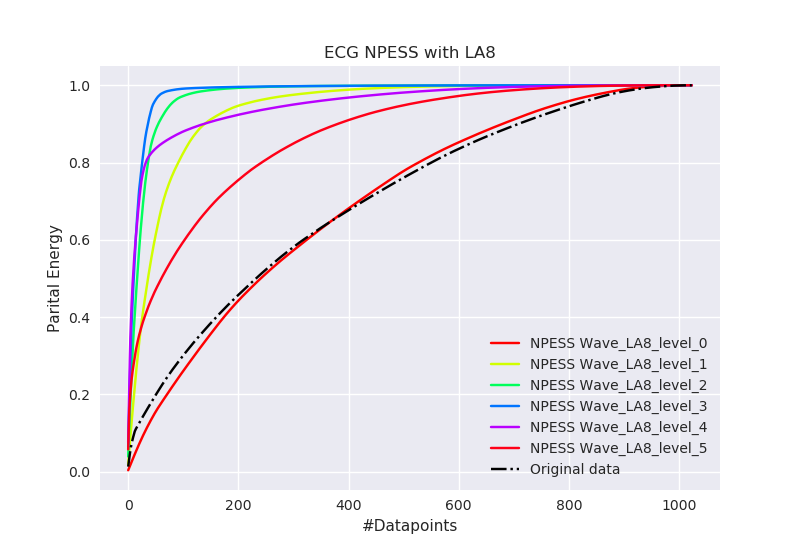

In [38]:
%matplotlib notebook
nps = npess(ecg)
coeffs_ecg = wv.swt(ecg, wavelet=la8,level=5, trim_approx=True, norm=True)
nps_coeff = np.array([npess(i) for i in coeffs_ecg])
plot_npess(nps,nps_coeff, title='ECG NPESS with LA8', wave_name='LA8', savefig=False)

In [909]:
# %matplotlib notebook
# test = nps_coeff
# for i, lvl in enumerate(test):
#     plt.plot(lvl, label='Level_'+str(i))
# plt.plot(nps,'--', label='original')
# plt.legend(loc=0)
# plt.show()

### Autocorrelation, Partial correlation, and Autocovariance of wavelet per level

In [39]:
def show_auto_per_level(data, coeffs, title='Test', figsize=(8, 8), method='autocorr', savefig=False):
    
    fig = plt.figure(figsize=figsize, dpi=120)
    fig.subplots_adjust(hspace=1.3, wspace=0.4)
    rows = None
    if len(coeffs) <= 10:
        if len(coeffs) %2 == 0:
            rows = len(coeffs)
        else:
            rows = len(coeffs) -1
    else:
        if len(coeffs) %2 == 0:
            rows = 8
        else:
            rows = 9
    if method=='autocorr':
        sm.graphics.tsa.plot_acf(data, fft=True, zero=False, unbiased=True, title='Original',ax=fig.add_subplot(rows, 1, 1))
    if method=='parcorr':
        sm.graphics.tsa.plot_pacf(data, zero=False, title='Original', ax=fig.add_subplot(rows, 1, 1))
    if method=='autocov':
        ax = fig.add_subplot(rows, 1, 1)
        ax.plot(sm.tsa.stattools.acovf(data, unbiased=True, fft=True))
        ax.set_title('Original')
    
    for i in range(len(coeffs)):
        if method == 'autocorr':
            if i == 0:
                sm.graphics.tsa.plot_acf(coeffs[i], zero=False, fft=True, unbiased=True, title='Approx Level '+str(len(coeffs)-1), ax=fig.add_subplot(rows, 1, 2))
            sm.graphics.tsa.plot_acf(coeffs[i], zero=False, fft=True, unbiased=True, title='Detail Level '+str(i), ax=fig.add_subplot(rows, 2, i + 5))
        if method == 'parcorr':
            if i == 0:
                sm.graphics.tsa.plot_pacf(coeffs[i], zero=False, title='Approx Level '+str(len(coeffs)-1), ax=fig.add_subplot(rows, 1, 2))
            sm.graphics.tsa.plot_pacf(coeffs[i], zero=False, title='Detail Level '+str(i), ax=fig.add_subplot(rows, 2, i + 5))
        if method == 'autocov':
            if i == 0 :
                ax = fig.add_subplot(rows, 1, 2)
                ax.plot(sm.tsa.stattools.acovf(coeffs[i], unbiased=True, fft=True))
                ax.set_title('Approx Level '+str(len(coeffs)-1))
            ax = fig.add_subplot(rows, 2, i + 5)
            ax.plot(sm.tsa.stattools.acovf(coeffs[i], unbiased=True, fft=True))
            ax.set_title('Detail Level '+str(i))
            

    fig.suptitle(title)
    if savefig == True:
        plt.savefig('Report/Wavelet/Methods/'+title+'_analysis .pdf', dpi=120)
        plt.savefig('Report/Wavelet/Methods/'+title+'_analysis .png', dpi=120)
    plt.show()

<IPython.core.display.Javascript object>


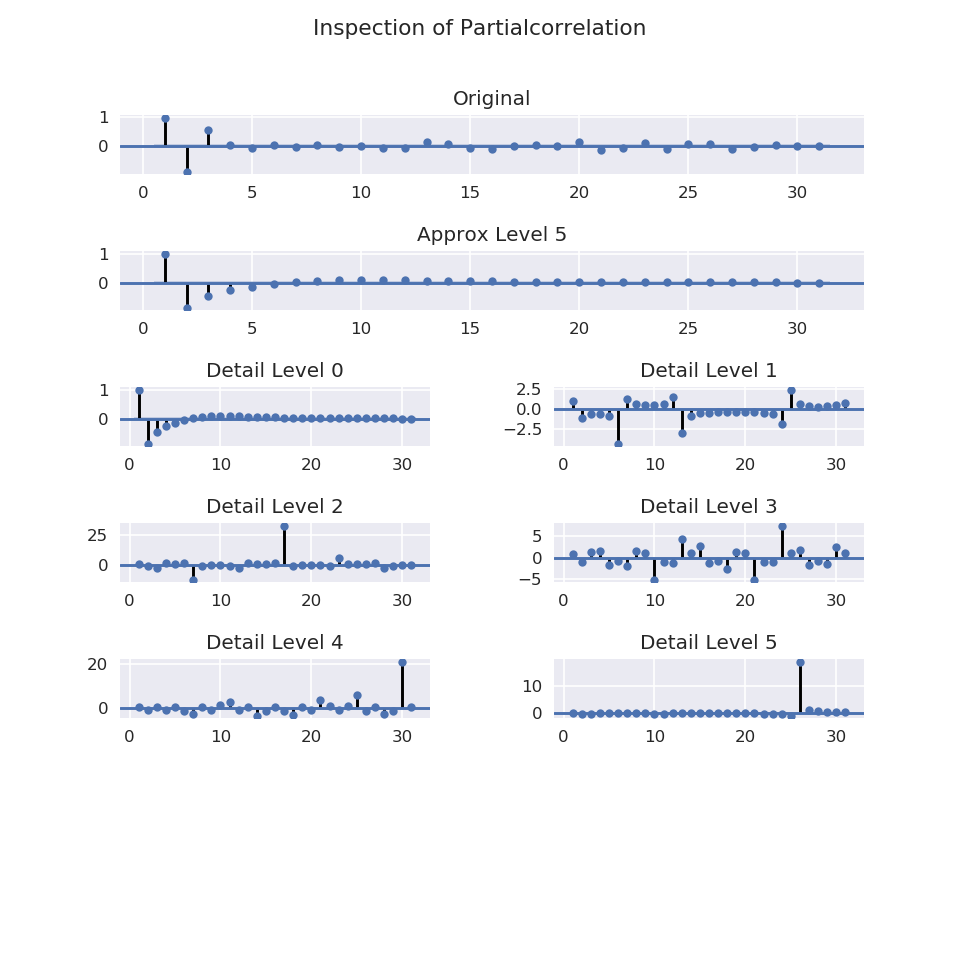

In [40]:
show_auto_per_level(ecg, coeffs_ecg, title='Inspection of Partialcorrelation', method='parcorr', savefig=False)

<IPython.core.display.Javascript object>


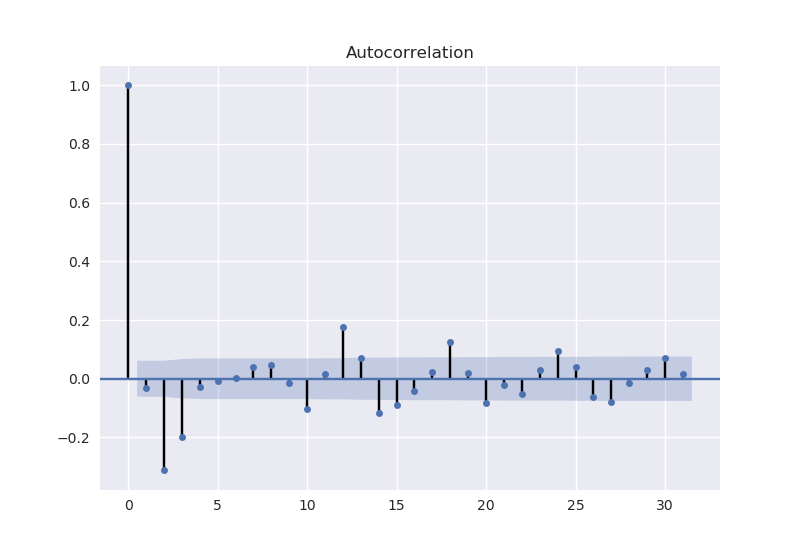

<IPython.core.display.Javascript object>


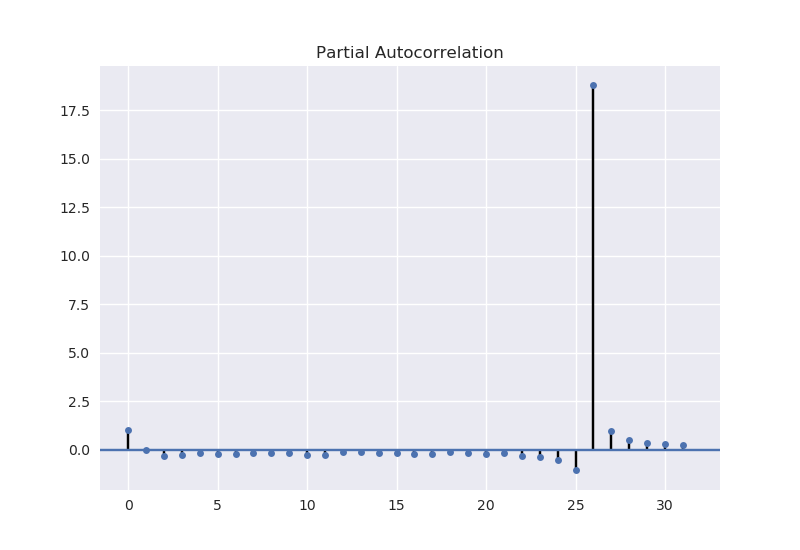

<IPython.core.display.Javascript object>


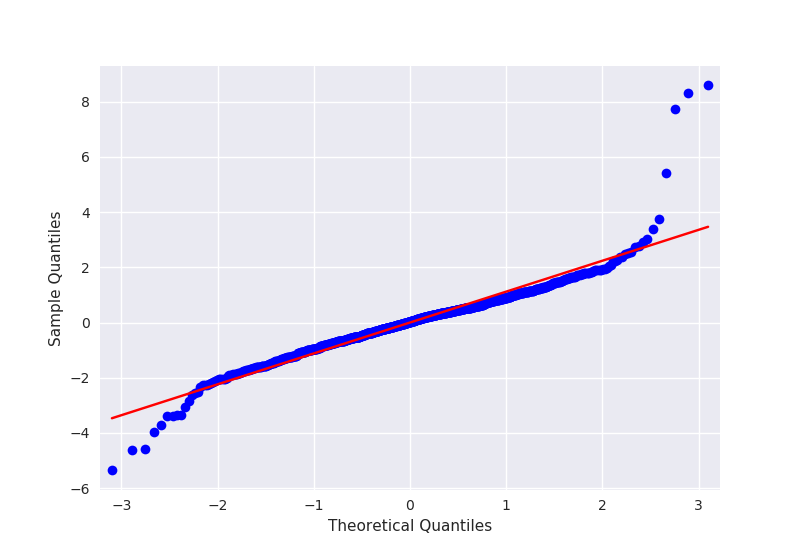

In [41]:
%matplotlib notebook
sm.graphics.tsa.plot_acf(coeffs_ecg[5], fft=True, unbiased=True)
sm.graphics.tsa.plot_pacf(coeffs_ecg[5])
sm.qqplot(coeffs_ecg[5], line='s')
plt.show()

<IPython.core.display.Javascript object>


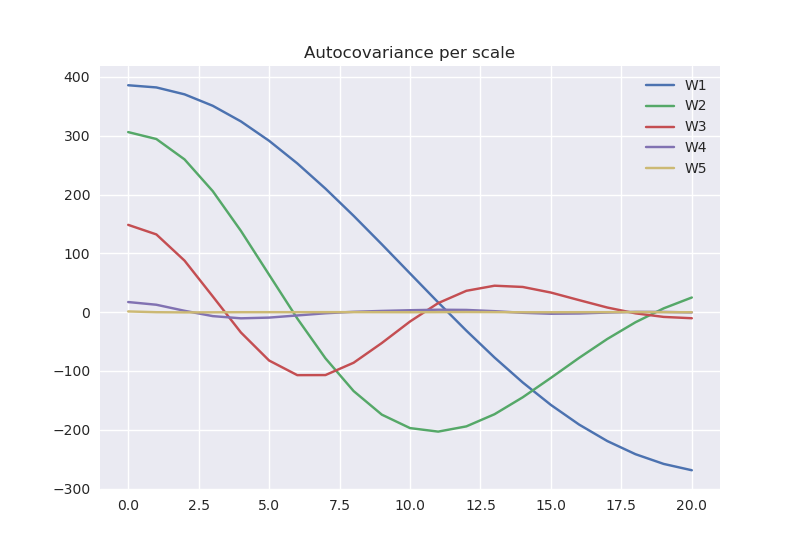

In [42]:
%matplotlib notebook
plt.plot(sm.tsa.stattools.acovf(coeffs_ecg[1], unbiased=True, fft=True, nlag=20), label='W1')
plt.plot(sm.tsa.stattools.acovf(coeffs_ecg[2], unbiased=True, fft=True, nlag=20), label='W2')
plt.plot(sm.tsa.stattools.acovf(coeffs_ecg[3], unbiased=True, fft=True, nlag=20), label='W3')
plt.plot(sm.tsa.stattools.acovf(coeffs_ecg[4], unbiased=True, fft=True, nlag=20), label='W4')
plt.plot(sm.tsa.stattools.acovf(coeffs_ecg[5], unbiased=True, fft=True, nlag=20), label='W5')
plt.legend(loc=0)
plt.title("Autocovariance per scale")
plt.show()

### Cross-correlation wavelet per scale 

In [43]:
# %matplotlib notebook
# Dont use this, not standardized and below only reflect wavelet in its lag vorm!
# plt.xcorr(coeffs_ecg[1], coeffs_ecg[2], maxlags=20, usevlines=True, normed=True, label='W1-W2')
# plt.xcorr(coeffs_ecg[2], coeffs_ecg[3], maxlags=20, usevlines=True, normed=True,label='W2-W3')
# plt.xcorr(coeffs_ecg[3], coeffs_ecg[4], maxlags=20, usevlines=True, normed=True, label='W3-W4')
# plt.xcorr(coeffs_ecg[4], coeffs_ecg[5], maxlags=20, usevlines=True, normed=True,label='W4-W5')
# plt.plot(sm.tsa.stattools.ccf(coeffs_ecg[1], coeffs_ecg[2]), label='SM')
# plt.axhline(0.2, color='blue', linestyle='dashed', lw=2)
# plt.legend(loc=0)
# plt.title("Cross-correlation between scales")
# plt.show()

<IPython.core.display.Javascript object>


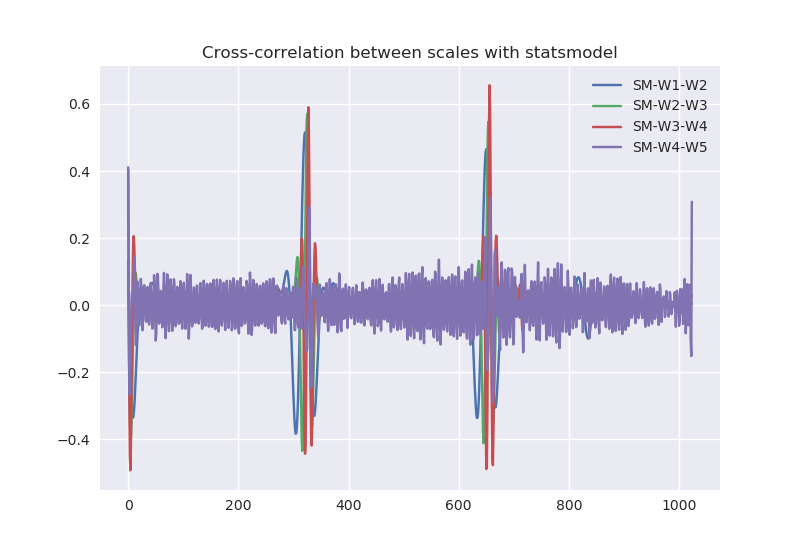

In [44]:
%matplotlib notebook
plt.plot(sm.tsa.stattools.ccf(coeffs_ecg[1], coeffs_ecg[2]), label='SM-W1-W2')
plt.plot(sm.tsa.stattools.ccf(coeffs_ecg[2], coeffs_ecg[3]), label='SM-W2-W3')
plt.plot(sm.tsa.stattools.ccf(coeffs_ecg[3], coeffs_ecg[4]), label='SM-W3-W4')
plt.plot(sm.tsa.stattools.ccf(coeffs_ecg[4], coeffs_ecg[5]), label='SM-W4-W5')
plt.legend(loc=0)
plt.title('Cross-correlation between scales with statsmodel')
plt.show()

In [45]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=15, mode=wv.Modes.periodic)

In [46]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=15, mode=wv.Modes.periodic, method="coeff")

In [47]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=15, mode=wv.Modes.periodic, method="recon")

In [48]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=7, mode=wv.Modes.periodic, method="modwt")

## Decompose and reconstruct signal

### Pad data for MODWT

In [21]:
def get_pad_width(data):
    x  = np.log2(len(data))
    x = math.ceil(x) 
    diff = 2**x - len(data)
    return diff//2

def get_pad_level(data):
    return math.ceil(np.log2(len(data)))

def get_pad_data(data):
    pad_width = get_pad_width(data)
    return np.pad(data, pad_width=pad_width, mode='reflect')

def unpad_data(data, pad_width):
    return data[pad_width:-pad_width]

### Decompose signal and reconstruct

In [22]:
def decompose_signal(data, w, mode, level, debug=False):
    assert isinstance(w, wv.Wavelet)
    cA, cD = [] , []
    s_prec  = data 
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        print(f"Appropriate level is changed to {level}")
    else:
        level_ = None
    for i in range(level):
        s_prec, det  = wv.dwt(s_prec, w, mode=mode)
        cA.append(s_prec)
        cD.append(det)
    if debug:
        print(f'[DEBUG]')
        for i, value in enumerate(cD):
            print(f' Level {i} decomposition Length coefficient {value}')
    return cA, cD, level 
def decompose_signal_modwt(data, w, mode, level, unpad=True,  debug=True):
    assert isinstance(w, wv.Wavelet)
    pad_width = get_pad_width(data)
    a = get_pad_data(data=data)
    level_ = get_pad_level(data)
    if level > level_:
        level = level_
        print("[INFO] Appropriate level is changed to ", level)
    else:
        level_ = None

    coeffs =  wv.swt(a, w, level=level, trim_approx=True, norm=True) #[(cAn, (cDn, ...,cDn-1, cD1)]
    if unpad:
        temp = []
        for i, coeff in enumerate(coeffs):
            if debug:
                print(f'Length unpadded coeffs {len(coeff)}\n')
            temp.append(unpad_data(coeff, pad_width))
            if debug:
                print(f'Length after padding {len(temp[i])}\n')
        return temp
    else:
        return coeffs
def reconstruct_signal(data, w, mode, level, debug=False):
    """Decompose and reconstruct S.
    S = An + Dn + Dn-1 + ... + D1
    """
    assert isinstance(w, wv.Wavelet)
    a = data
    ca = []
    cd = []
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        print("Appropriate level is changed to ", level)
    else:
        level_ = None 
    for i in range(level):
        (a, d) = wv.dwt(a, w, mode)
        ca.append(a)
        cd.append(d)

    rec_a = []
    rec_d = []

    for i, coeff in enumerate(ca):
        coeff_list = [coeff, None] + [None] * i
        rec_a.append(wv.waverec(coeff_list, w, mode=mode))
        if debug:
            print(f'[DEBUG] Length reconstruction approx  index {len(coeff_list)} length coeffs {len(coeff)} length recon {len(rec_a[i])}')

    for i, coeff in enumerate(cd):
        coeff_list = [None, coeff] + [None] * i
        rec_d.append(wv.waverec(coeff_list, w, mode=mode))
    return rec_a, rec_d, ca, cd

#### Extract, check and rebuild signal

In [23]:
def extract_signal_at_level(original_signal, signal, level):
#     print(f"[INFO] Level to extract {level} and length signal coeffs {len(signal)}")
    assert len(signal[level]) <= len(original_signal), f"[ERROR] Wavelet introduce longer signal length at given level {len(signal[level])} vs data length {len(original_signal)} "
    return signal[level] if level <= len(signal) else None

In [24]:
def check_correct_level_extracted(ex_signal, signal, level, modwt=True):
    assert level != len(signal), f"[ERROR] Array start at 0, so do not confuse level {level} decomp and length of signal {len(signal)}\n"
    if not modwt == True:
        return np.array_equiv(ex_signal, signal[level])
    else:
        return np.allclose(ex_signal, signal[level])
    
def get_precursor_from_target_decomposition(low_freq_signal, high_freq_signal, original_signal, extract_at, wave, mode, modwt=False, debug=False):
    if debug == True:
        print(f'\n[INFO] Give modwt as high_freq_signal and set low_freg_signal to None' )
    if not modwt == True:
        ex_td = extract_signal_at_level(signal=high_freq_signal, level=extract_at, original_signal=original_signal)
        ex_ta = extract_signal_at_level(signal=low_freq_signal, level=extract_at, original_signal=original_signal)
        if check_correct_level_extracted(ex_signal=ex_td, signal=high_freq_signal, level=extract_at) and \
        check_correct_level_extracted(ex_signal=ex_ta, signal=low_freq_signal, level=extract_at):
            return wv.waverec([ex_ta, ex_td], wave, mode)
    else:
        ex_mod = extract_signal_at_level(signal=high_freq_signal, original_signal=get_pad_data(original_signal), level=extract_at)
        if check_correct_level_extracted(ex_signal=ex_mod, signal=high_freq_signal, level=extract_at, modwt=modwt):
 
            pd_width = get_pad_width(original_signal)
            unpadded_signal = unpad_data(data=ex_mod, pad_width=pd_width)
            return unpadded_signal

In [25]:
def build_up_to_level(data, w, mode, level, to_omit_level, debug=False):
    if debug == True:
        print('[INFO] Know that to_omit_level needs to be 1 indexed instead of 0 indexed')
    
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        if debug == True:
            print("[INFO] Appropriate level is changed to ", level)
    else:
        level_ = None 
        
    coeffs  = wv.wavedec(data, w, mode, level)
    if debug == True:
        print(f'[INFO] Length decomposed coefficients is {len(coeffs)} to omit level size {to_omit_level+1} + 1')
    
    assert to_omit_level+1 <= len(coeffs), f"[ERROR] To omit level need to be  strictly one less than decomposition {level} and length coeffs {len(coeffs)}"
    coeffs[-to_omit_level+1] = np.zeros_like(coeffs[-to_omit_level+1])
    return wv.waverec(coeffs, w, mode)

def build_up_modwt_level(data, w, mode, level, to_omit_level, debug=False):
    assert isinstance(w, wv.Wavelet)
    if debug == True:
        print('\n[INFO] Know that to_omit_level needs to be 1 indexed instead of 0 indexed')
    a = get_pad_data(data=data)
    pd_width = get_pad_width(data)
    level_ = get_pad_level(data)
    if level > level_:
        level = level_
        if debug == True:
            print(f"\n[INFO] Appropriate level is changed to  {level}")
    else:
        level_ = None

    coeffs =  wv.swt(a, w, level=level, trim_approx=True, norm=True) #[(cAn, (cDn, ...,cDn-1, cD1)]
    if debug:
        print(f'[INFO] Length decomposed coefficients is {len(coeffs)} to omit level size {to_omit_level+1} + 1')

    assert to_omit_level+1 <= len(coeffs), f"\n[ERROR] To omit level need to be strictly one less than decomposition {level} and len coeffs {len(coeffs)}"
    coeffs[-to_omit_level+1] = np.zeros_like(coeffs[-to_omit_level+1])
    return unpad_data(wv.iswt(coeffs, w, mode), pad_width=pd_width)

#### Test case boundaries

In [54]:
a = np.arange(1, 7)
print(a)
print(np.pad(a, 2, 'symmetric'), np.pad(a, 2, 'symmetric')[2:-2])
print(np.pad(a, 2, 'reflect'), np.pad(a, 2, 'reflect')[2:-2])

[1 2 3 4 5 6]
[2 1 1 2 3 4 5 6 6 5] [1 2 3 4 5 6]
[3 2 1 2 3 4 5 6 5 4] [1 2 3 4 5 6]


In [26]:
mod_coeffs = decompose_signal_modwt(target_arr, w=la8, mode=wv.Modes.periodic, level=12, debug=False)

In [56]:
print(len(mod_coeffs), len(mod_coeffs[1:]))

13 12


In [57]:
print(list(range(11)), list(range(12)) )

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]


In [58]:
temp = mod_coeffs[1:]
print(np.array_equal(temp[-12], temp[0]))

True


#### Visualize unpadded data for MODWT

In [33]:
def plot_unpad_modwt(coeffs, title, data):
    _, axes = plt.subplots(len(coeffs) + 1, figsize=(8, 10), constrained_layout=True, dpi=120)
    axes[0].set_title(title)
    axes[0].plot(data, 'k', label='Original signal')
    axes[0].set_ylabel(r'C$^{\circ}$')
#     axes[0].set_xlim(0, len(coeffs[0]) - 1)

    axes[0].legend(loc=0)
    for i, _ in enumerate(coeffs):
        ax = axes[-i - 1]
        if i == 0:
            ax.set_ylabel("A%d" % (len(coeffs) - 1))
            ax.plot( coeffs[i], 'r')
        else:
            ax.set_ylabel("D%d" % (len(coeffs) - i))
            ax.plot( coeffs[i], 'g')

In [31]:
mods = decompose_signal_modwt(target_arr, w=la8, mode=wv.Modes.periodic, level=9, debug=False)

In [35]:
mods_ = decompose_signal_modwt(target_arr, w=la8_modwt, mode=wv.Modes.periodic, level=9, debug=False)

<IPython.core.display.Javascript object>


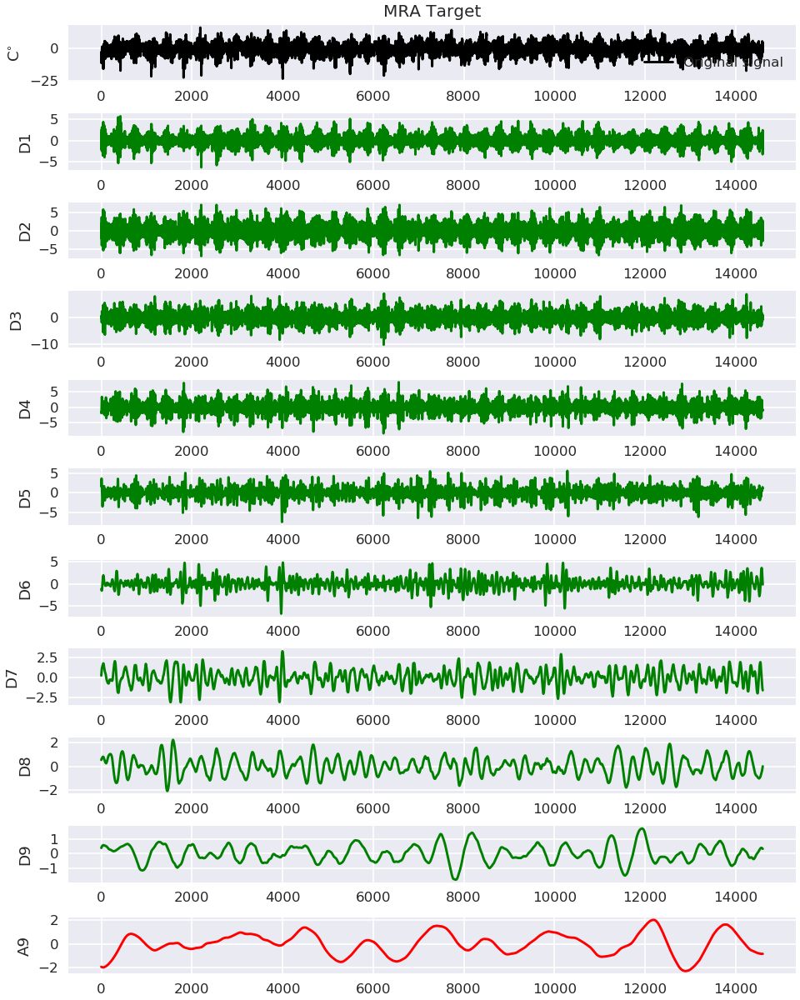

In [34]:
plot_unpad_modwt(mods, data=target_arr, title=f'MRA Target')

<IPython.core.display.Javascript object>


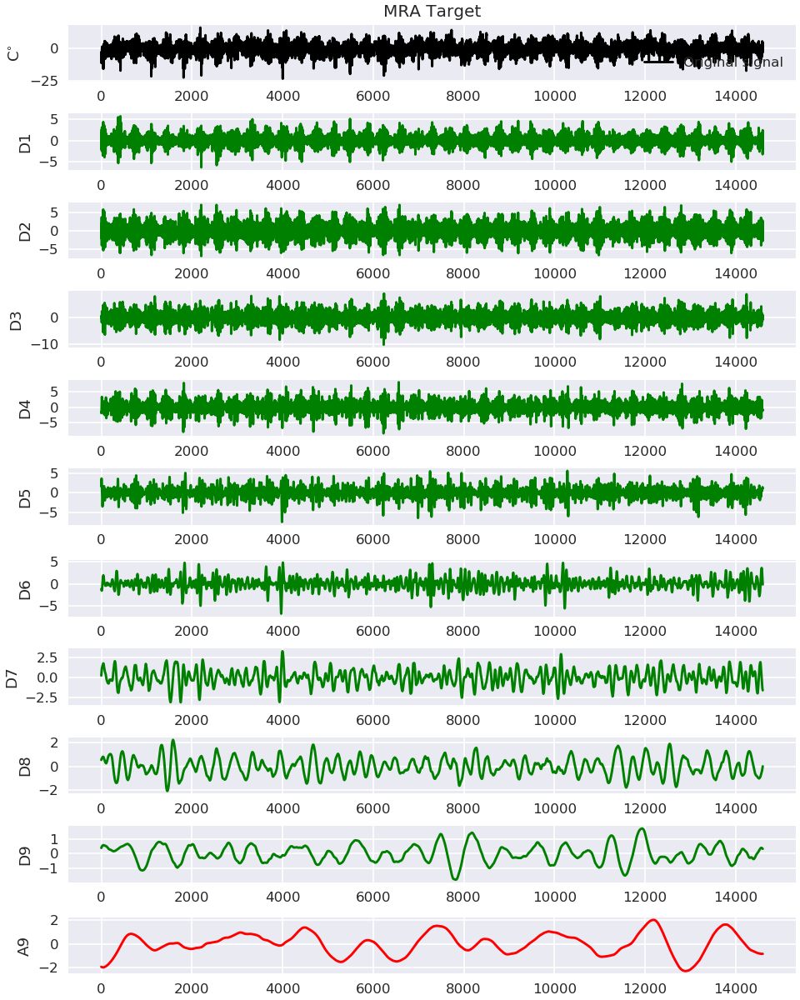

In [36]:
plot_unpad_modwt(mods_, data=target_arr, title=f'MRA Target')

In [61]:
def get_difference_recon_signal_from_target(target, recon_target):
    return target-recon_target

# Polynome

In [62]:
import synthetic_data as sd 
from statsmodels.regression.linear_model import yule_walker
from statsmodels.tsa.stattools import adfuller, kpss 
from sklearn.preprocessing import PowerTransformer, QuantileTransformer
from sklearn.linear_model import LinearRegression 
target_col = '3ts'
prec_col = 'precursor'

## Stationarity test

In [63]:
def stationarity_test(serie, regression='c', debug=False):
    
    adf = None
    try:
        # ADF Test
        results = adfuller(serie, autolag='AIC')
        if debug == True:
            print(f'[DBEUG] ADF Statistic: {results[0]}')
            print(f'[DEBUG] p-value: {results[1]}')
            print('[DEBUG] Critial Values:')
            for key, value in results[4].items():
                print(f'   {key}, {value}')
        print(f'[INFO] Result ADF: The serie is {"NOT " if results[1] > 0.05 else ""}stationary')
        adf = False if results[1] > 0.05 else True
    except ValueError as err:
        print(f'[ERROR] {err}. Using polynomial root testing to evaluate')
        ts = np.polynomial.polynomial.Polynomial(serie)
        print(f'[INFO] Polynomial Time Serie {ts} and its roots {ts.roots()}')
        adf = np.all([True if i.real > 1.0 else False  for i in  ts.roots() ])
        print(f'[INFO] ADF with roots testing stationarity is  {adf}')


    # KPSS Test
    result = None
    if regression == 'c':
        result = kpss(serie, regression='c', lags='auto')
        print(f'[INFO] Result KPSS: The mean of the serie is {"NOT " if result[1] < 0.05 else ""}stationary')
    else:
        result = kpss(serie, regression=regression, lags='auto')
        print(f'[INFO] Result KPSS: The trend of the serie is {"NOT " if result[1] < 0.05 else ""}stationary')
    if debug == True:
        print(f'\n [DEBUG] KPSS Statistic:  {result[0]} ')
        print(f'[DEBUG] p-value: {result[1]} ')
        print('[DEBUG] Critial Values:')
        for key, value in result[3].items():
            print(f'   {key}, {value}')
    kps = False if result[1] < 0.05 else True
    return (adf , kps)

## Preprocessing: standardising and standard normal test

In [64]:
def preprocess_ts(serie, col, threshold=0.05, to_serie=True,  debug=False):
    from scipy.stats import normaltest
    print(f'\n[INFO] Preprocessing Time serie \'{col}\' with first standardising and checking for gaussian like p-value ')
    normalize = lambda x : (x - x.mean())/ x.std()
    serie = serie.apply(normalize, axis=0)
    index = serie.index
    p_value = normaltest(serie)[1][0]
    print(f'\n[INFO] Time serie p_value  {p_value}  ')
    stat_bool = stationarity_test(serie=serie[col], debug=debug)
    print(f'[INFO] Transformed time serie staionarity test ADF {stat_bool[0]},  KPSS {stat_bool[1]}\n')
    if p_value < threshold :
        print('\n[INFO] Time serie is gaussian like \n')
        if to_serie:
            return serie[col]
        else:
            return serie[col].values
    else:
        print('[INFO] Time serie is non-gaussian, tranforming the time serie to gaussian like approximation')
        pt = PowerTransformer(method='yeo-johnson', standardize=True)
        trans_serie = pt.fit_transform(serie[col].values.reshape(-1, 1))
        qt = QuantileTransformer(output_distribution='normal').fit_transform(serie[col].values.reshape(-1, 1))
        p_value_qt = normaltest(qt)[1][0]
        p_value_pt = normaltest(trans_serie)[1][0]
        print(f'[INFO] Gaussian approximation with PT p-value {p_value_pt} or QT {p_value_qt}')
        trans_df = None
        if p_value_pt > p_value_qt:
            trans_df = pd.DataFrame(data=np.ravel(qt), index=index, columns=[col])
        else:
            trans_df = pd.DataFrame(data=np.ravel(trans_serie), index=index, columns=[col])
        stat_bool = stationarity_test(serie=trans_df[col], debug=debug)
        if stat_bool[0] == True:
            print(f'[INFO] Transformed time serie is stationair ADF {stat_bool[0]},  KPSS {stat_bool[1]}\n')
            if to_serie:
                return trans_df[col]
            else:
                return trans_df[col].values
        else:
            return trans_df[col]

## Fit data in AR (Yule-walker)

In [65]:
def evaluate_data_ar(data, order=2, method='mle'):
    return yule_walker(data, order, method)

## Construction polynoom dependance

In [66]:
def construct_polynoom(ar, const, data, sigma, yule_walker= True):
    N =  len(data)
    epsilon = np.random.normal(loc=0, scale= sigma, size=N)
    simul_data = np.zeros(N)
    simul_data[0] = const + epsilon[0]
    ar_0, ar_1 = ar[0], ar[1]
    simul_data[1] =  const + ar_0 * simul_data[0] + epsilon[1]
    for i in range(2, N):
        simul_data[i] = const + (ar_0 * simul_data[i -1]) + (ar_1 * simul_data[i - 2]) + epsilon[i]
    print('\n[INFO] Polynomial fit done without dependance.')
    if yule_walker == True:
        print('\n[INFO] Yule walker standardisation')
        simul = np.array([(i - np.mean(simul_data))/(np.std(simul_data)) for i in simul_data])    
        return simul 
    else:
        return simul_data

In [67]:
def construct_polynoom_dependance(ar, const, data, sigma, gamma, X, yule_walker=True):
    pass

In [68]:
def construct_polynoom_precursor(ar, const, data, sigma, nu, yule_walker=True):
    N =  len(data)
    epsilon = np.random.normal(loc=0, scale= sigma, size=N)
    simul_data = np.zeros(N)
    simul_data[0] = const + epsilon[0]
    ar_0, ar_1 = ar[0], ar[1]
    simul_data[1] =  const + (nu *ar_0 * simul_data[0] ) + epsilon[1]
    for i in range(2, N):
        simul_data[i] = const + (nu *(ar_0 * simul_data[i -1])) + (nu *(ar_1 * simul_data[i - 2])) + epsilon[i]
    print('\n[INFO] Polynomial fit done for precursor.')
    if yule_walker == True:
        print('\n[INFO] Yule walker standardisation')
        simul = np.array([(i - np.mean(simul_data))/(np.std(simul_data)) for i in simul_data])    
        return simul 
    else:
        return simul_data

# Create Causal effect network

## Setup RGCPD format

In [69]:
def set_up_rgcpd_format(precursor, target, col=['mod_3ts', '3ts'], period=('06-01', '08-31'), index=rg_index):
    mod_target_df  = pd.DataFrame(data=precursor, index=pd.MultiIndex.from_product(([0], index)), columns=[col[0]])
    mod_target_df = preprocess_ts(mod_target_df, col[0])
    poly_target_df = pd.DataFrame(data=target, index= pd.MultiIndex.from_product(([0], index)), columns=[col[1]])
    poly_target_df = preprocess_ts(poly_target_df, col[1])
    dates = core_pp.get_subdates(dates=index, start_end_date=period, start_end_year=None, lpyr=False)
    RV_mask = pd.Series(np.array([True if d in dates else False for d in rg_index]), index=pd.MultiIndex.from_product(([0], index)), name='RV_mask')
    trainIsTrue = pd.Series(np.array([True for _ in range(len(target))]), index=pd.MultiIndex.from_product(([0], index)), name='TrainIsTrue')
    return pd.concat([poly_target_df, mod_target_df, trainIsTrue, RV_mask], axis=1)

## Create MCI

In [70]:
def mci_default(dFrame, tau_max=2, pc_alpha=0.05, debug=False):
    obj_rgcpd = []
    obj_pmatrix = []
    rg.df_data = dFrame
    rg.PCMCI_df_data(tau_max=tau_max, pc_alpha=pc_alpha)
    rg.PCMCI_get_links()
    rg.df_MCIc
    obj_rgcpd.append(deepcopy(rg.df_MCIc))
    obj_pmatrix.append(deepcopy(rg.pcmci_results_dict[0]['p_matrix']))
    if debug == True:
        rg.PCMCI_plot_graph()
        plt.show()
    return obj_rgcpd, obj_pmatrix

In [71]:
# date = pd.to_datetime("4th of July, 2015")
# date

# date.strftime('%A')

# date + pd.to_timedelta(np.arange(12), 'D')

# pd.offsets.Day(4)

# # pd.to_timedelta(np.arange(12), pd.offsets.Day(2))

In [72]:
rg_exp = RGCPD(list_of_name_path=list_of_name_path,
           list_for_MI=list_for_MI,
           start_end_TVdate=('06-01', '08-31'),
           path_outmain=os.path.join(current_analysis_path,'tigramite_exp'),
           append_pathsub='baseline')
rg_exp.pp_precursors(detrend=True, anomaly=True, selbox=None)
rg_exp.pp_TV()
rg_exp.traintest(method='no_train_test_split')
rg_exp.calc_corr_maps()
rg_exp.cluster_list_MI()
rg_exp.get_ts_prec(precur_aggr=1)

Loaded pre-processed data of sst

original tfreq of imported response variable is converted to desired tfreq 10
Daily input freq
No train test split

sst - calculating correlation maps
Progress traintest set 100%, trainsize=(400dp, 100%)

redefine target variable on 1 day means
Selecting subset as defined by start_end_date
Daily input freq
No train test split

Getting MI timeseries
There are [2] regions in total (list of different splits)


In [73]:
def per_level_mci(cA, cA_t, rg=rg_exp, rg_index=rg_index, level_test=True, tau_min=0,  tau_max=2, pc_alpha=0.05, debug=False):
    obj_rgcpd = []
    obj_pmatrix = []
    for i in range(0,len(cA_t)):
        idx_lvl_t = pd.DatetimeIndex(pd.date_range(rg_index[0] ,end=rg_index[-1], periods=len(cA_t[i]) ).strftime('%Y-%m-%d') )
        idx_prec = pd.DatetimeIndex(pd.date_range(rg_index[0], rg_index[-1], periods=len(cA) ).strftime('%Y-%m-%d') )
   
        dates = core_pp.get_subdates(dates=idx_lvl_t, start_end_date=('06-01', '08-31'), start_end_year=None, lpyr=False)
        full_time  = idx_lvl_t
        RV_time  = dates
        RV_mask = pd.Series(np.array([True if d in RV_time else False for d in full_time]), index=pd.MultiIndex.from_product(([0], idx_lvl_t)), name='RV_mask')
        trainIsTrue = pd.Series(np.array([True for _ in range(len(cA_t[i]))]), index=pd.MultiIndex.from_product(([0], idx_lvl_t)), name='TrainIsTrue')
        if level_test:
            ts_ca1 = pd.Series(cA, index=pd.MultiIndex.from_product(([0], idx_prec)),name='p_1_lvl_'+ str(i)+'_dec')
            ts_ca_shift = pd.Series(cA, index=pd.MultiIndex.from_product(([0], idx_prec)),name='p_shift_lvl_'+ str(i)+'_dec')
            ts_tca1 = pd.Series(cA_t[i], index=pd.MultiIndex.from_product(([0],idx_lvl_t)), name='3ts')
            df = pd.concat([ts_tca1, ts_ca1, ts_ca_shift, trainIsTrue, RV_mask], axis=1)
            
#             if i == 0 or i == 1:
#                 shift = 2**(i+1)
#                 new_index = pd.MultiIndex.from_product(([0], pd.DatetimeIndex(pd.date_range(rg_index[0] , periods=len(cA_t[i])+shift, freq='D' ).strftime('%Y-%m-%d'))))
#                 df.reindex(new_index)
#                 df.iloc[:,2] = df.iloc[:,2].shift(periods=shift)
#             else:
            shift_ = 2**(i)
            new_index = pd.MultiIndex.from_product(([0], pd.DatetimeIndex(pd.date_range(rg_index[0] , periods=len(cA_t[i])+shift_, freq='D' ).strftime('%Y-%m-%d'))))
            df.reindex(new_index)
            df.iloc[:,2] = df.iloc[:,2].shift(periods=shift_)

        else:
            ts_ca1 = pd.Series(cA, index=pd.MultiIndex.from_product(([0], idx_prec)),name='p_1_lvl_'+ str(i)+'_dec')
            ts_tca1 = pd.Series(cA_t[i], index=pd.MultiIndex.from_product(([0],idx_lvl_t)), name='3ts')
            df = pd.concat([ts_tca1, ts_ca1, trainIsTrue, RV_mask], axis=1)

        if any(df.isnull().sum() > 0) :
            df.dropna(inplace=True)

        rg.df_data = df
        rg.PCMCI_df_data(tau_min= tau_min, tau_max=tau_max, pc_alpha=pc_alpha)
        rg.PCMCI_get_links()
        rg.df_MCIc
        obj_rgcpd.append(deepcopy(rg.df_MCIc))
        obj_pmatrix.append(deepcopy(rg.pcmci_results_dict[0]['p_matrix']))
        if debug == True:
#             if i in [0, 2, 5, len(cA_t)-1]:
            if i in list(range(5)):
                rg.PCMCI_plot_graph()
                plt.show()
#         rg_exp = RGCPD(list_of_name_path=list_of_name_path,
#            list_for_MI=list_for_MI,
#            start_end_TVdate=('06-01', '08-31'),
#            path_outmain=os.path.join(current_analysis_path,'tigramite_exp'),
#            append_pathsub='baseline')
#         rg_exp.pp_precursors(detrend=True, anomaly=True, selbox=None)
#         rg_exp.pp_TV()
#         rg_exp.traintest(method='no_train_test_split')
#         rg_exp.calc_corr_maps()
#         rg_exp.cluster_list_MI()
#         rg_exp.get_ts_prec(precur_aggr=1)
#         rg = rg_exp
    return obj_rgcpd, obj_pmatrix

In [74]:
def extract_mci_lags(to_clean_mci_df, lag=0):
    lag_target = [lags.values[:,lag][1] for _, lags in enumerate(to_clean_mci_df)]
    lag_precurs = [lags.values[:,lag][1] for _, lags in enumerate(to_clean_mci_df)]
    return lag_target, lag_precurs

## Visualize MCI

In [75]:
def plot_mci_pred_relation(cA, prec_lag, path, title, show_level=False,  savefig=False):
    if show_level:
        x_as = np.arange(0, len(cA))
    else:
        x_as = np.arange(1, len(cA)+1)
        x_as = np.exp2(x_as)
    plt.figure(dpi=120)
    plt.plot(x_as, prec_lag, label='precrursor ')
    plt.vlines(x_as[np.argmax(prec_lag)], ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dashed', label='MCI+ peak')
    plt.vlines(x_as[np.argmin(prec_lag)], ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dotted', label='MCI- peak')
    if not show_level:
        plt.xscale('log', basex=2)
        plt.xticks(x_as, [str(2**i)+' days' for i in range(1, len(prec_lag)+1)], rotation=45) 
        plt.xlabel('Scales in daily means')
    else:
        plt.xticks(x_as,[str(i) for i in range(0, len(prec_lag)+1)] ) 
        plt.xlabel('Decomposition per level')
    plt.title(title)
    
    plt.ylabel('MCI')
    plt.legend(loc=0)
    if savefig ==True:
        plt.savefig('Report/Experiment/'+path+'/MCI_'+str(title)+'_iteration.pdf', dpi=120)
        plt.savefig('Report/Experiment/'+path+'/MCI_'+str(title)+'_iteration.png', dpi=120)

    plt.show()

In [76]:
def box_plot_reesult_experiments(result, level, theta, depth=0, show_level=True,all_levels=True, title=r'Evaluation of sensitivity $\theta$ on modified target baseline'):
    
    dfs = [pd.DataFrame(result[i]) for i in result.keys()]
    
    kwargs ={ 'meanline':True, 'showmeans':True}
    if all_levels == True:
        fig, ax = plt.subplots(len(dfs), figsize=(10, 8), constrained_layout=True)
        fig.suptitle("All levels noise experiments")
        for i, df in enumerate(dfs):
            df = df.T
            df.columns = [str(round(theta[i], 1)) for i in range(0, len(theta))]
            df.boxplot( ax=ax[i], **kwargs)
            ax[i].set_title(f'Sensitivity for level {str(i)} with noise variation ')
            ax[i].set_xlabel(r'Variation $\theta$')


            if show_level == True:
                ax[i].set_ylabel(r'Level of decomposition ')
                ax[i].set_yticks(np.arange(0, len(level)) )
                ax[i].set_yticklabels([str(i)  for i in range(0, len(level))])
            else:
                ax[i].set_ylabel(r'Level of decomposition in timescale ')
                ax[i].set_yscale('log',basey=2) 
                ax[i].set_yticks(np.exp2(np.arange(1, len(level)+1)))
                ax[i].set_yticklabels([str(2**i)+' days' for i in range(1, len(level)+1)])
            
    else:
        assert depth < len(dfs), f"[ERROR] Strictly need value less than {len(dfs)}"
        df = dfs[depth].T
        df.columns = [str(round(theta[i], 1)) for i in range(0, len(theta))]
        df.boxplot(**kwargs)
    
        plt.title(title)
        plt.xlabel(r'Variation $\theta$')

        if show_level == True:
            plt.ylabel(r'Level of decomposition ')
            plt.yticks(np.arange(0, len(level), 1), [str(i) for i in range(0, len(level))], rotation=45)
        else:
            plt.ylabel(r'Level of decomposition in timescale ')
            plt.yscale('log',basey=2) 
            plt.yticks(np.exp2(np.arange(1, len(level)+1)), [str(2**i) for i in range(1, len(level)+1)], rotation=45)

    
    plt.show()

# Experiment baseline

## Set up experiment procedures

In [77]:
import multiprocessing as mp

In [78]:
prepro_target = preprocess_ts(serie=rg_data, to_serie=False, col=target_col)
# mod_target = build_up_to_level(data=target_arr, w=la8, mode=wv.Modes.periodic, level=15, to_omit_level=11)


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  7.183345924181194e-98  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS True


[INFO] Time serie is gaussian like 



### Modify target

In [79]:
def modify_target(prepro_target, tar_arr, w, mode, level, to_omit_level, modwt=False):
    modified, X= None, None
    if modwt:
        modified = build_up_modwt_level(data=prepro_target, w=w, mode=mode,level=level, to_omit_level=to_omit_level)
        coeffs = decompose_signal_modwt(prepro_target, w, mode, level=level, unpad=False,  debug=False)
        X = get_precursor_from_target_decomposition(high_freq_signal=coeffs[1:], low_freq_signal=coeffs[0], original_signal=prepro_target, extract_at=to_omit_level, wave=w, mode=mode, modwt=True)
    else:
        modified = build_up_to_level(data=prepro_target, w=w, mode=mode,level=level, to_omit_level=to_omit_level)
        t_ca, t_cd, level = decompose_signal(prepro_target, w, mode, level)
        X = get_precursor_from_target_decomposition(t_ca, t_cd, prepro_target, to_omit_level , w, mode)
    return modified, X

### Create equation of Yprime and X

In [80]:
def setup_equation(mod_target, x_diff, nu=1.0, gamma=1.0, eps=1.0, noise_test=False, lag=0):
    yprime = None
    if not noise_test:
        if lag > 0:
            yprime = nu * mod_target[lag:] + gamma * x_diff[:-lag] 
        else:
            yprime = nu * mod_target + gamma * x_diff
    else:
        if lag > 0:
            yprime = nu * mod_target[lag:] + gamma * x_diff[:-lag] + eps 
        else:
            yprime = nu * mod_target + gamma * x_diff + eps 
    return yprime, x_diff

In [81]:
def extract_mci_pmatrix(yprime, x_diff, rg_index):
    dFrame = set_up_rgcpd_format(precursor=x_diff, target=yprime, col=['precursor', '3ts'], period=('06-01', '08-31'), index=rg_index)
    obj_rgcpd, obj_pmatrix = mci_default(dFrame)
    _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
    return lag_precursor, obj_pmatrix
    

In [82]:
# mod, x =  modify_target(prepro_target, target_arr, la8, wv.Modes.periodic,level=11,  to_omit_level=10, modwt=True)
# yprime, xdiff = setup_equation(mod, x)
# obj_r, _ = extract_mci_pmatrix(yprime, xdiff, rg_index=rg_index)

In [83]:
#  yprime, xdiff = setup_equation(mod, x)
#  epsilon = np.random.normal(loc=0, scale=np.std(prepro_target), size=len(prepro_target))

In [84]:
# print(yprime, xdiff, xdiff*epsilon, np.array_equiv(xdiff, (xdiff+epsilon)), sep='\n')

### Values for experiments

In [85]:
gammas = np.arange(0.1, 1.1, 0.1)
theta = np.arange(0.1, 1.1, 0.1)
nus = np.arange(0.1, 1.1, 0.1)
levels = np.arange(0, 12, 1)
experiments = gammas
iteration = 1000
p = mp.Pool(mp.cpu_count()-1)

In [86]:
print(levels, len(levels))

[ 0  1  2  3  4  5  6  7  8  9 10 11] 12


In [87]:
print(levels[7:], levels[:7], levels[:-7], levels[-7:])

[ 7  8  9 10 11] [0 1 2 3 4 5 6] [0 1 2 3 4] [ 5  6  7  8  9 10 11]


In [88]:
def shift(seq, shift=1):
    return seq[-shift:] + seq[:-shift]

In [89]:
shift(list(levels), shift=3)

[9, 10, 11, 0, 1, 2, 3, 4, 5, 6, 7, 8]

Frequency band associated with level decomposition

In [90]:
[1/(2**(L + 1)) for L in levels]

[0.5,
 0.25,
 0.125,
 0.0625,
 0.03125,
 0.015625,
 0.0078125,
 0.00390625,
 0.001953125,
 0.0009765625,
 0.00048828125,
 0.000244140625]

Filtering signal frequency band per level decomposition

In [91]:
[[1/(2**(k +1)), 1/(2**k)] for k in levels]

[[0.5, 1.0],
 [0.25, 0.5],
 [0.125, 0.25],
 [0.0625, 0.125],
 [0.03125, 0.0625],
 [0.015625, 0.03125],
 [0.0078125, 0.015625],
 [0.00390625, 0.0078125],
 [0.001953125, 0.00390625],
 [0.0009765625, 0.001953125],
 [0.00048828125, 0.0009765625],
 [0.000244140625, 0.00048828125]]

### Functions for experiments

#### Tau min and max is zero

In [92]:
def run_experiment_levels(pre_target, tar_arr, rg_exp, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels):
    obj_rg, obj_p = [], []
    coeff_, temp_coeffs = [], []
    for depth in total_levels:
        print(f'\n[INFO] Extracting level {depth}')
        #Test of we are extracting the correct levels and returning those levels         
        if peak_test:
            mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            Yprime, X = setup_equation(mod, X, lag=0)
            coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)
            coeff_.append(X)
            temp_coeffs.append(coeffs)
    for depth in total_levels:
        if peak_test:
            obj_rgcpd, obj_pmatrix = per_level_mci(coeff_[depth], temp_coeffs[depth][1:], rg_exp,  rg_index, debug=False, tau_min= 0, tau_max=0)
            _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
            obj_rg.append(lag_precursor)
            obj_p.append(obj_pmatrix)
        else:
            if modwt:
                mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
                
            else:
                mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)
            Yprime, X = setup_equation(mod, X)
            coeff_.append(X)
            obj_rgcpd, obj_pmatrix = extract_mci_pmatrix(Yprime, X, rg_index)
            obj_rg.append(obj_rgcpd)
            obj_p.append(obj_pmatrix)
    return obj_rg, coeff_, obj_p

#### Tau min =0 and tau max = 2

In [93]:
def run_experiment_levels_default_lag(pre_target, tar_arr, rg_exp, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels, tau_min=0, tau_max=2):
    obj_rg, obj_p = [], []
    for depth in total_levels:
        print(f'\n[INFO] Extracting level {depth}')
        if peak_test:

            mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
               
            Yprime, X = setup_equation(mod, X, lag=0)
            coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)
            obj_rgcpd, obj_pmatrix = per_level_mci(X, coeffs[1:], rg_exp,  rg_index, debug=True, level_test=False, tau_min= tau_min, tau_max= tau_max )
            _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
            obj_rg.append(lag_precursor)
            obj_p.append(obj_pmatrix)
        else:
            if modwt:
                mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            else:
                mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)
            Yprime, X = setup_equation(mod, X)
            obj_rgcpd, obj_pmatrix = extract_mci_pmatrix(Yprime, X, rg_index)
            obj_rg.append(obj_rgcpd)
            obj_p.append(obj_pmatrix)
    return obj_rg, obj_p

#### Tau min,max = 0 shifted lag data

In [94]:
def run_experiment_levels_full_lag(pre_target, tar_arr, rg_exp, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels):
    obj_rg, obj_p = [], []
    coeff_ = []
    for depth in total_levels:
        print(f'\n[INFO] Extracting level {depth}')
        if peak_test:
            mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            
            if depth != 0:
                Yprime, X = setup_equation(mod, X, lag=2**depth)
            else:
                Yprime, X = setup_equation(mod, X, lag=0)
            coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)
            coeff_.append(X)
            if depth != 0:
             
                obj_rgcpd, obj_pmatrix = per_level_mci(X[:-2**depth], coeffs[1:], rg_exp,  rg_index, debug=False, tau_min= 0, tau_max=0)
            else:
                obj_rgcpd, obj_pmatrix = per_level_mci(X, coeffs[1:], rg_exp,  rg_index, debug=False, tau_min= 0, tau_max= 0 )
            _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
            obj_rg.append(lag_precursor)
            obj_p.append(obj_pmatrix)
        else:
            if modwt:
                mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            else:
                mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)
            coeff_.append(X)
            Yprime, X = setup_equation(mod, X)
            obj_rgcpd, obj_pmatrix = extract_mci_pmatrix(Yprime, X, rg_index)
            obj_rg.append(obj_rgcpd)
            obj_p.append(obj_pmatrix)
    return obj_rg,coeff_, obj_p

#### Noise test no shifted lag data, tau min, max = 0

In [95]:
def run_experiment_levels_noise(pre_target, tar_arr,rg_exp, rg_index, thetas=theta, w=la8, peak_test=True, modwt=True, 
                                mode=wv.Modes.periodic, total_levels=levels[:5], iterations=iteration, var_gauss=True):
    

    exper_result = {str(level):None for level in total_levels}

    for i, depth in enumerate(total_levels):
        print(f'\n[INFO] Extracting level {depth}')
        mean_peak = np.zeros((len(thetas), iterations))
        for noise_strength in thetas:
            print(f'\n[INFO] Running with noise {noise_strength}')
            for it in np.arange(0, iterations):
                if peak_test:

                    mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
                    if var_gauss:
                        epsilon = np.random.normal(loc=0, scale=noise_strength, size=len(pre_target))
                        Yprime, X = setup_equation(mod, X, eps=epsilon, noise_test=True)
                    else:
                        Yprime, X = setup_equation(mod, X, gamma=noise_strength, noise_test=True)

                    coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)
                    obj_rgcpd, _ = per_level_mci(X, coeffs[1:],rg_exp, rg_index, debug=False, tau_min=0,  tau_max=0)
                    _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
                    
                    
#                     print(f'\n[DEBUG] right index from levels peak? {total_levels[np.argmax(lag_precursor)]} level {depth} iteration {it}\n')
#                     print(f'\n[DEBUG] Before filling mean_peak {mean_peak[np.argwhere(noise_strength == thetas)[0][0], it]}\n')
                    mean_peak[np.argwhere(noise_strength == thetas)[0][0], it] = np.argmax(lag_precursor) 
                    
                    exper_result[str(depth)] = mean_peak
#                     print(f'\n[DEBUG] After filling mean_peak {mean_peak[np.argwhere(noise_strength == thetas)[0][0], it]}\n')
#                     print(f'\n[DEBUG] new value exper result {exper_result}')
                  
                else:

                    if modwt:
                        mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
                    else:
                        mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)

                    epsilon = np.random.normal(loc=0, scale=noise_strength, size=len(pre_target))
                    Yprime, X = setup_equation(mod, X, eps=epsilon, noise_test=True)
                    lag_precursor, _ = extract_mci_pmatrix(Yprime, X, rg_index)
                    mean_peak[np.argwhere(noise_strength == thetas)[0][0], it] = np.argmax(lag_precursor) 
                    exper_result[str(depth)] = mean_peak
                
    return exper_result

## Run experiment level

### Run on all levels without wavelet decomposition on yprime

In [60]:
res = run_experiment_levels(prepro_target, target_arr, rg_exp, rg_index, peak_test=False)


[INFO] Extracting level 0

[INFO] Extracting level 1

[INFO] Extracting level 2

[INFO] Extracting level 3

[INFO] Extracting level 4

[INFO] Extracting level 5

[INFO] Extracting level 6

[INFO] Extracting level 7

[INFO] Extracting level 8

[INFO] Extracting level 9

[INFO] Extracting level 10

[INFO] Extracting level 11

[INFO] Preprocessing Time serie 'precursor' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  6.3446045085281845e-09  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is NOT stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS False


[INFO] Time serie is gaussian like 


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  1.8527709763219668e-97  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity te

/home/jier/miniconda3/envs/RGCPD/lib/python3.7/site-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)



[INFO] Preprocessing Time serie 'precursor' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  8.234845576783789e-284  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS True


[INFO] Time serie is gaussian like 


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  1.9195366932800007e-102  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS True


[INFO] Time serie is gaussian like 

Progress causal inference - traintest set 100%
[INFO] Preprocessing Time serie 'precursor' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  7.21085290606538e-26  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPS

[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS True


[INFO] Time serie is gaussian like 

Progress causal inference - traintest set 100%

In [61]:
mcis, _, _  = res

<IPython.core.display.Javascript object>


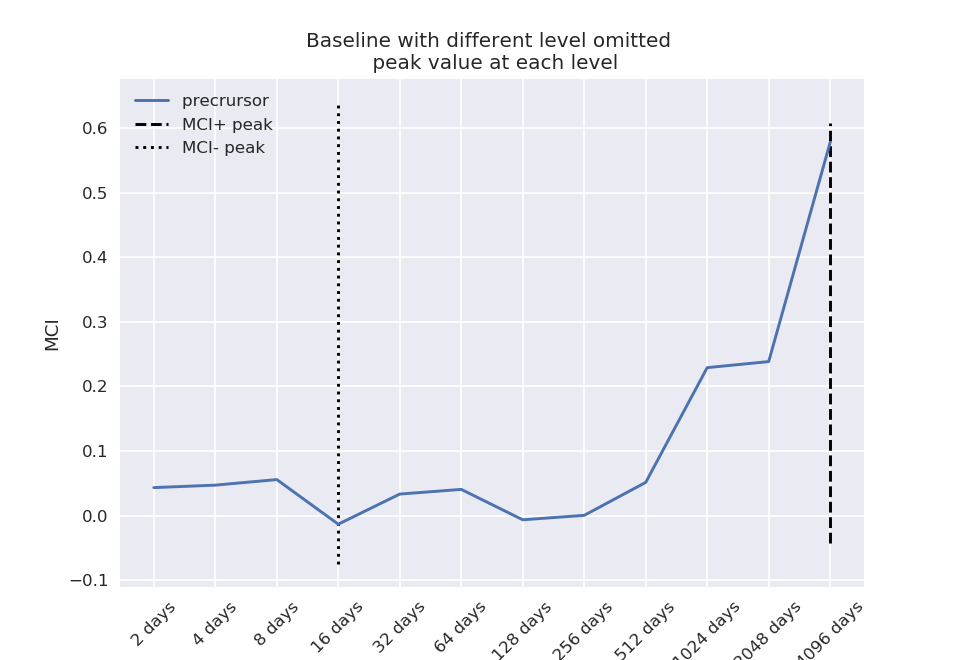

In [62]:
plot_mci_pred_relation(cA=np.arange(len(mcis)), prec_lag=mcis, path=' ', title=f'Baseline with different level omitted \n peak value at each level', show_level=False, savefig=False)

### Run experiment with wavelet decomposition on yprime  with default Tau(0,2)


[INFO] Extracting level 0
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


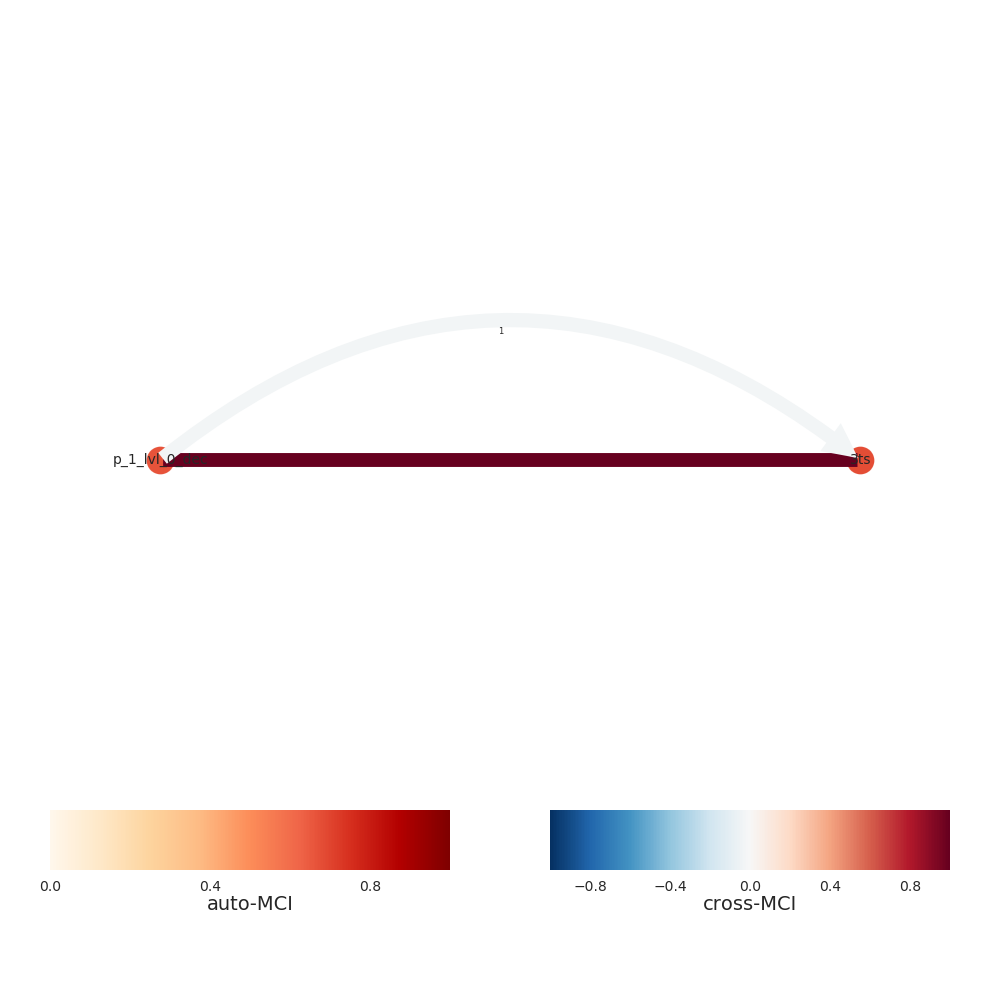

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


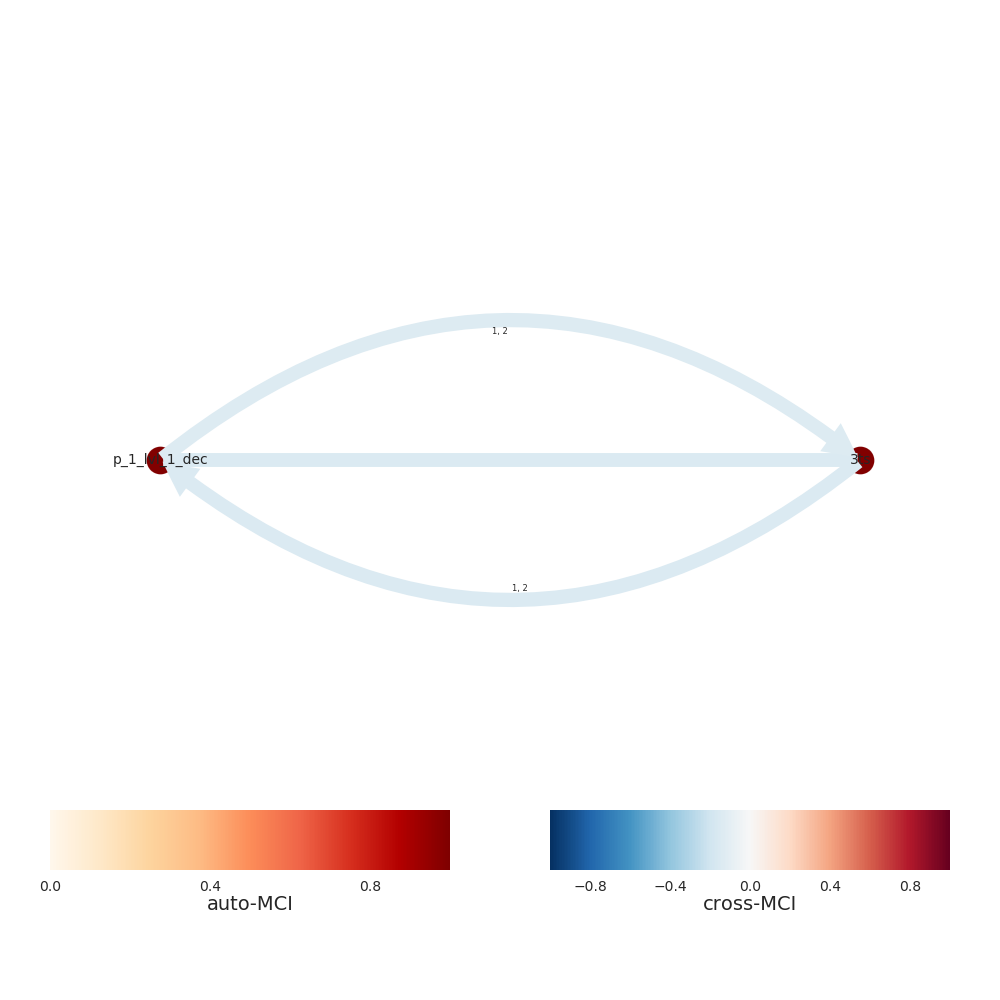

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


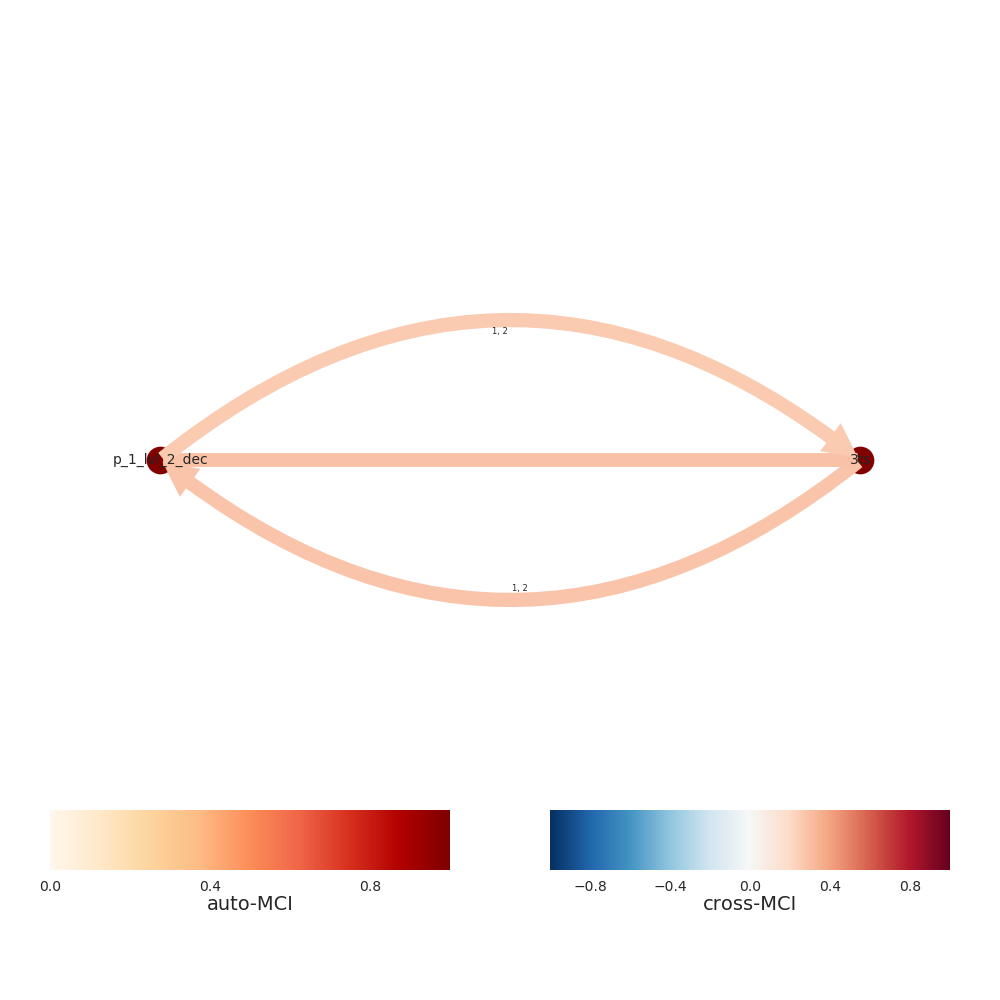

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


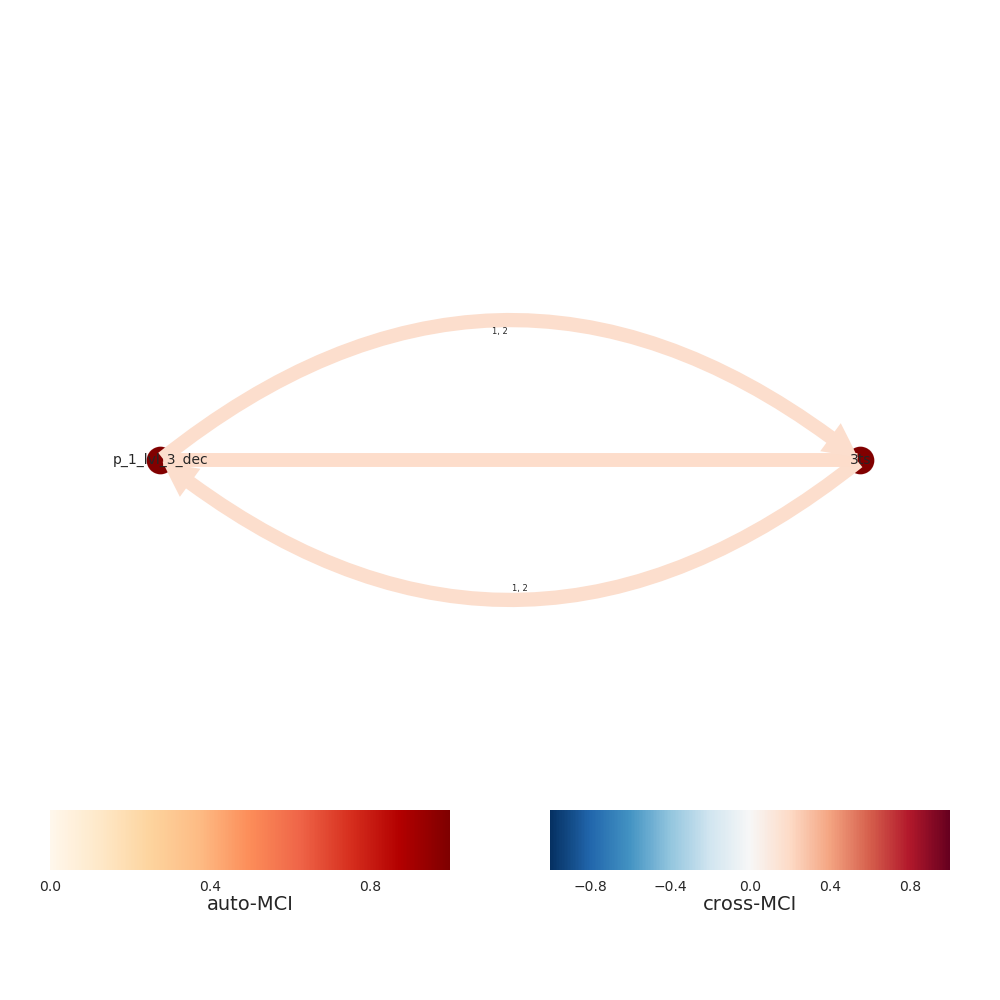

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


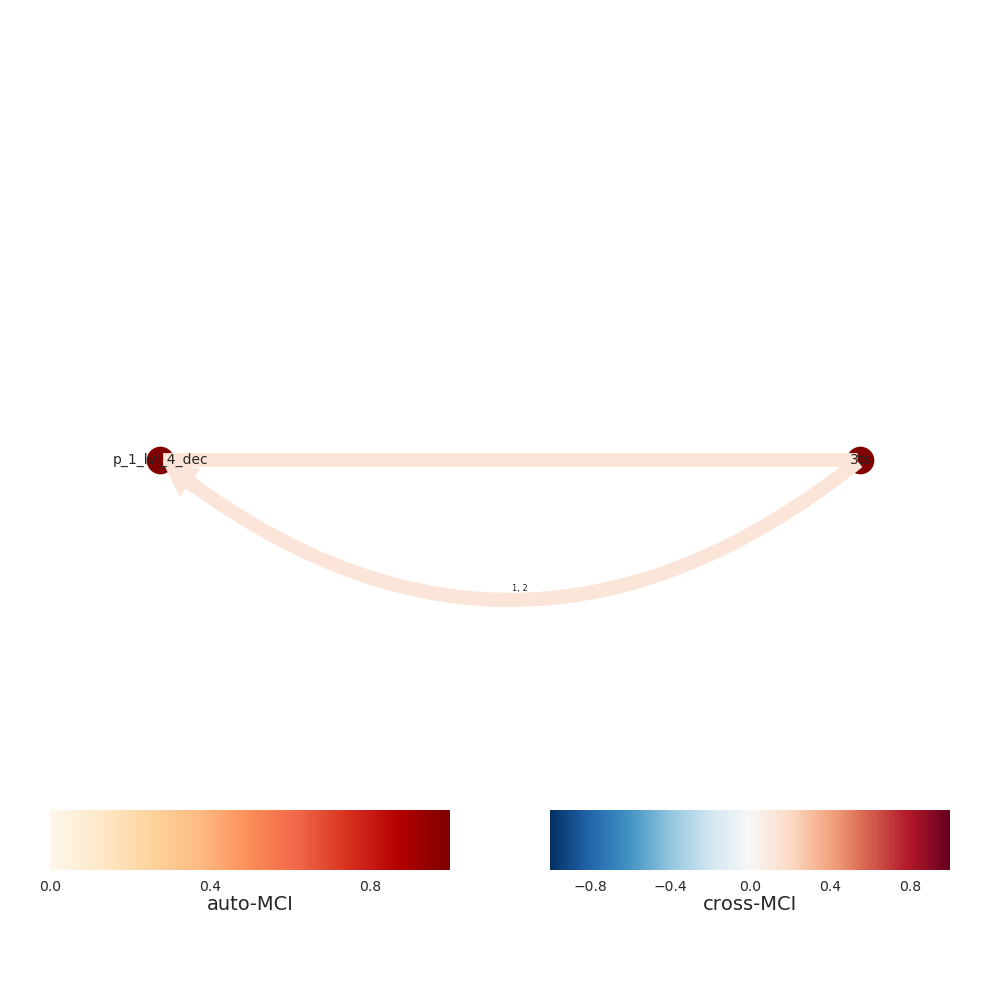

Progress causal inference - traintest set 100%
[INFO] Extracting level 1
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


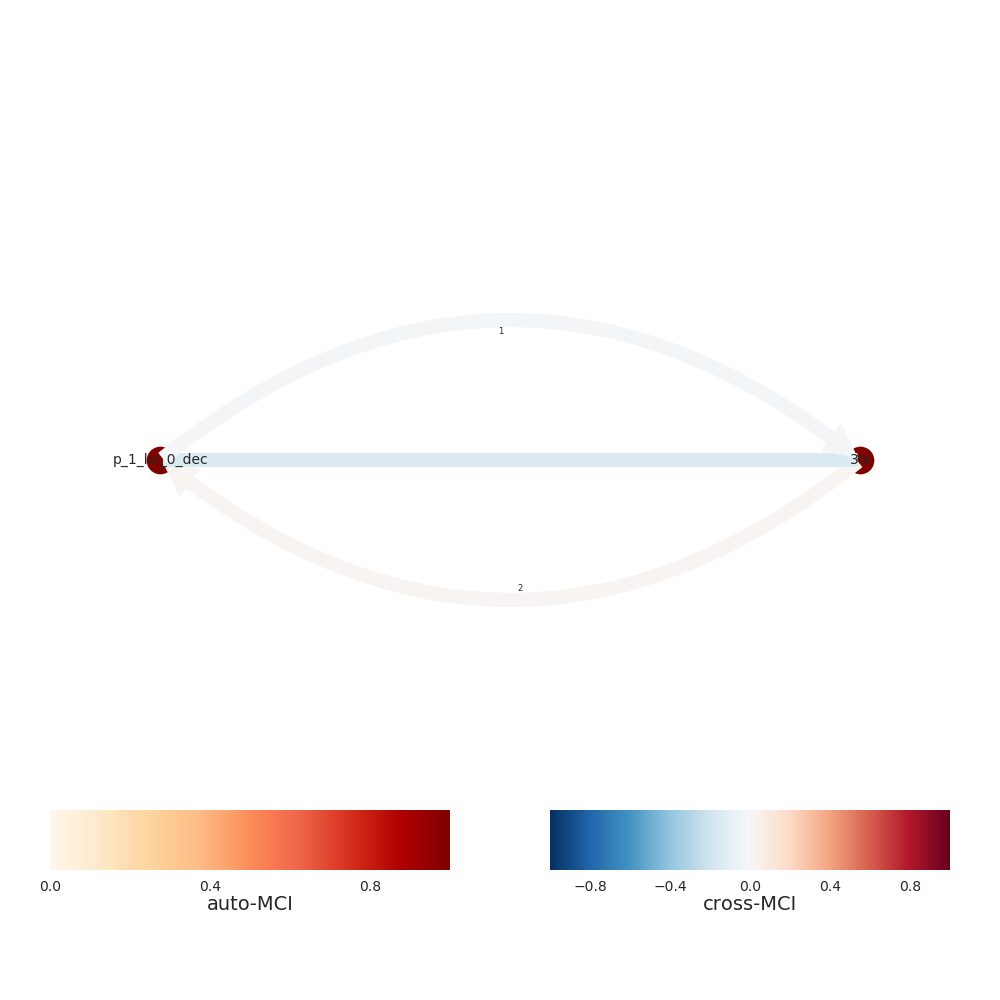

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


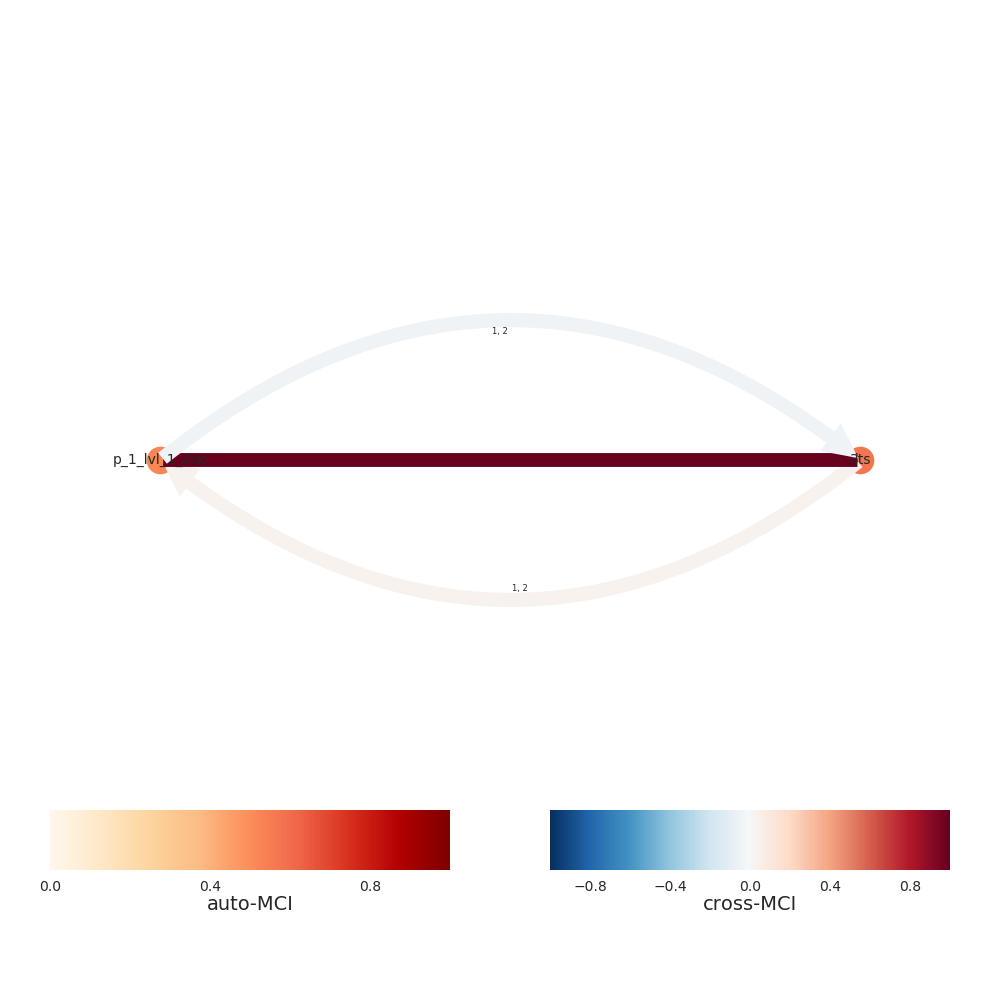

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


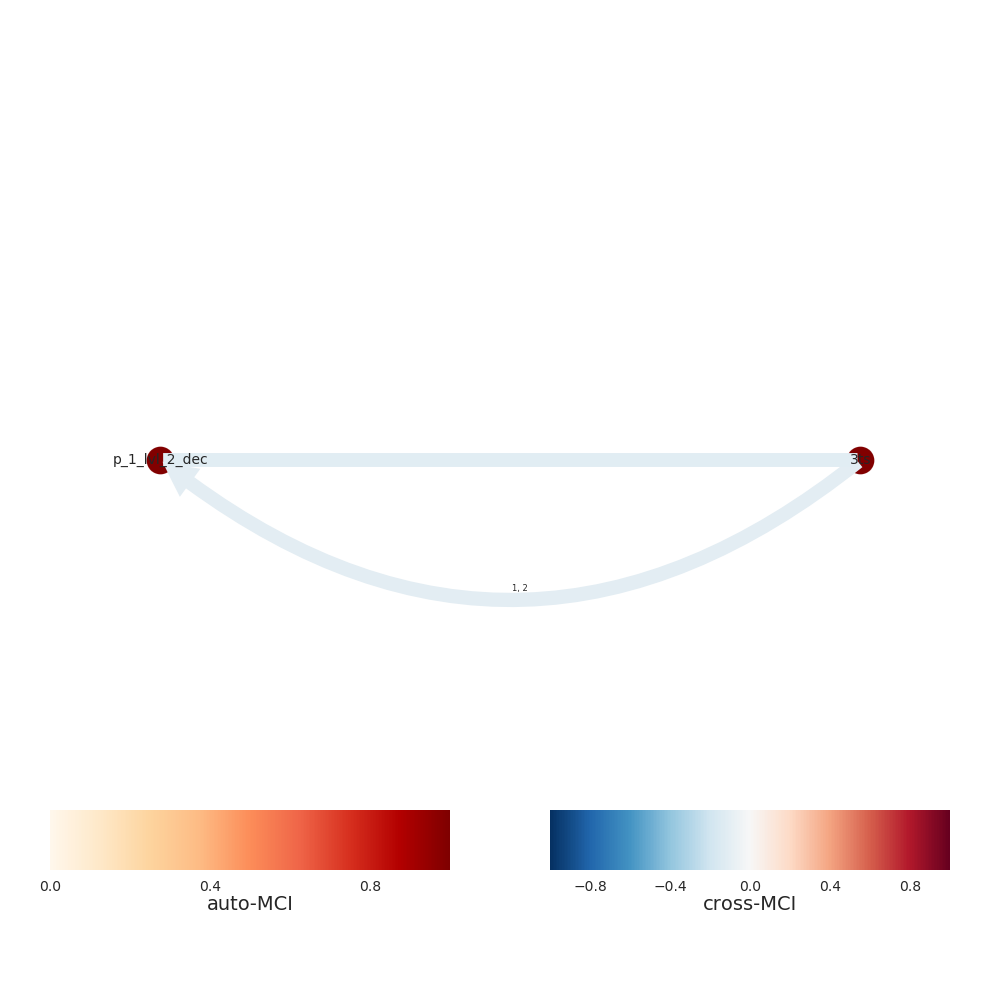

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


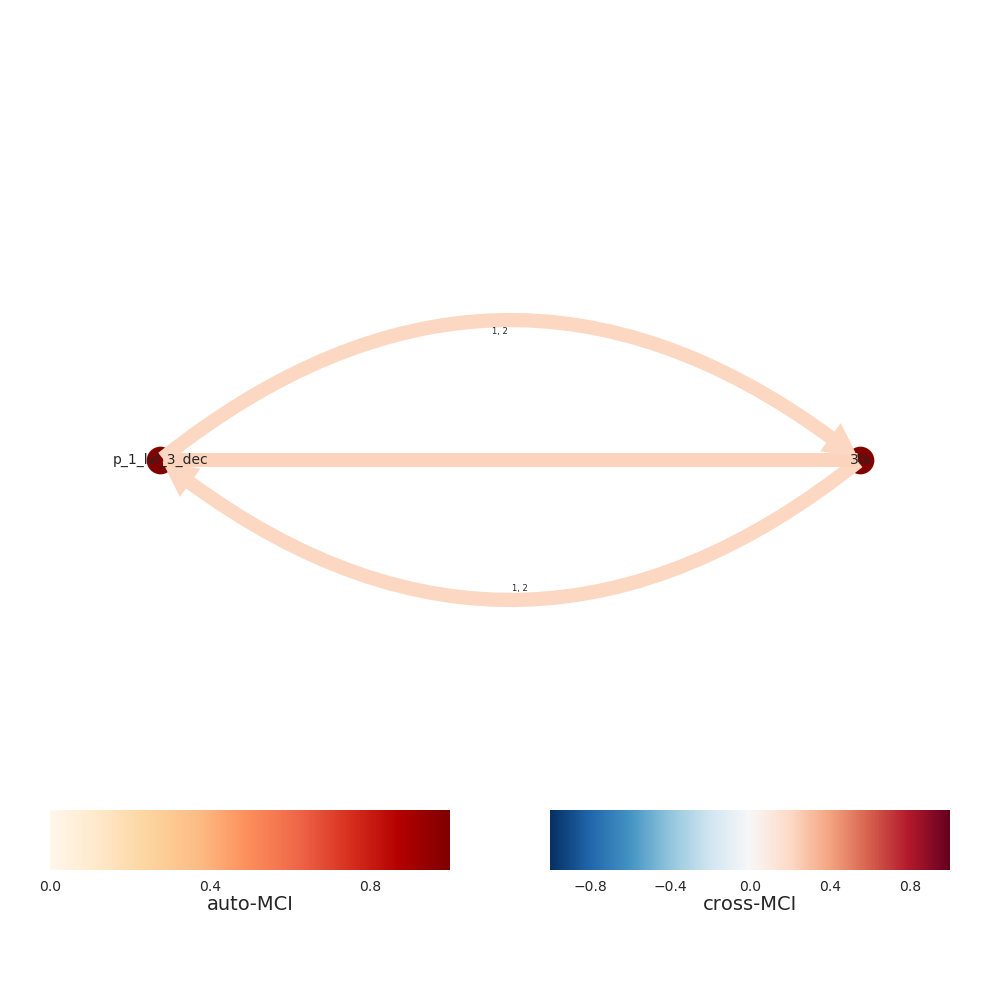

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


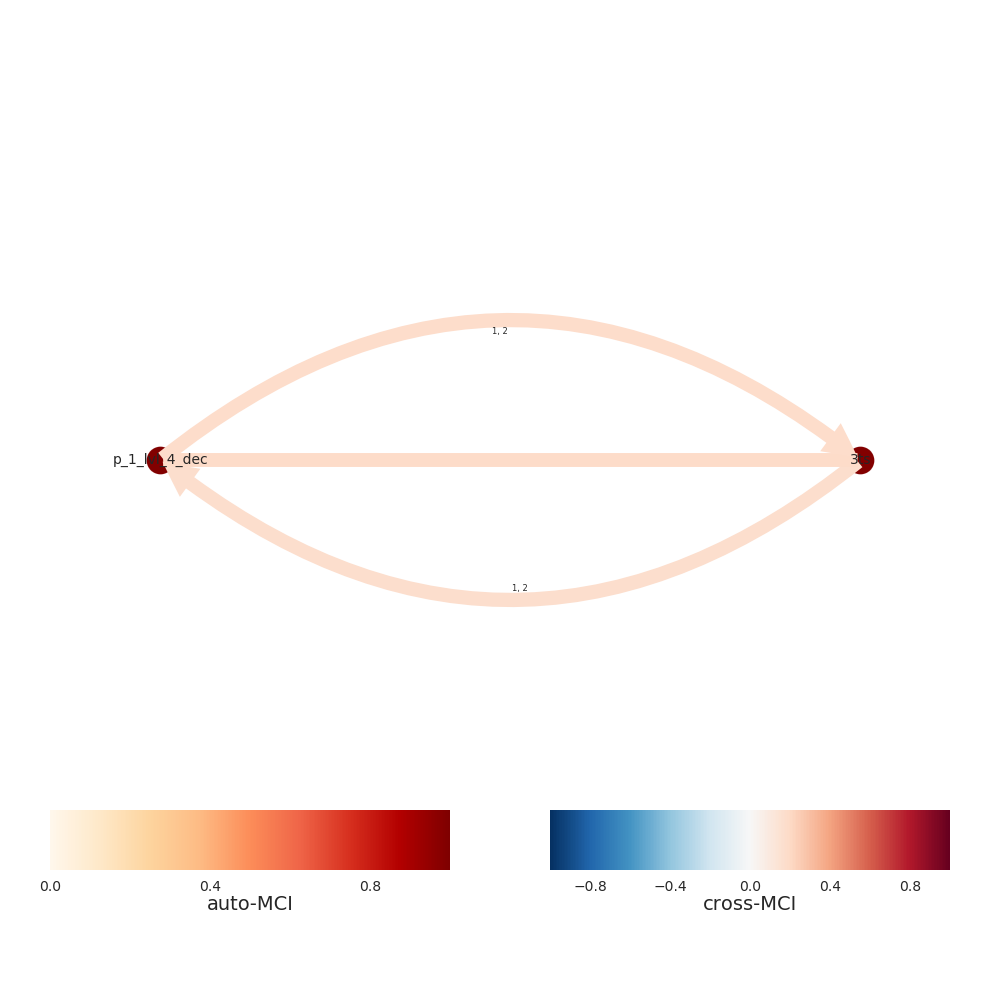

Progress causal inference - traintest set 100%
[INFO] Extracting level 2
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


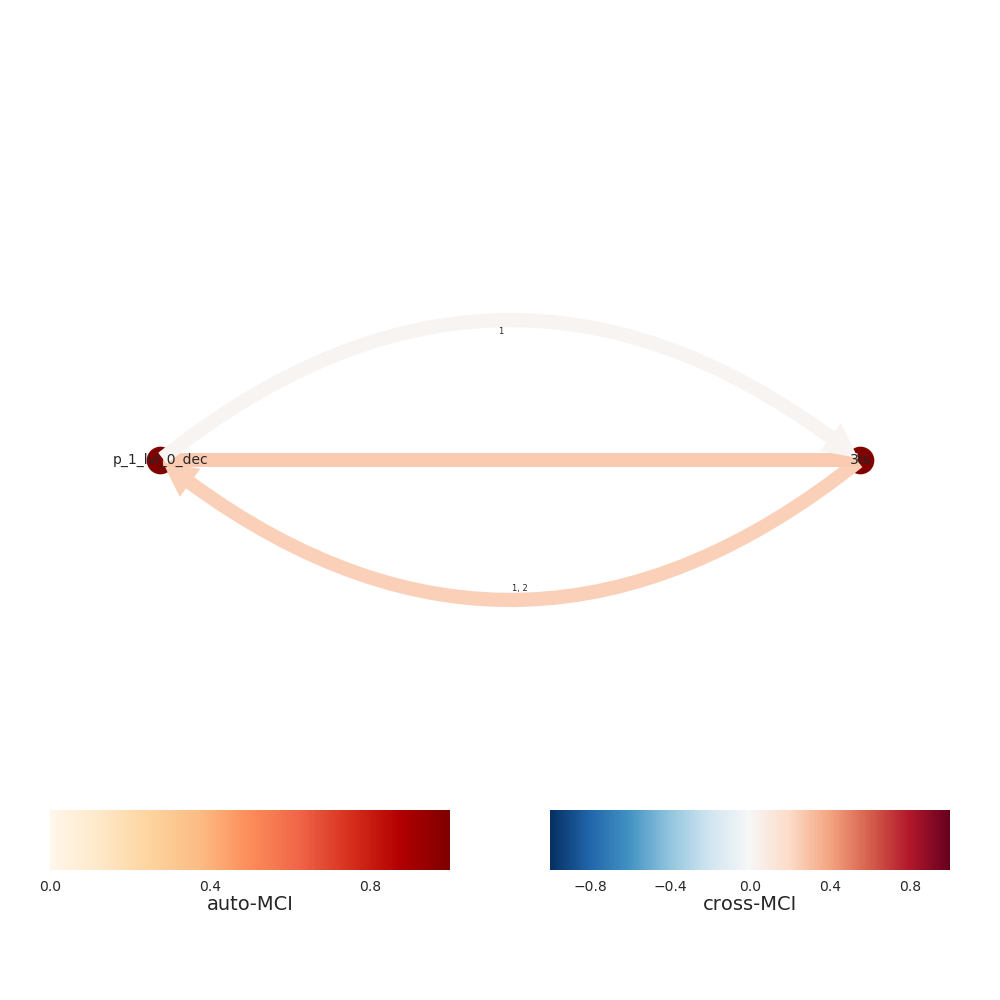

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


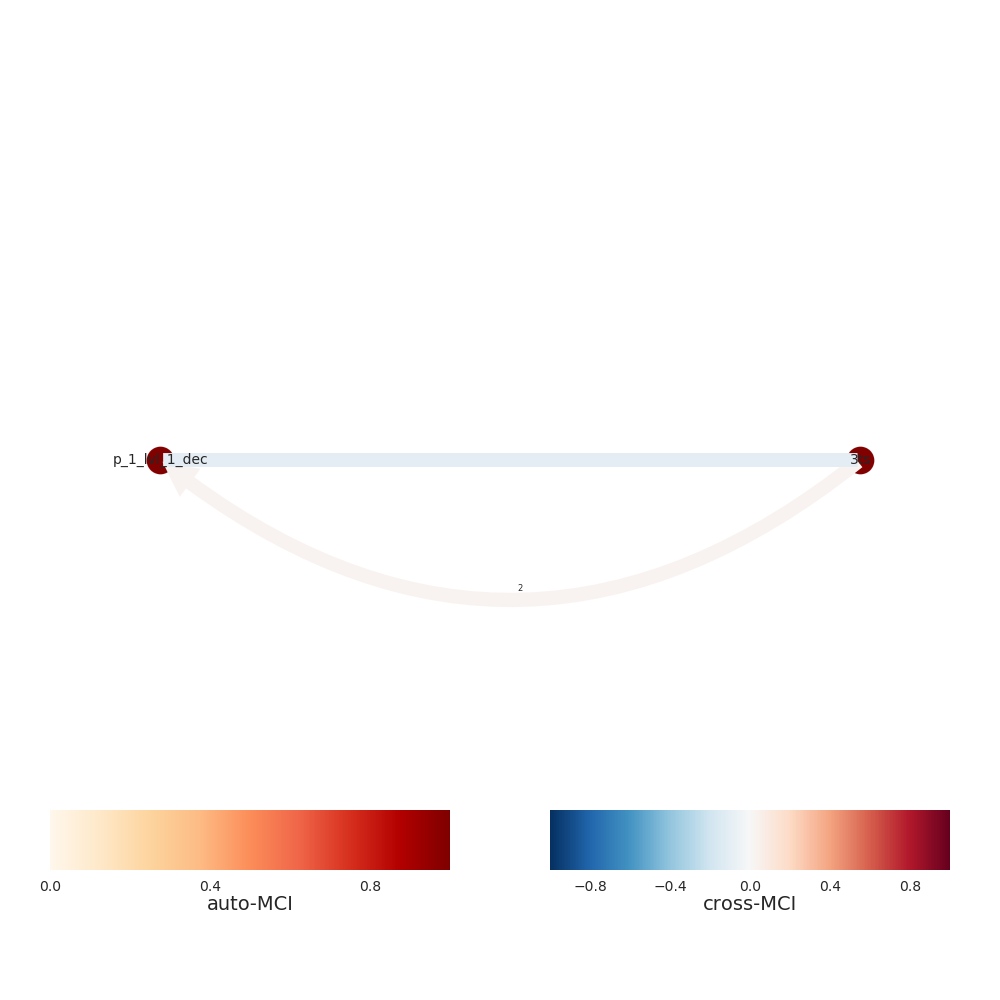

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


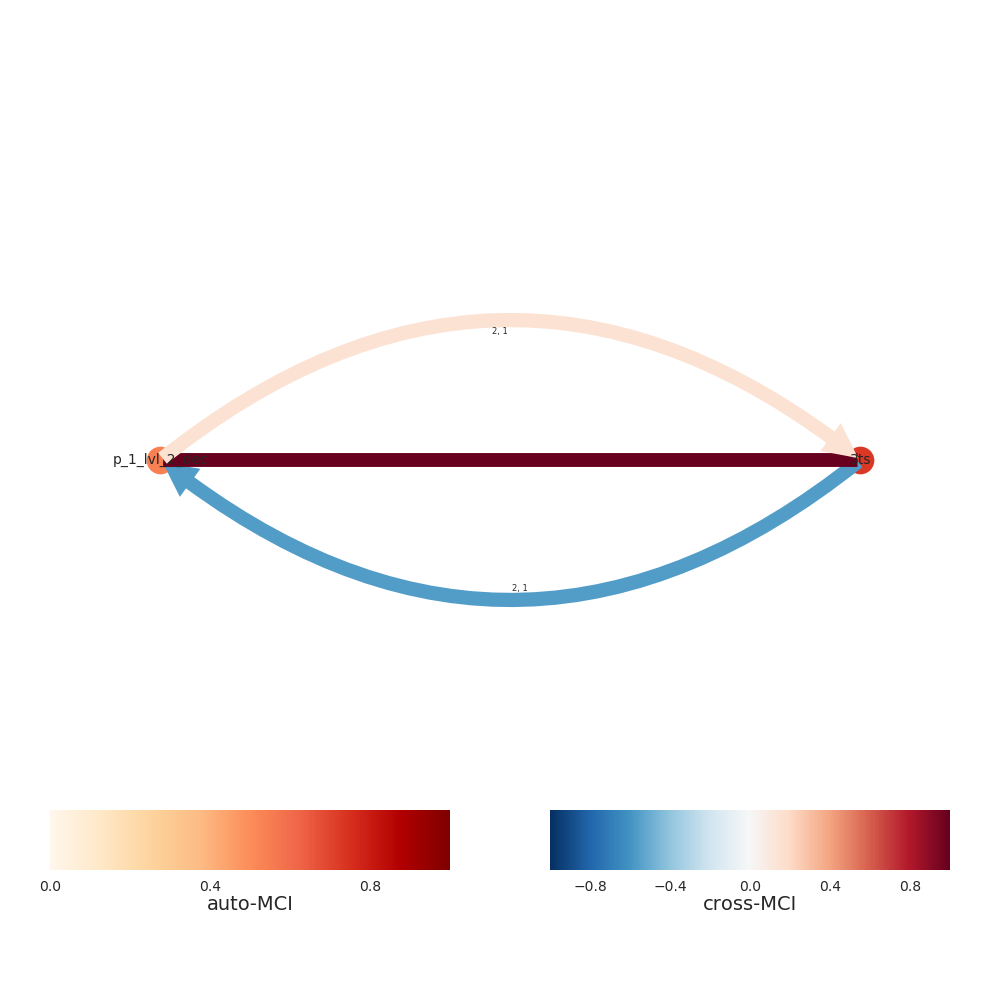

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


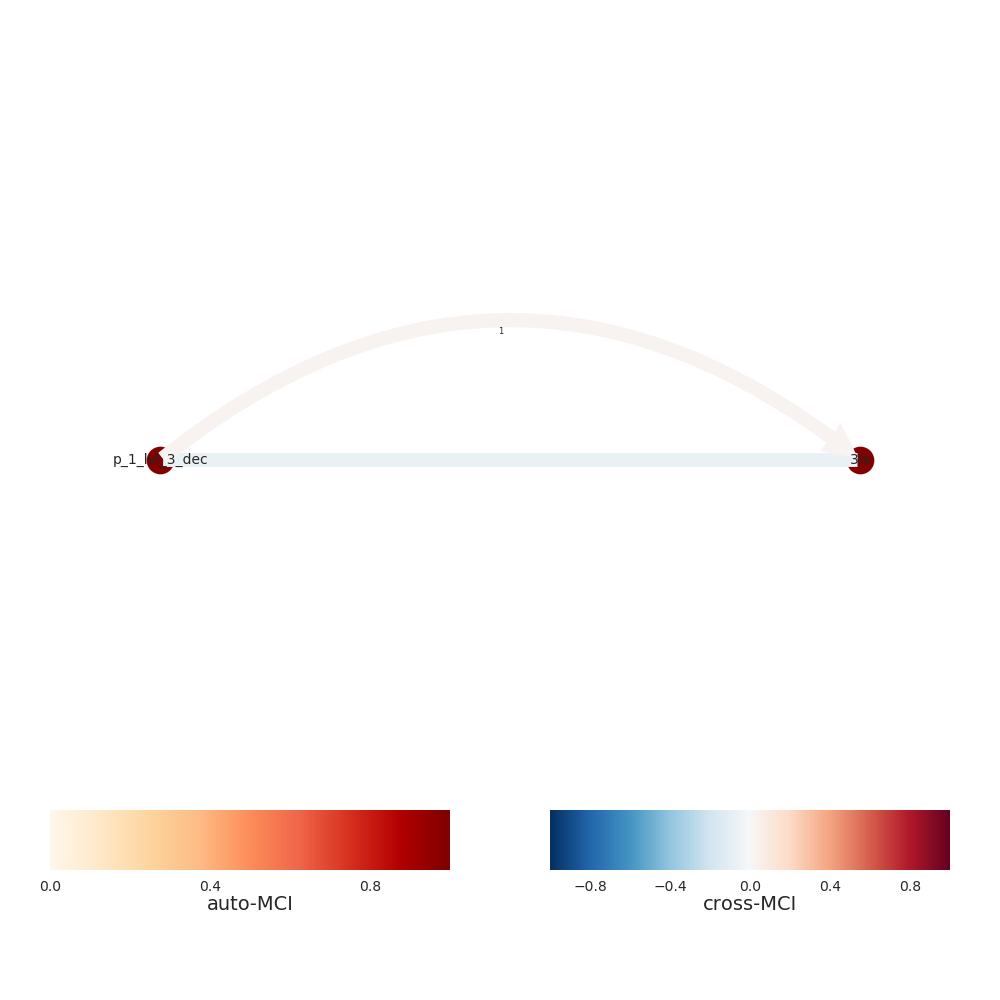

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


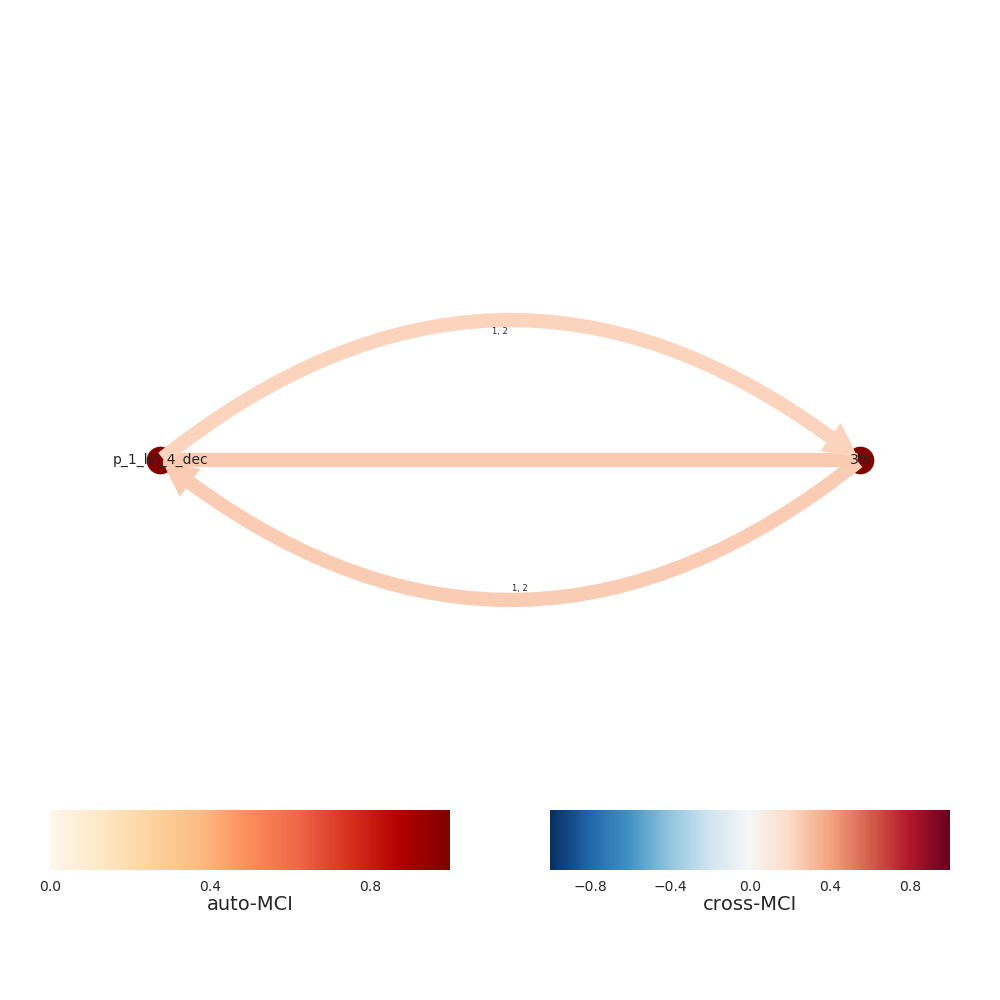

Progress causal inference - traintest set 100%
[INFO] Extracting level 3
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


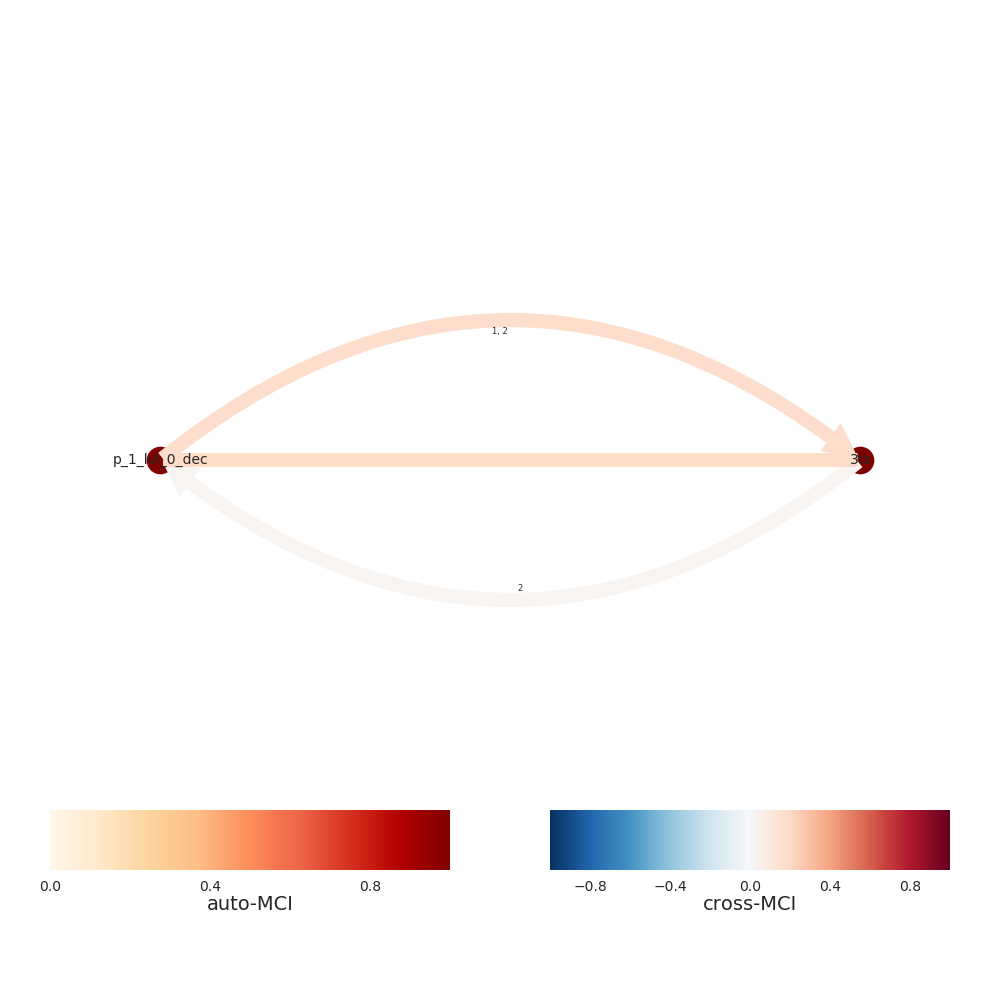

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


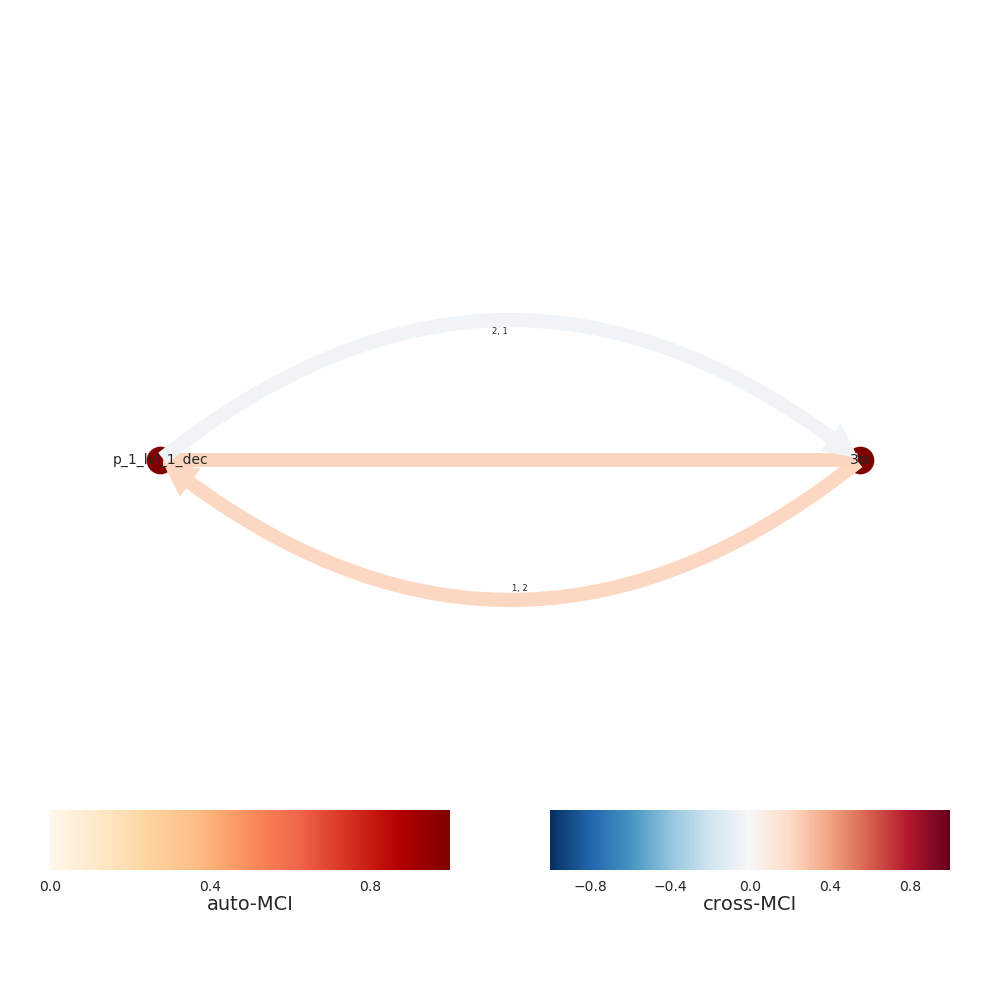

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


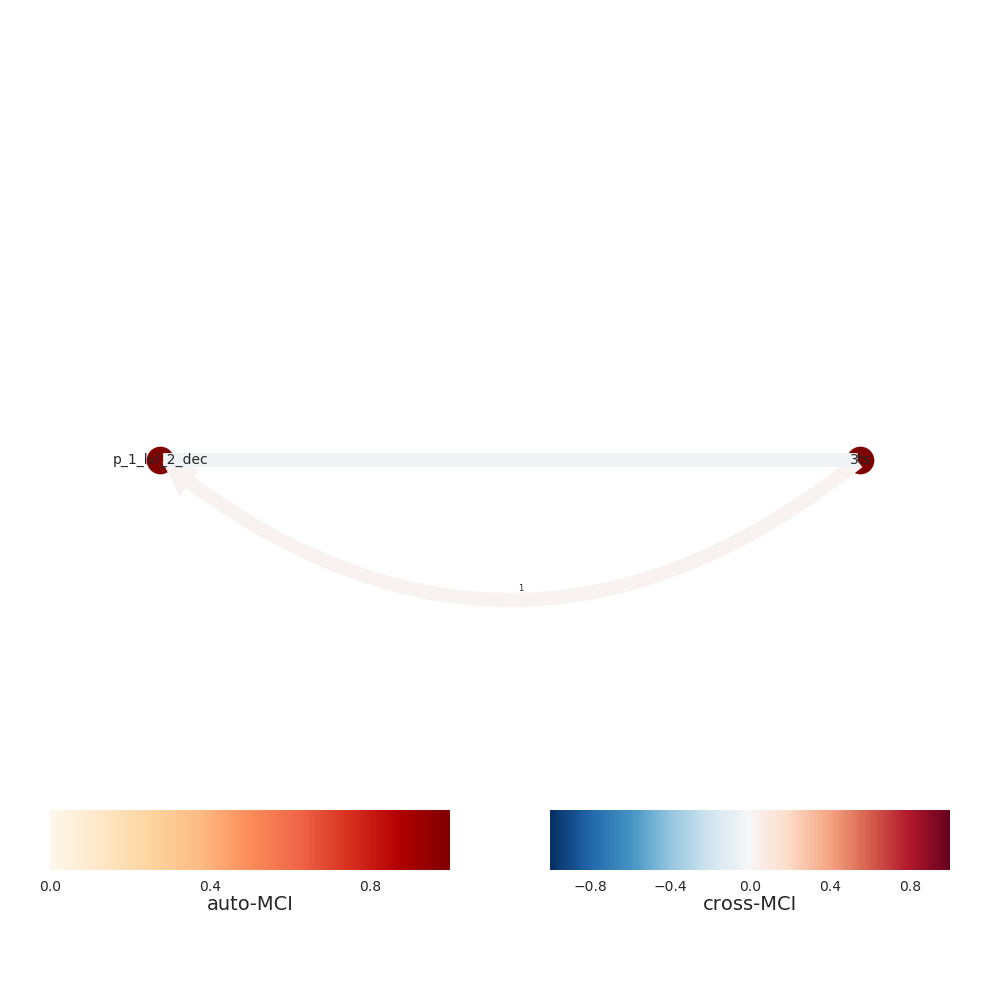

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


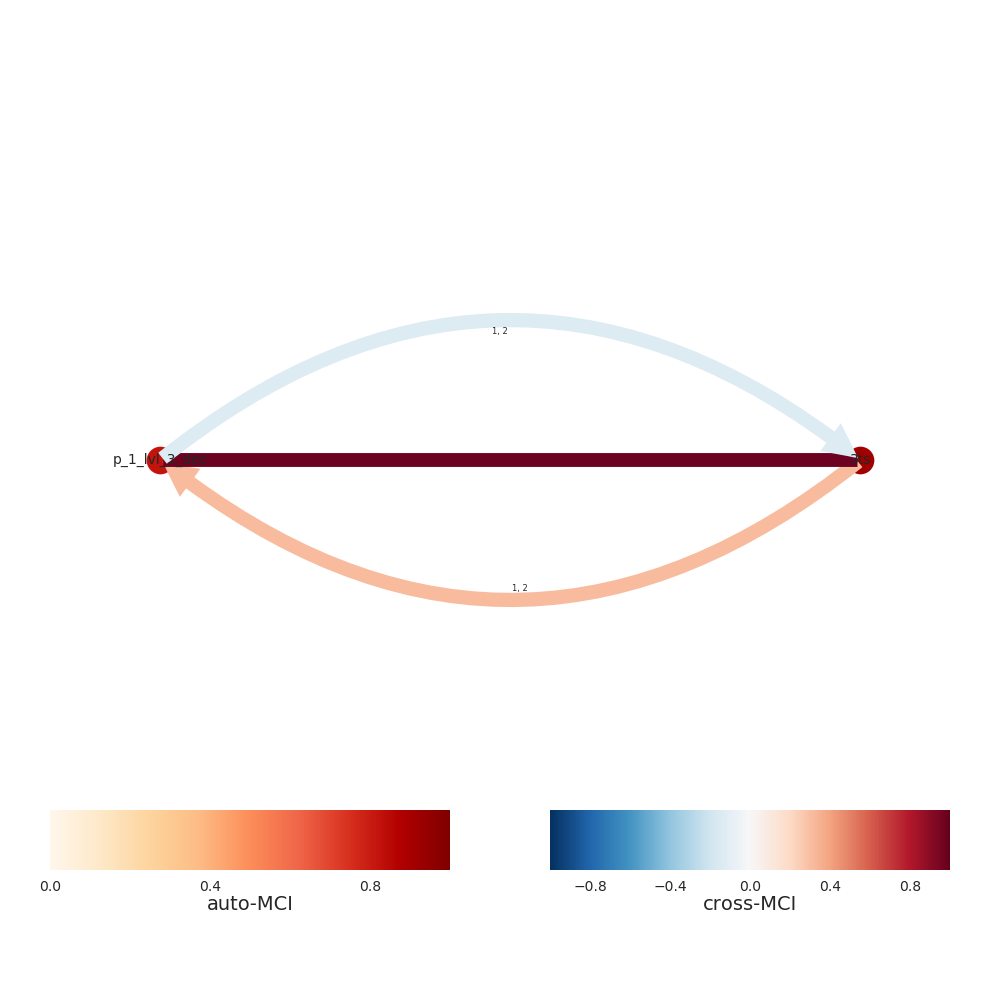

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


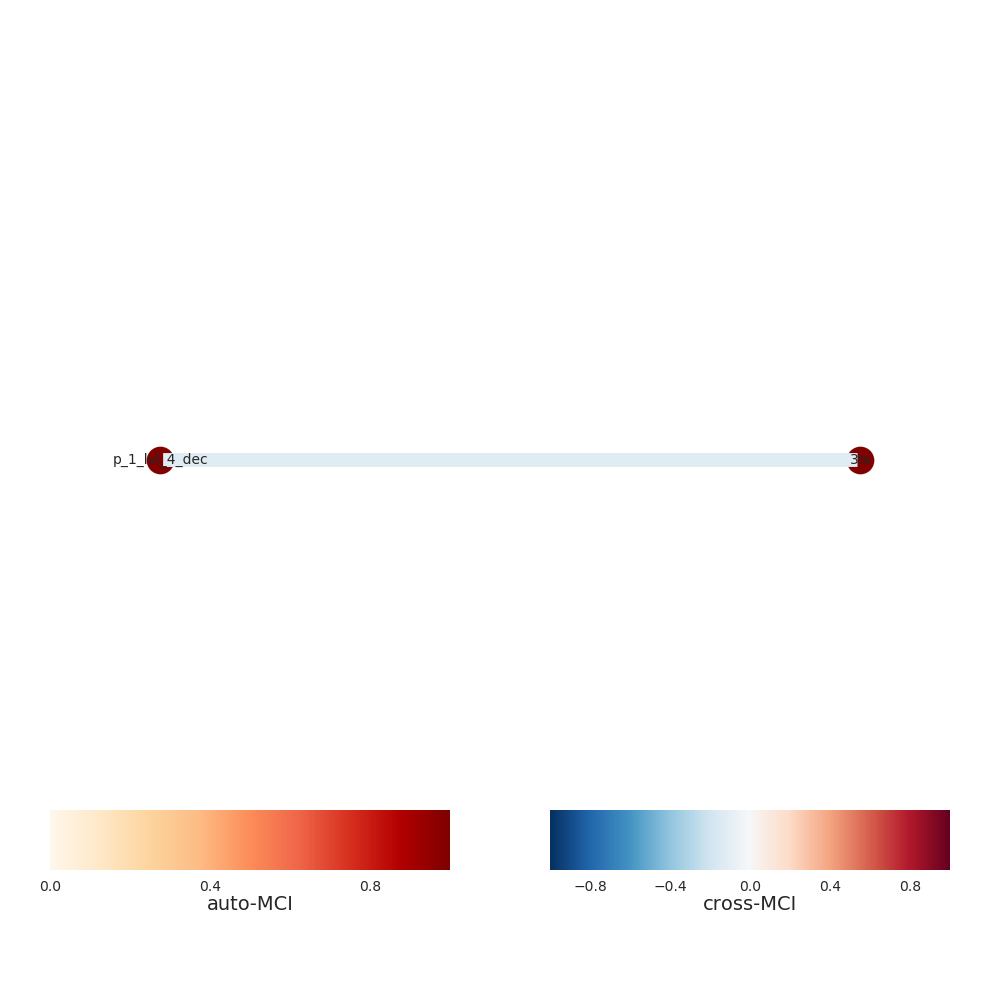

Progress causal inference - traintest set 100%
[INFO] Extracting level 4
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


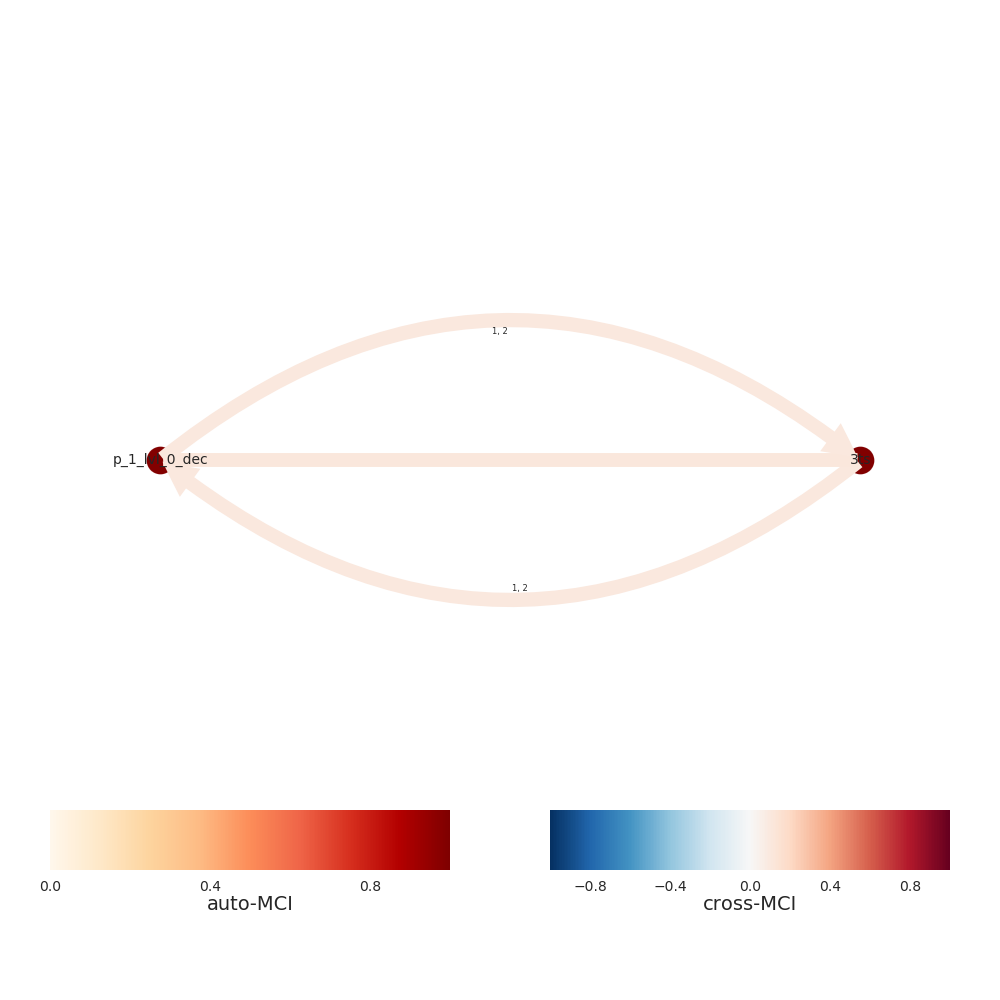

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


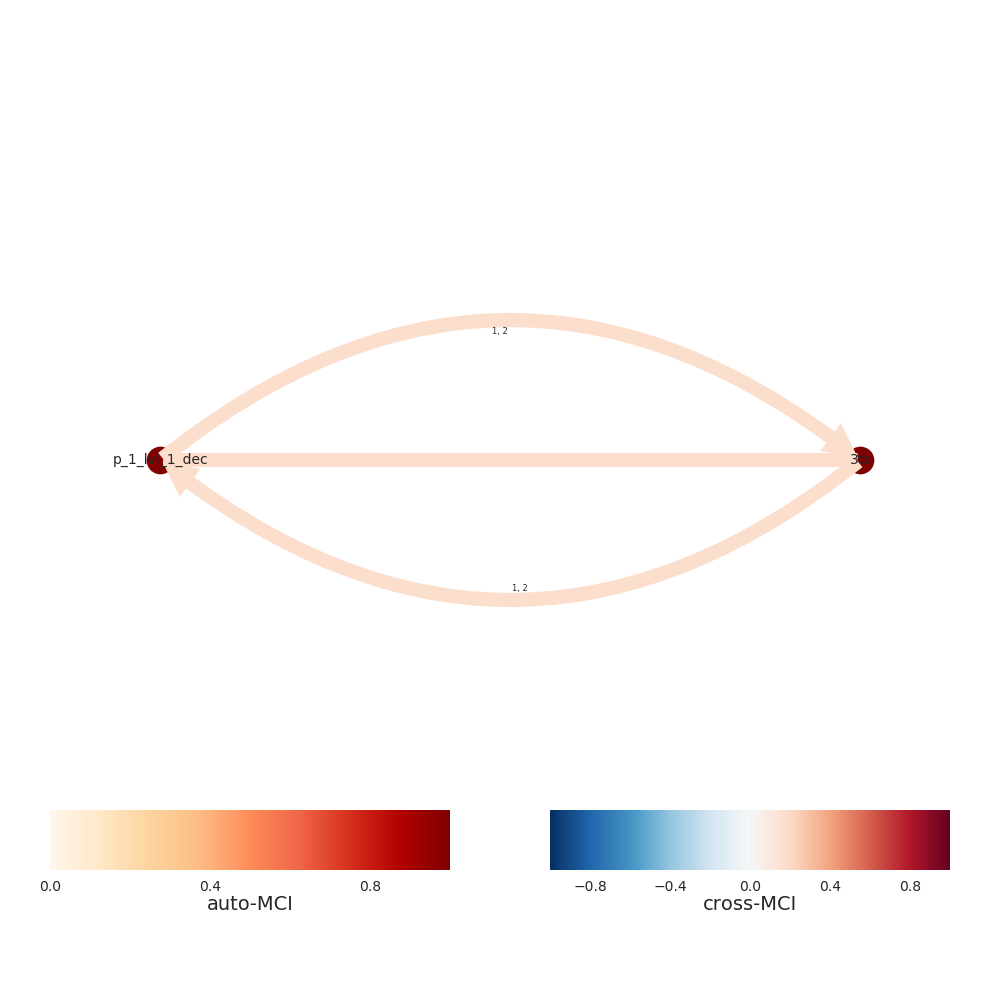

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


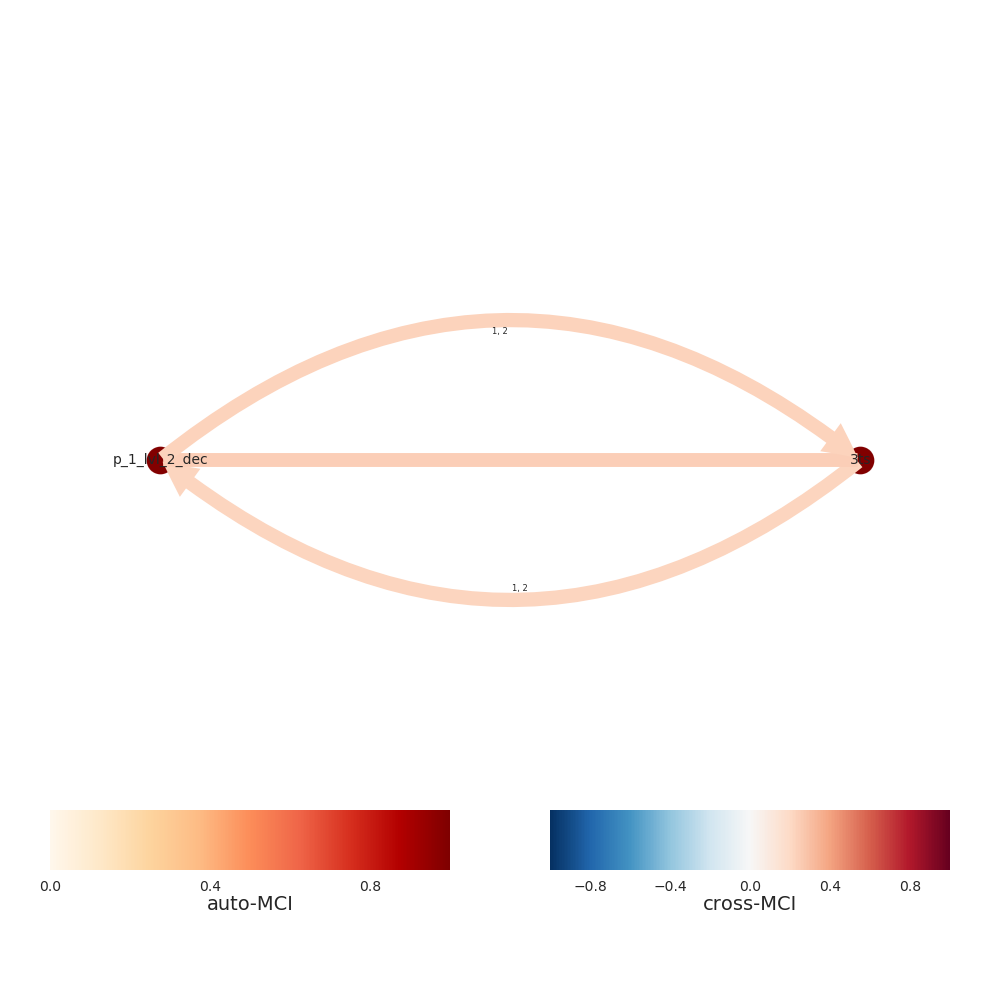

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


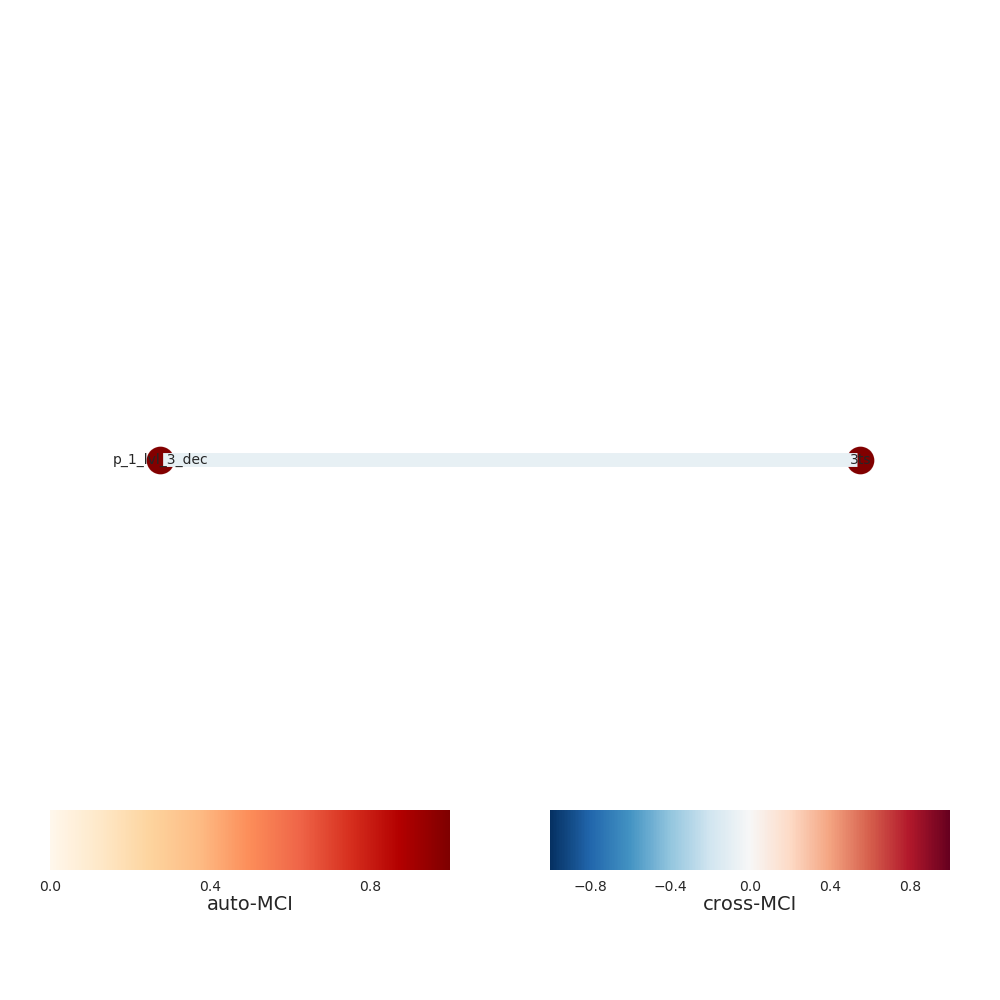

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


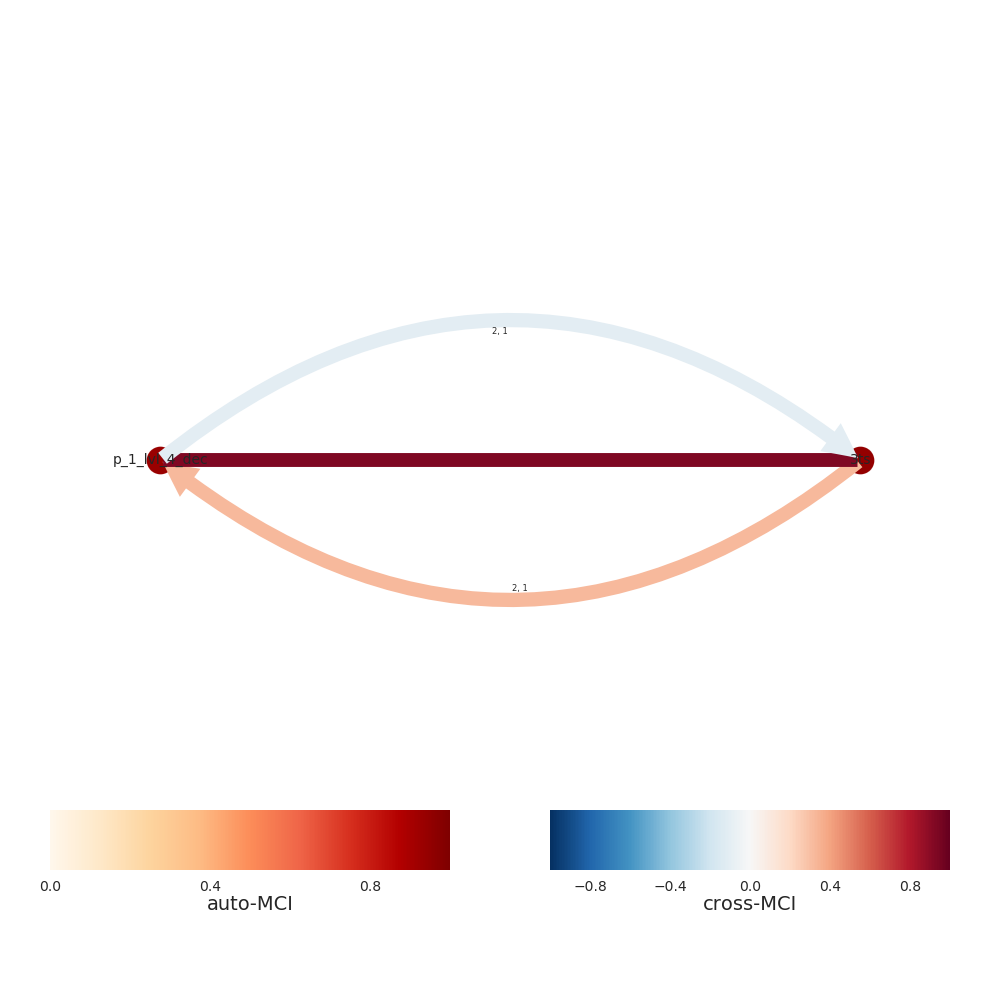

Progress causal inference - traintest set 100%
[INFO] Extracting level 5
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


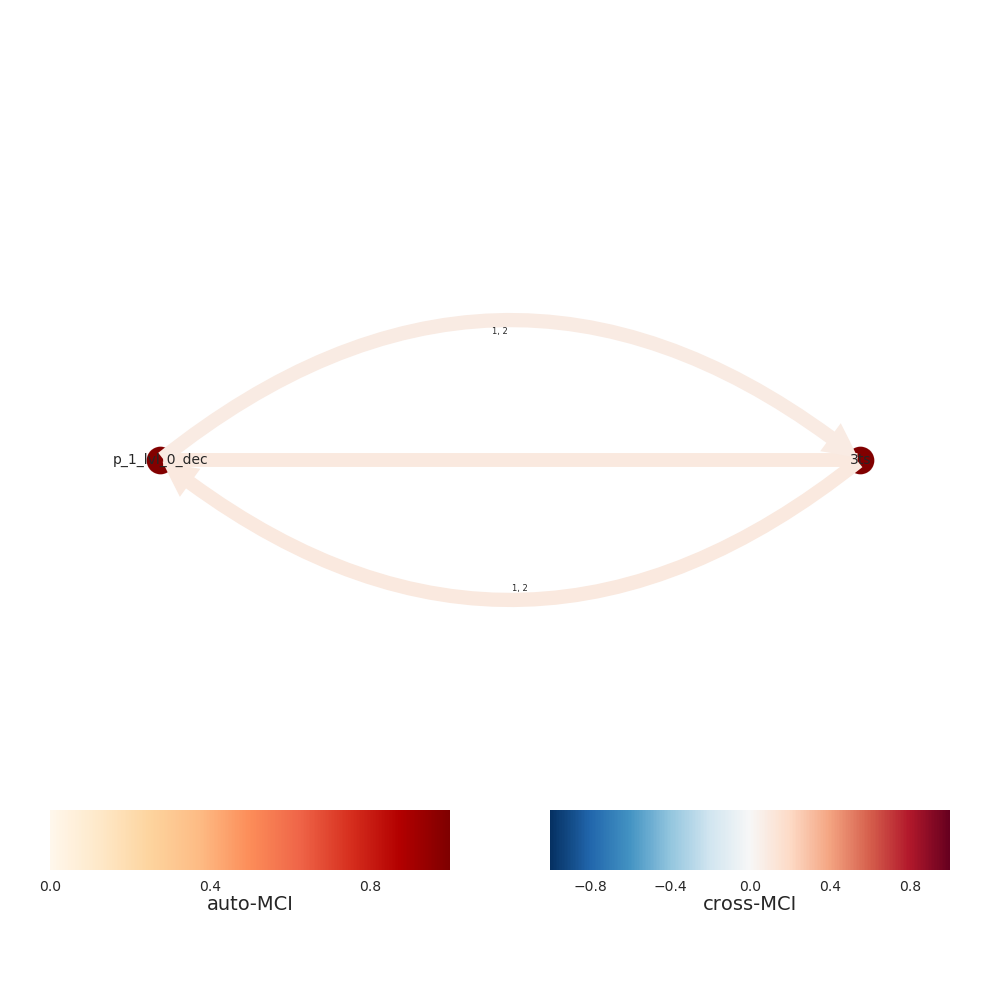

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


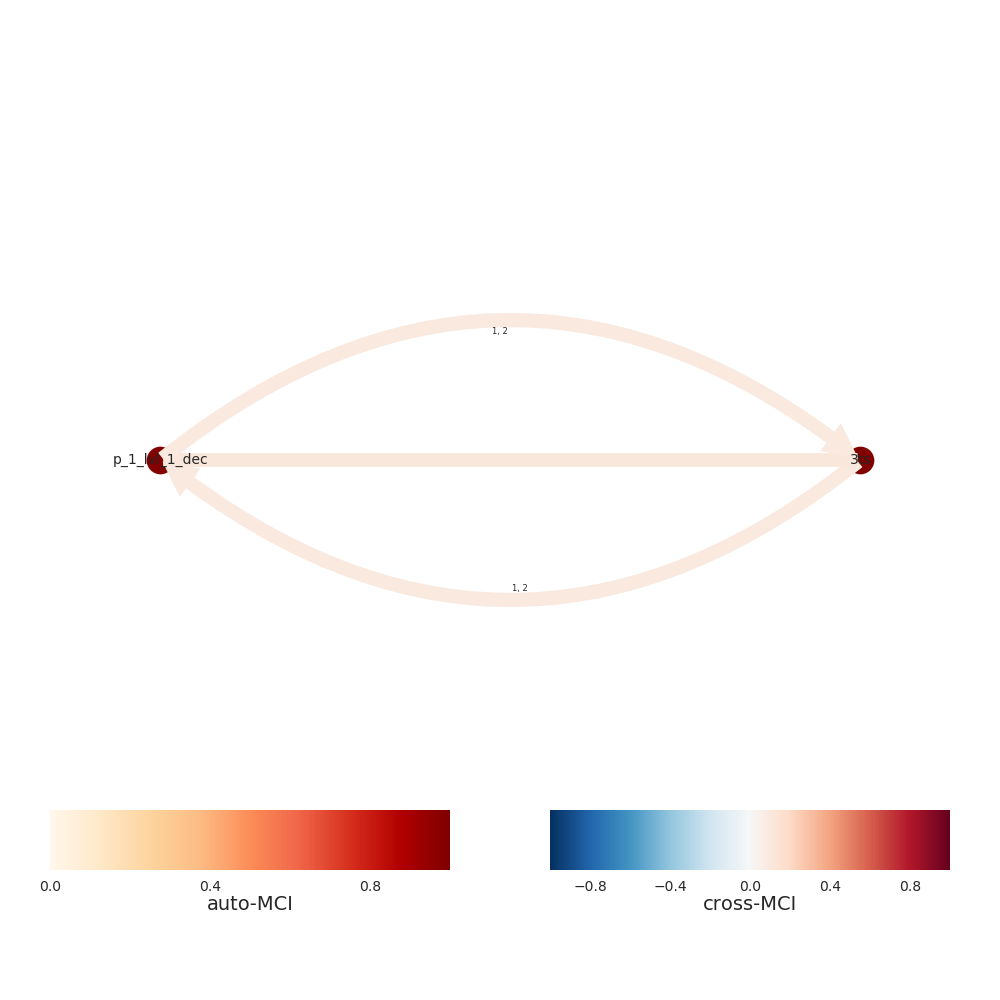

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


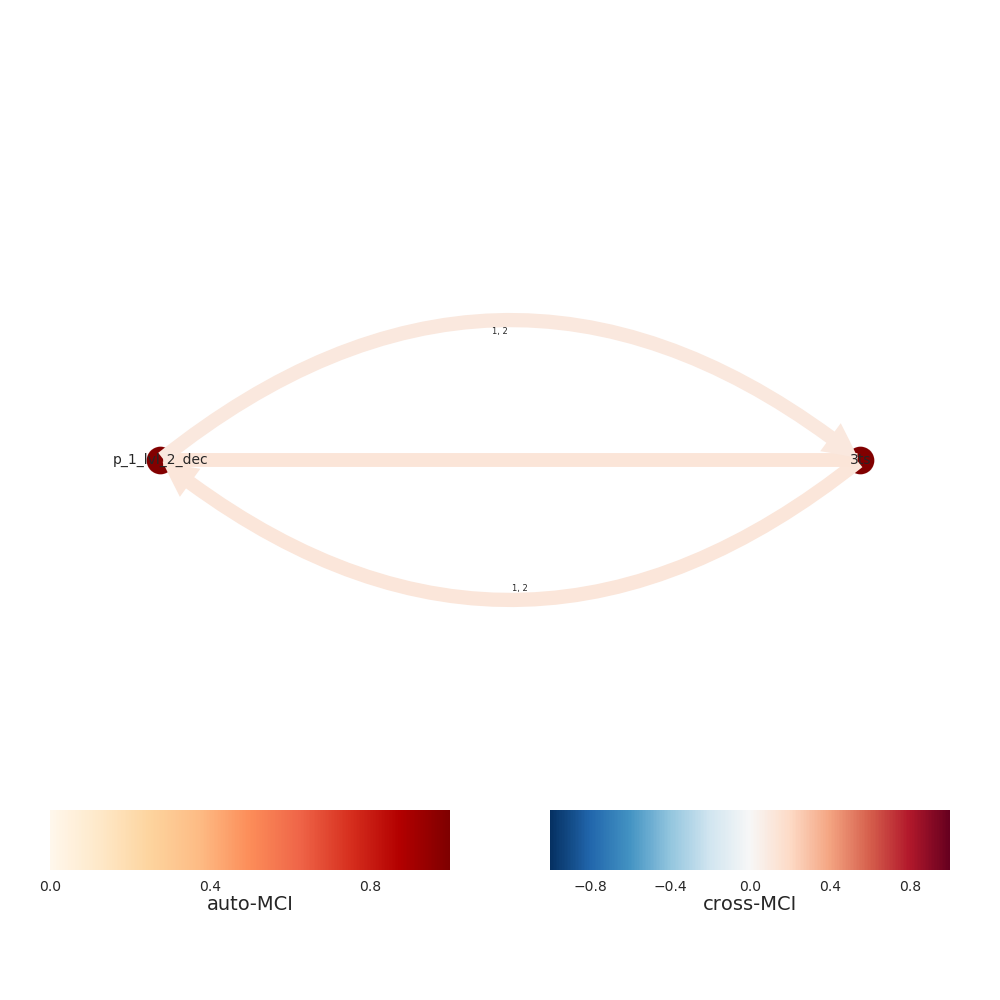

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


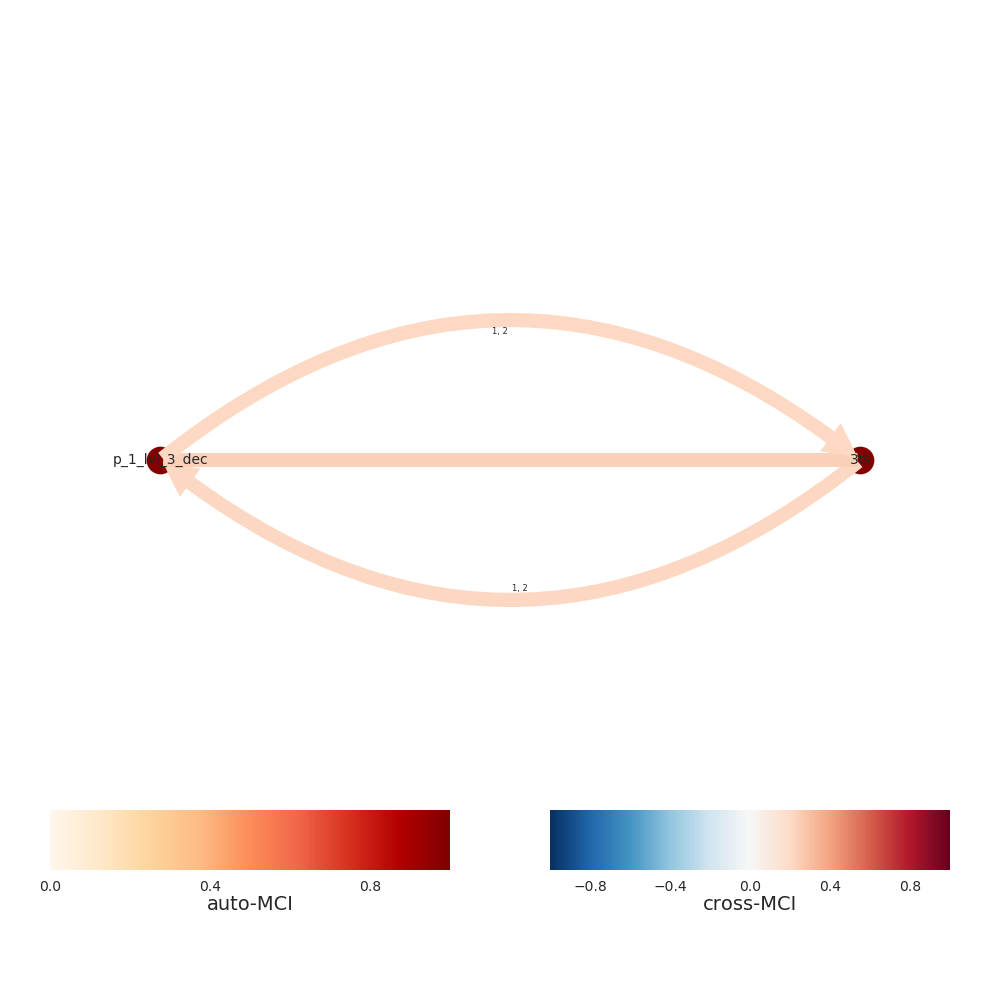

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


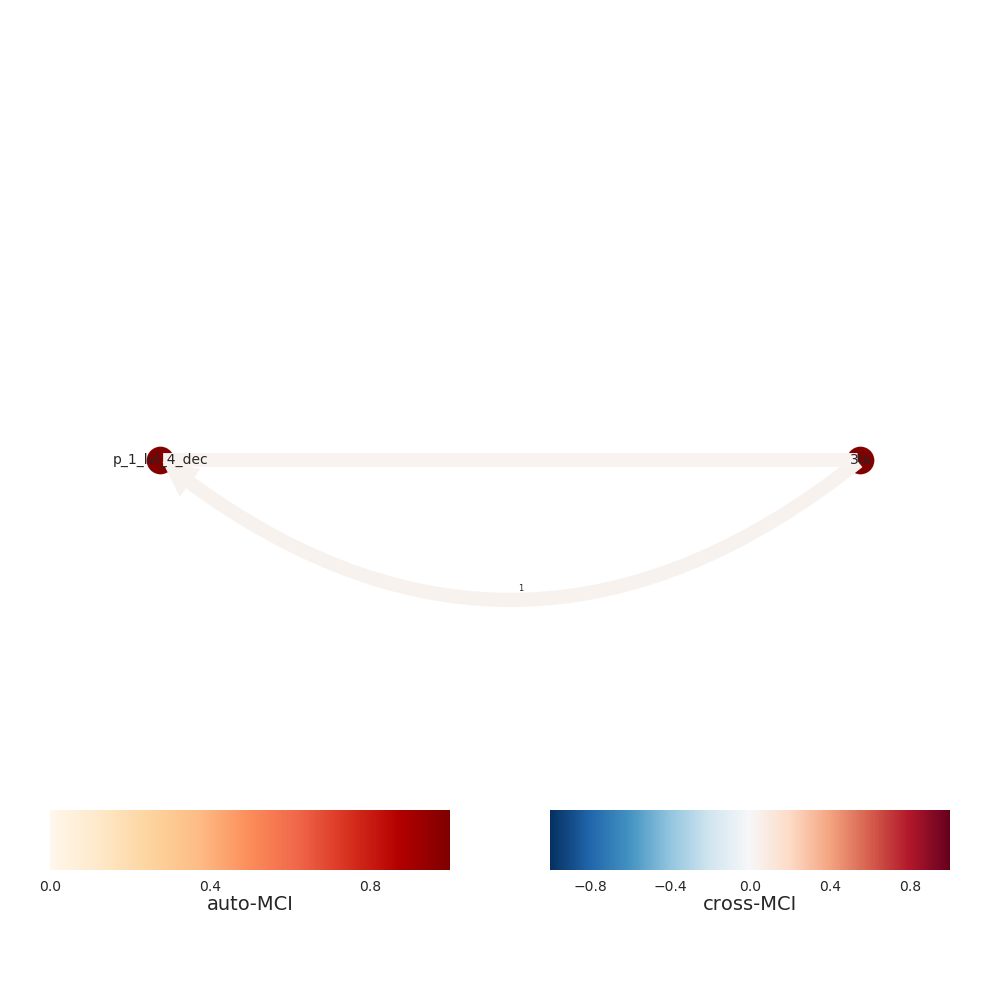

Progress causal inference - traintest set 100%
[INFO] Extracting level 6
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


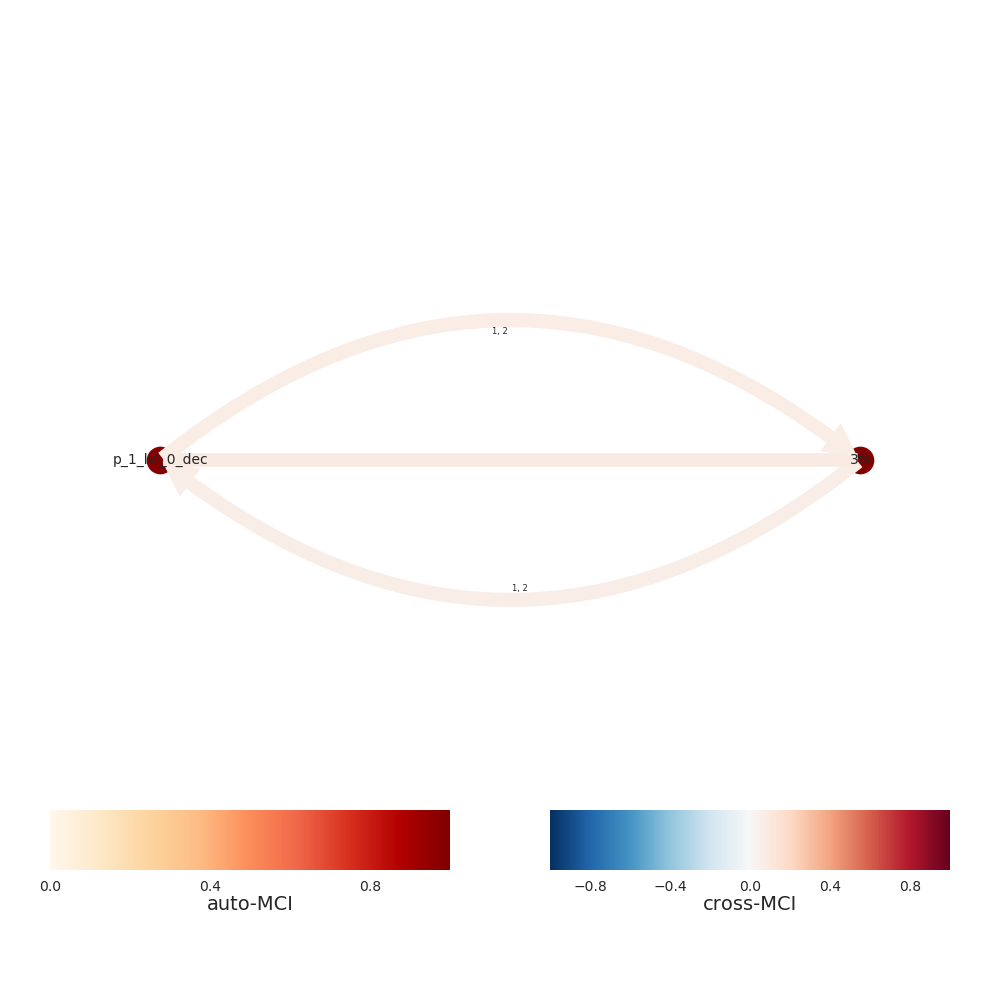

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


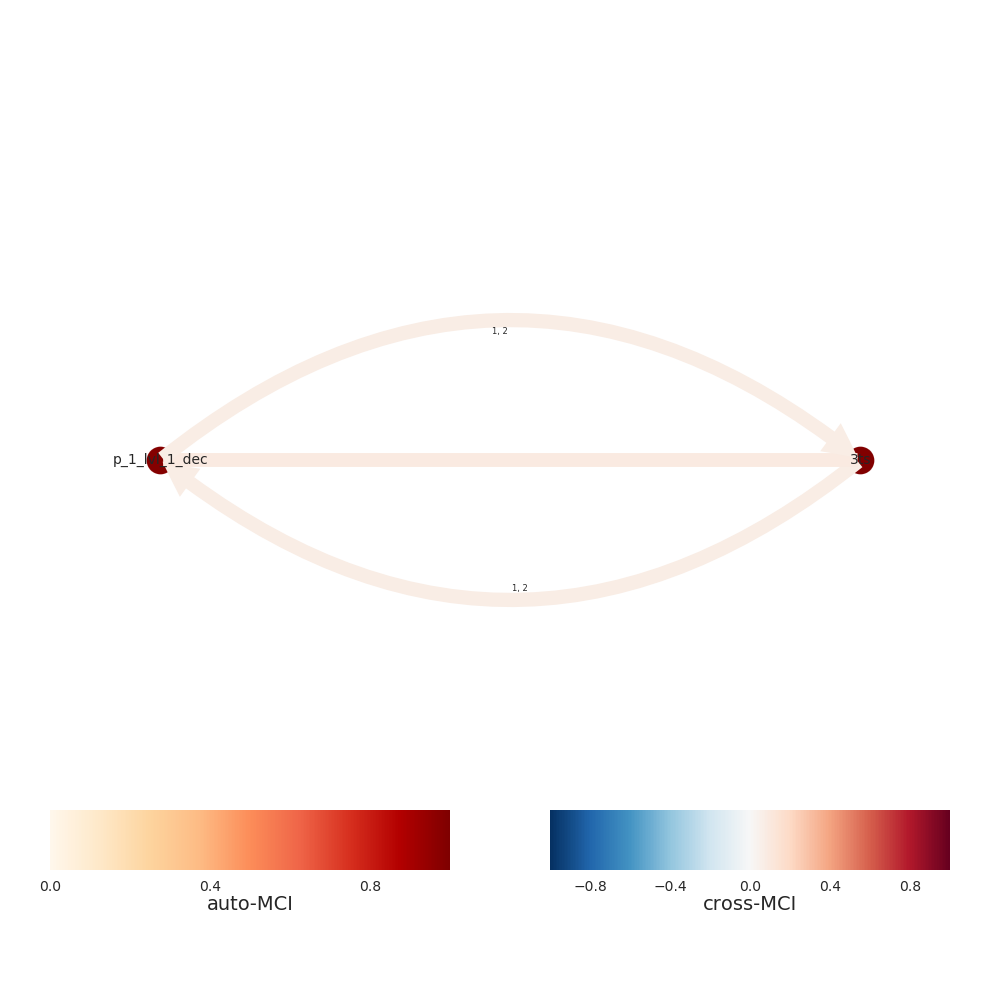

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


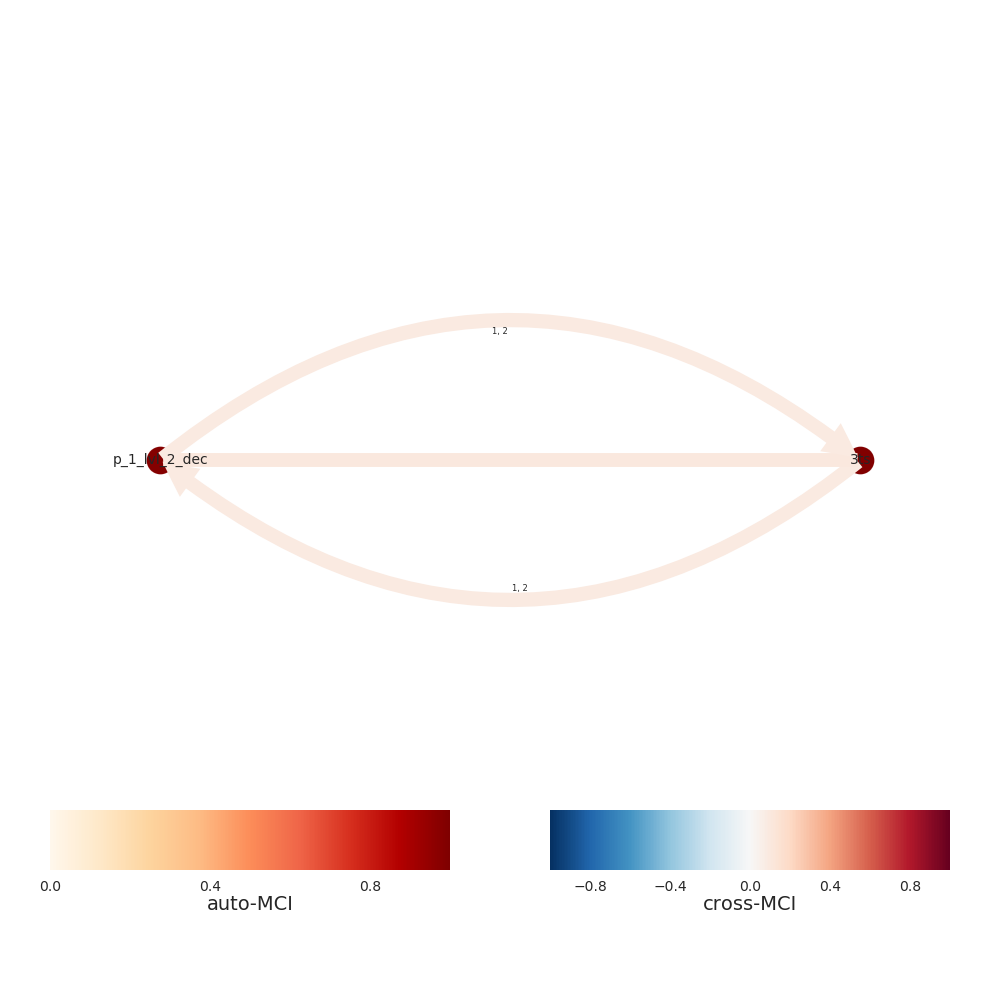

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


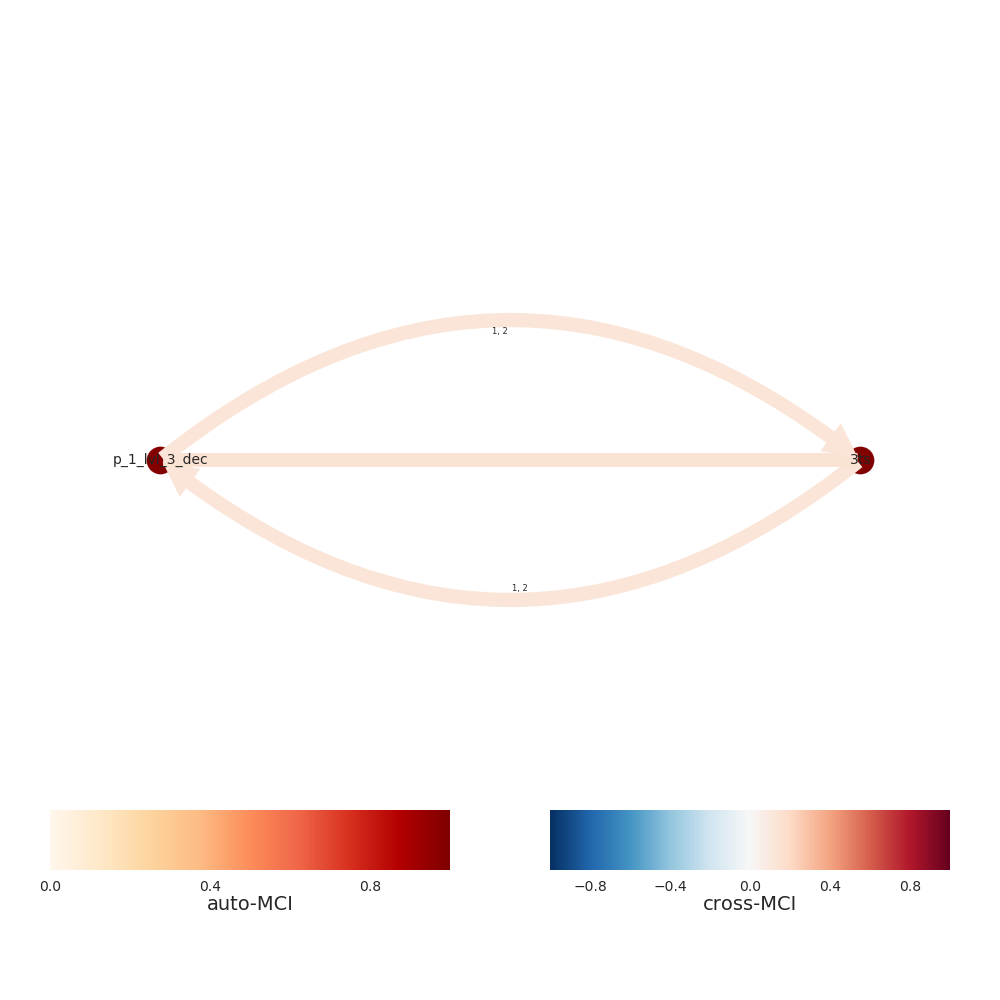

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


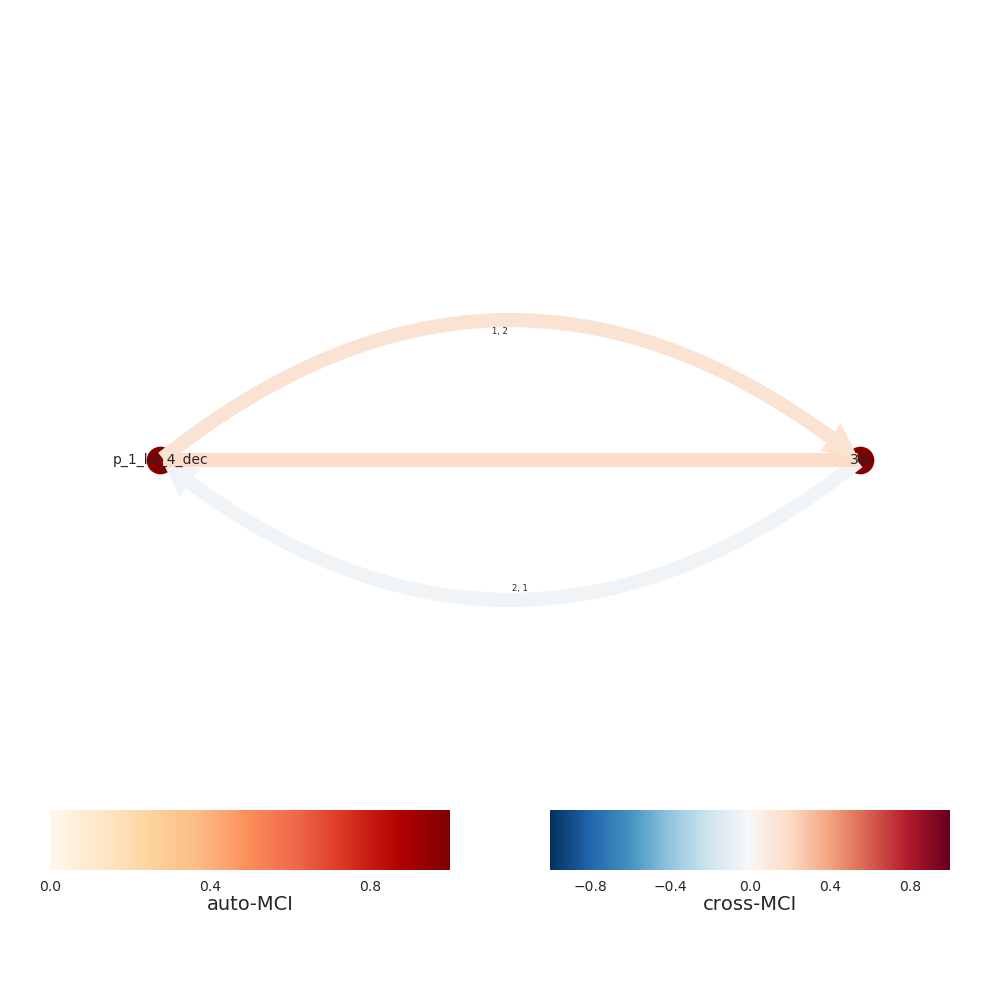

Progress causal inference - traintest set 100%
[INFO] Extracting level 7
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


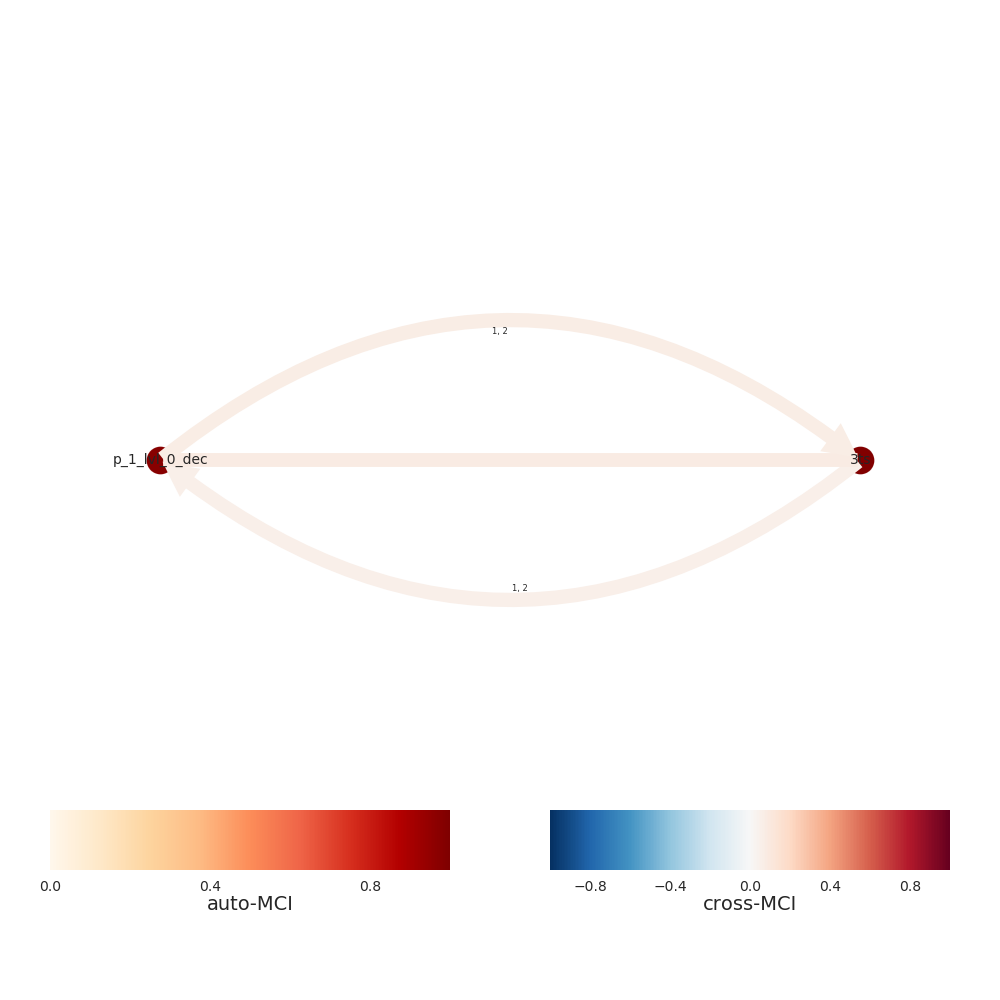

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


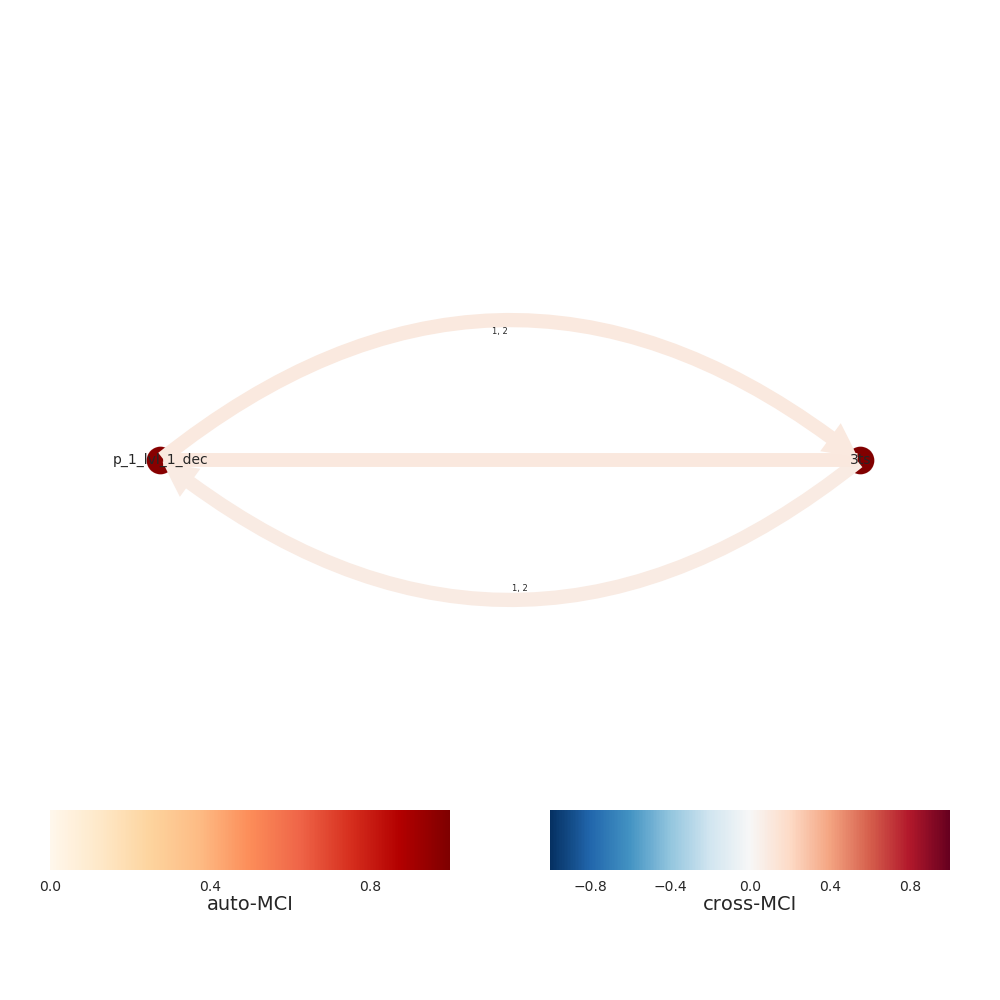

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


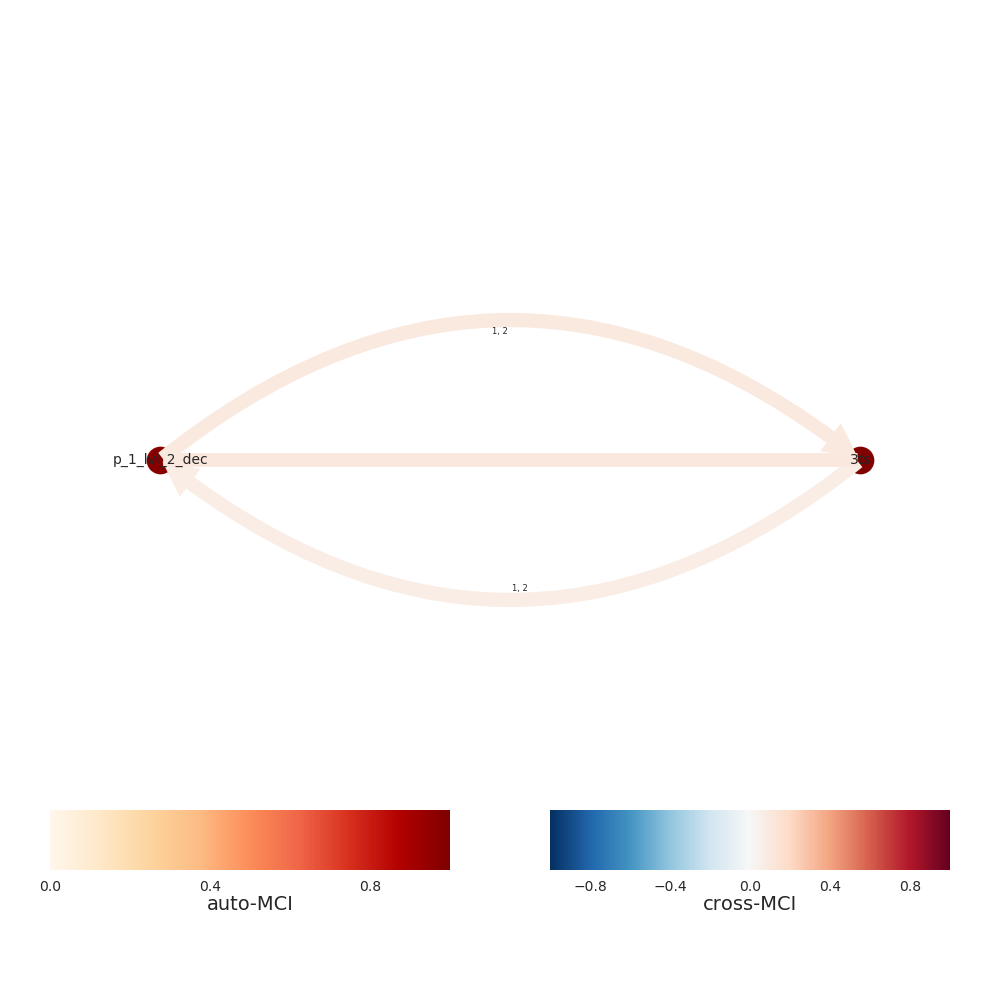

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


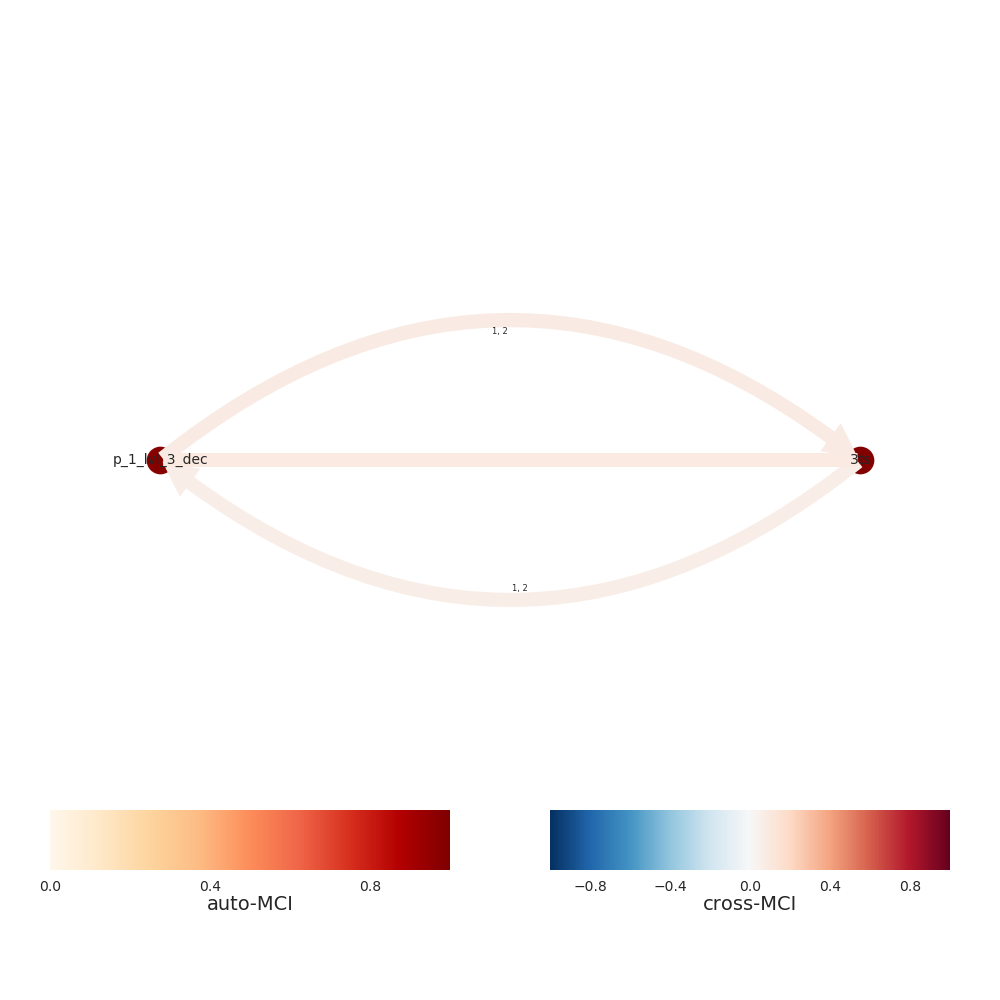

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


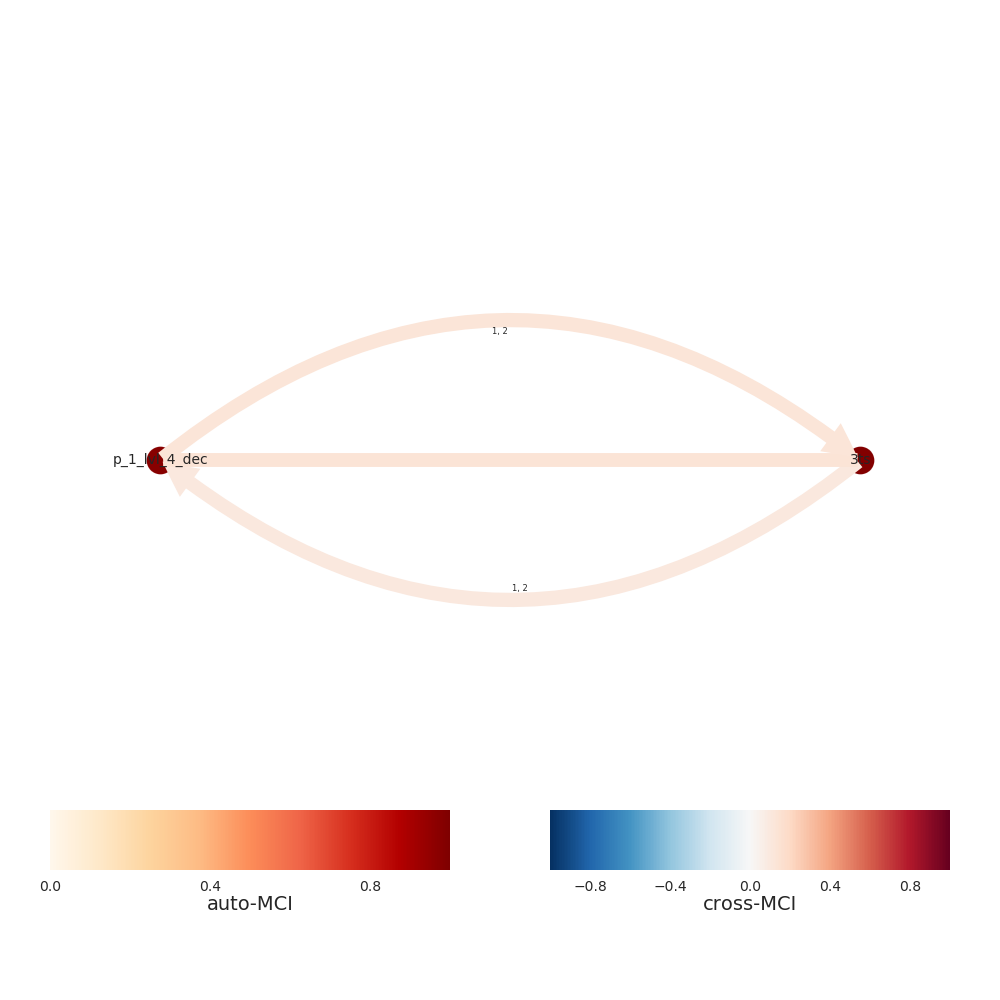

Progress causal inference - traintest set 100%
[INFO] Extracting level 8
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


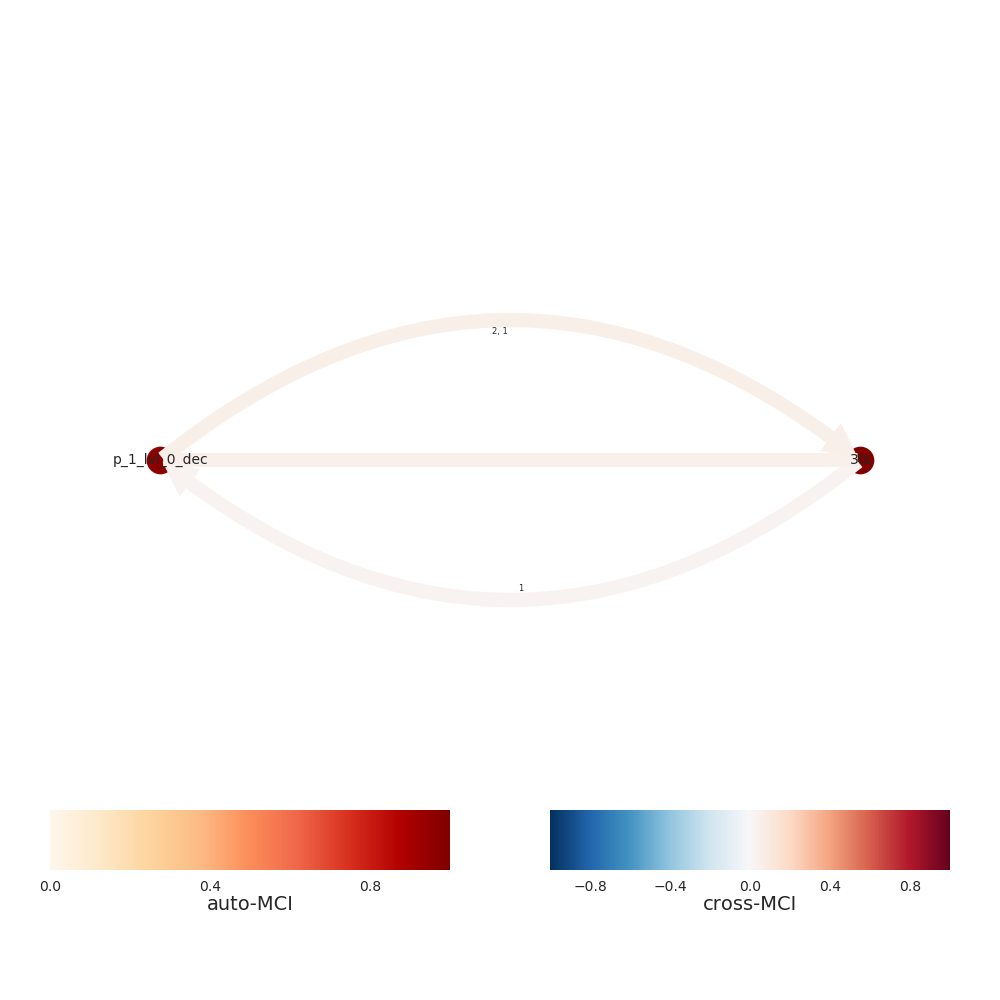

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


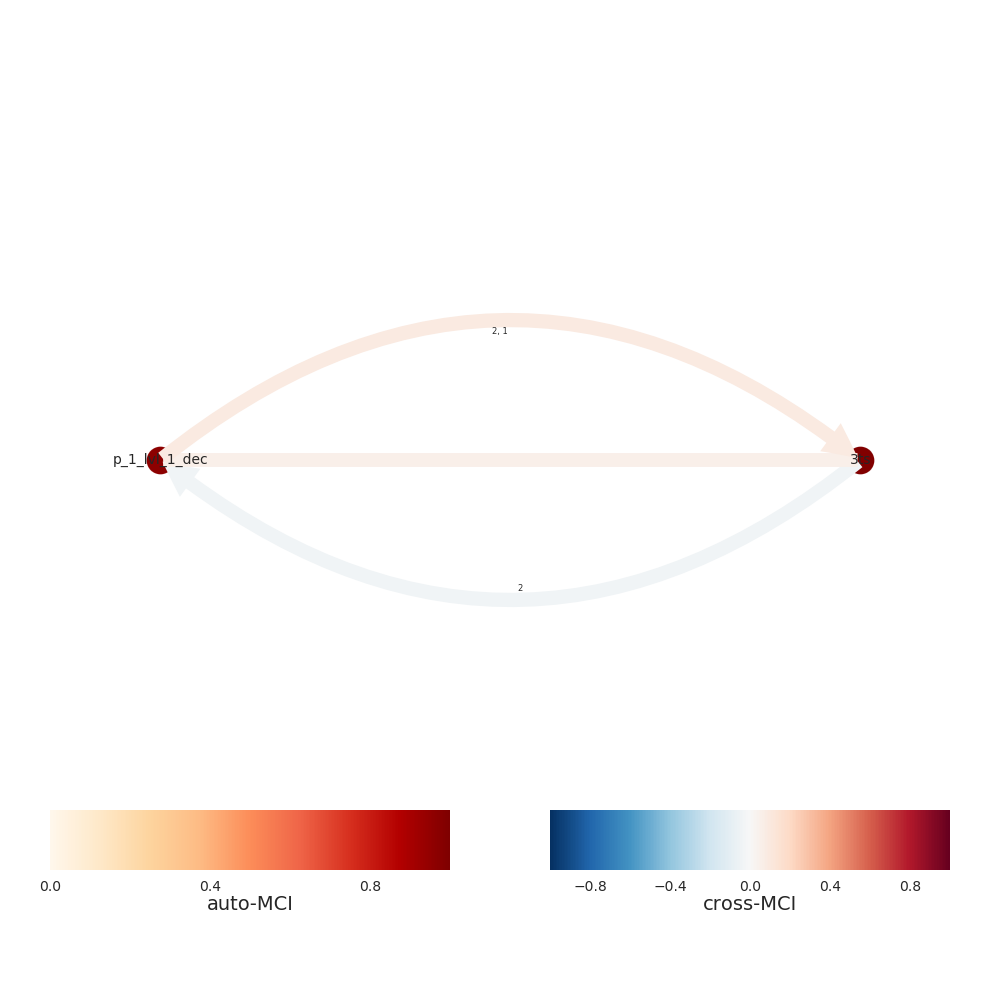

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


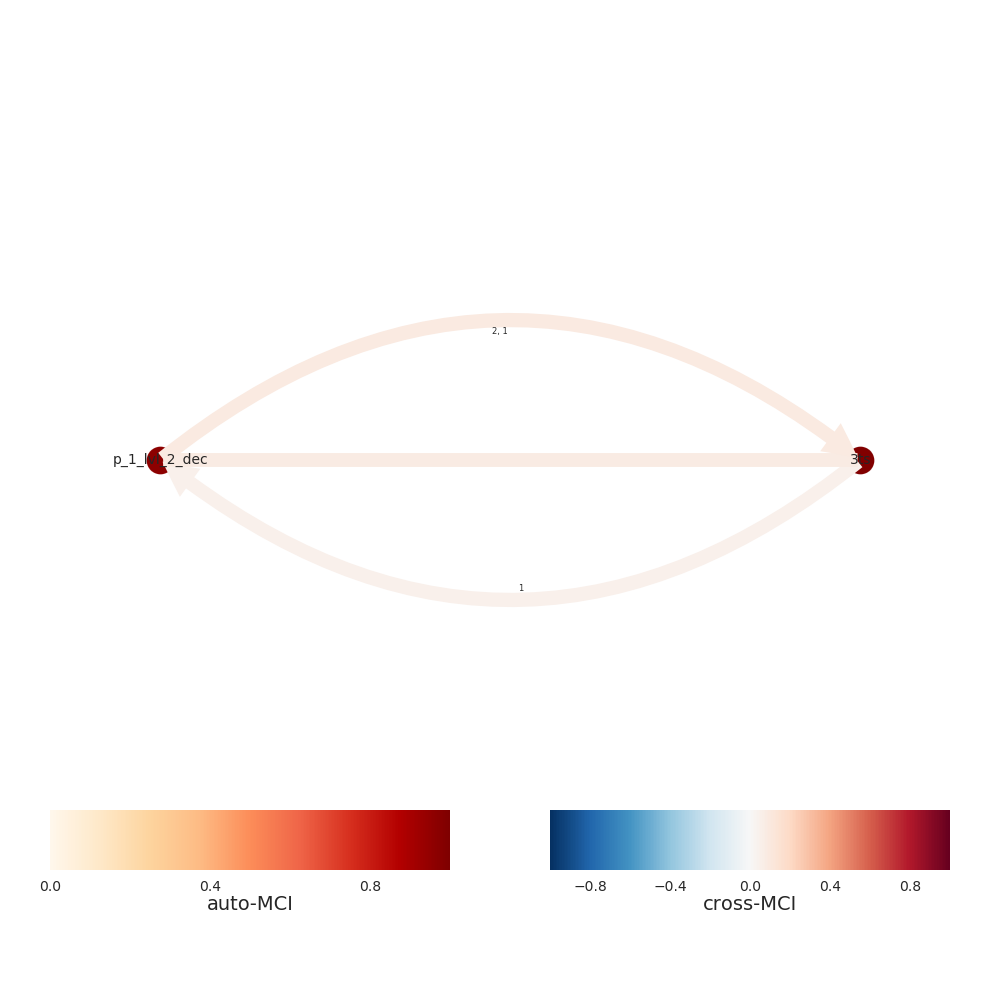

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


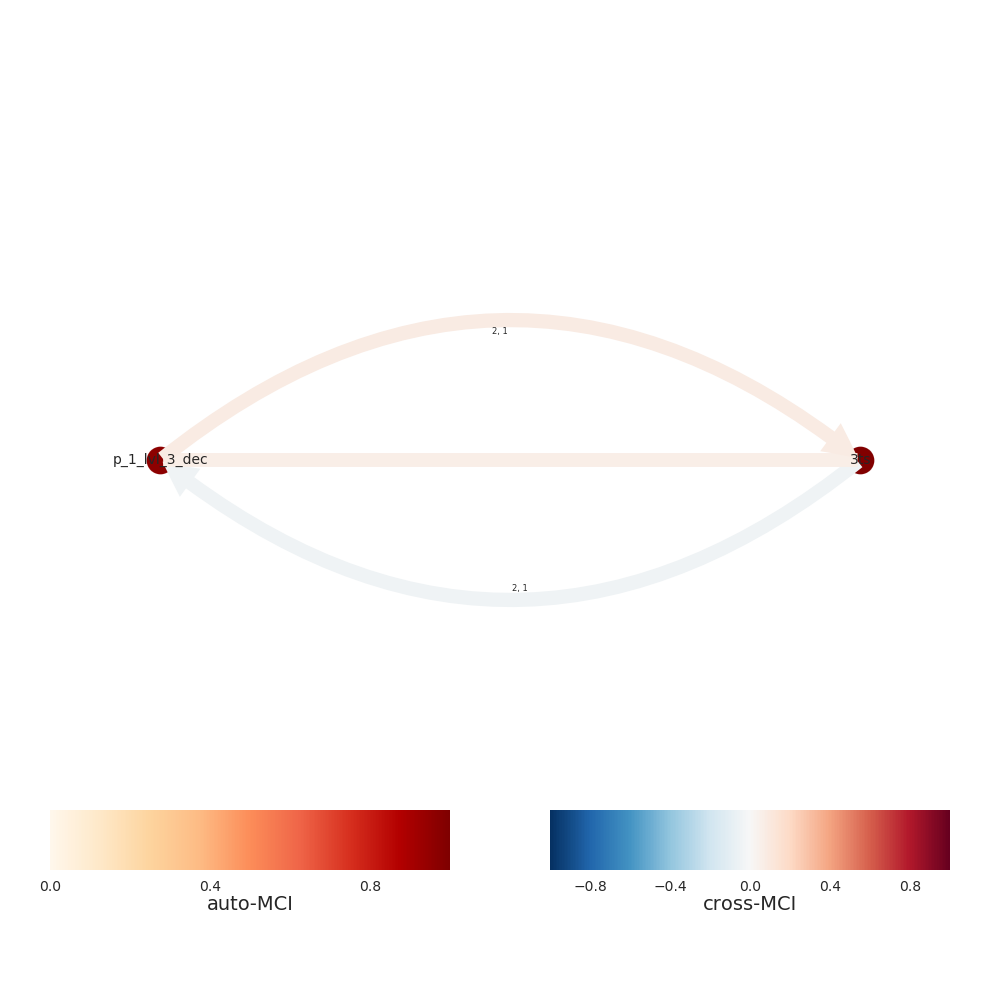

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


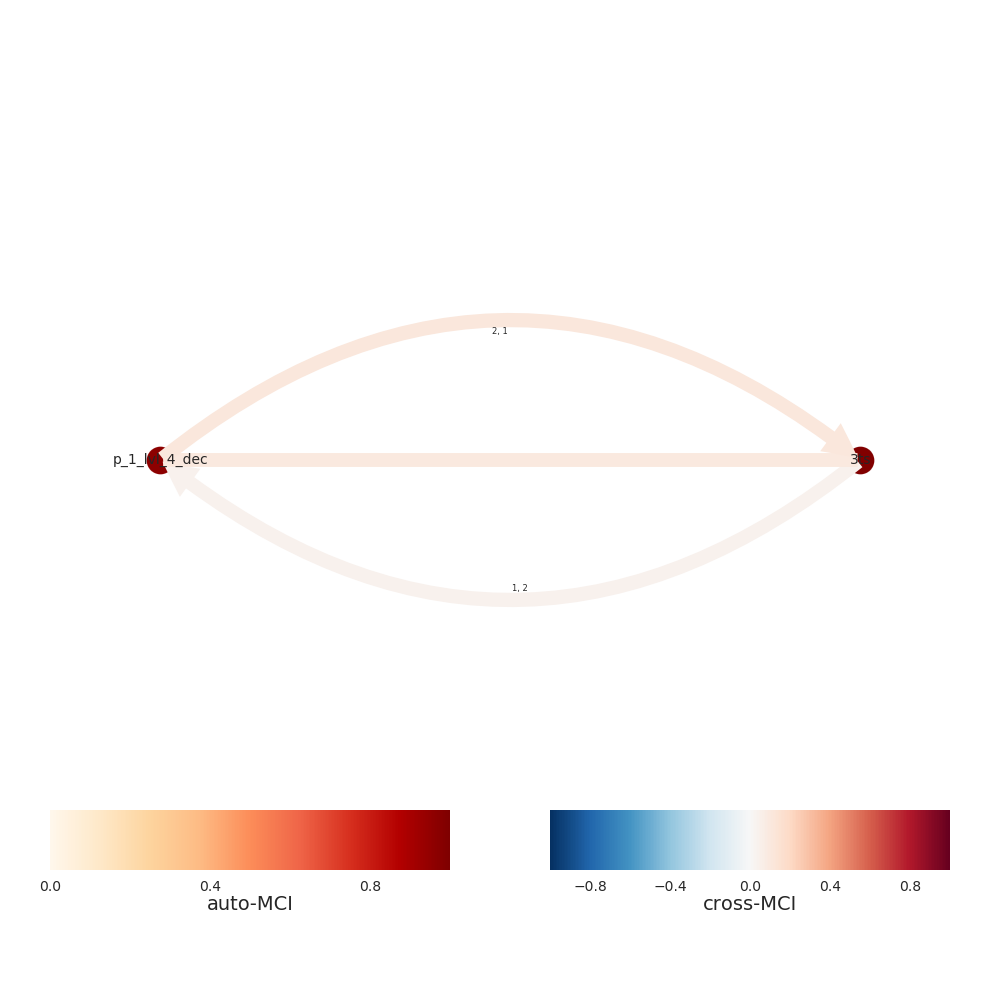

Progress causal inference - traintest set 100%
[INFO] Extracting level 9
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


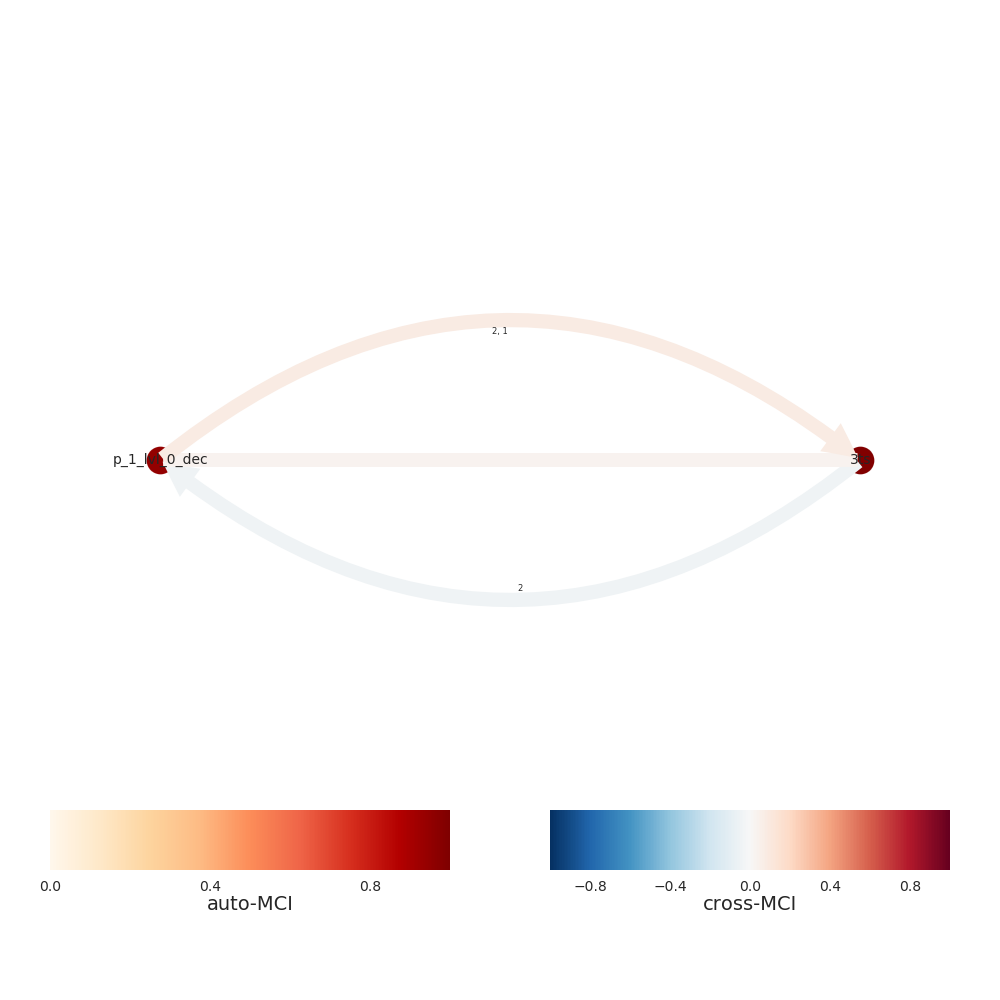

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


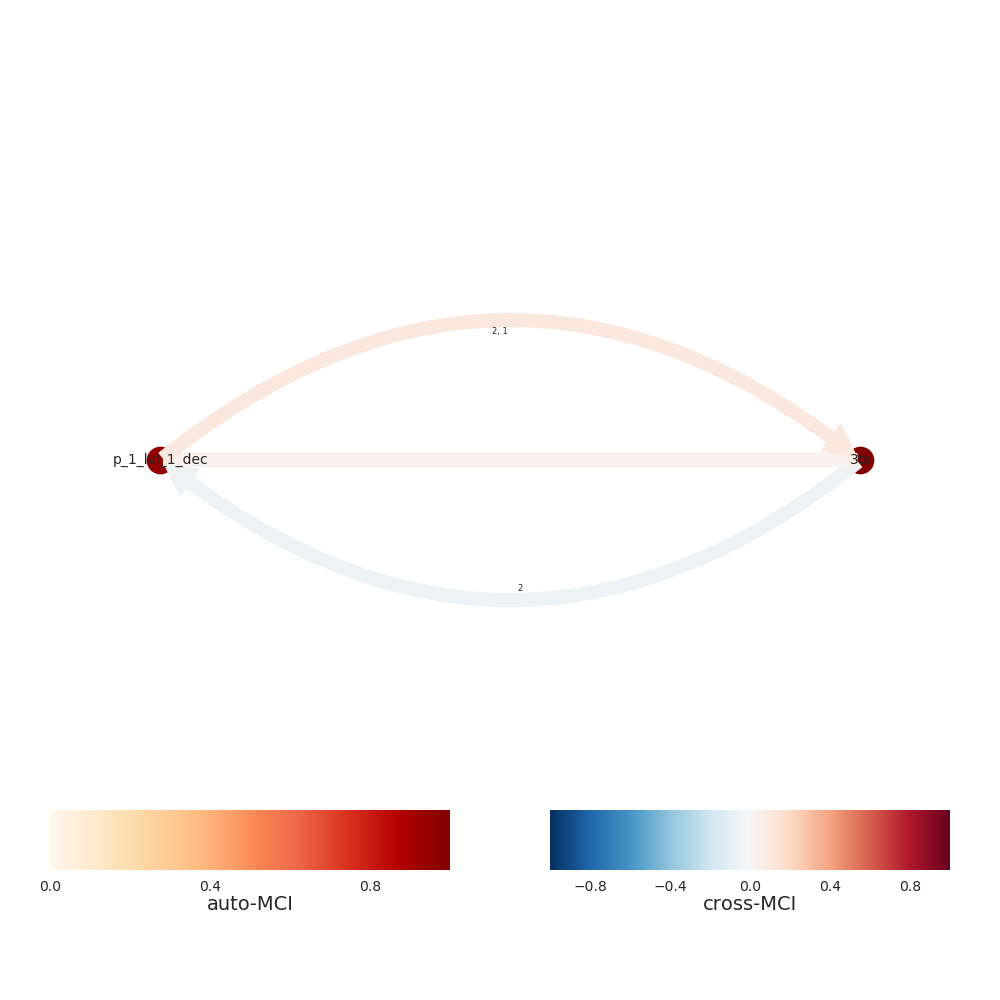

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


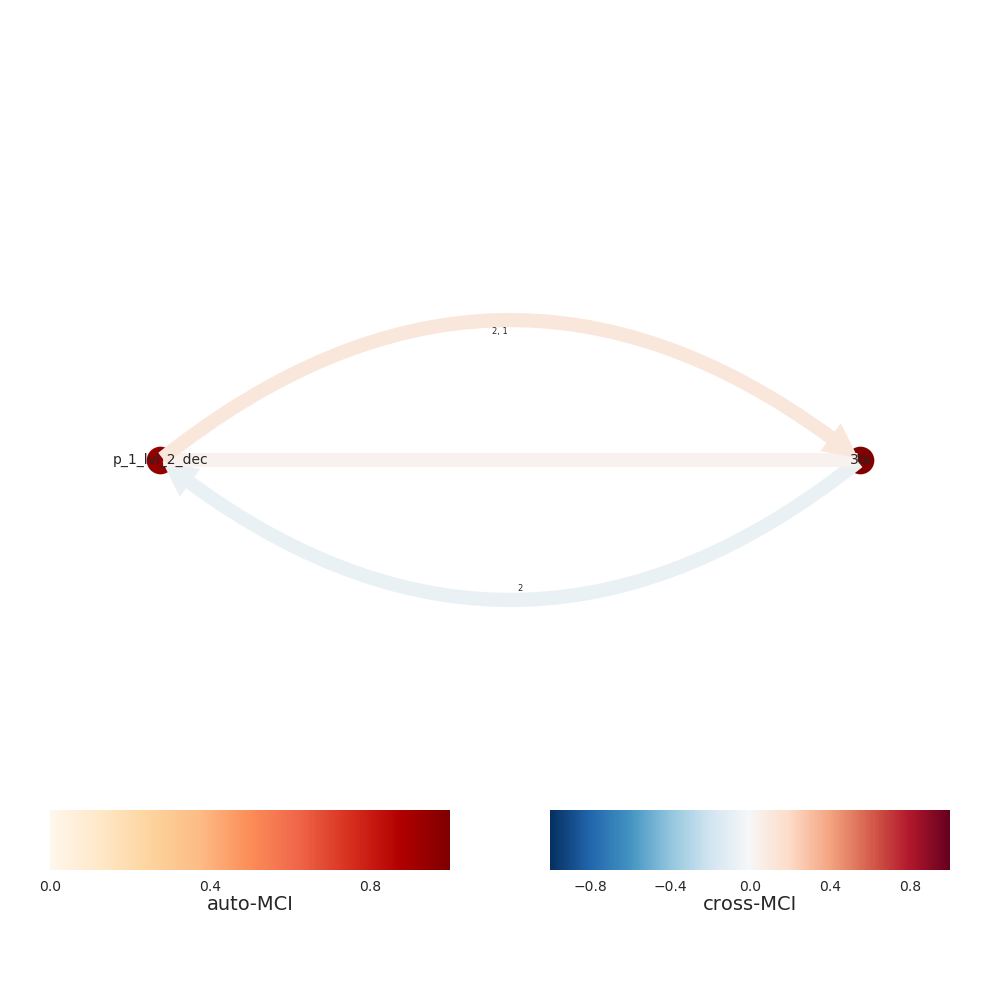

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


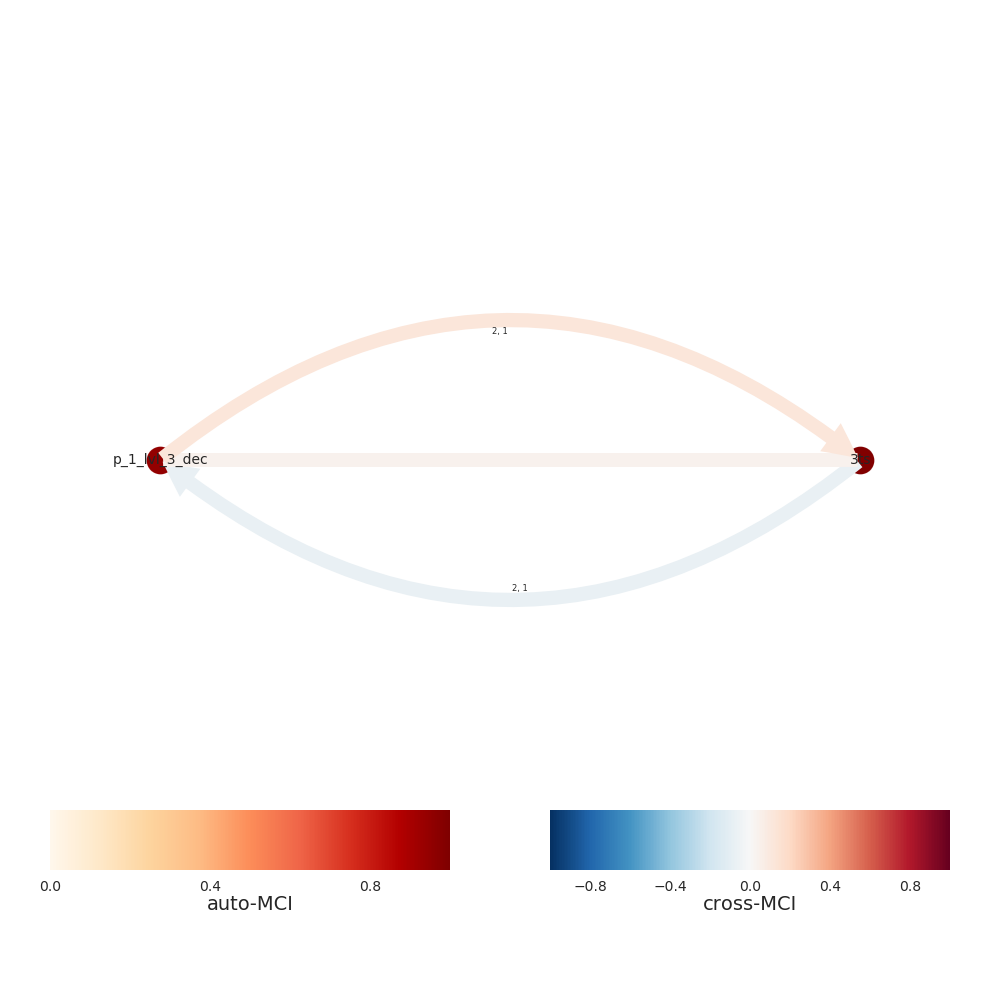

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


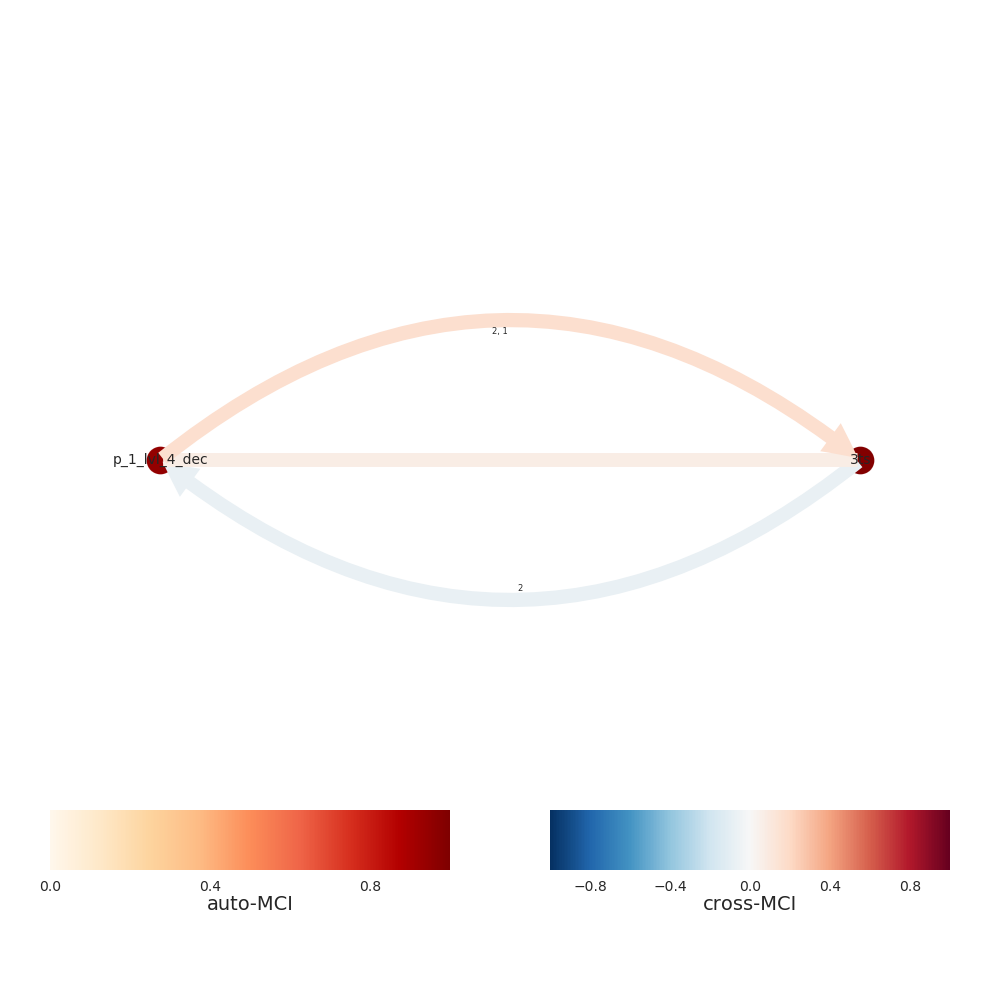

Progress causal inference - traintest set 100%
[INFO] Extracting level 10
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


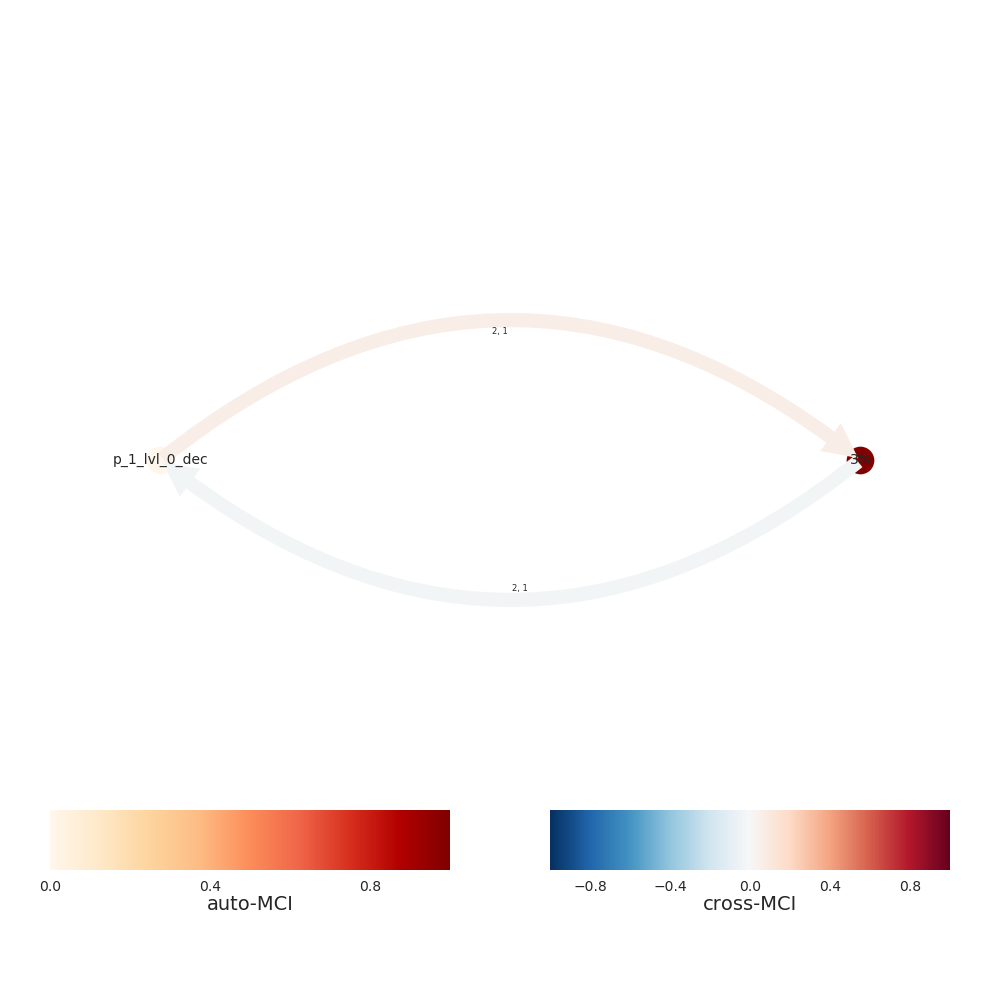

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


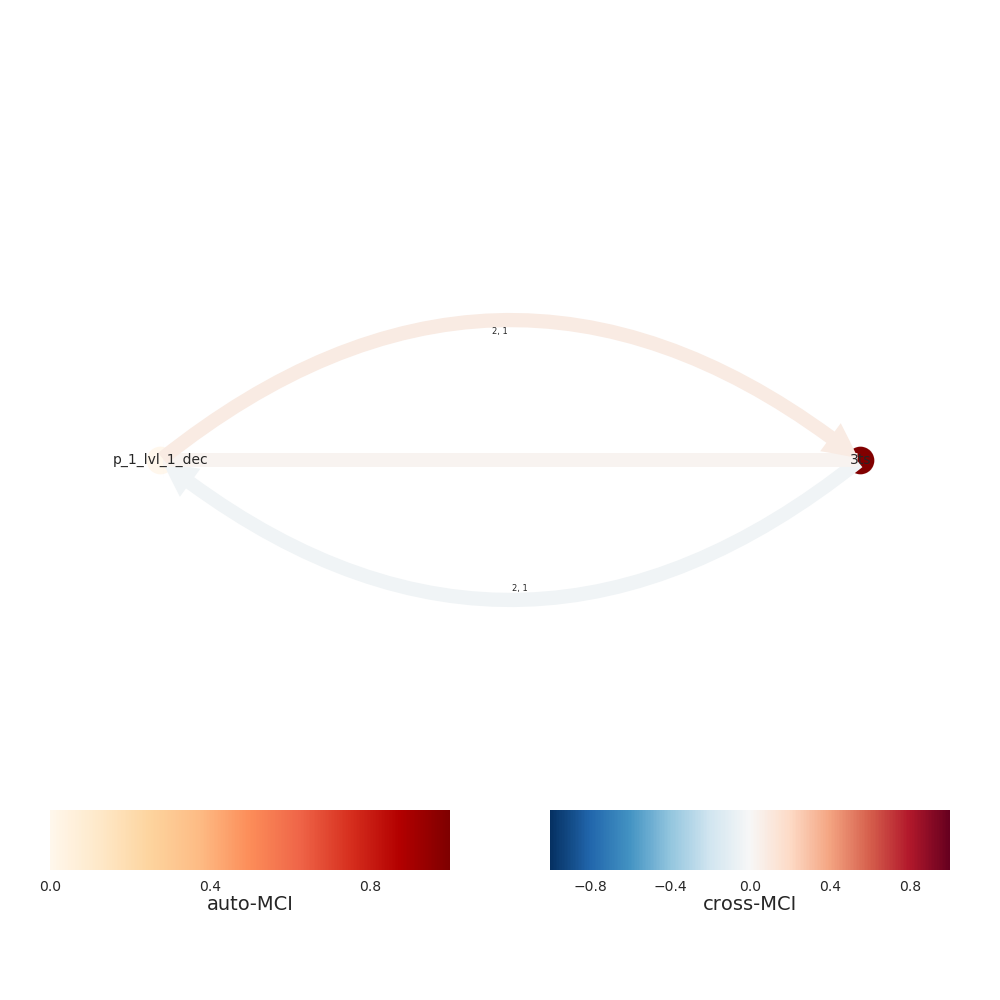

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


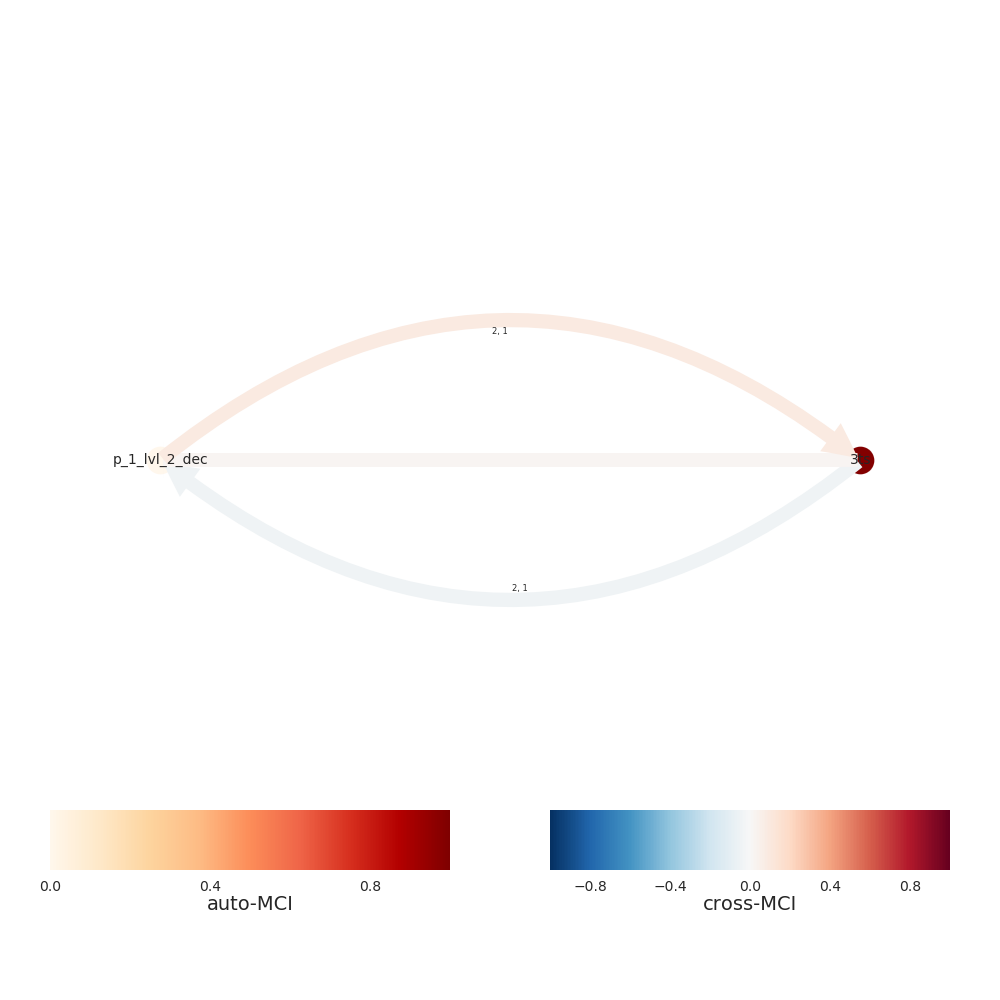

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


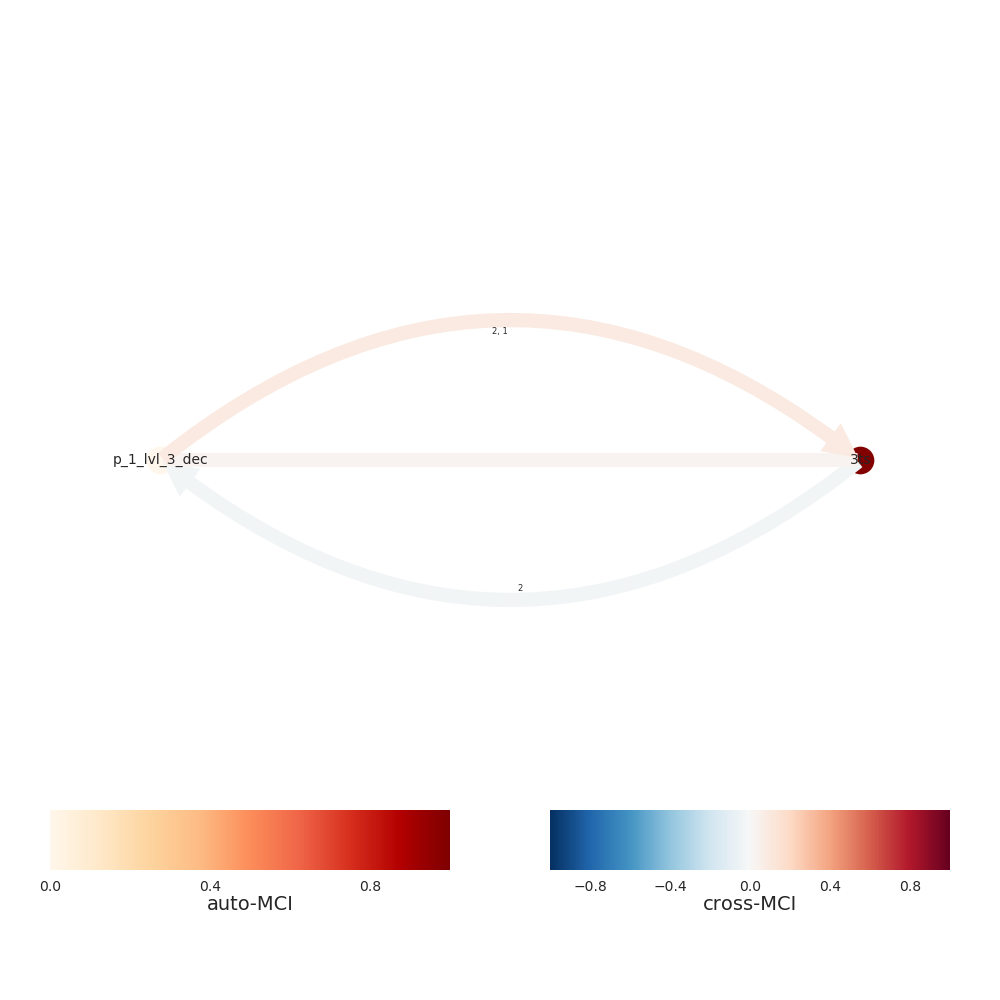

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


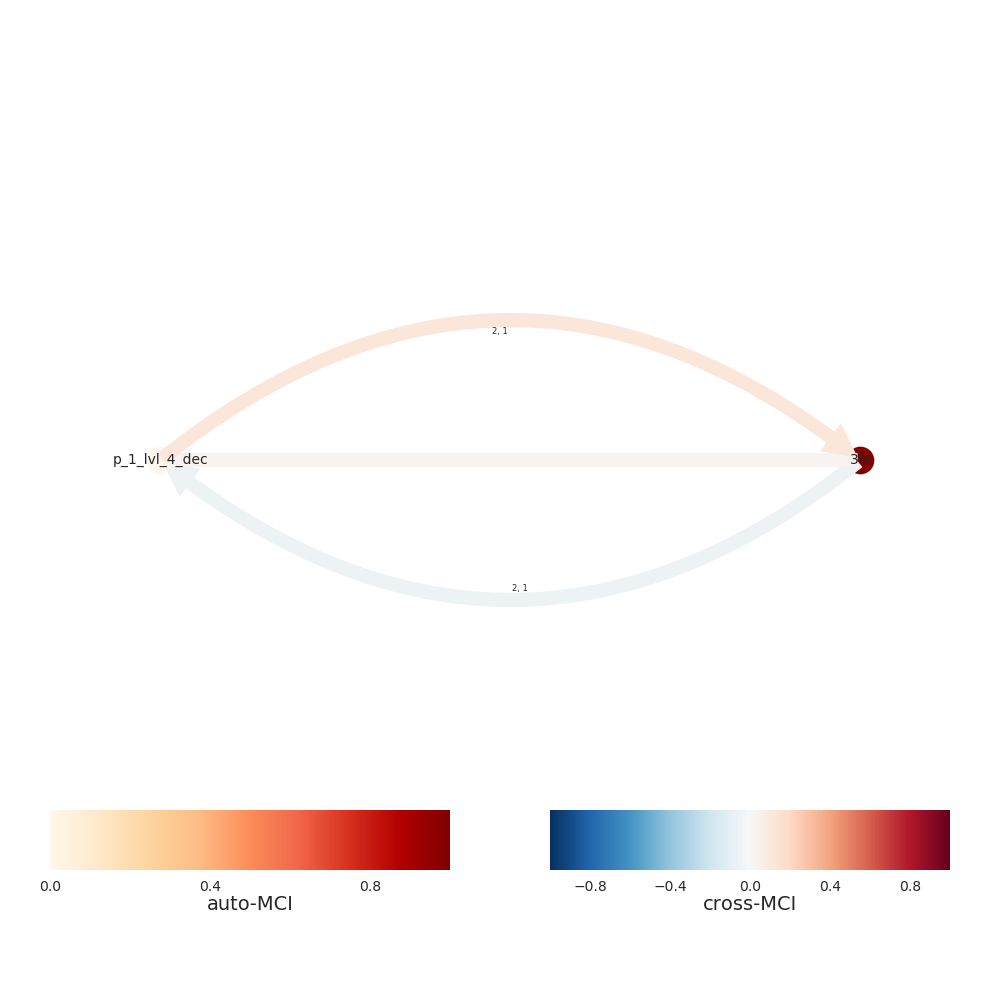

Progress causal inference - traintest set 100%
[INFO] Extracting level 11
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


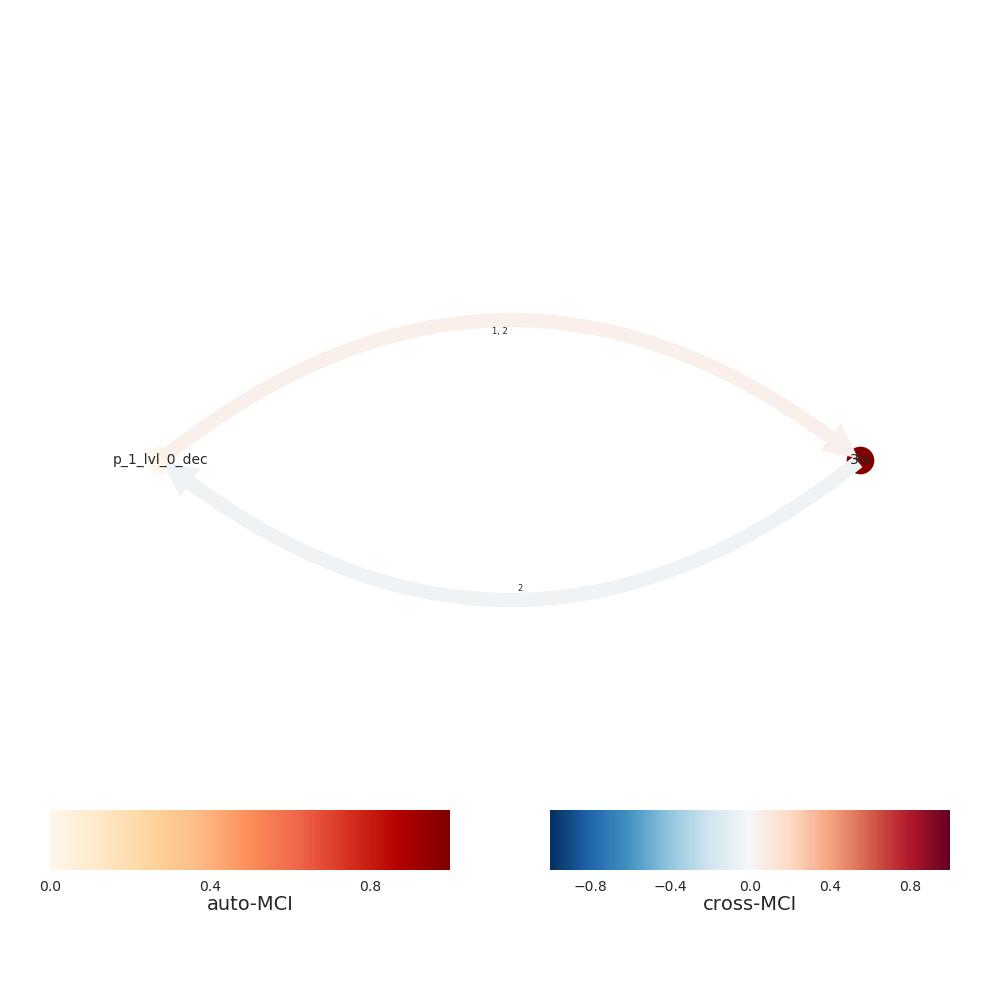

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


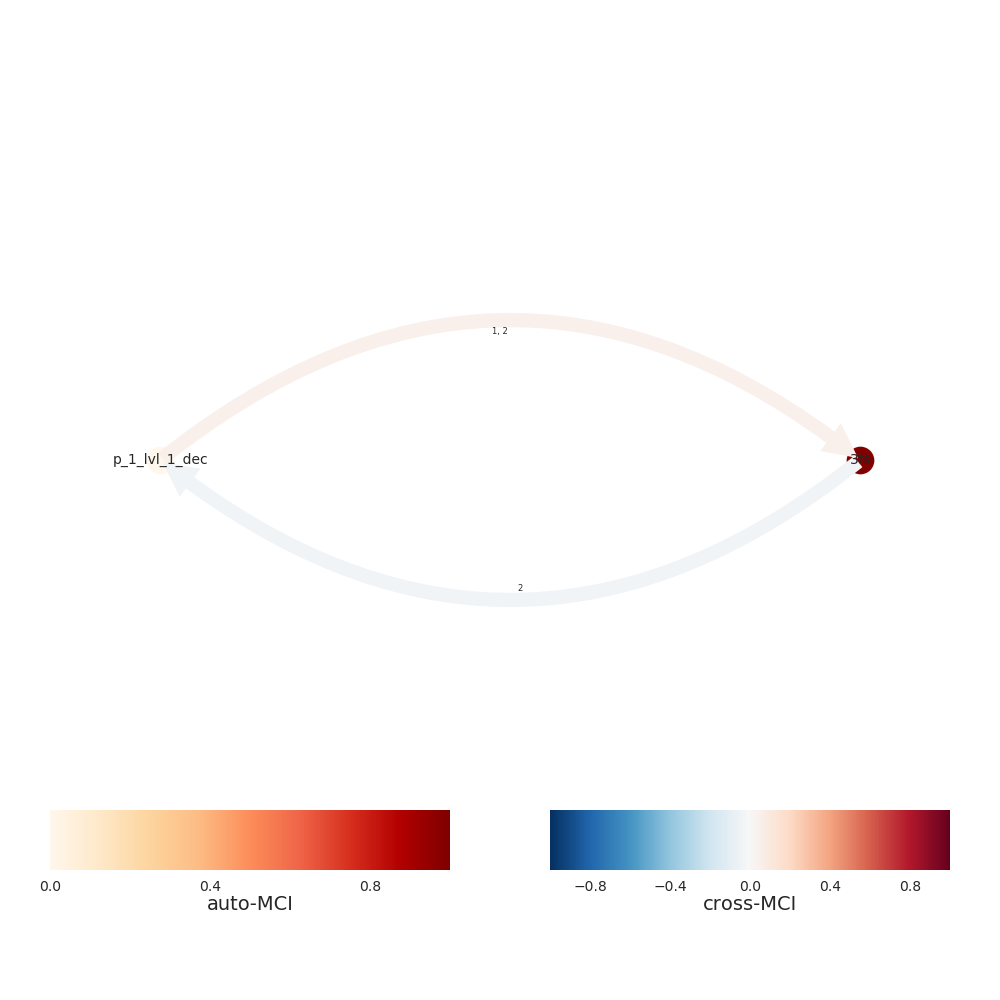

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


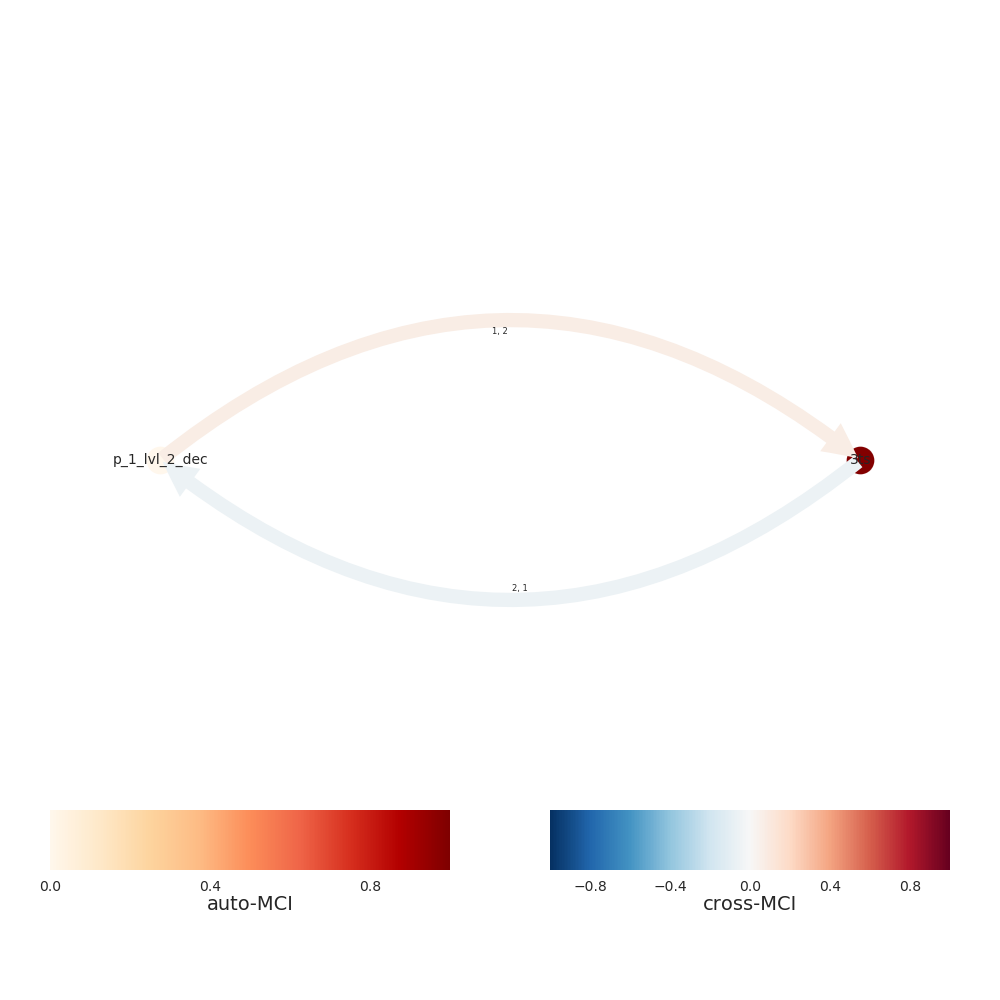

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


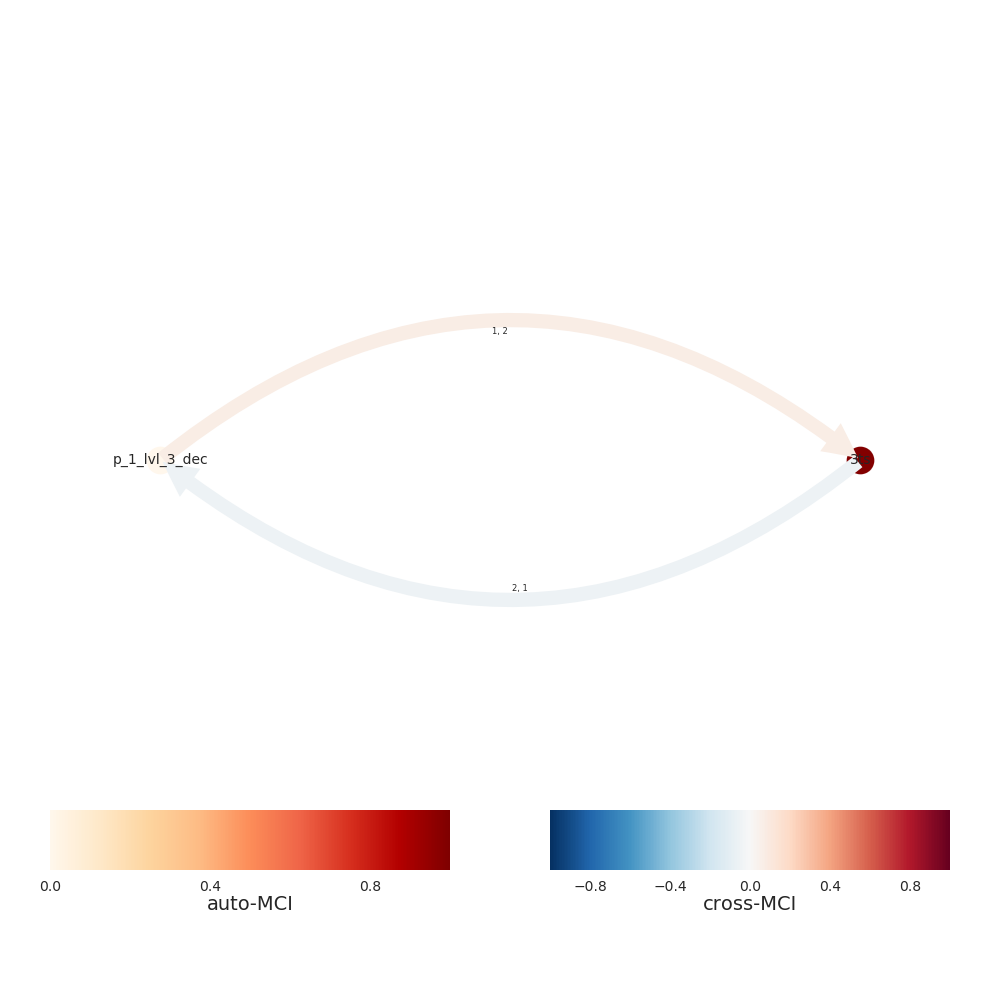

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


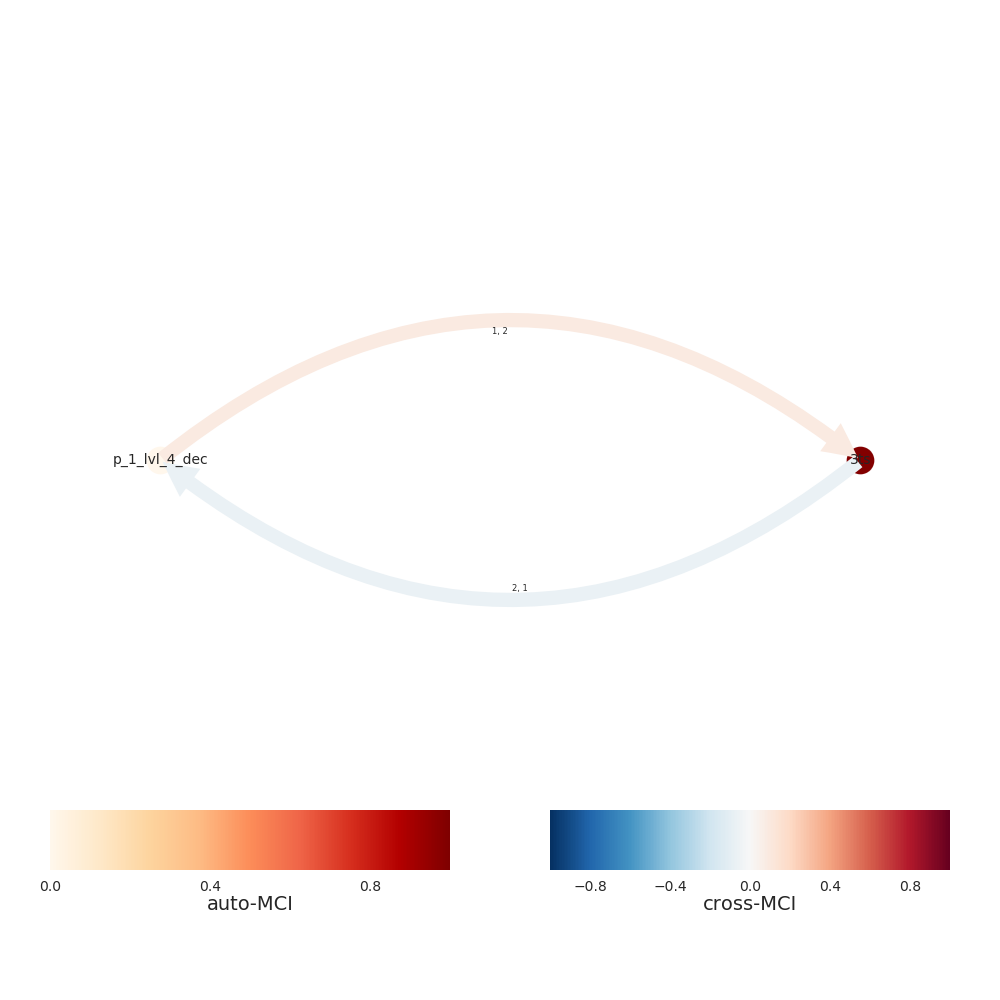

Progress causal inference - traintest set 100%

In [63]:
result_def = run_experiment_levels_default_lag(prepro_target, target_arr,rg_exp, rg_index, peak_test=True,total_levels=levels)

In [64]:
mc_def, _ = result_def

<IPython.core.display.Javascript object>


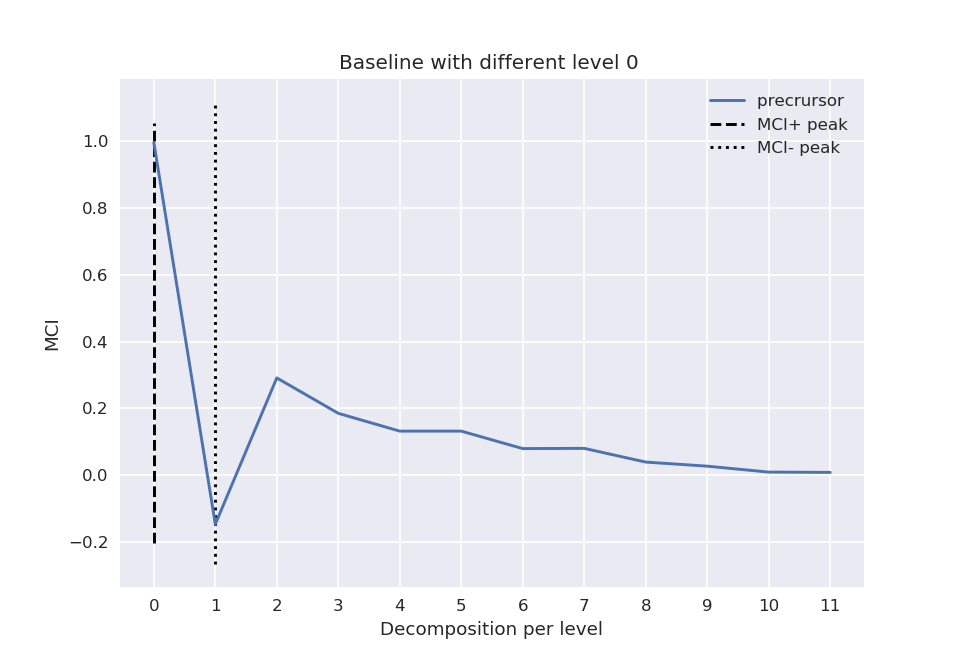

<IPython.core.display.Javascript object>


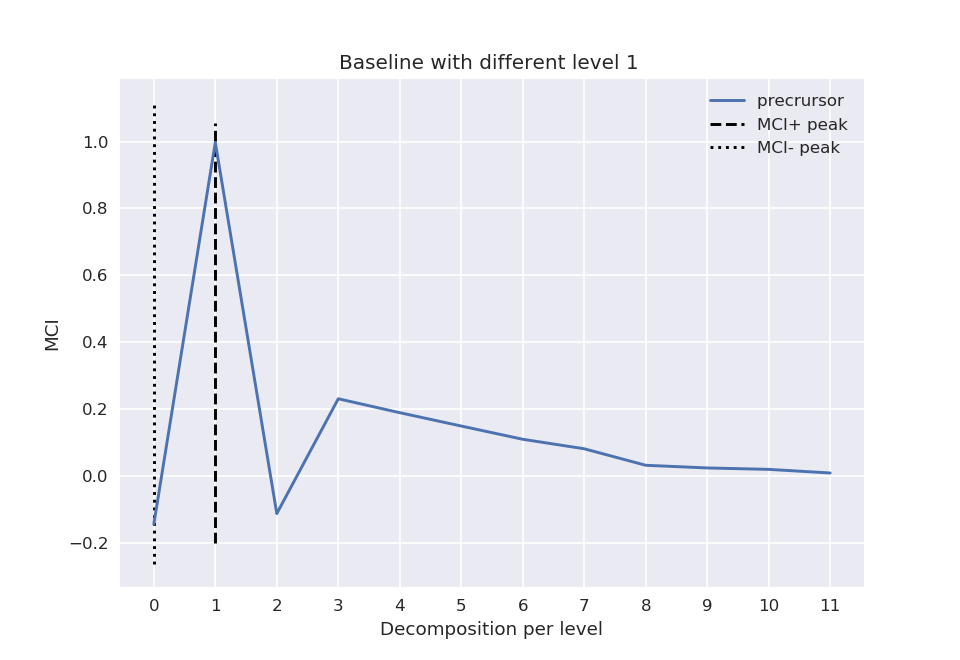

<IPython.core.display.Javascript object>


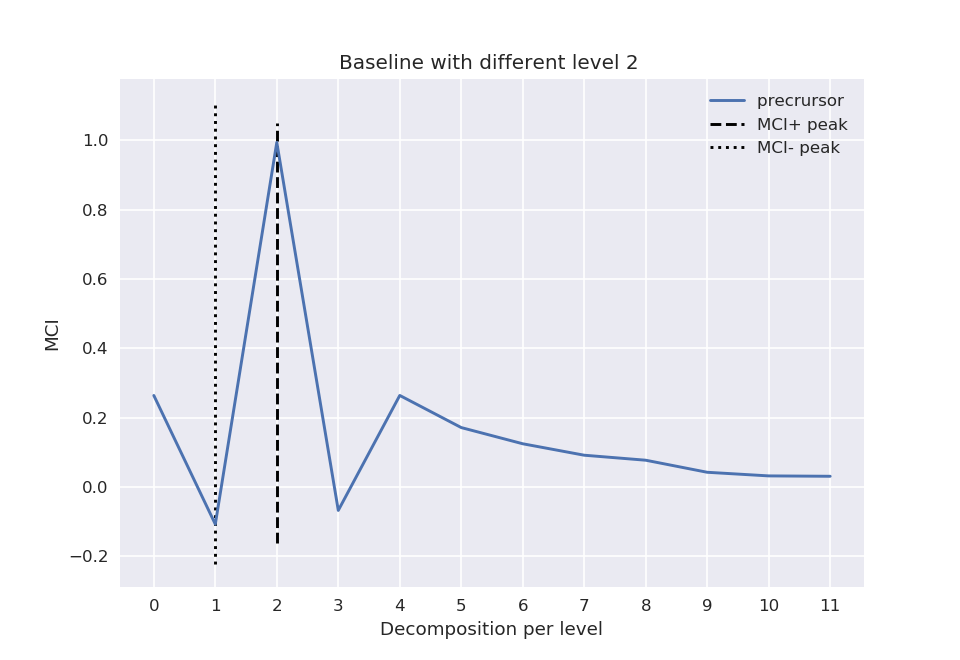

<IPython.core.display.Javascript object>


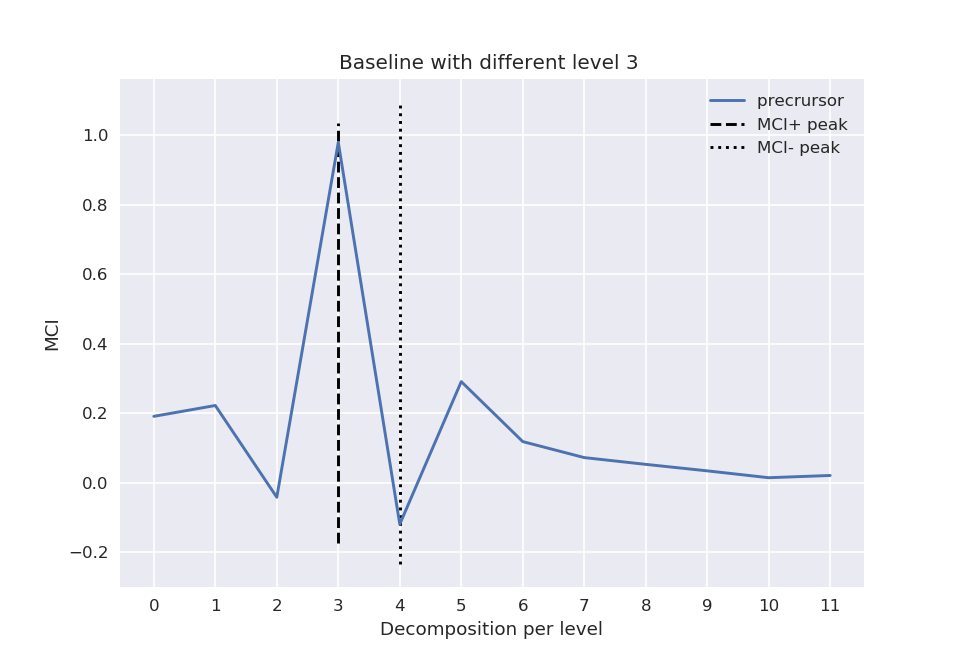

<IPython.core.display.Javascript object>


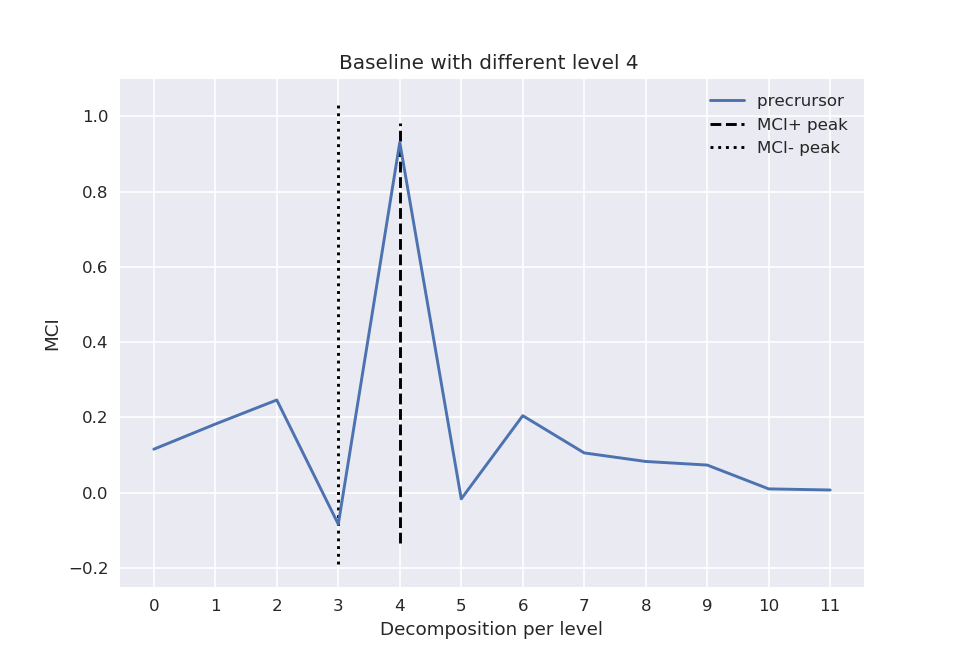

<IPython.core.display.Javascript object>


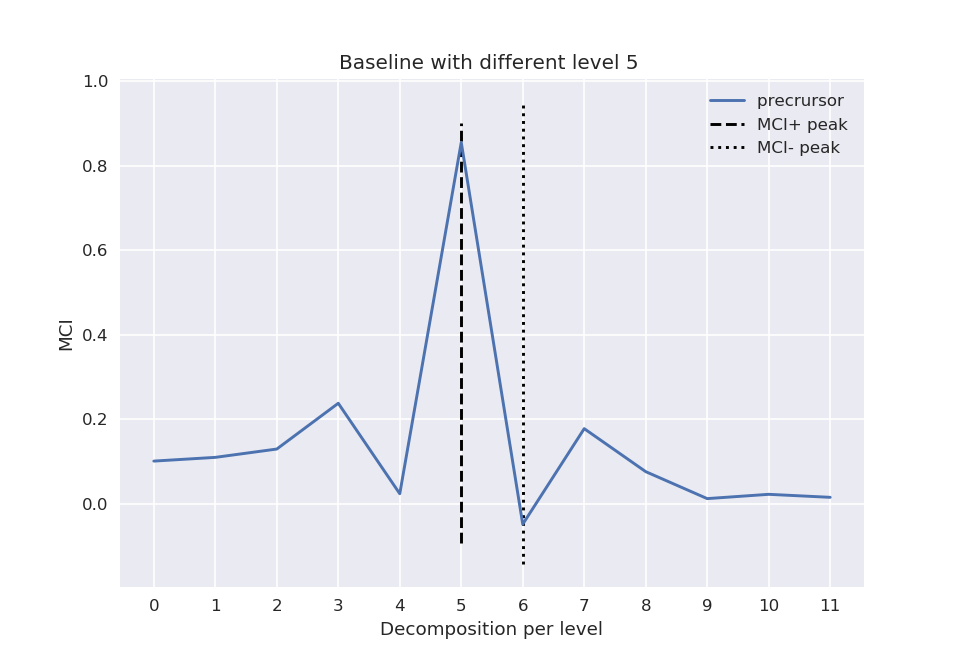

<IPython.core.display.Javascript object>


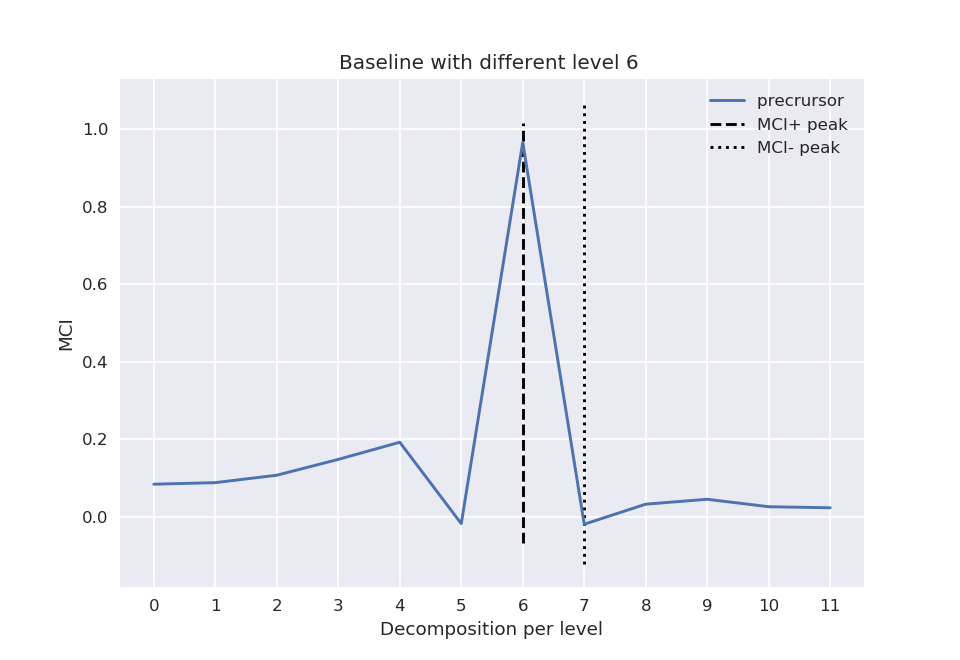

<IPython.core.display.Javascript object>


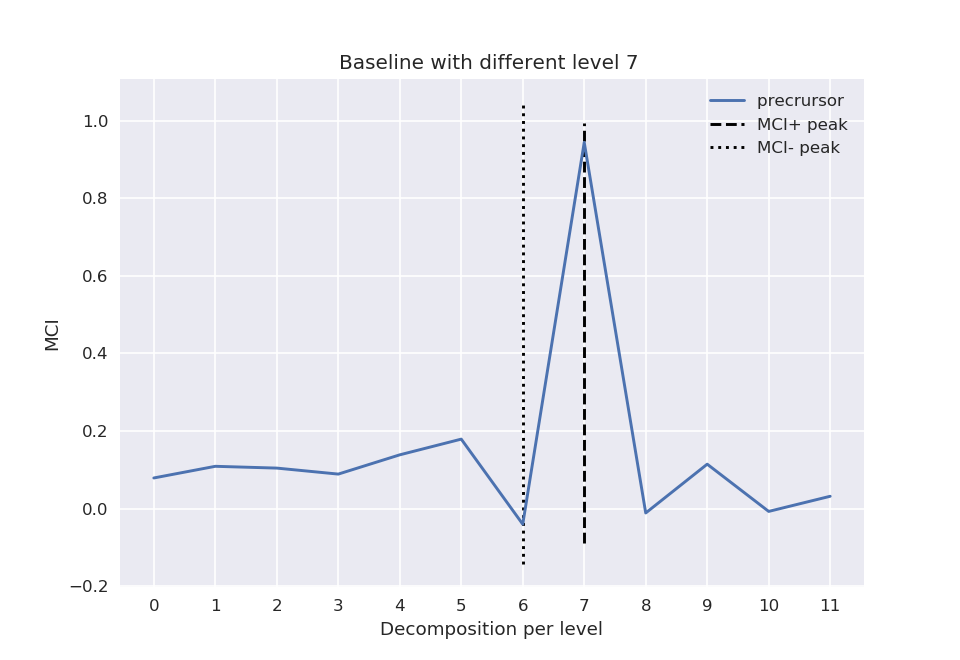

<IPython.core.display.Javascript object>


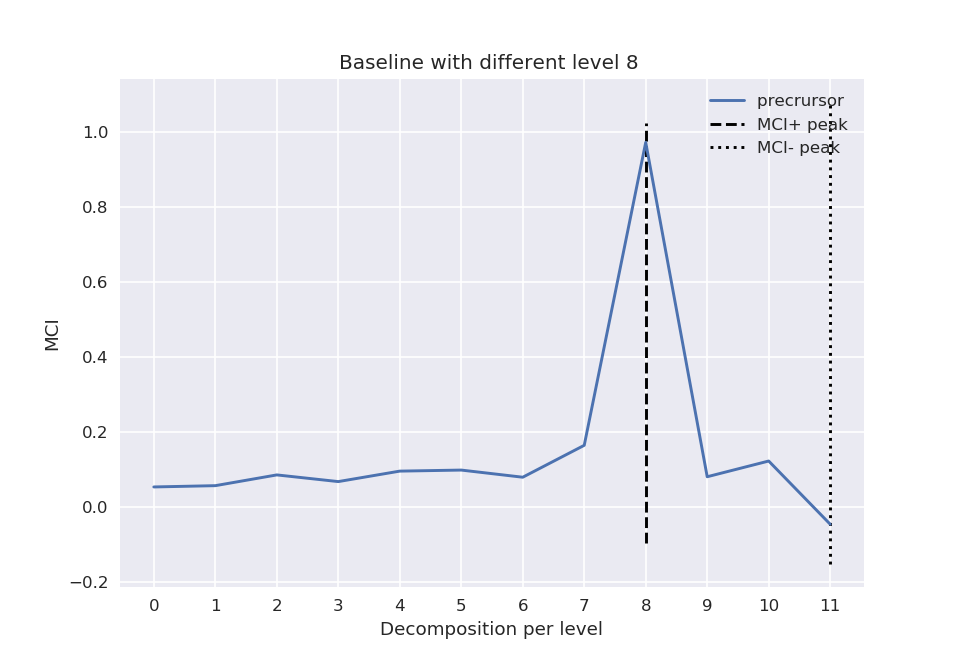

<IPython.core.display.Javascript object>


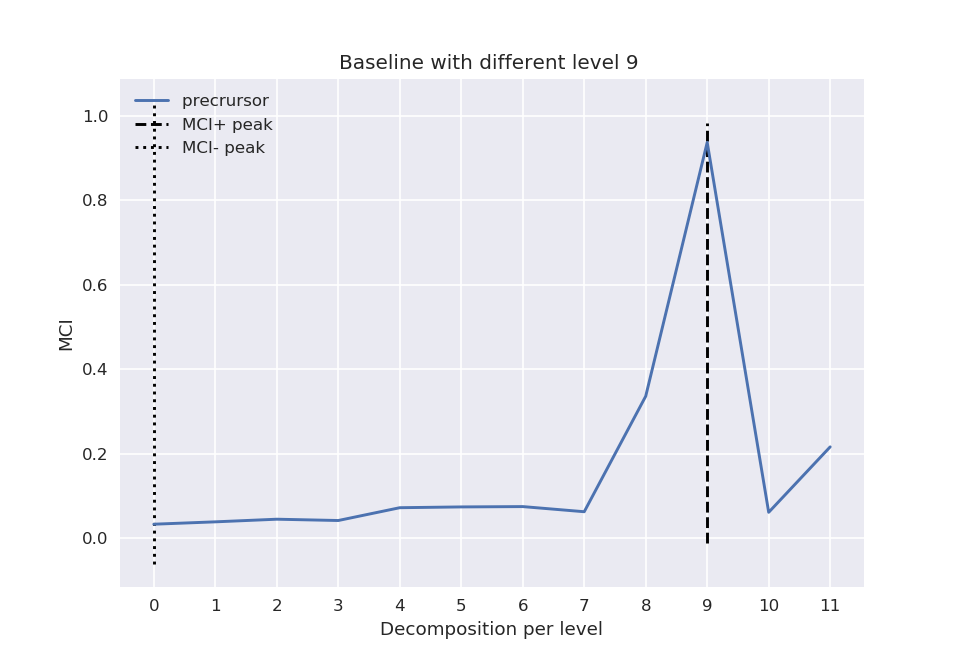

<IPython.core.display.Javascript object>


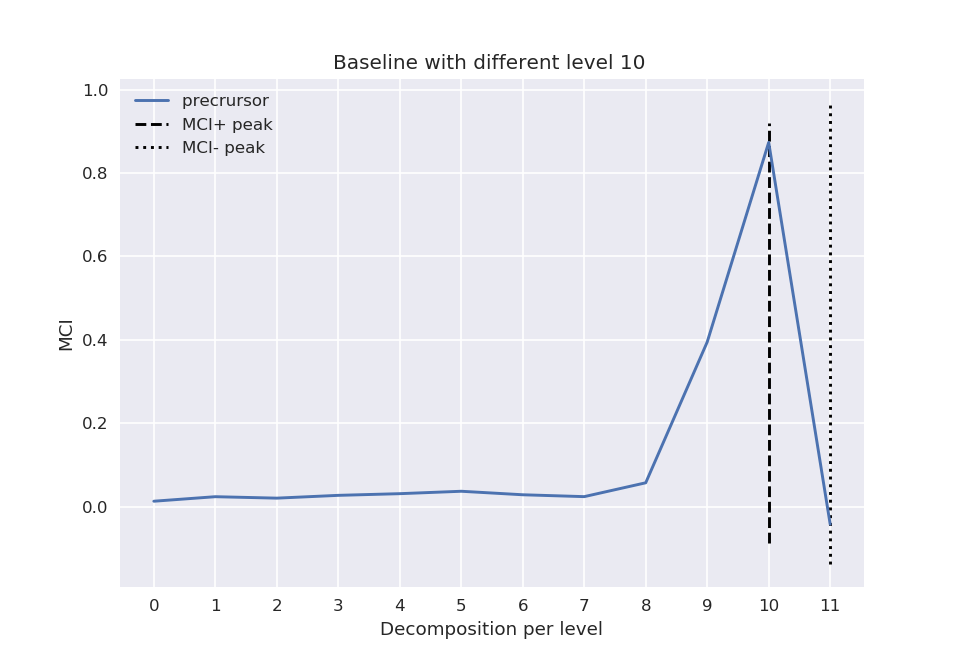

<IPython.core.display.Javascript object>


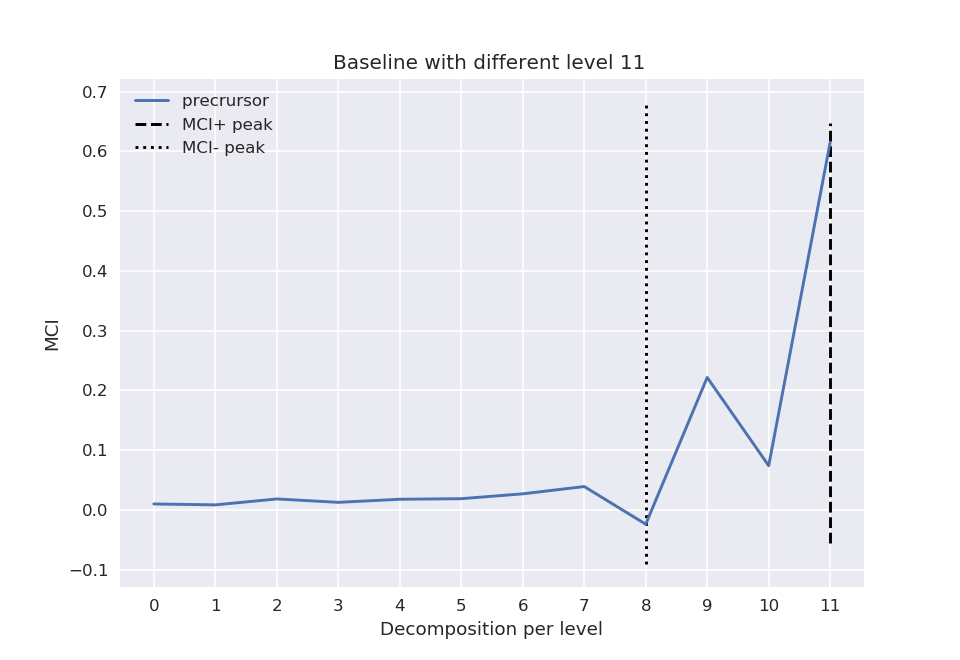

In [65]:
for i, peak in enumerate(mc_def):
    if abs(len(mc_def) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(mc_def)-1), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} ', show_level=True, savefig=False)
    else:
        plot_mci_pred_relation(cA=range(len(mc_def)), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} ', show_level=True, savefig=False)

### Run experiment with wavelet decomposition on yprime tau_min=tau_max=0

In [66]:
result_extra = run_experiment_levels(prepro_target, target_arr,rg_exp, rg_index, peak_test=True,total_levels=levels)


[INFO] Extracting level 0

[INFO] Extracting level 1

[INFO] Extracting level 2

[INFO] Extracting level 3

[INFO] Extracting level 4

[INFO] Extracting level 5

[INFO] Extracting level 6

[INFO] Extracting level 7

[INFO] Extracting level 8

[INFO] Extracting level 9

[INFO] Extracting level 10

[INFO] Extracting level 11
Progress causal inference - traintest set 100%

In [67]:
mcs, _,_ = result_extra

<IPython.core.display.Javascript object>


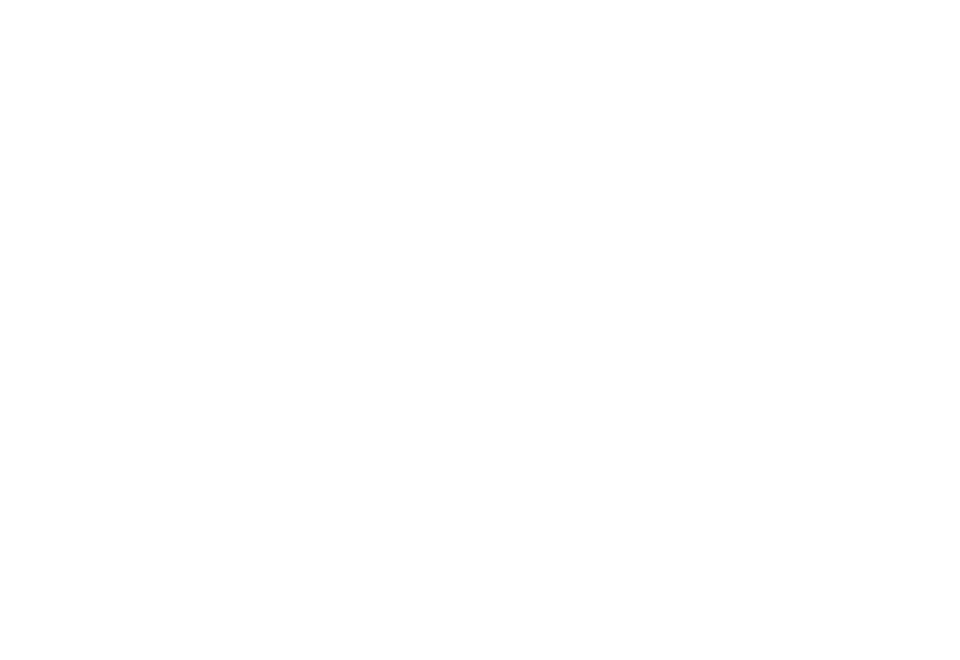

<IPython.core.display.Javascript object>


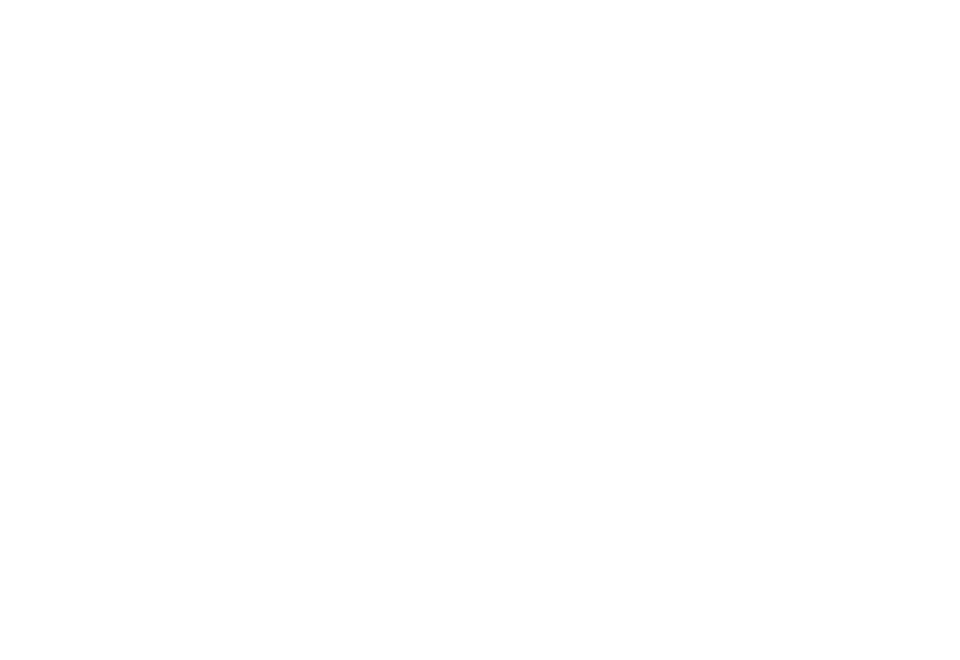

<IPython.core.display.Javascript object>


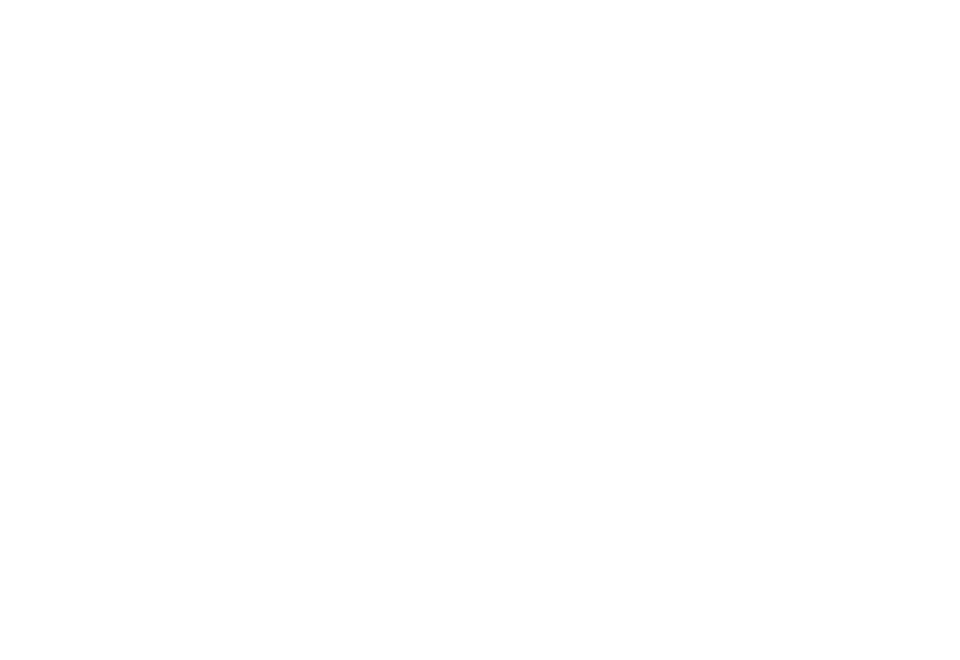

<IPython.core.display.Javascript object>


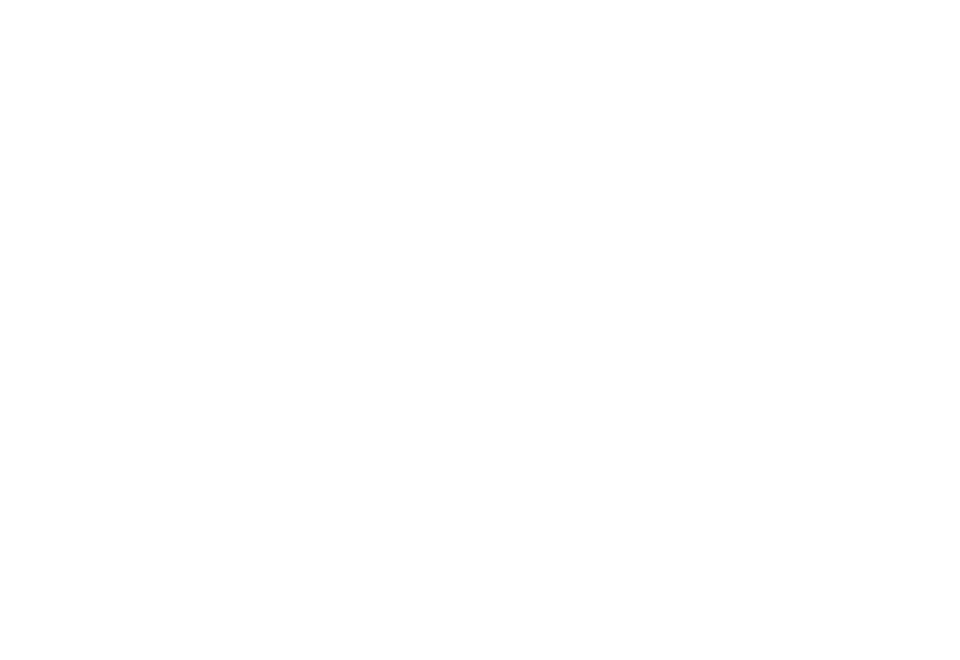

<IPython.core.display.Javascript object>


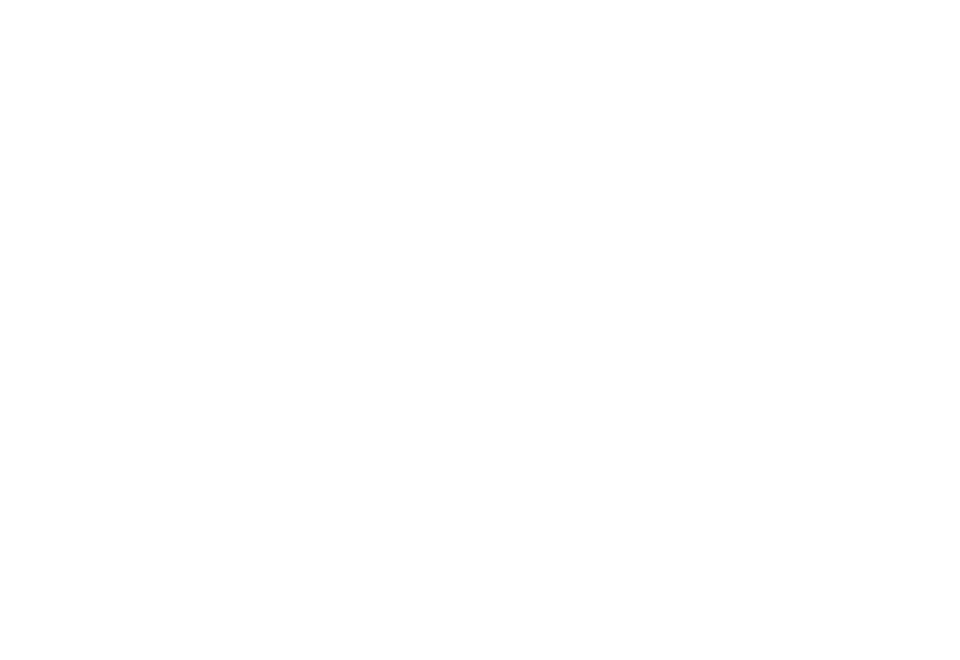

<IPython.core.display.Javascript object>


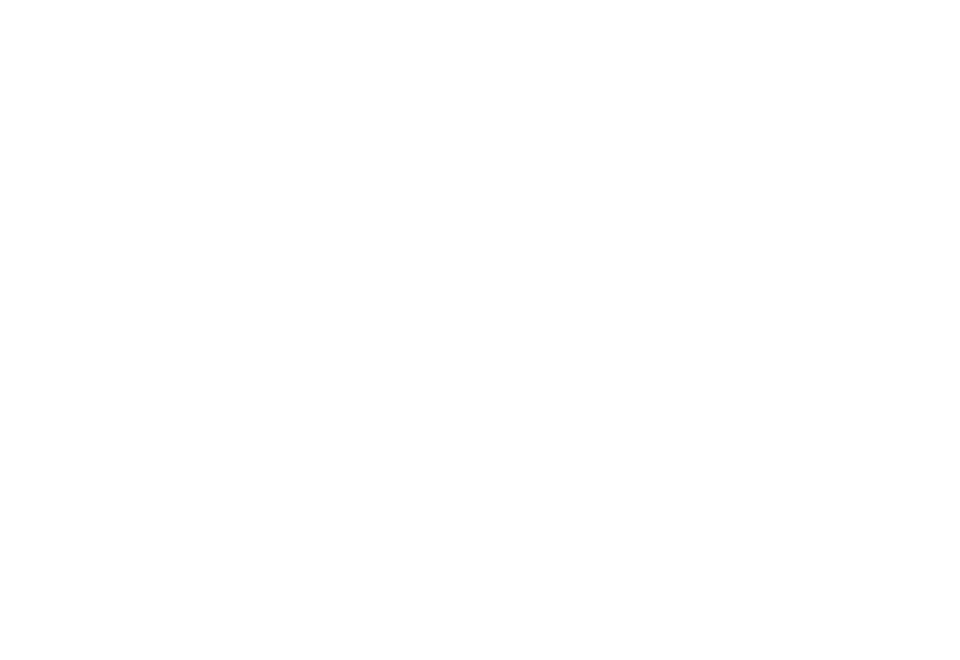

<IPython.core.display.Javascript object>


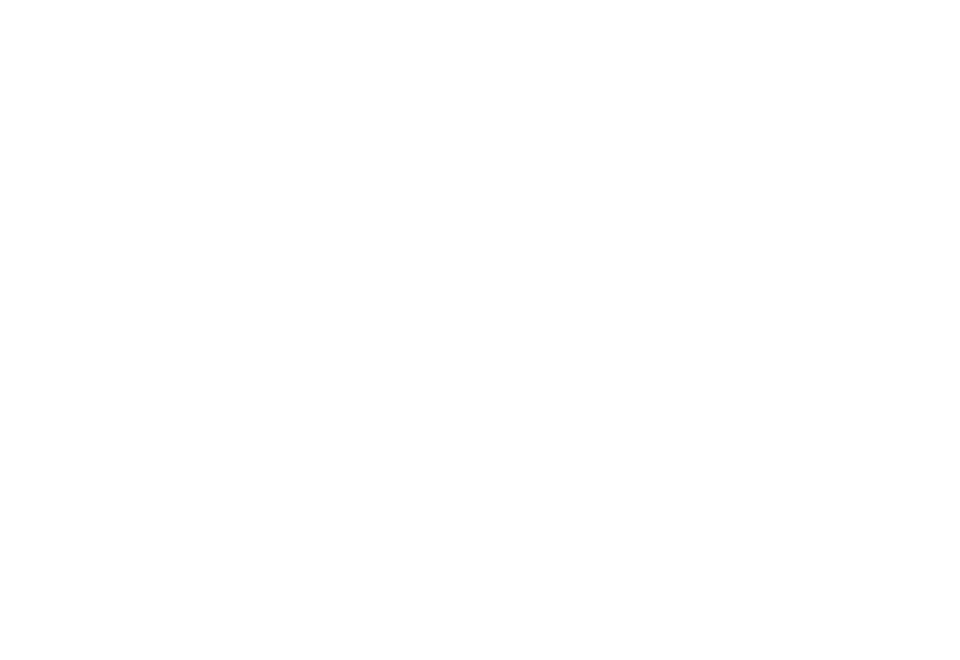

<IPython.core.display.Javascript object>


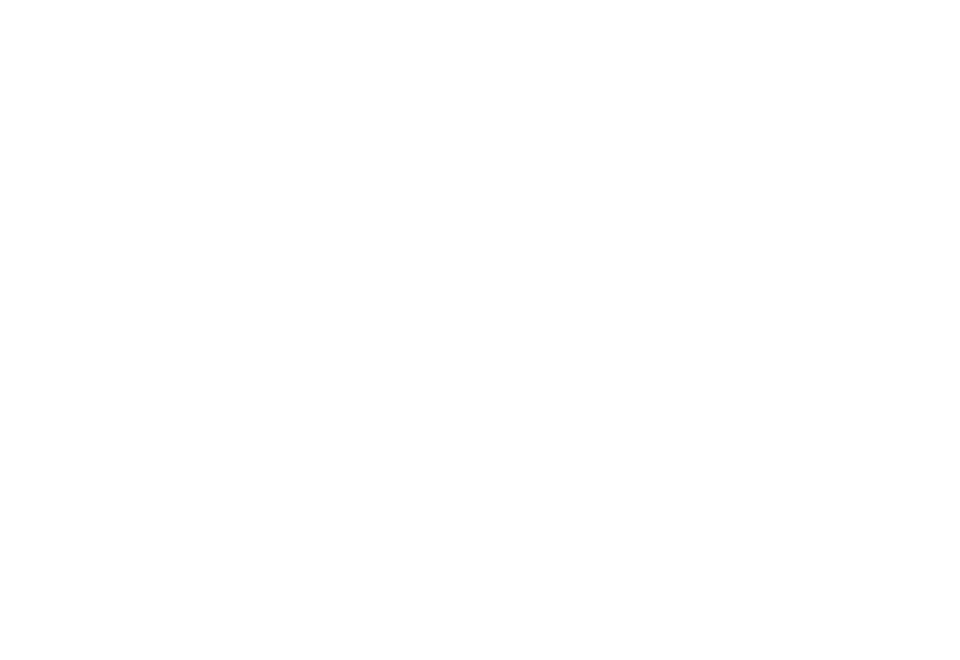

<IPython.core.display.Javascript object>


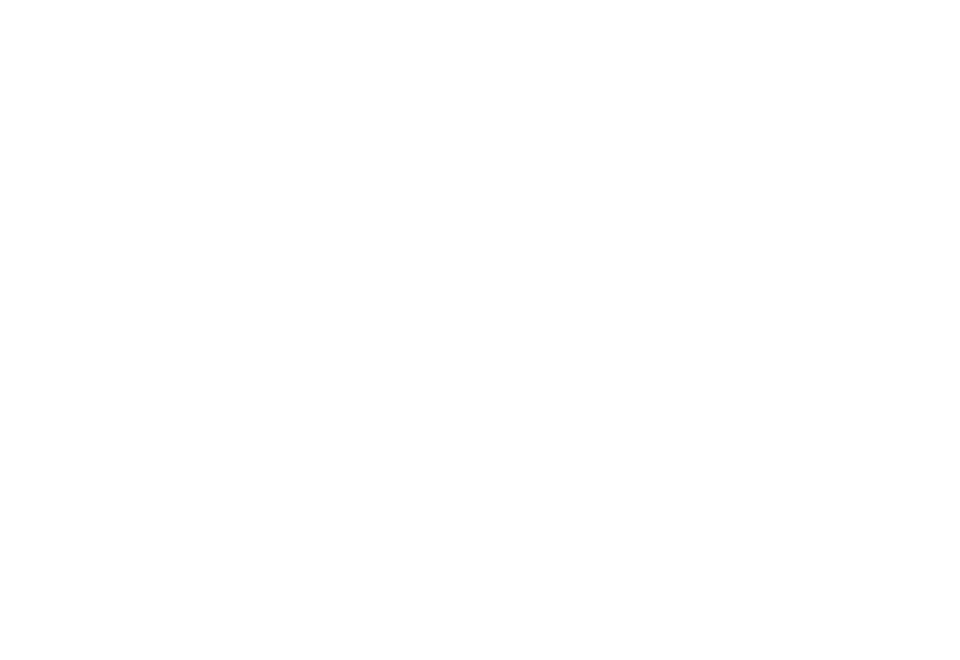

<IPython.core.display.Javascript object>


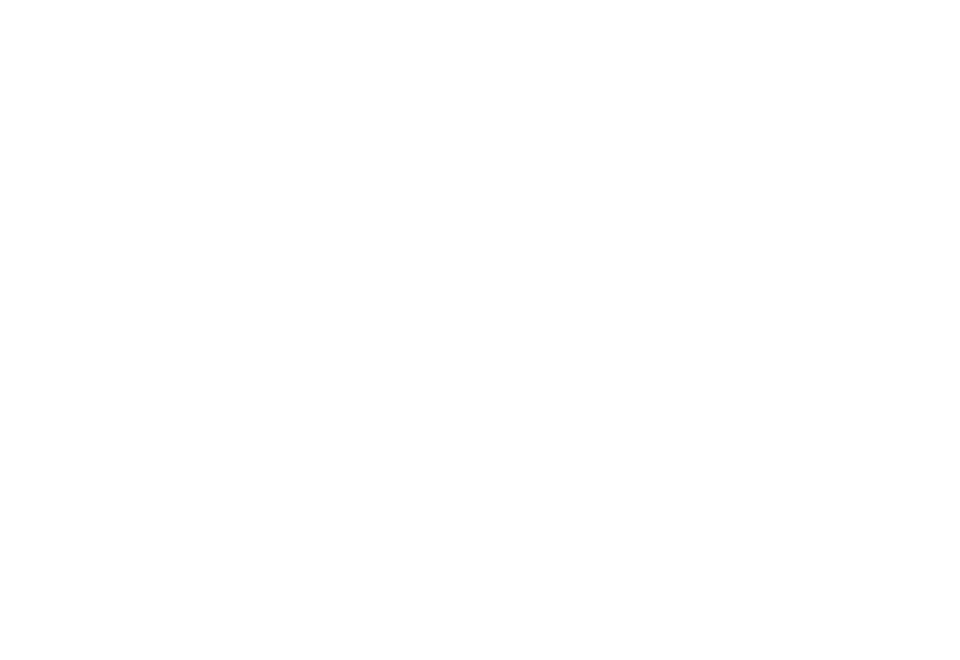

<IPython.core.display.Javascript object>


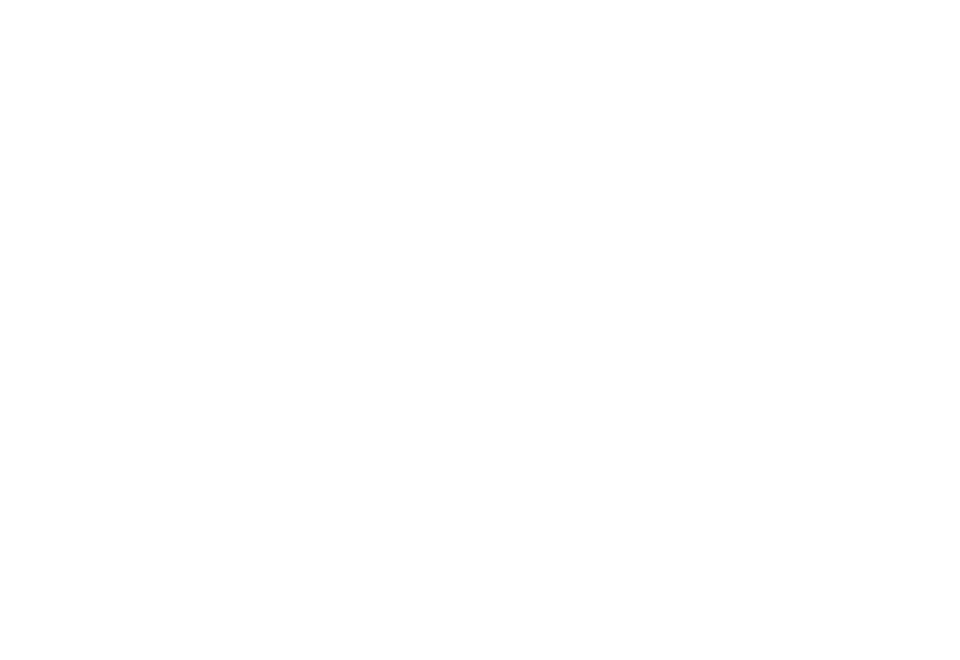

<IPython.core.display.Javascript object>


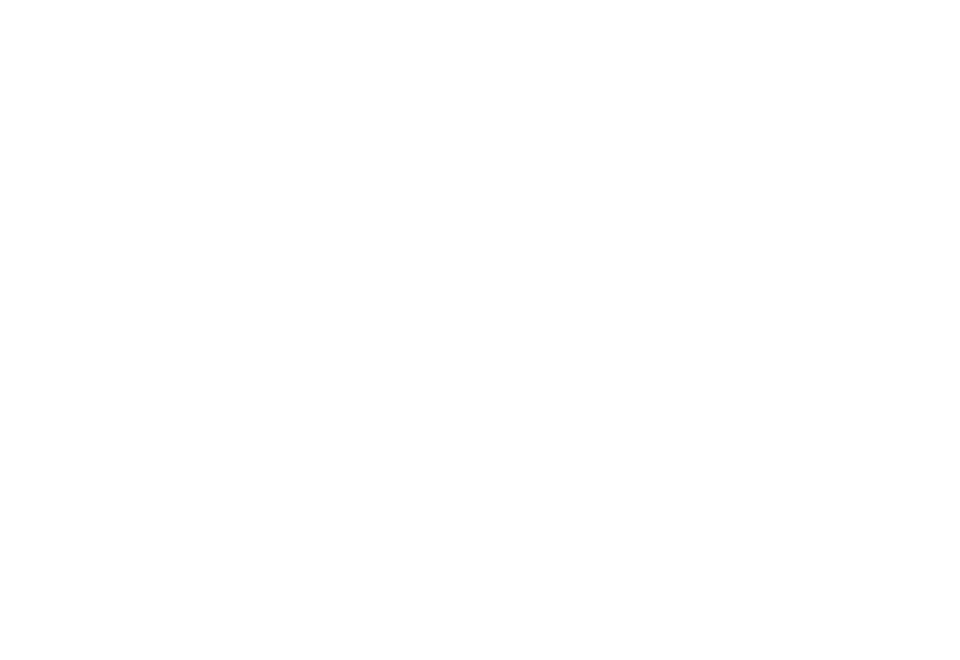

In [1021]:
for i, peak in enumerate(mcs):
    if abs(len(mcs) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(mcs)-1), prec_lag=peak, path='Observation', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days', show_level=True, savefig=True)
    else:
        plot_mci_pred_relation(cA=range(len(mcs)), prec_lag=peak, path='Observation', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days', show_level=True, savefig=True)

### Run experiment with wavelet decomposition on yprime incorporate lags of target, prec as an extra column

In [706]:
result_full = run_experiment_levels_full_lag(prepro_target, target_arr,rg_exp, rg_index, peak_test=True,total_levels=levels)


[INFO] Extracting level 0
Progress causal inference - traintest set 100%

/home/jier/miniconda3/envs/RGCPD/lib/python3.7/site-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


Progress causal inference - traintest set 100%
[INFO] Extracting level 1
Progress causal inference - traintest set 100%
[INFO] Extracting level 2
Progress causal inference - traintest set 100%
[INFO] Extracting level 3
Progress causal inference - traintest set 100%
[INFO] Extracting level 4
Progress causal inference - traintest set 100%
[INFO] Extracting level 5
Progress causal inference - traintest set 100%
[INFO] Extracting level 6
Progress causal inference - traintest set 100%
[INFO] Extracting level 7
Progress causal inference - traintest set 100%
[INFO] Extracting level 8
Progress causal inference - traintest set 100%
[INFO] Extracting level 9
Progress causal inference - traintest set 100%
[INFO] Extracting level 10
Progress causal inference - traintest set 100%
[INFO] Extracting level 11
Progress causal inference - traintest set 100%
[INFO] Extracting level 12
Progress causal inference - traintest set 100%

In [72]:
mc_full, _, _ = result_full

In [73]:
[len(i) for i in mc_full]

[12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12]

<IPython.core.display.Javascript object>


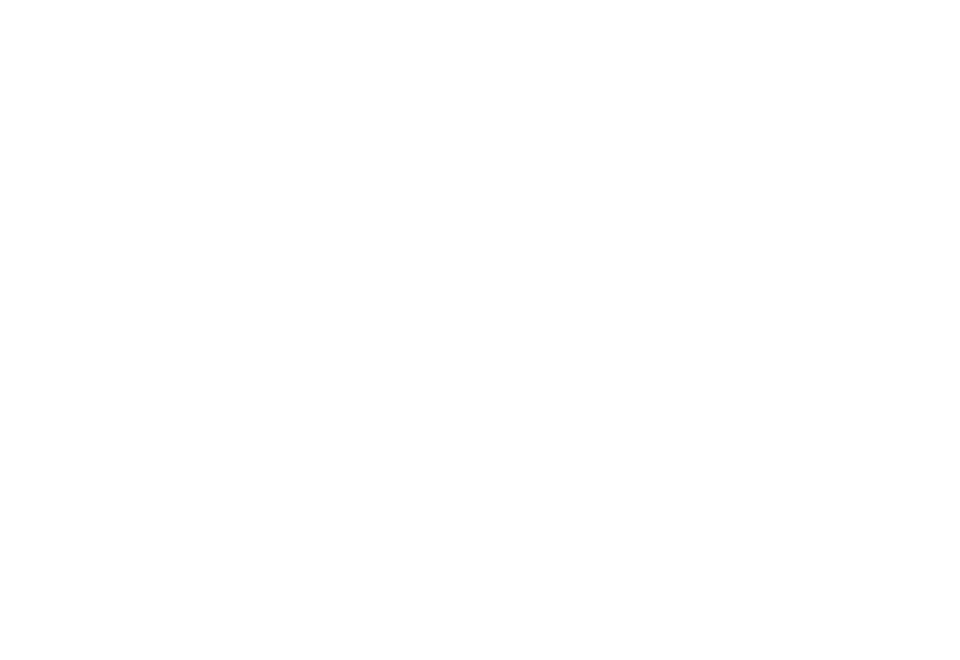

<IPython.core.display.Javascript object>


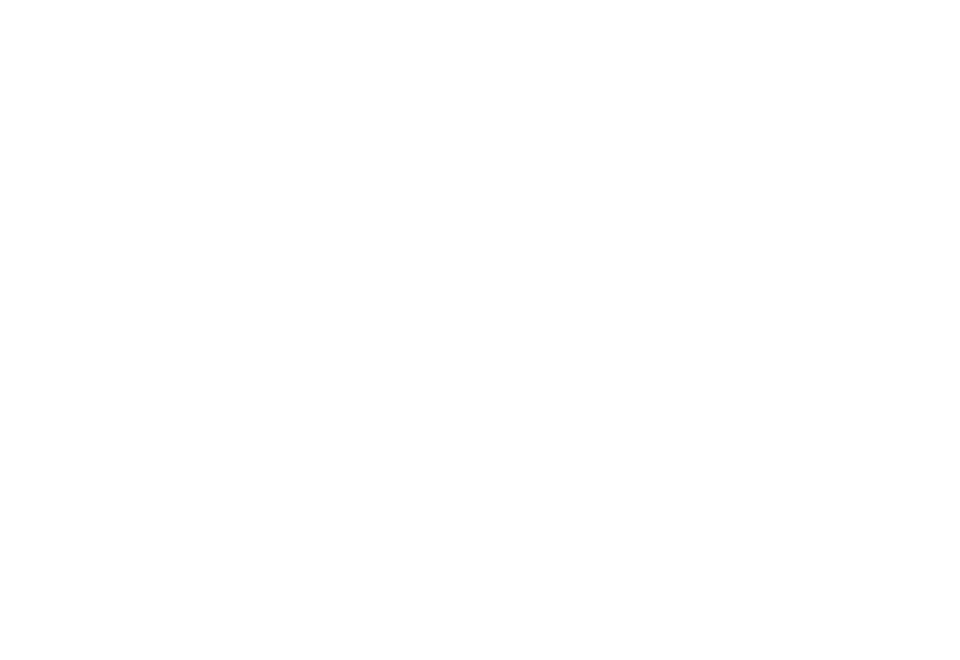

<IPython.core.display.Javascript object>


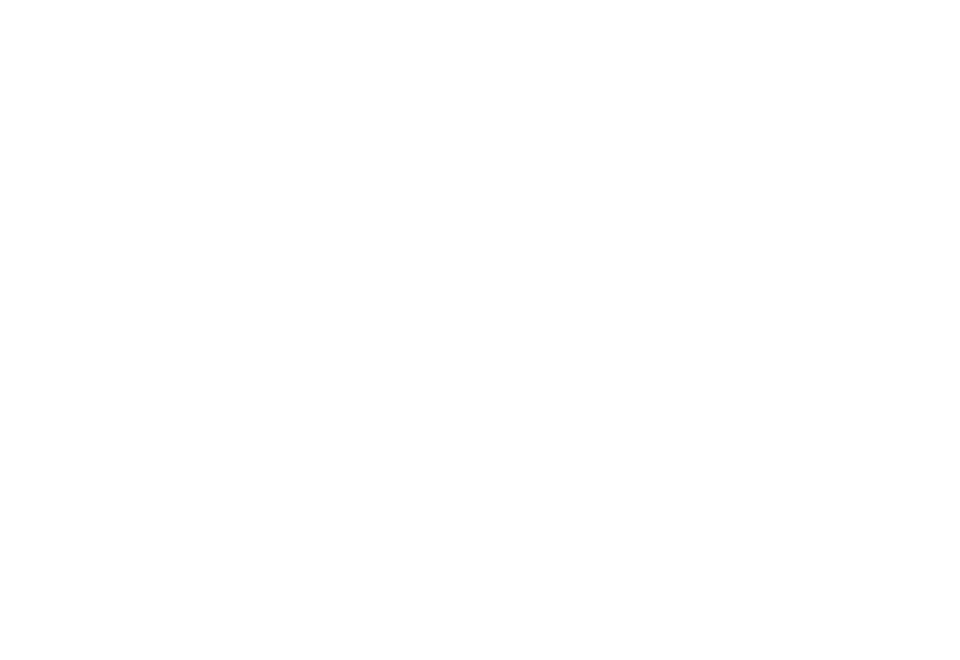

<IPython.core.display.Javascript object>


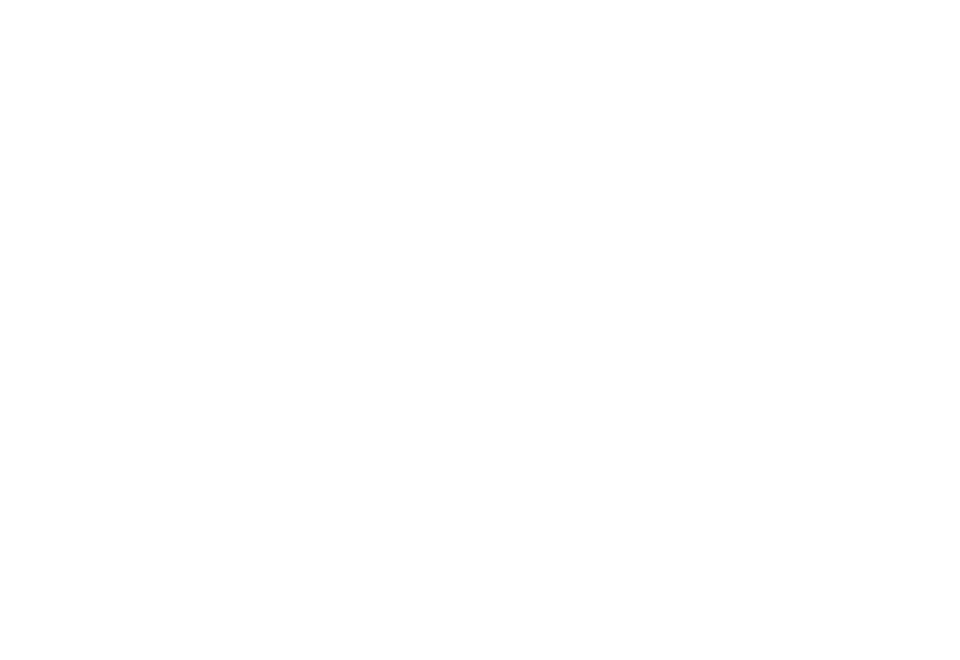

<IPython.core.display.Javascript object>


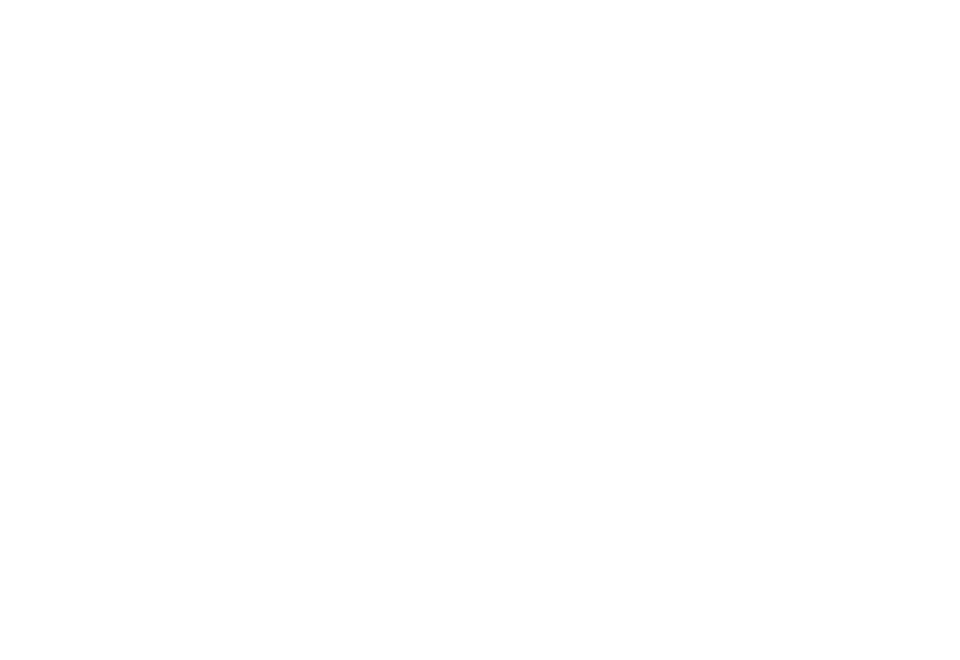

<IPython.core.display.Javascript object>


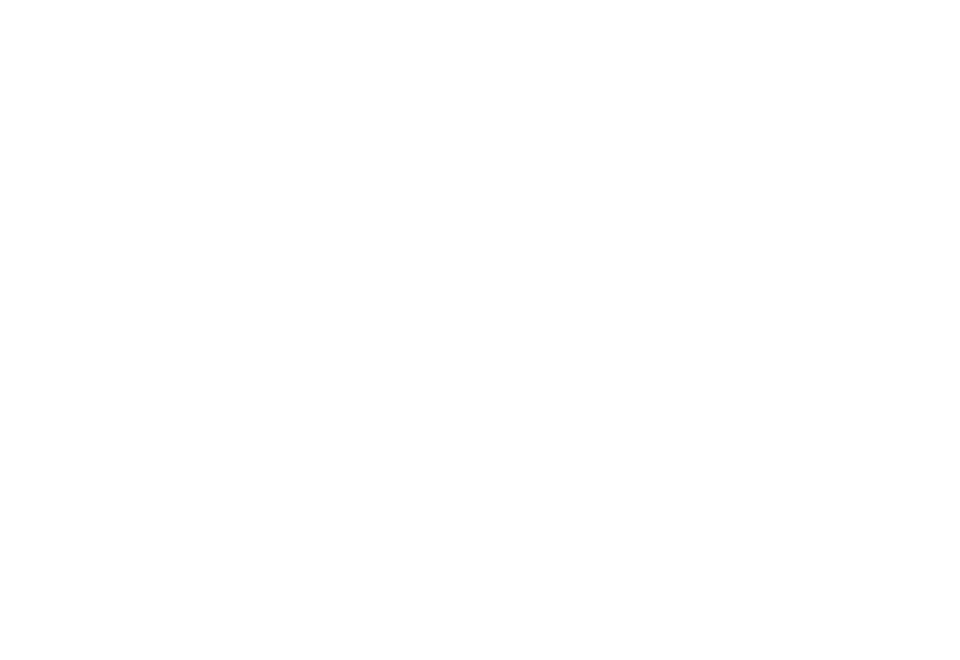

<IPython.core.display.Javascript object>


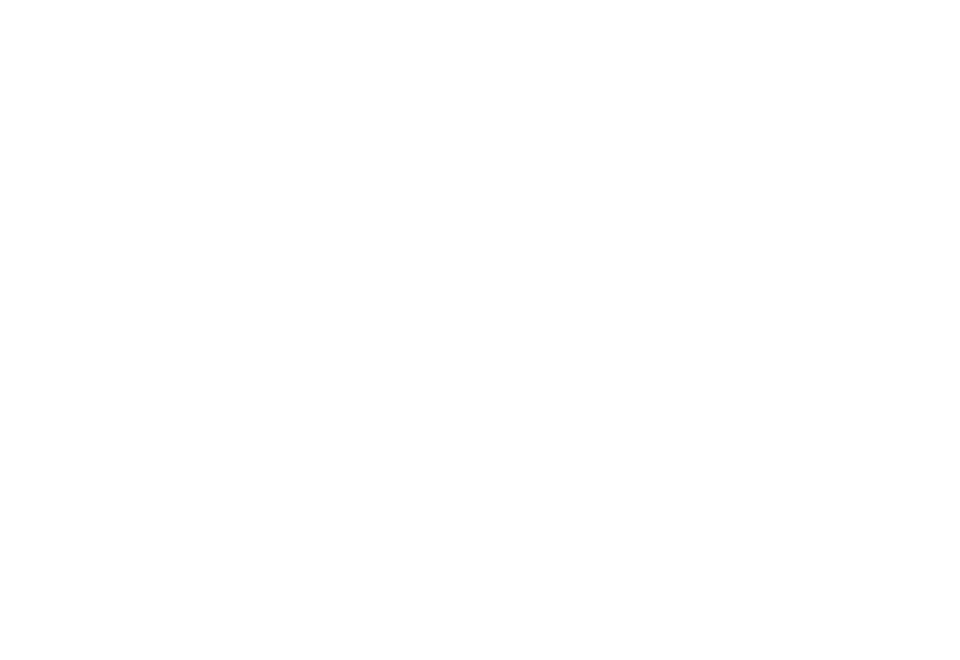

<IPython.core.display.Javascript object>


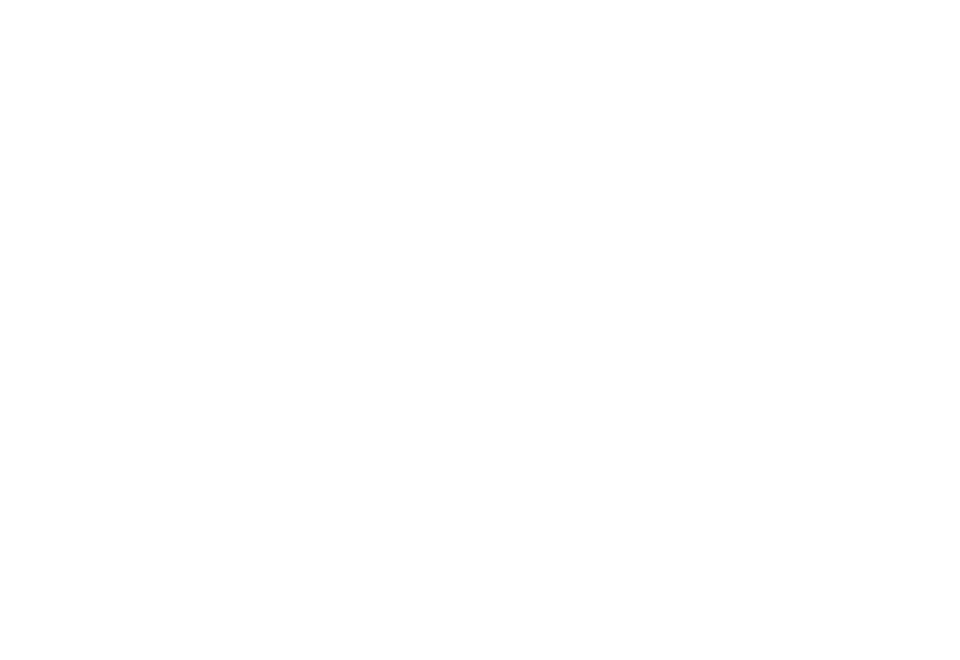

<IPython.core.display.Javascript object>


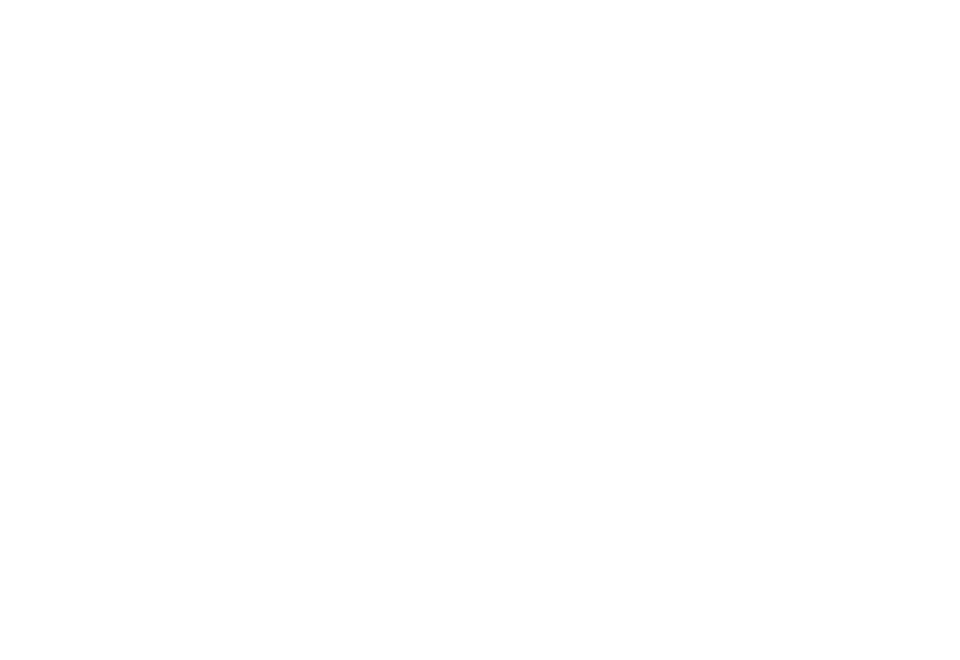

<IPython.core.display.Javascript object>


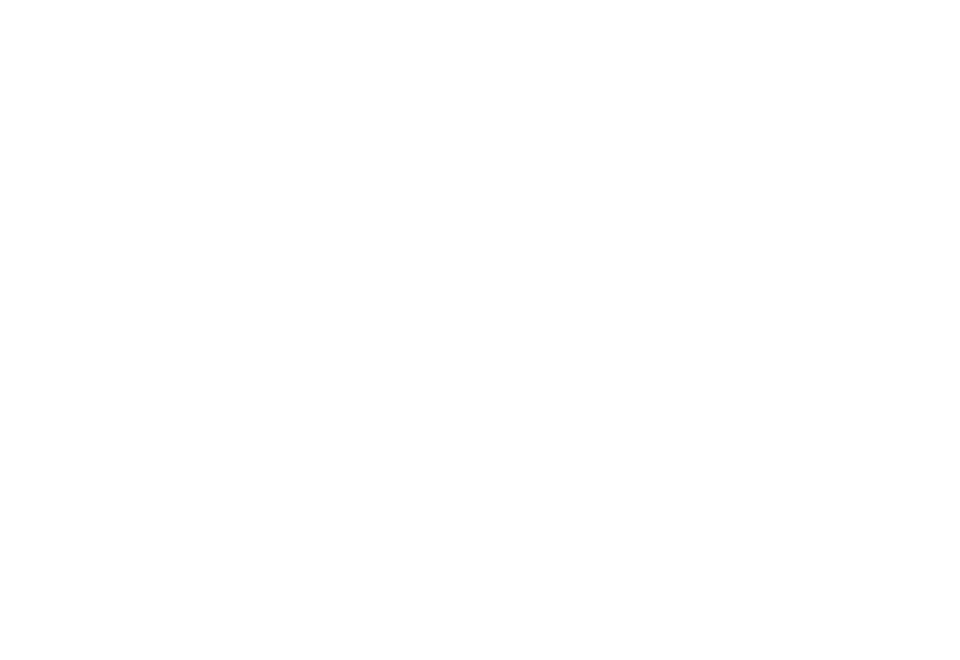

<IPython.core.display.Javascript object>


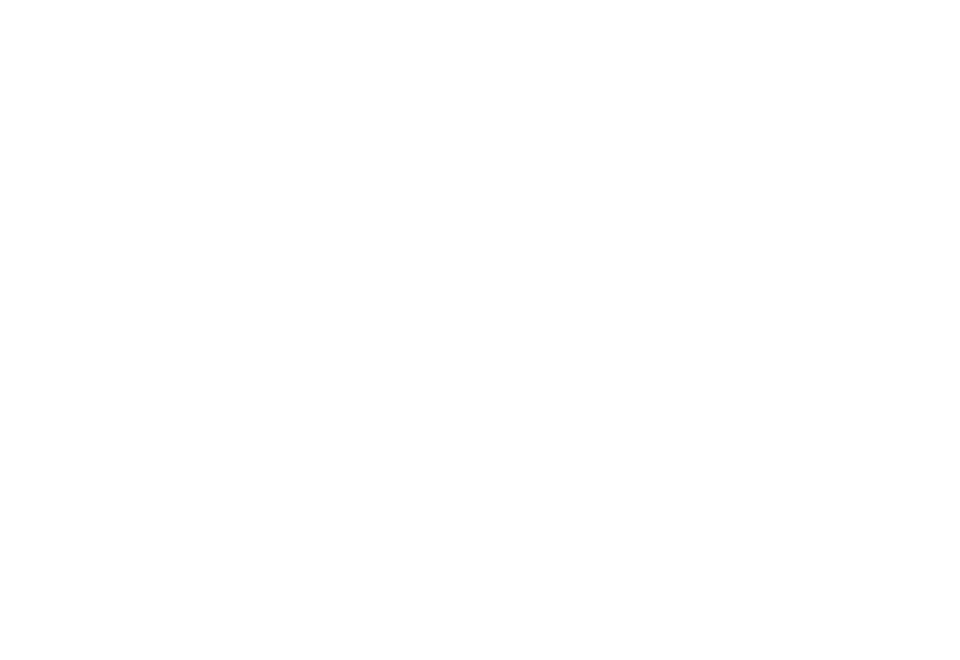

<IPython.core.display.Javascript object>


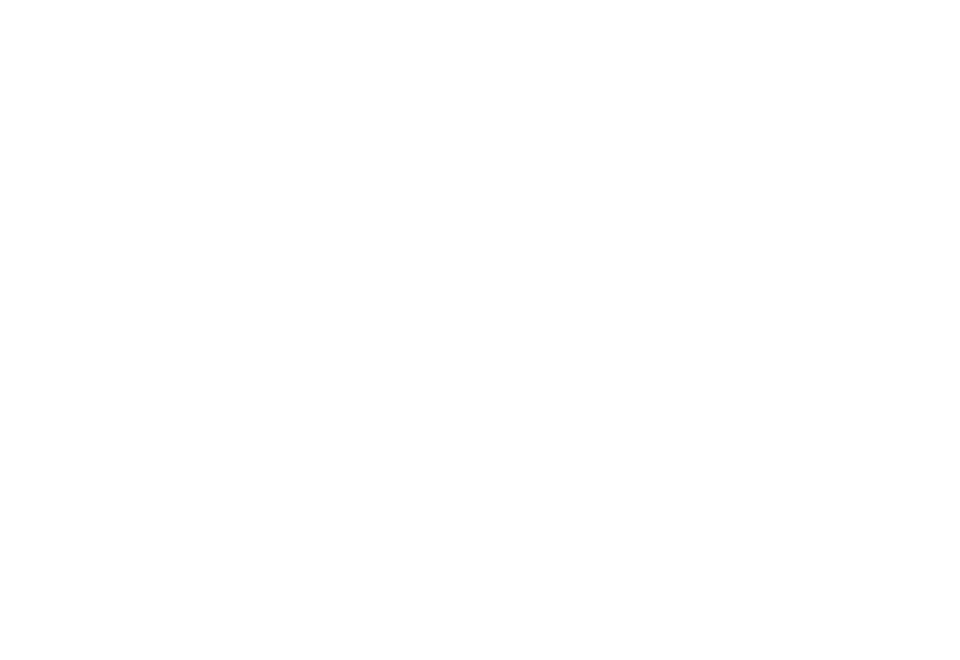

In [1022]:
for i, peak in enumerate(mcs):
    if abs(len(mc_full) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(mcs)), prec_lag=peak, path='Observation/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)
    else:
        plot_mci_pred_relation(cA=range(len(mcs)), prec_lag=peak, path='Observation/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)

### Inspect levels

Variance of the signal = 1.0018828102168438 std dev =1.0009409624032997 
Sum of variance across all MODWT coefficients = 1.0018828102182529 and Percival mra_var = 0.6344261323971337 sample good var = 1.0018216601443872  eta3 = [16384.5, 8192.0, 4095.75, 2047.625, 1023.5625, 511.53125, 255.515625, 127.5078125, 63.50390625, 31.501953125, 15.5009765625] Diff-org-sample good var = 6.115007386564564e-05

 Stdev details per level = [0.10603797142433712, 0.16946445744577088, 0.14062633313328496, 0.17714519826258013, 0.23074295688830998, 0.320707216916474, 0.3749636700905611, 0.45890430118318803, 0.45726345343738334, 0.37448442776067714, 0.22526321818613015] and approximation = 0.05836143451537525


<IPython.core.display.Javascript object>


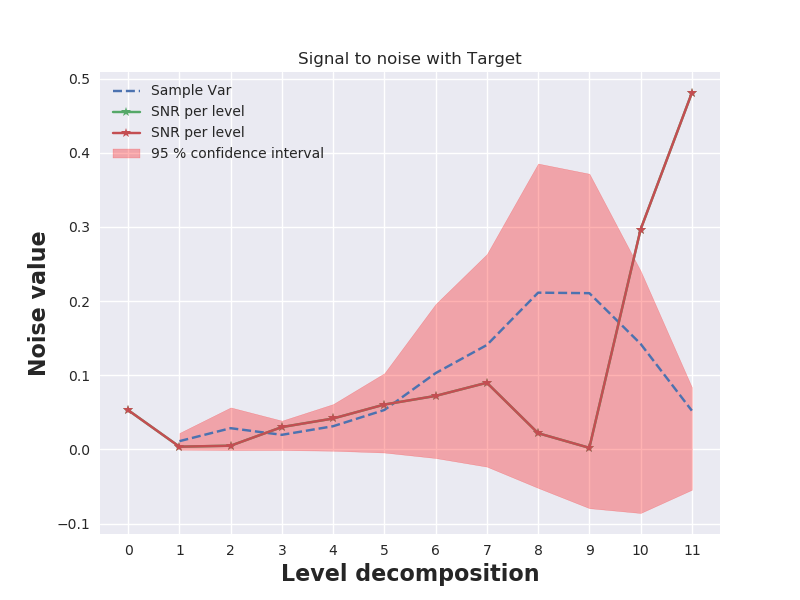

In [1140]:
show_level_variance(prepro_target, la8, len(levels)-1)

<IPython.core.display.Javascript object>


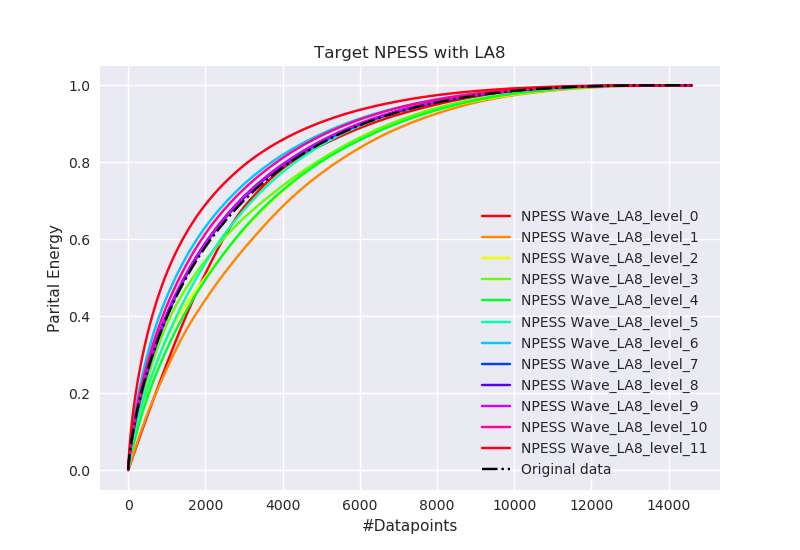

In [1085]:
%matplotlib notebook
nps_pt = npess(prepro_target)
coeffs_pt = decompose_signal_modwt(prepro_target,w=la8, mode='periodic', level=len(levels)-1, debug=False)
nps_coeff_pt = np.array([npess(i) for i in coeffs_pt])
plot_npess(nps_pt,nps_coeff_pt, title='Target NPESS with LA8', wave_name='LA8', savefig=True)

<IPython.core.display.Javascript object>


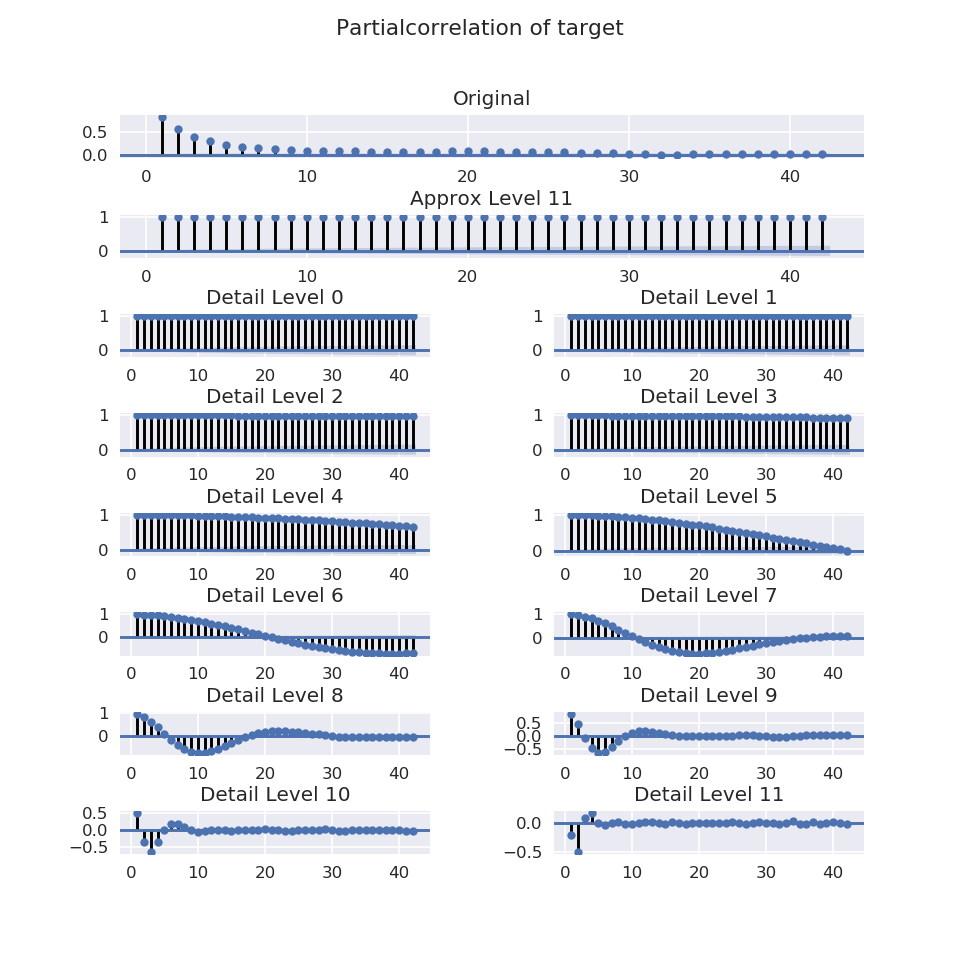

In [1211]:
show_auto_per_level(prepro_target, coeffs_pt, title='Partialcorrelation of target', method='autocorr', savefig=False)

In [1184]:
def calc_sin_noise(y=prepro_target, coeffs=coeffs_pt):
    rev = list(reversed(coeffs))
    result = []
    for i, x in enumerate(rev):
        x = sm.add_constant(x)
        temp = sm.OLS(y, x).fit()
        var = np.var(temp.resid)
        coeff = temp.params[1]
        const = temp.params[0]
        sn =np.var(coeff*x+const)/(var)
        result.append(sn)
    return result

In [1185]:
sn_pt = calc_sin_noise(y=prepro_target, coeffs=coeffs_pt)

In [1143]:
def visualize_sin_noise(result,title, path, savefig=False):
    plt.title(title)
    plt.plot(result, '-*', label='Relative SNR per level')
    plt.xticks(range(len(result)))
    plt.ylabel('Noise value')
    plt.xlabel('Level decomposition')
    plt.legend(loc=0)
    if savefig:
        plt.savefig('Report/Experiment/'+path+'/'+title+'.pdf', dpi=120)
        plt.savefig('Report/Experiment/'+path+'/'+title+'.png', dpi=120)
    plt.show()

<IPython.core.display.Javascript object>


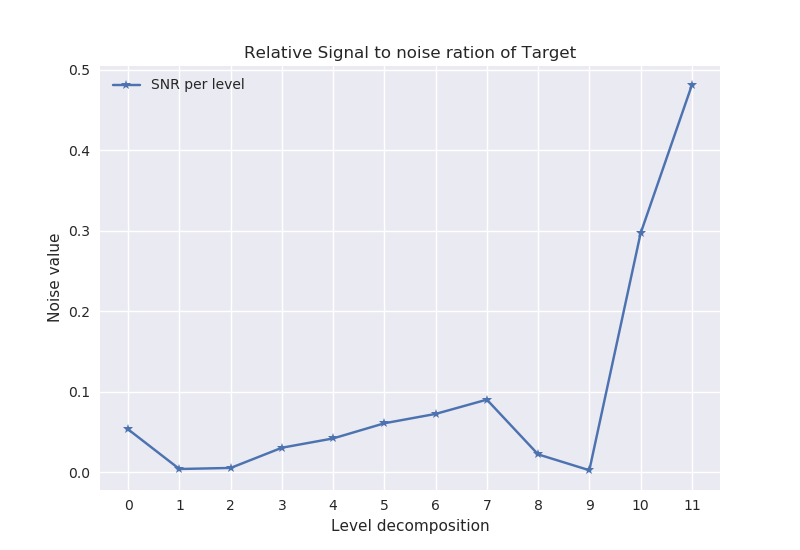

In [1190]:
%matplotlib notebook
visualize_sin_noise(sn_pt, 'Relative Signal to noise ration of Target', 'Observation', savefig=True)

### Run with noise strength

In [83]:
# np.random.seed(42)
result_noise = run_experiment_levels_noise(prepro_target, target_arr,rg, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels[:8], iterations=8, thetas=theta[:8])


[INFO] Extracting level 0

[INFO] Running with noise 0.1
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.2
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.30000000000000004
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.4
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.5
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.6
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.7000000000000001
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.8
Progress causal inference - traintest set 100%
[INFO] Extracting level 1

[INFO] Running with noise 0.1
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.2
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.30000000000000004
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.4
Progress causal infer

<IPython.core.display.Javascript object>


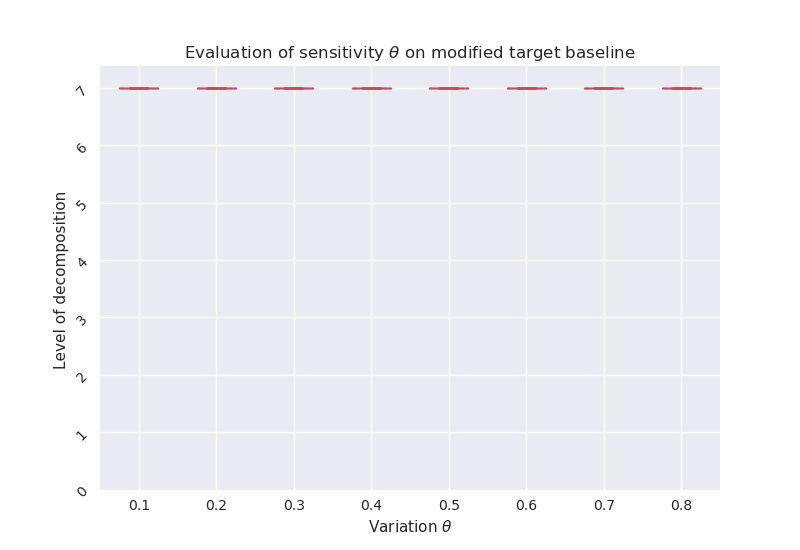

In [120]:
%matplotlib notebook
box_plot_reesult_experiments(result_noise, level=levels[:8], theta=theta[:8], all_levels=False,depth=7)

In [124]:
help(rg.quick_view_labels)

Help on method quick_view_labels in module class_RGCPD:

quick_view_labels(var=None, map_proj=None, median=True) method of class_RGCPD.RGCPD instance



<IPython.core.display.Javascript object>


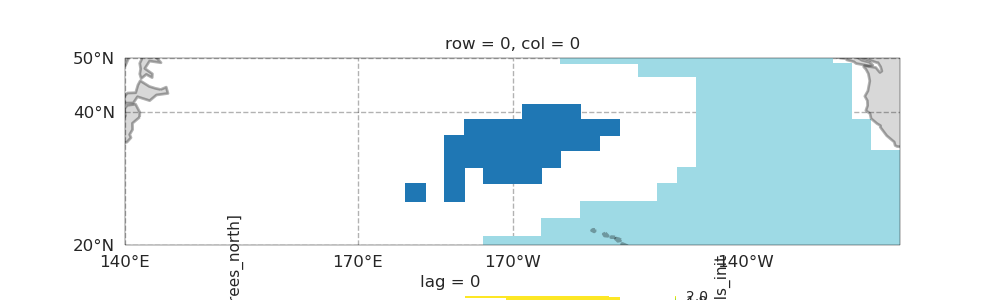

Plotting Corr maps sst_labels_init, split 0, lag 0

In [125]:
rg.quick_view_labels(median=False)

<IPython.core.display.Javascript object>


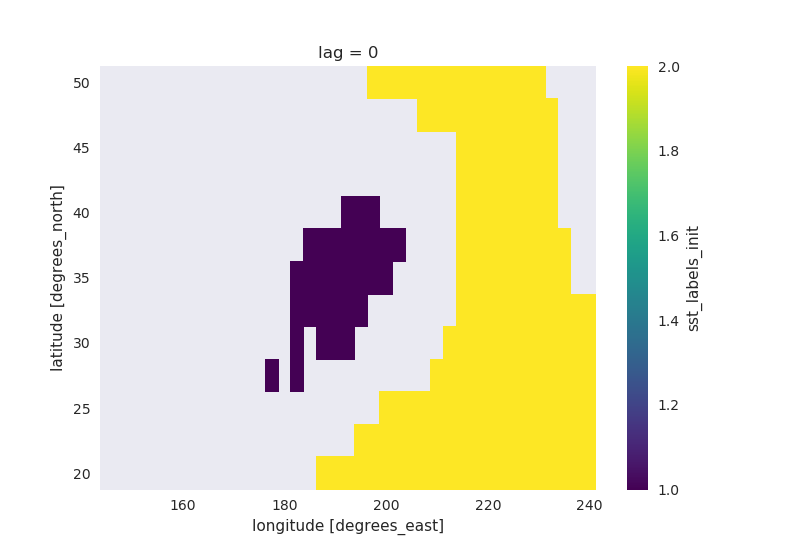

In [129]:
%matplotlib notebook
rg.list_for_MI[0].prec_labels.mean(dim='split').plot()

# Experiment with AR processes

## (Ensemble) AR process

In [96]:
from statsmodels.tsa.arima_process import  arma_generate_sample, ArmaProcess
import statsmodels.api as sm 

In [97]:
sm.__version__

'0.10.1'

In [98]:
# from statsmodels.tsa.base.datetools import date_range_str
# help(date_range_str)

### Generate AR data

In [99]:
Path('Report/AR/Methods/').mkdir(parents=True, exist_ok=True)
Path('Report/AR/Experiment_vanilla/').mkdir(parents=True, exist_ok=True)
Path('Report/AR/Experiment_sensitivity/').mkdir(parents=True, exist_ok=True)

In [100]:
synthetic = dict()
synthetic['ARrange'] = np.array([])
synthetic['MArange'] = np.array([])
synthetic['arparams'] = np.r_[1, -synthetic['ARrange']]
synthetic['maparams'] = np.r_[1, -synthetic['MArange']]
synthetic['nobs'] = 5000
synthetic['startyear'] = '1900-01-1'

# def generate_synthetic_data():
#     return arma_generate_sample(synthetic['arparams'],synthetic['maparams'], synthetic['nobs'])

# def generate_date_range():
#     return sm.tsa.datetools.dates_from_range(synthetic['startyear'], length=synthetic['nobs'])

# in the for-loop do the whole analysis only if time permits 
# for ar in range(1):
# ar_sampling = []
dates  = pd.date_range(start=synthetic['startyear'], periods=synthetic['nobs'], freq='D')
synthetic['ARrange']= np.random.random()
synthetic['arparams'] = np.r_[1, -synthetic['ARrange']]
y_ = arma_generate_sample(synthetic['arparams'],synthetic['maparams'], synthetic['nobs'])
arma_process = ArmaProcess(ar=synthetic['arparams'], ma=synthetic['maparams'], nobs=synthetic['nobs'])
# model = sm.tsa.ARMA(y_, order=(1, 0)).fit(trend='c')
print(f"Stationarity {arma_process.isstationary} Invertible {arma_process.isinvertible}")
# if not (arma_process.isstatuionary and arma_process.isinvertible): continue
y_ = pd.Series(y_, index=dates)

# ar_df_1 = pd.DataFrame(data=y_.values, index=pd.MultiIndex.from_product(([0], idx_ar_datetime)), columns=[target_col])
# prepro_ar_exp1 = preprocess_ts(serie=ar_df_1, to_serie=True, col=target_col)
# appropriate_level1 = get_pad_level(prepro_ar_exp1)
# levels = np.arange(0, appropriate_level1, 1)
# ar_exp1 = run_experiment_levels(prepro_ar_exp1, ar_df_1,rg, idx_ar_datetime, peak_test=True,total_levels=levels)
# ar_exp1_res, coeff_list, _ = ar_exp1

Stationarity True Invertible True


In [101]:
ar_df1 = pd.DataFrame(data=y_)
ar_df1.index

DatetimeIndex(['1900-01-01', '1900-01-02', '1900-01-03', '1900-01-04',
               '1900-01-05', '1900-01-06', '1900-01-07', '1900-01-08',
               '1900-01-09', '1900-01-10',
               ...
               '1913-08-31', '1913-09-01', '1913-09-02', '1913-09-03',
               '1913-09-04', '1913-09-05', '1913-09-06', '1913-09-07',
               '1913-09-08', '1913-09-09'],
              dtype='datetime64[ns]', length=5000, freq='D')

### Convert to RGCPD format

In [102]:
# only use if done with Monthly data
# pd.DatetimeIndex(pd.date_range(ar_df1.index[0] ,end=ar_df1.index[-1], periods=len(y_)).strftime('%Y-%m-%d')) 
idx_ar_datetime = ar_df1.index

In [103]:
idx_ar_datetime

DatetimeIndex(['1900-01-01', '1900-01-02', '1900-01-03', '1900-01-04',
               '1900-01-05', '1900-01-06', '1900-01-07', '1900-01-08',
               '1900-01-09', '1900-01-10',
               ...
               '1913-08-31', '1913-09-01', '1913-09-02', '1913-09-03',
               '1913-09-04', '1913-09-05', '1913-09-06', '1913-09-07',
               '1913-09-08', '1913-09-09'],
              dtype='datetime64[ns]', length=5000, freq='D')

In [104]:
ar_df_1 = pd.DataFrame(data=y_.values, index=pd.MultiIndex.from_product(([0], idx_ar_datetime)), columns=[target_col])

### Display AR timeseries info

In [113]:
def display_info_ts(y:pd.Series, dates:pd.DatetimeIndex, figsize=(16, 8), title='TS', lags=20, save_fig:bool=False):
    assert isinstance(y, pd.Series), f"Expect pandas Series, {type(y)} given"
    serie = y 
    
    fig = plt.figure(figsize=figsize)
    serie.plot(ax = fig.add_subplot(4, 1, 1), title="$Time \ Series \ "+ title +"$", legend=False)

    sm.graphics.tsa.plot_acf(serie, lags=lags, zero=False, ax = fig.add_subplot(4, 2, 3))
    plt.xticks(np.arange(1, lags + 1, 1.0))

    sm.graphics.tsa.plot_pacf(serie, lags=lags, zero=False, ax = fig.add_subplot(4, 2, 4))
    plt.xticks(np.arange(1, lags + 1, 1.0))
   
    ax1 = fig.add_subplot(426)
    ax1.title.set_text('Distribution')
    ax1.hist(serie, bins= 40, density=True)
    ax2 = fig.add_subplot(425)

    ax2.title.set_text('Periodogram')
    ax2.plot(sm.tsa.stattools.periodogram(serie.values))
    ax3 = fig.add_subplot(4, 2, 7)
    ax3.title.set_text('QQ-plot')
    sm.qqplot(serie, line='s', ax = ax3)
    
    ax4 = fig.add_subplot(4, 2, 8)
    temp =  y
    temp.index = dates + pd.Timedelta(1, unit=dates.freqstr)
    acor_ljungbox = list(sm.stats.diagnostic.acorr_ljungbox(temp, lags=lags, boxpierce=True))
    ax4.plot(range(1, len(acor_ljungbox[0]) + 1), acor_ljungbox[1], 'bo', label= 'Ljung-Box values')
    ax4.plot(range(1, len(acor_ljungbox[0]) + 1), acor_ljungbox[3], 'go', label= 'Box-Pierce values')
    ax4.set_xticks(np.arange(1, len(acor_ljungbox[0]) + 1, 1.0))
    ax4.axhline(y = 0.05, color = 'red', label= "$5 \%  critical value$")
    ax4.title.set_text("LJung-Pierce-Box Test")
    ax4.legend(loc=0)

    
    plt.tight_layout()
    new_title = 'info_ts_'+str(title)
    if save_fig == True:
        plt.savefig('Report/AR/Methods/'+new_title+'.pdf', dpi=120)
        plt.savefig('Report/AR/Methods/'+new_title+'.png', dpi=120)

    plt.show()

In [106]:
def display_pierce_LJbox(y:pd.Series, dates:pd.DatetimeIndex, figsize=(16, 8), title="LJ", lags=20, save_fig:bool=False, debug:bool=False):
    
    assert isinstance(y, pd.Series), f"Expect pandas Series, {type(y)} given"
    y.index = dates + pd.Timedelta(1, unit=dates.freqstr)
    acor_ljungbox = list(sm.stats.diagnostic.acorr_ljungbox(y, lags=lags, boxpierce=True))

    if debug == True:
        print('[DEBUG]')
        column_ind = ["Ljung-Box: X-squared", 'Ljung-Box: p-value', 'Box-Pierce: X-squared', 'Box-Pierce: p-value']
        df =pd.DataFrame(acor_ljungbox, index=column_ind, columns= range(1, len(acor_ljungbox[0]) + 1))
        df.plot(subplots=True, layout=(len(column_ind), -1), figsize=figsize, label="Lag ", title='Quick inspection of Ljung-Box' )
        plt.show()

    plt.plot(range(1, len(acor_ljungbox[0]) + 1), acor_ljungbox[1], 'bo', label= 'Ljung-Box values')
    plt.plot(range(1, len(acor_ljungbox[0]) + 1), acor_ljungbox[3], 'go', label= 'Box-Pierce values')
    plt.xticks(np.arange(1, len(acor_ljungbox[0]) + 1, 1.0))
    plt.axhline(y = 0.05, color = 'red', label= "$5 \%  critical value$")
    plt.title("$Time\ Serie\ " + title +"$")
    plt.legend(loc=0)
    new_title ='LJ_pierce_box_'+str(title)
    if save_fig == True:
        plt.savefig('Report/AR/Methods/'+new_title+'.pdf', dpi=120)
        plt.savefig('Report/AR/Methods/'+new_title+'.png', dpi=120)
        plt.clf()
        plt.close()
    else:
        plt.show()


<IPython.core.display.Javascript object>


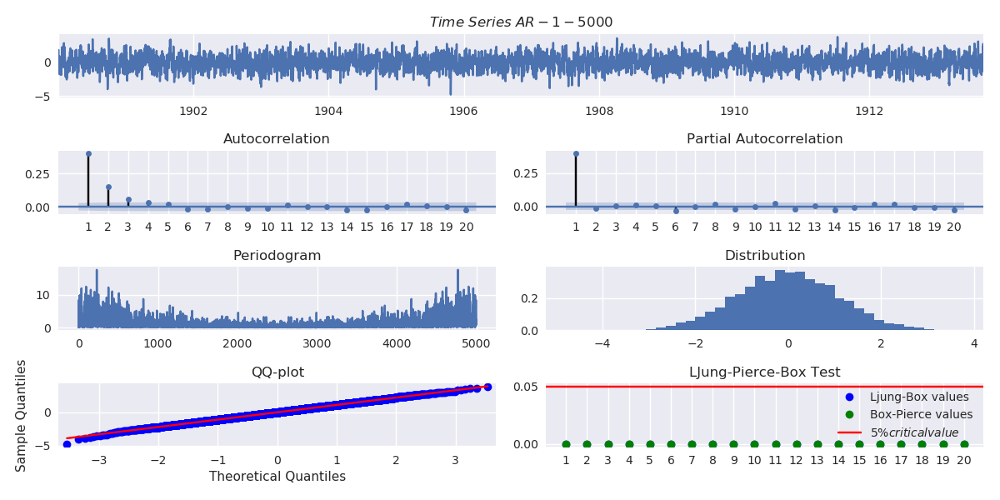

In [114]:
display_info_ts(y=ar_df_1[target_col], dates=ar_df_1.index.levels[1], figsize=(12, 6), title='AR-1-5000', lags=20, save_fig=True)

<IPython.core.display.Javascript object>


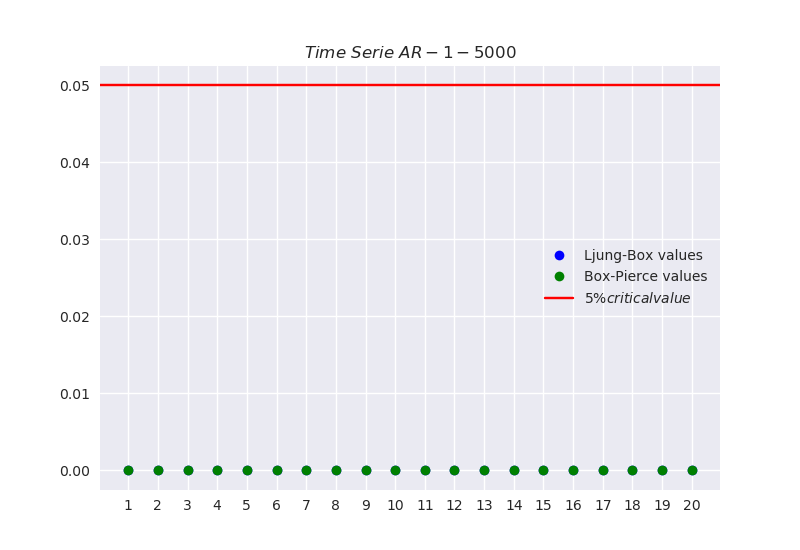

In [115]:
%matplotlib notebook
display_pierce_LJbox(y=ar_df_1[target_col], dates=ar_df_1.index.levels[1], figsize=(9, 8), title="AR-1-5000", lags=20, save_fig=False)

### Standardize and stationarity test of AR timeseries

In [116]:
prepro_ar_exp1 = preprocess_ts(serie=ar_df_1, to_serie=True, col=target_col)


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  0.6328891933473109  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS True

[INFO] Time serie is non-gaussian, tranforming the time serie to gaussian like approximation
[INFO] Gaussian approximation with PT p-value 0.9489224392034508 or QT 0.07564695285114784
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie is stationair ADF True,  KPSS True



In [ ]:
display_info_ts(y=prepro_ar_exp1,dates=ar_df_1.index.levels[1], figsize=(9, 8), title="Standardized AR(1)", lags=20, save_fig=False)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


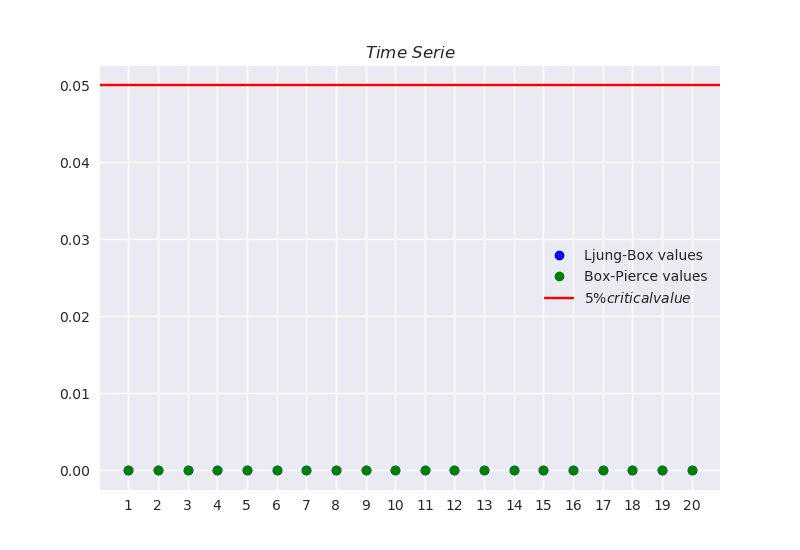

In [120]:
%matplotlib notebook
display_pierce_LJbox(y=prepro_ar_exp1, dates=ar_df_1.index.levels[1], figsize=(9, 8), title="", lags=20)

### Execute Baseline experiment on AR timeseries

In [121]:
appropriate_level1 = get_pad_level(prepro_ar_exp1)
levels = np.arange(0, appropriate_level1, 1)
print(levels)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]


#### Tau min, max= 0 no shifted lag

In [91]:
ar_exp1 = run_experiment_levels(prepro_ar_exp1, ar_df_1,rg, idx_ar_datetime, peak_test=True,total_levels=levels)


[INFO] Extracting level 0

[INFO] Extracting level 1

[INFO] Extracting level 2

[INFO] Extracting level 3

[INFO] Extracting level 4

[INFO] Extracting level 5

[INFO] Extracting level 6

[INFO] Extracting level 7

[INFO] Extracting level 8

[INFO] Extracting level 9

[INFO] Extracting level 10

[INFO] Extracting level 11

[INFO] Extracting level 12
Progress causal inference - traintest set 100%

/home/jier/miniconda3/envs/RGCPD/lib/python3.7/site-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


Progress causal inference - traintest set 100%

#### Tau min, max = 0, shifted lag

In [92]:
ar_exp1_shift = run_experiment_levels_full_lag(prepro_ar_exp1, ar_df_1, rg, idx_ar_datetime, w=la8, peak_test=True, total_levels=levels)


[INFO] Extracting level 0
Progress causal inference - traintest set 100%
[INFO] Extracting level 1
Progress causal inference - traintest set 100%
[INFO] Extracting level 2
Progress causal inference - traintest set 100%
[INFO] Extracting level 3
Progress causal inference - traintest set 100%
[INFO] Extracting level 4
Progress causal inference - traintest set 100%
[INFO] Extracting level 5
Progress causal inference - traintest set 100%
[INFO] Extracting level 6
Progress causal inference - traintest set 100%
[INFO] Extracting level 7
Progress causal inference - traintest set 100%
[INFO] Extracting level 8
Progress causal inference - traintest set 100%
[INFO] Extracting level 9
Progress causal inference - traintest set 100%
[INFO] Extracting level 10
[INFO] Appropriate level is changed to  12
Progress causal inference - traintest set 100%
[INFO] Extracting level 11
[INFO] Appropriate level is changed to  12
Progress causal inference - traintest set 100%
[INFO] Extracting level 12
[INFO] A

### Visualize MCI peaks

In [93]:
ar_exp1_res, coeff_list, _ = ar_exp1

<IPython.core.display.Javascript object>


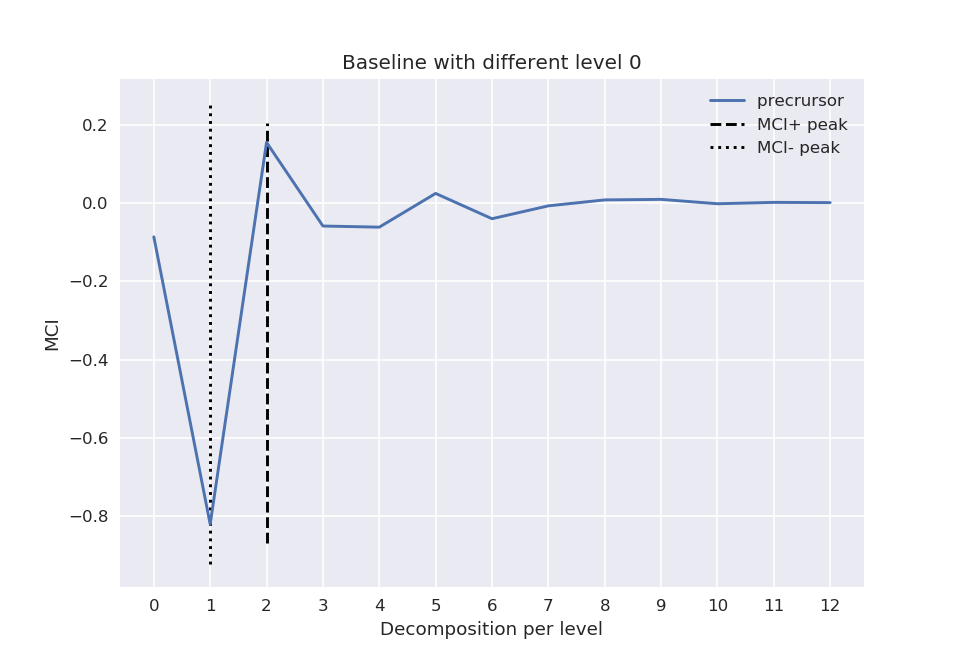

<IPython.core.display.Javascript object>


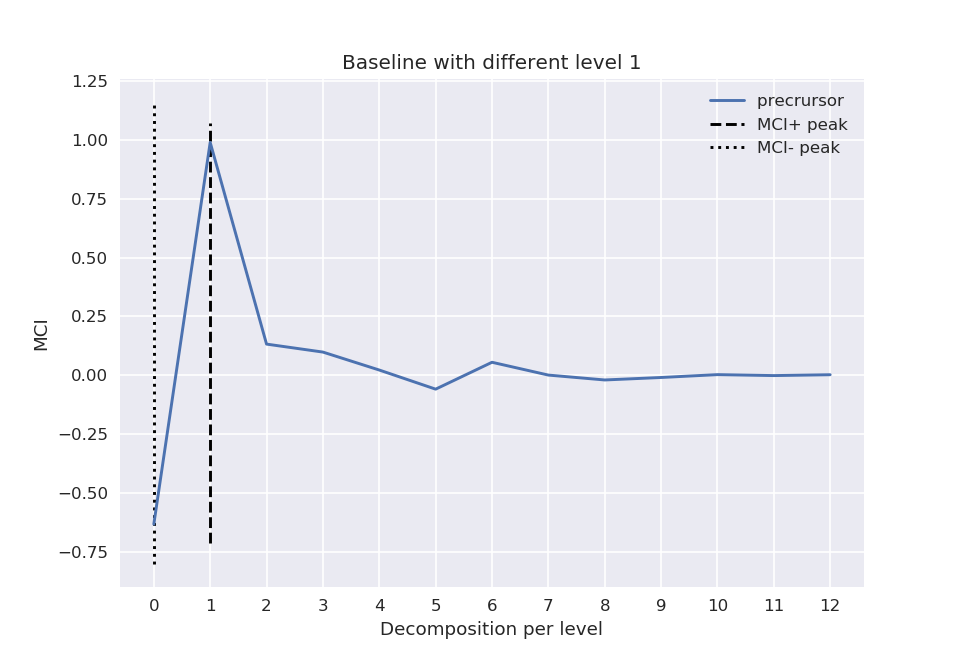

<IPython.core.display.Javascript object>


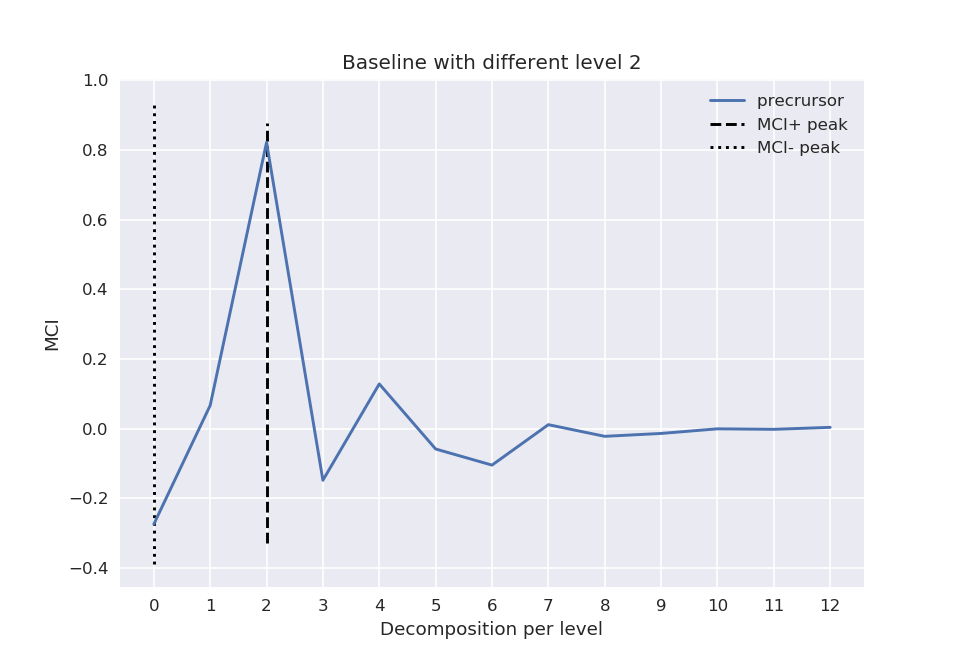

<IPython.core.display.Javascript object>


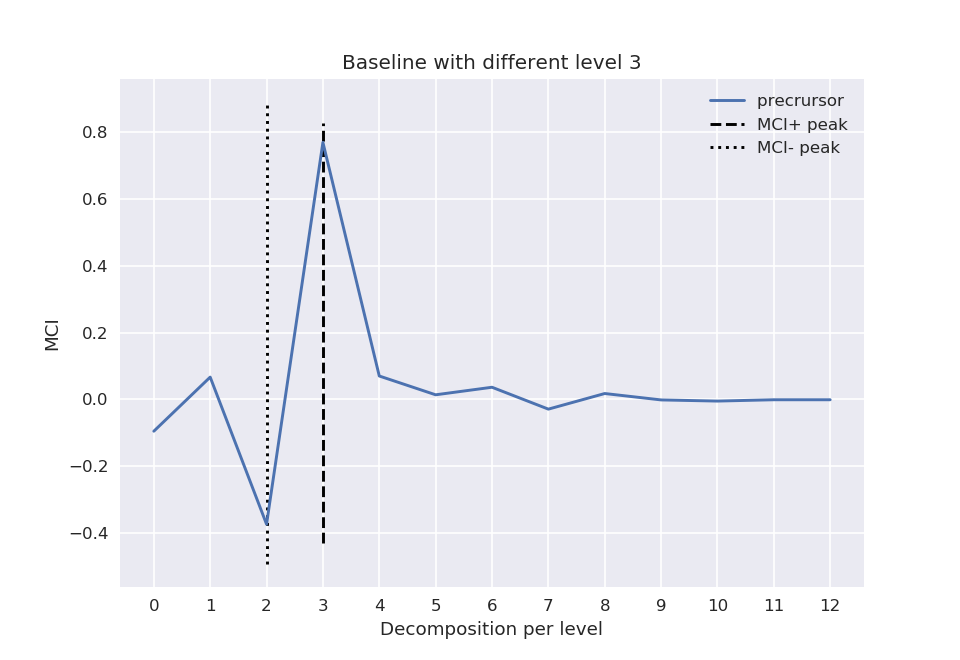

<IPython.core.display.Javascript object>


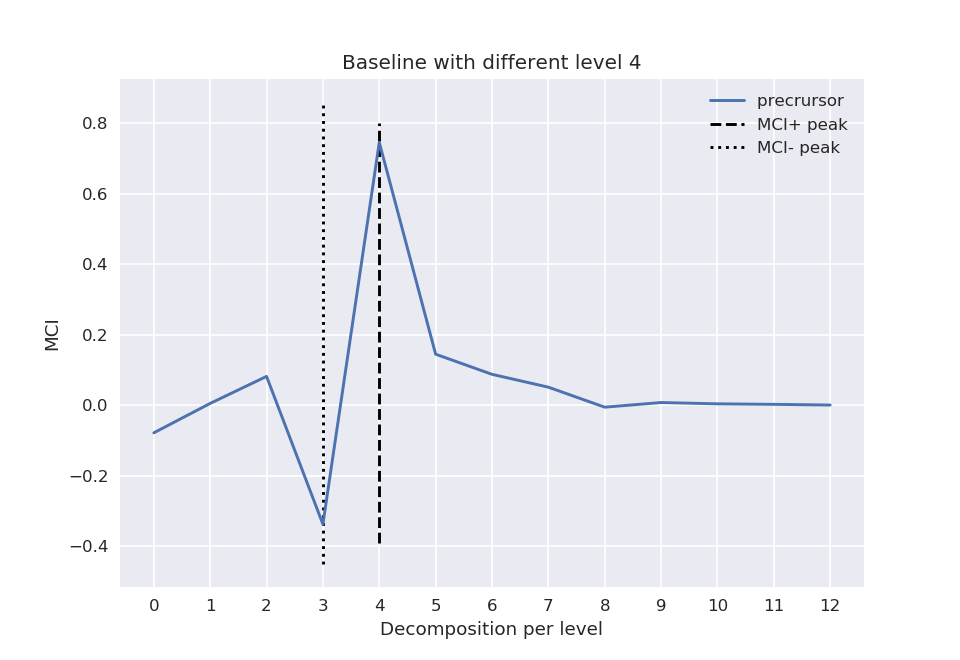

<IPython.core.display.Javascript object>


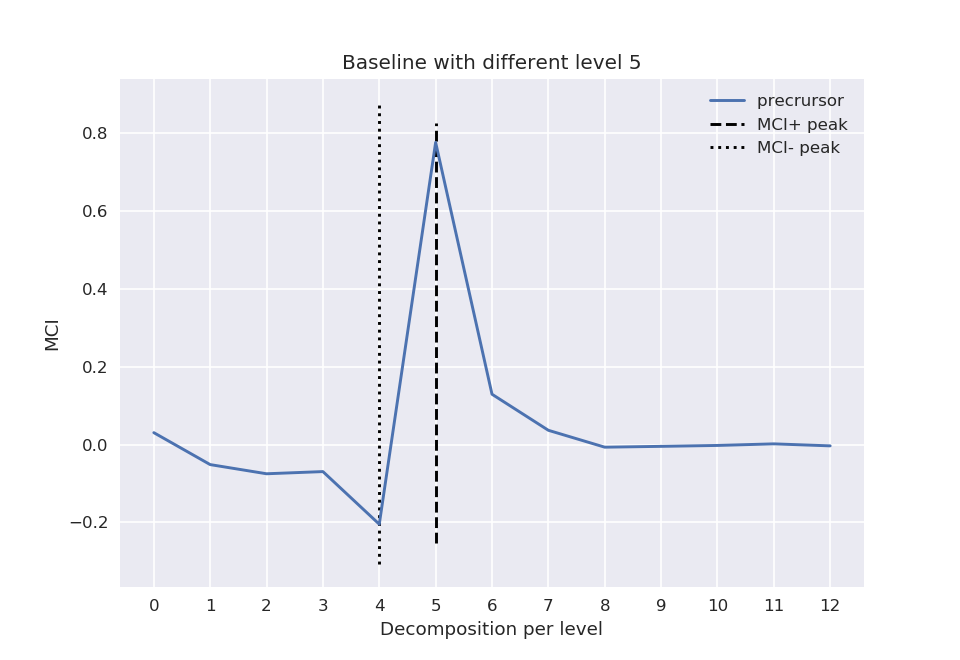

<IPython.core.display.Javascript object>


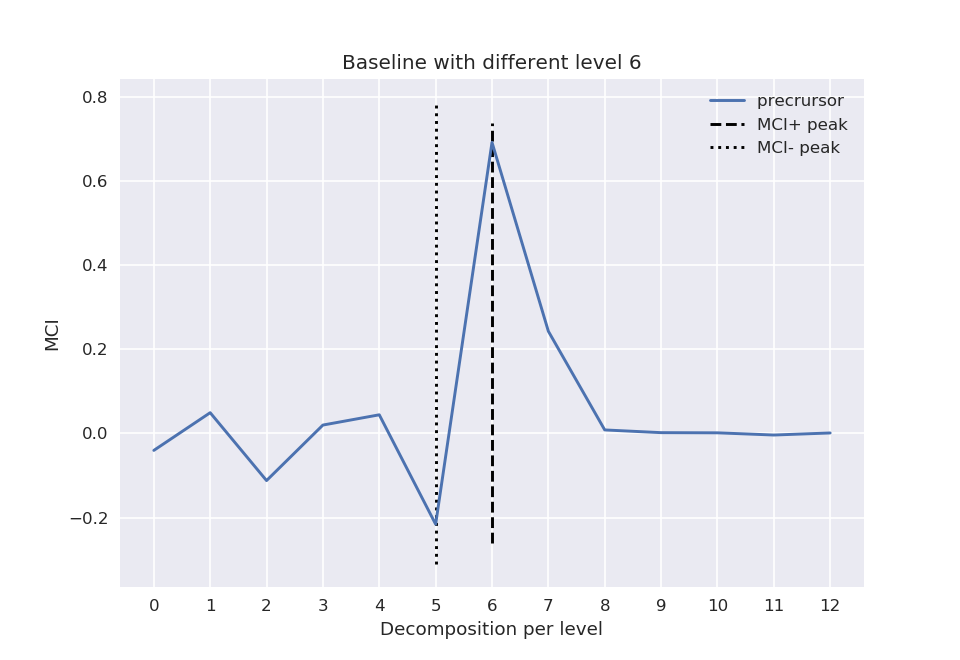

<IPython.core.display.Javascript object>


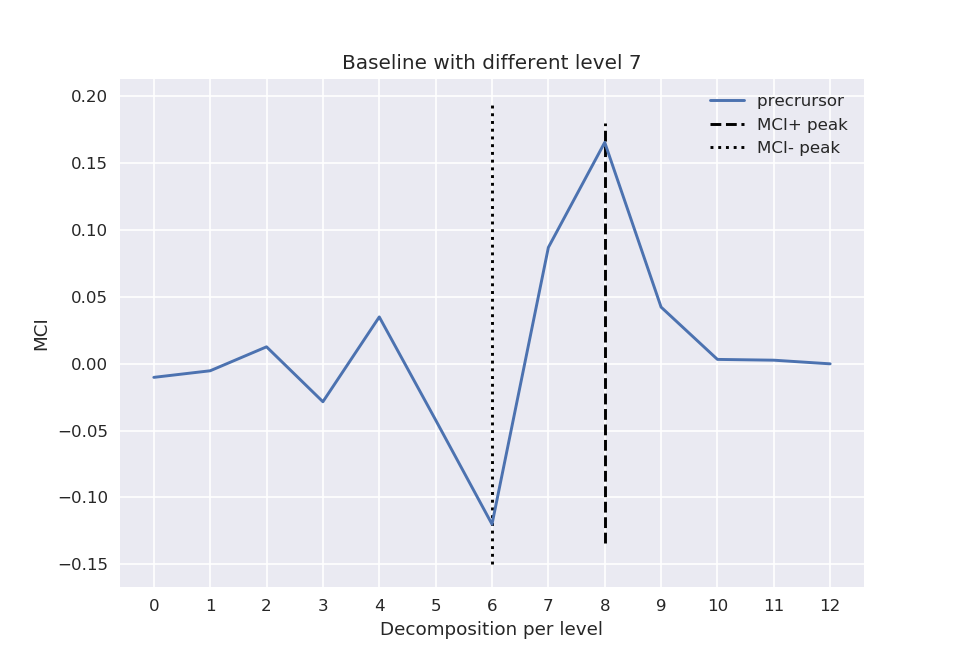

<IPython.core.display.Javascript object>


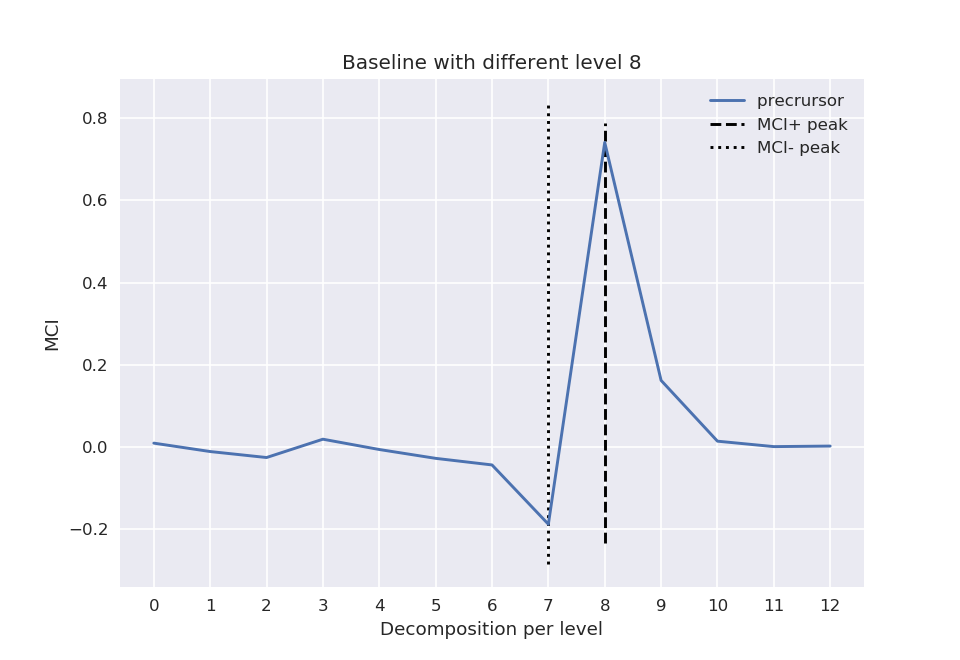

<IPython.core.display.Javascript object>


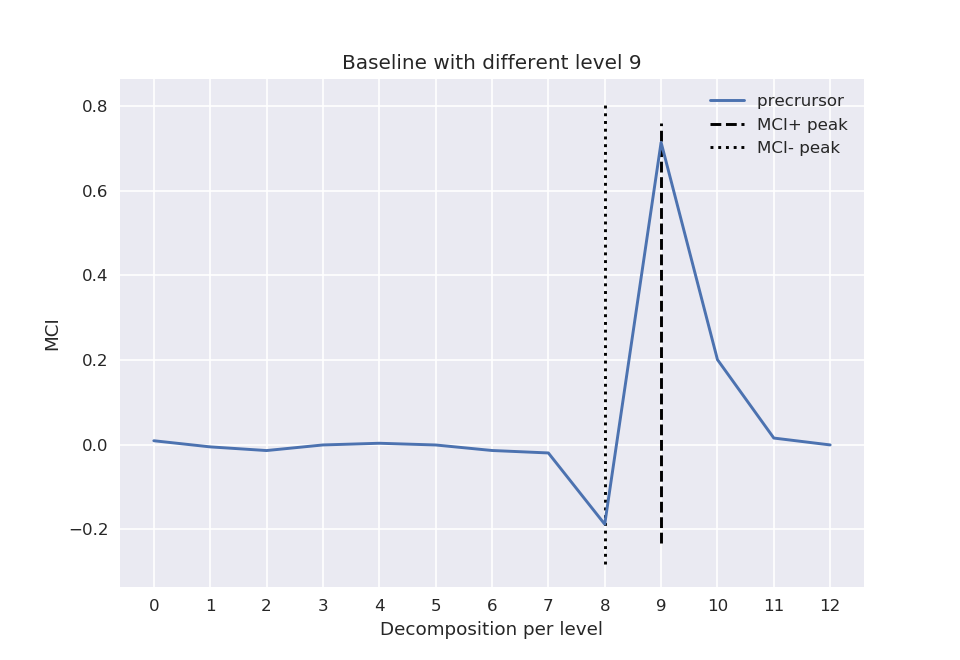

<IPython.core.display.Javascript object>


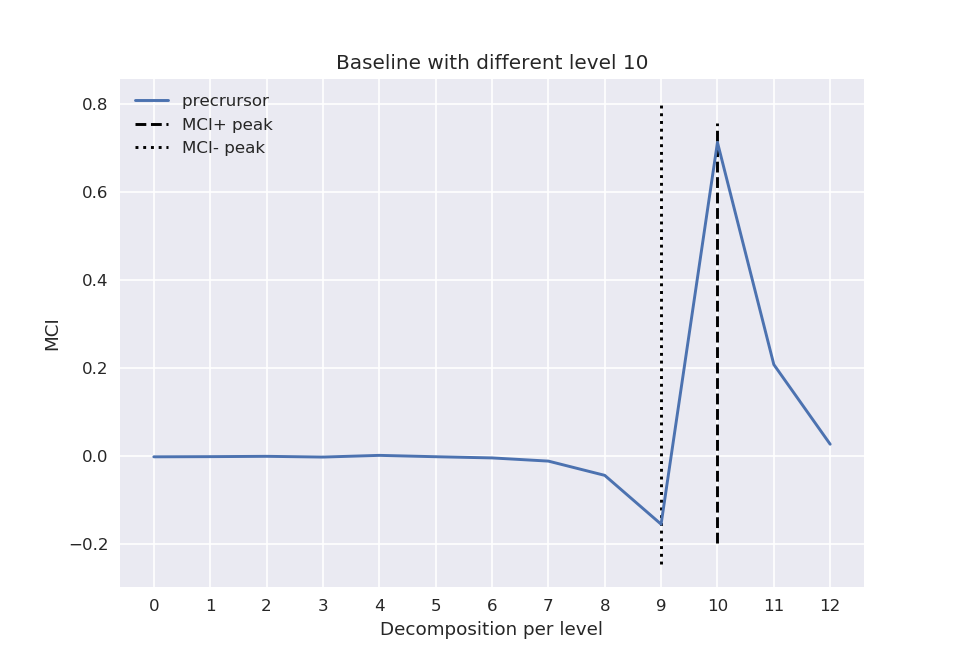

<IPython.core.display.Javascript object>


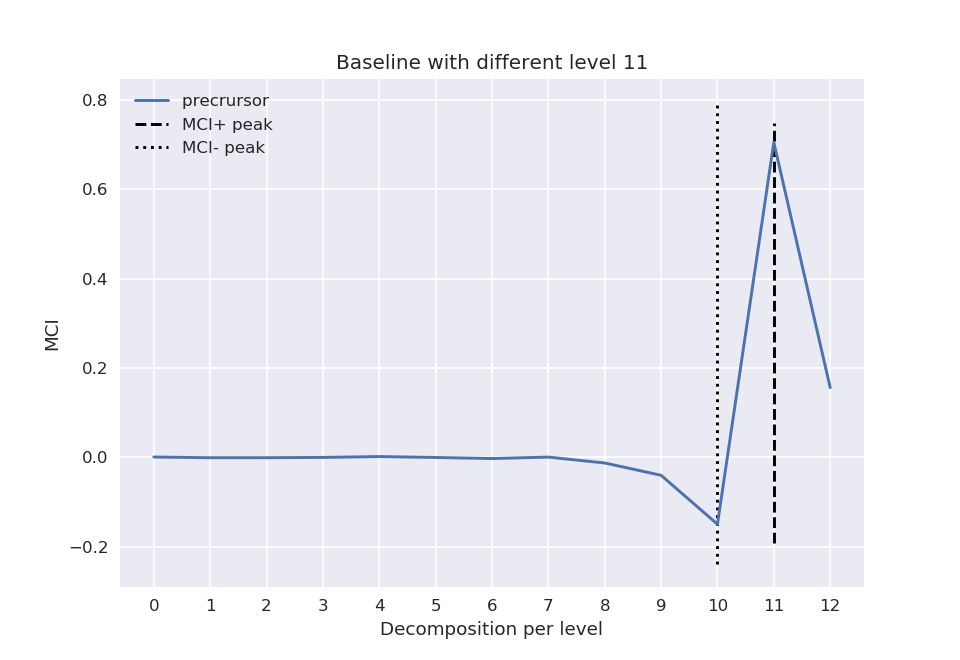

In [1242]:
for i, peak in enumerate(ar_exp1_res):
    if abs(len(ar_exp1_res) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(ar_exp1_res)-1), prec_lag=peak, path='AR and extension', title=f'Baseline with different level {str(levels[i])}', show_level=True, savefig=True)
    else:
        if i < 12:
            plot_mci_pred_relation(cA=range(len(ar_exp1_res)), prec_lag=peak, path='AR and extension', title=f'Baseline with different level {str(levels[i])}', show_level=True, savefig=True)

In [95]:
ar_exp1_res_shift, coeff_list_shift, _ = ar_exp1_shift

<IPython.core.display.Javascript object>


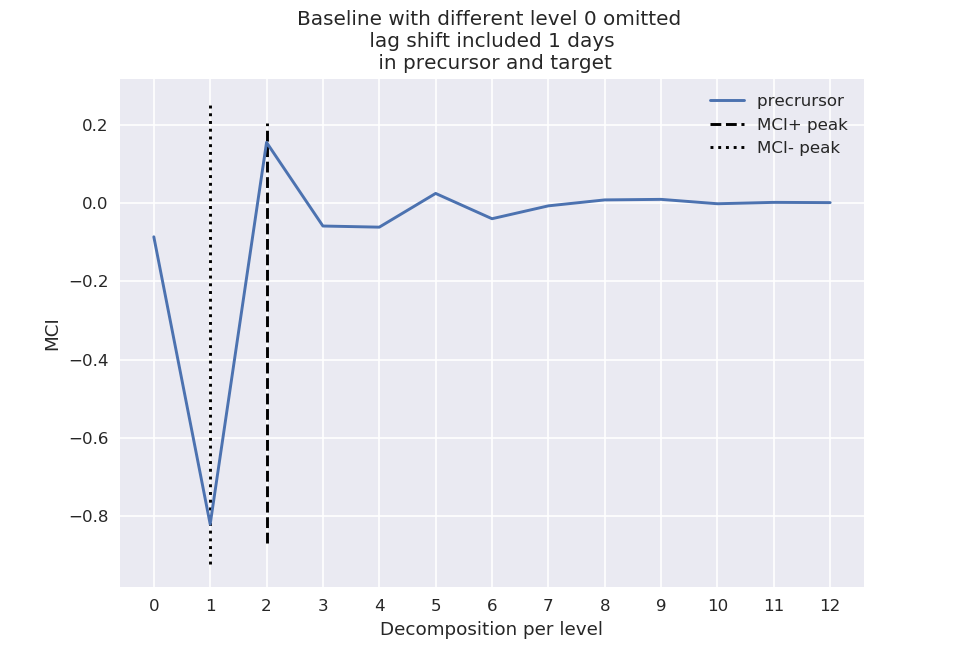

<IPython.core.display.Javascript object>


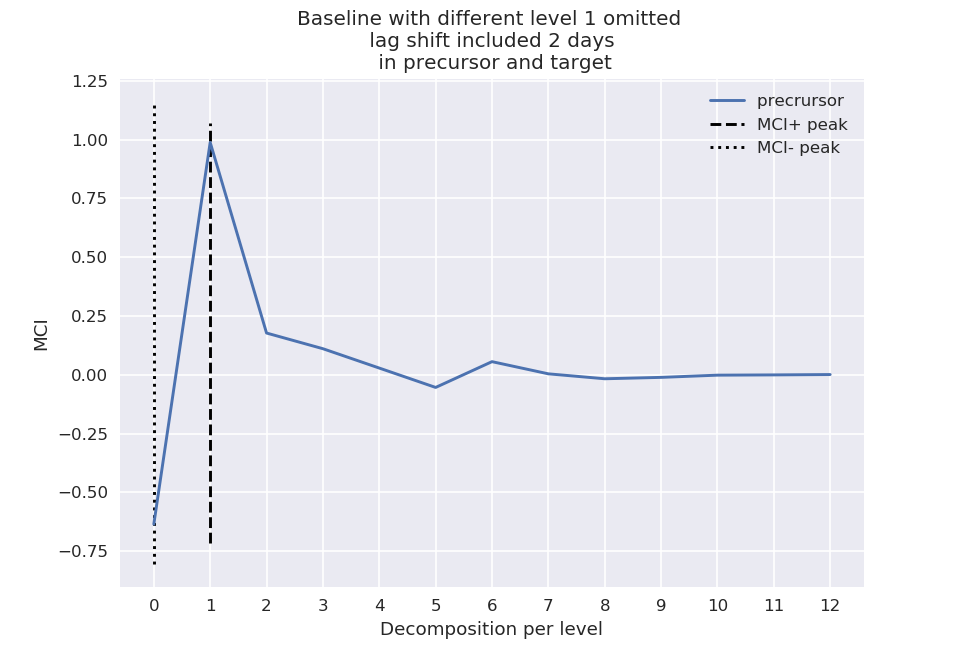

<IPython.core.display.Javascript object>


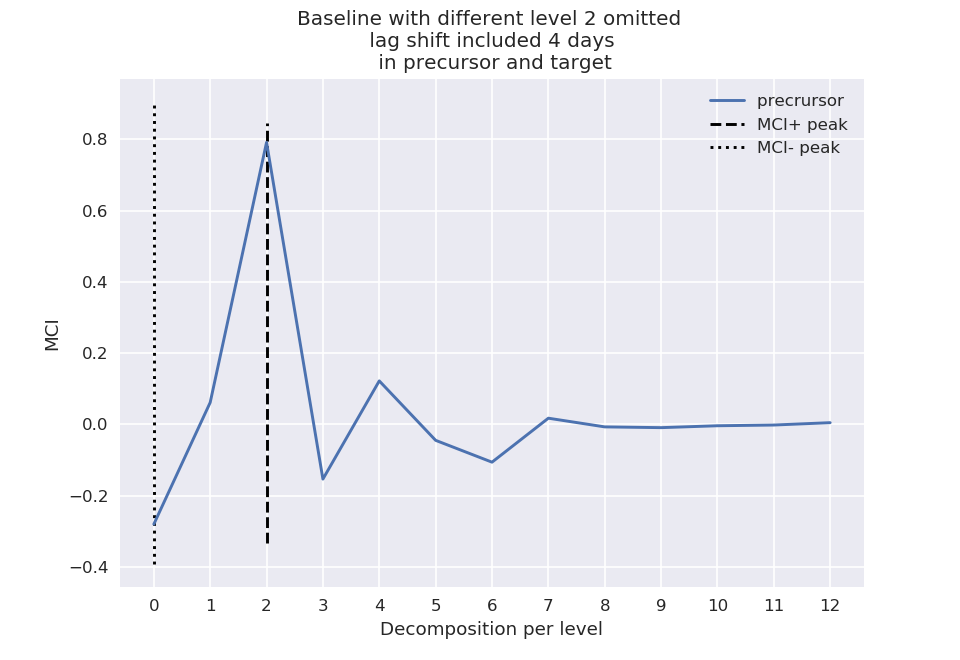

<IPython.core.display.Javascript object>


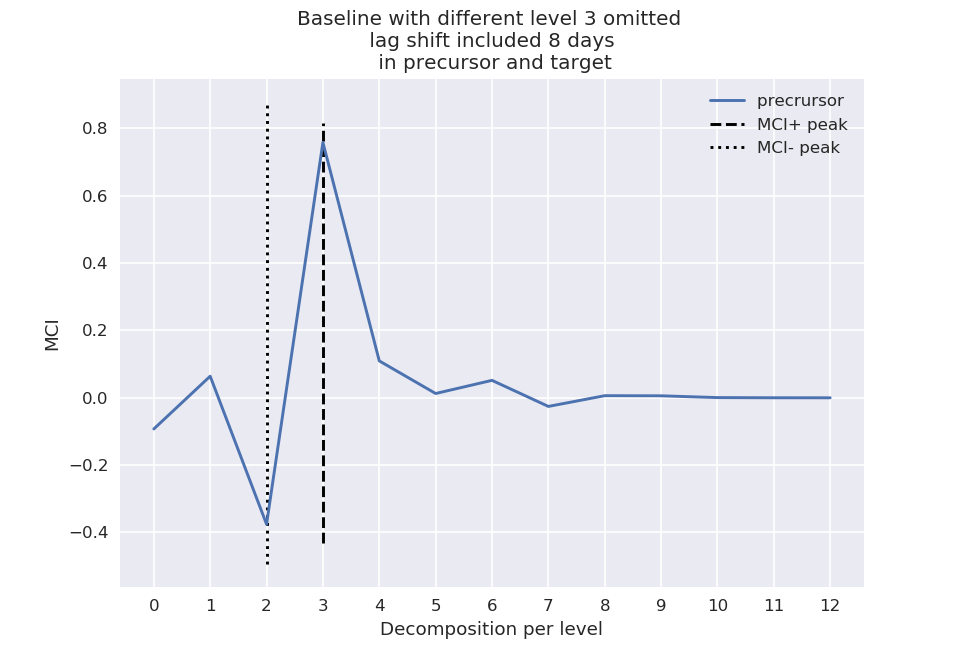

<IPython.core.display.Javascript object>


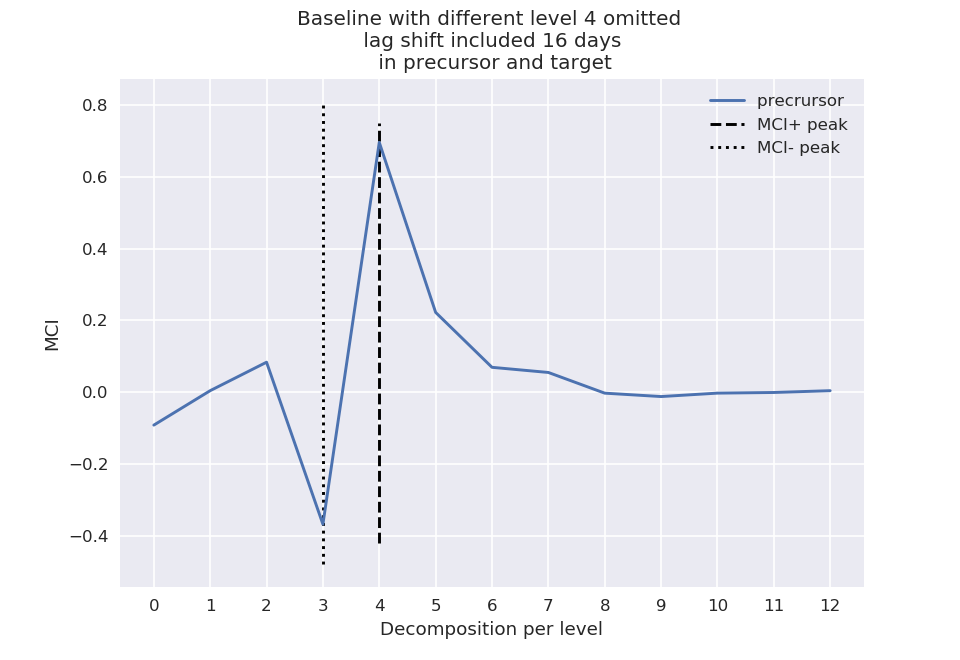

<IPython.core.display.Javascript object>


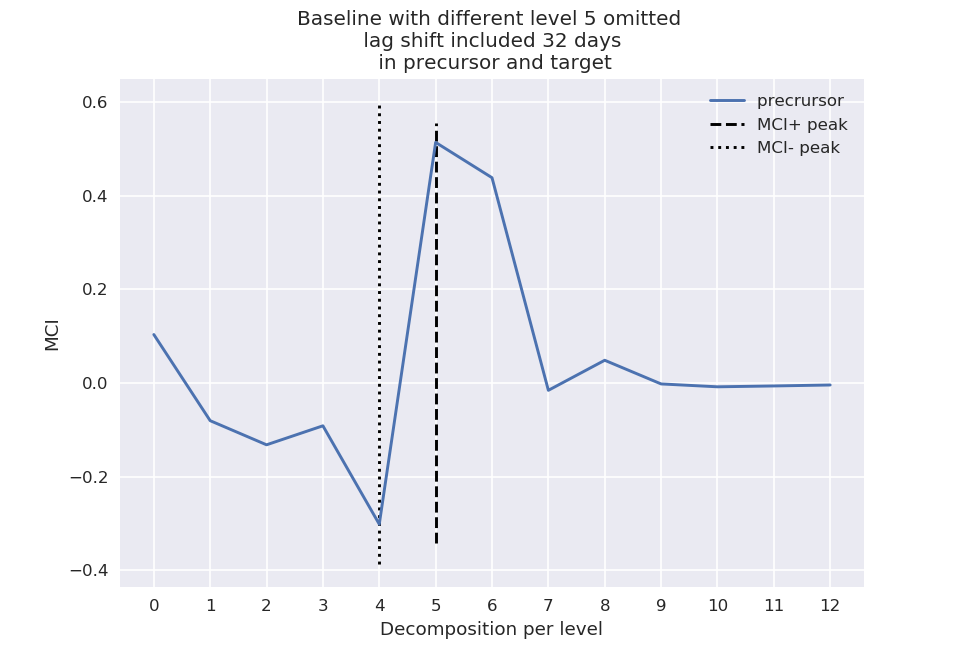

<IPython.core.display.Javascript object>


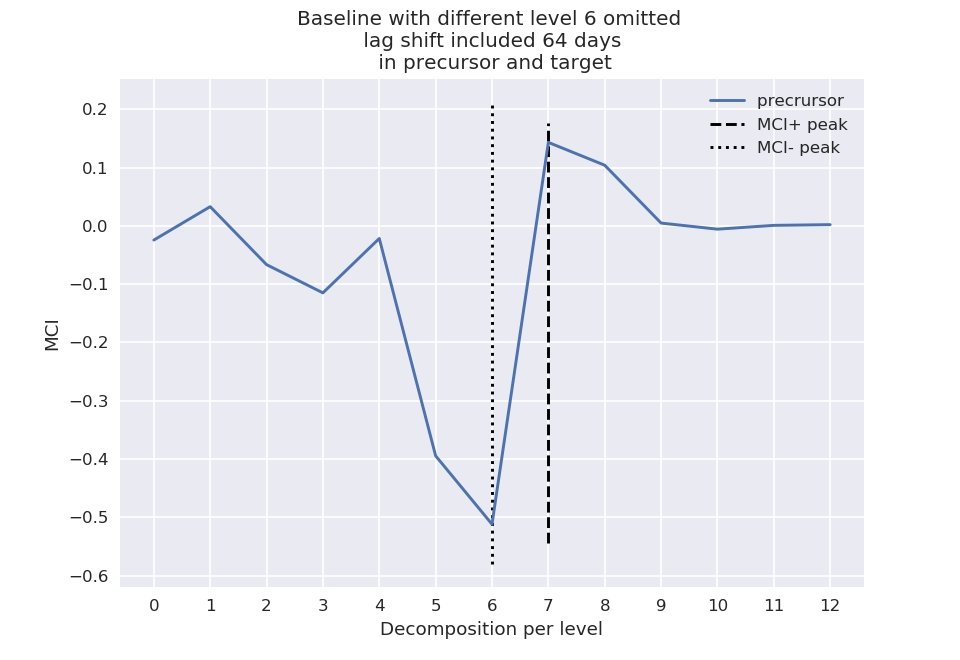

<IPython.core.display.Javascript object>


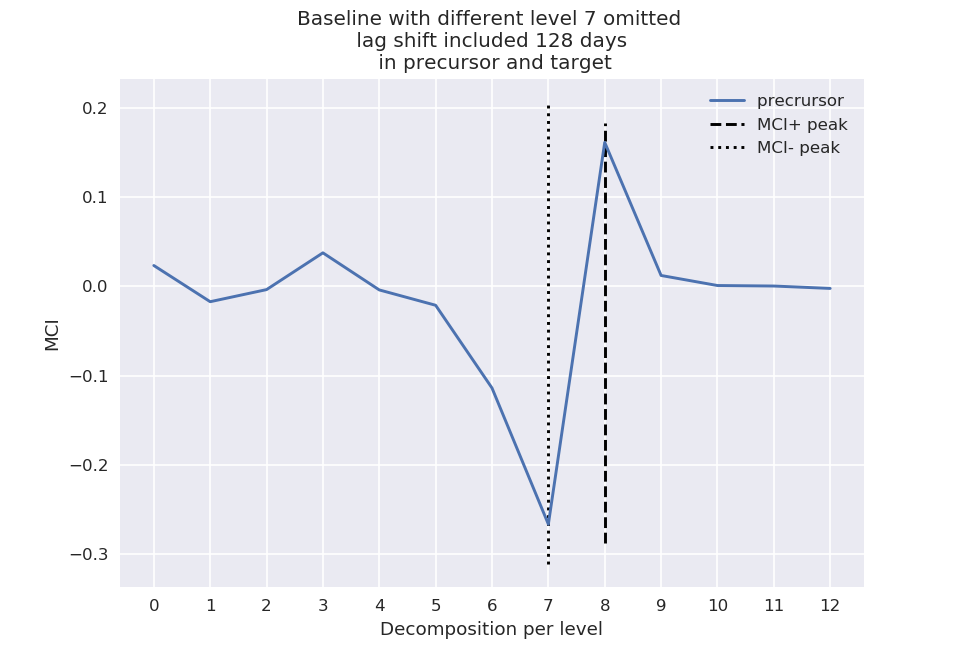

<IPython.core.display.Javascript object>


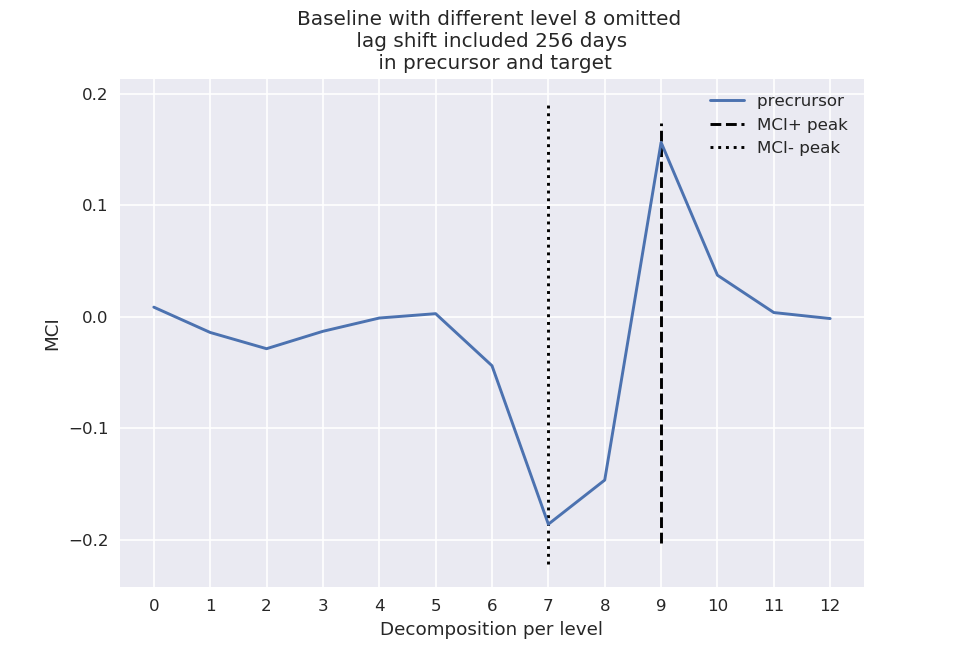

<IPython.core.display.Javascript object>


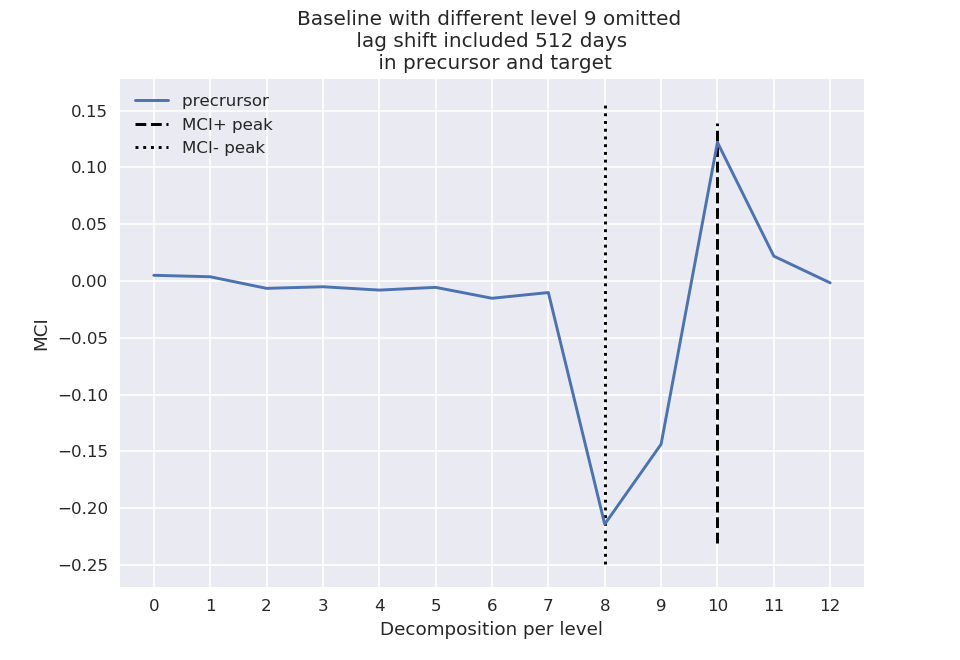

<IPython.core.display.Javascript object>


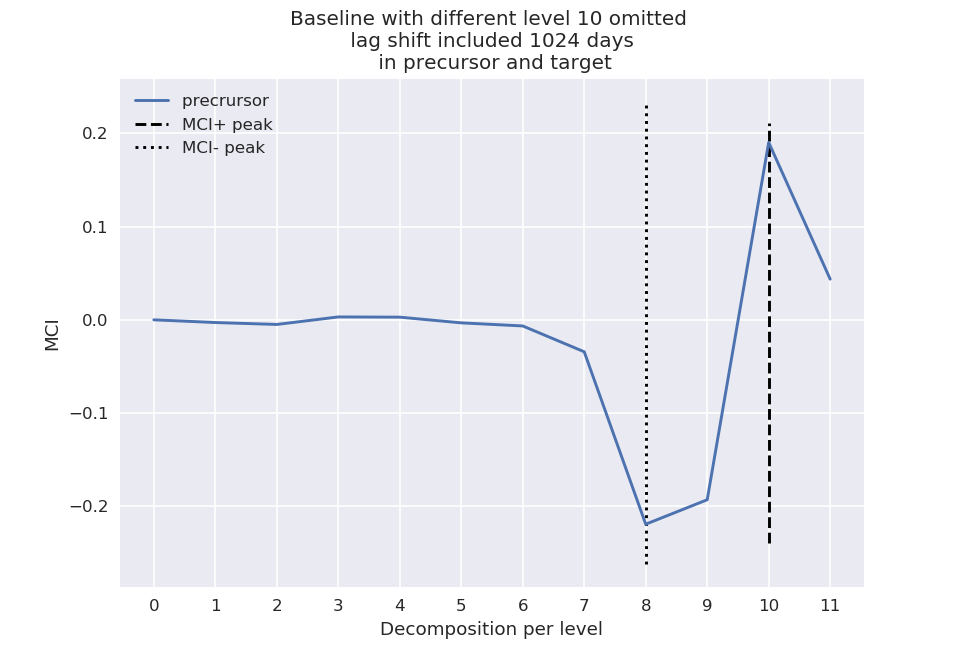

<IPython.core.display.Javascript object>


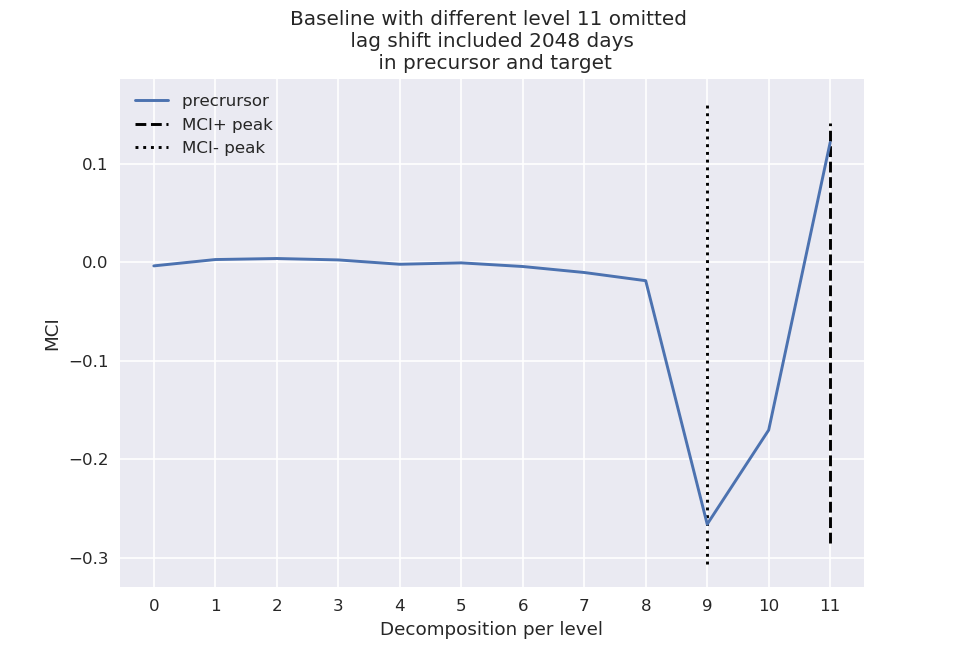

In [1244]:
for i, peak in enumerate(ar_exp1_res_shift):
#     print(len(peak), len(ar_exp1_res_shift))
#     continue
    if abs(len(ar_exp1_res_shift) - len(peak)) >= 1:
        if abs(len(ar_exp1_res_shift) - len(peak)) == 1 :
            plot_mci_pred_relation(cA=range(len(ar_exp1_res_shift)-1), prec_lag=peak, path='AR and extension/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)
        else:
            shift = abs(len(ar_exp1_res_shift) - len(peak))
#             print(shift)
#             continue
            if i < 12:
                plot_mci_pred_relation(cA=range(len(ar_exp1_res_shift)-shift), prec_lag=peak, path='AR and extension/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)
    else:
        if i < 12:
            plot_mci_pred_relation(cA=range(len(ar_exp1_res_shift)), prec_lag=peak, path='AR and extension/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)

Variance of the signal = 1.007648588355249 std dev =1.0038170093972552 
Sum of variance across all MODWT coefficients = 1.0076485883563722 and Percival mra_var = 0.6894654159499586 sample good var = 1.0075255843783013  eta3 = [8192.5, 4096.0, 2047.75, 1023.625, 511.5625, 255.53125, 127.515625, 63.5078125, 31.50390625, 15.501953125, 7.5009765625, 3.50048828125] Diff-org-sample good var = 0.00012300397807085695

 Stdev details per level = [0.014632289575006008, 0.02390825147905932, 0.048459126099332166, 0.06812448859946536, 0.10678097768584932, 0.14194235143523526, 0.1676779771365923, 0.27351070891774226, 0.365147070691548, 0.45729193378807503, 0.5035070800404627, 0.5189050738336847] and approximation = 0.01302596026572701


<IPython.core.display.Javascript object>


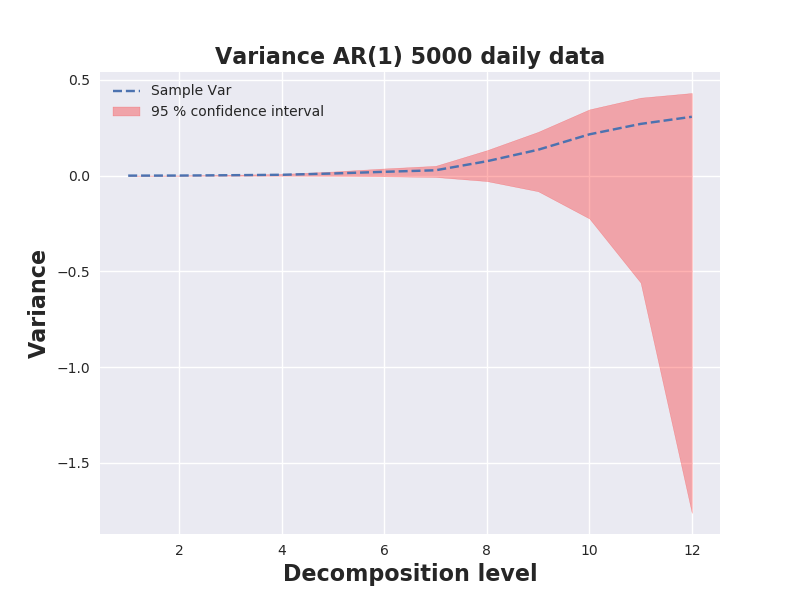

In [122]:
show_level_variance(prepro_ar_exp1, la8, appropriate_level1-1, title='Variance AR(1) 5000 daily data', savefig=False)



In [123]:
%matplotlib notebook
nps_a1 = npess(prepro_ar_exp1)
nps_coeff_a1 = np.array([npess(i) for i in coeff_list])
plot_npess(nps_a1,nps_coeff_a1, title='AR(1) NPESS with LA8', wave_name='LA8', savefig=False)

NameError: name 'coeff_list' is not defined

<IPython.core.display.Javascript object>


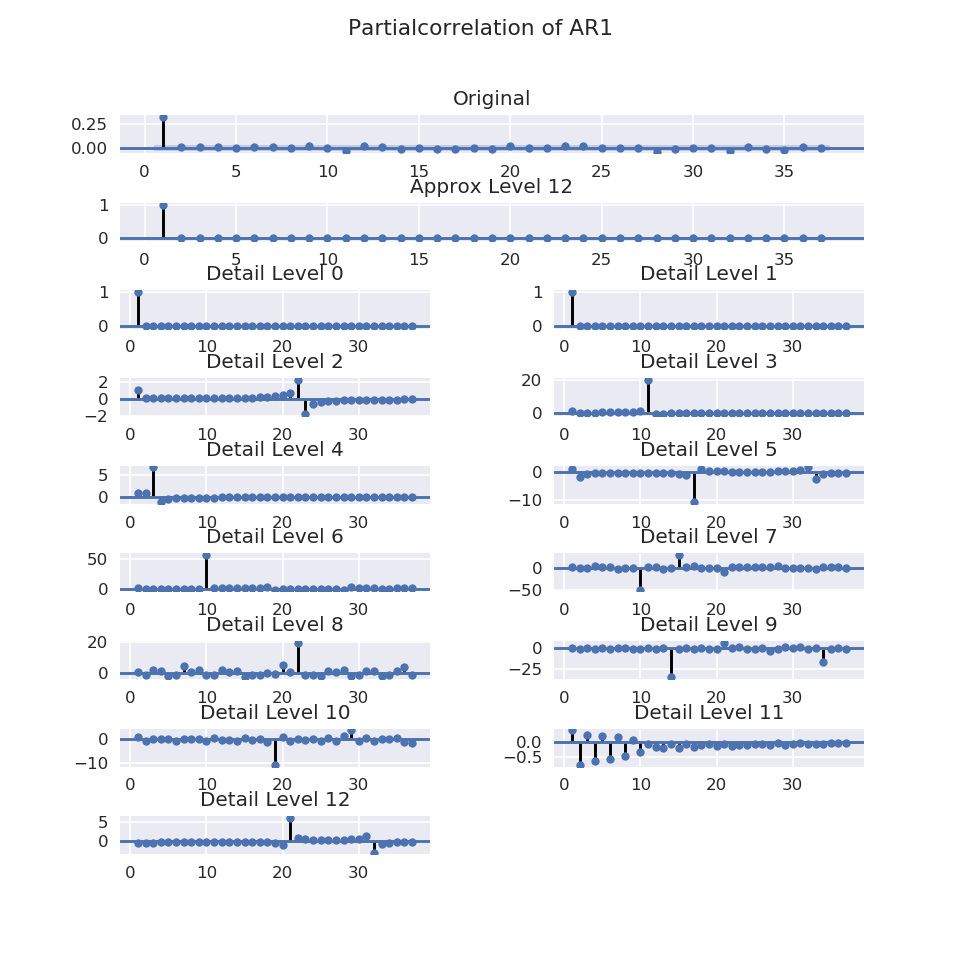

In [1245]:
show_auto_per_level(prepro_ar_exp1, coeff_list, title='Partialcorrelation of AR1', method='parcorr', savefig=False)

### Calculate Signal to noise AR versus decomposed extracted level

In [97]:
# coeff[0]  is the first level extracted but the last level elements so we need to reverse the list
rev = list(reversed(coeff_list))

#### Inspection Decomposition levels

In [ ]:
plot

Appropriate level is changed to 9


<IPython.core.display.Javascript object>


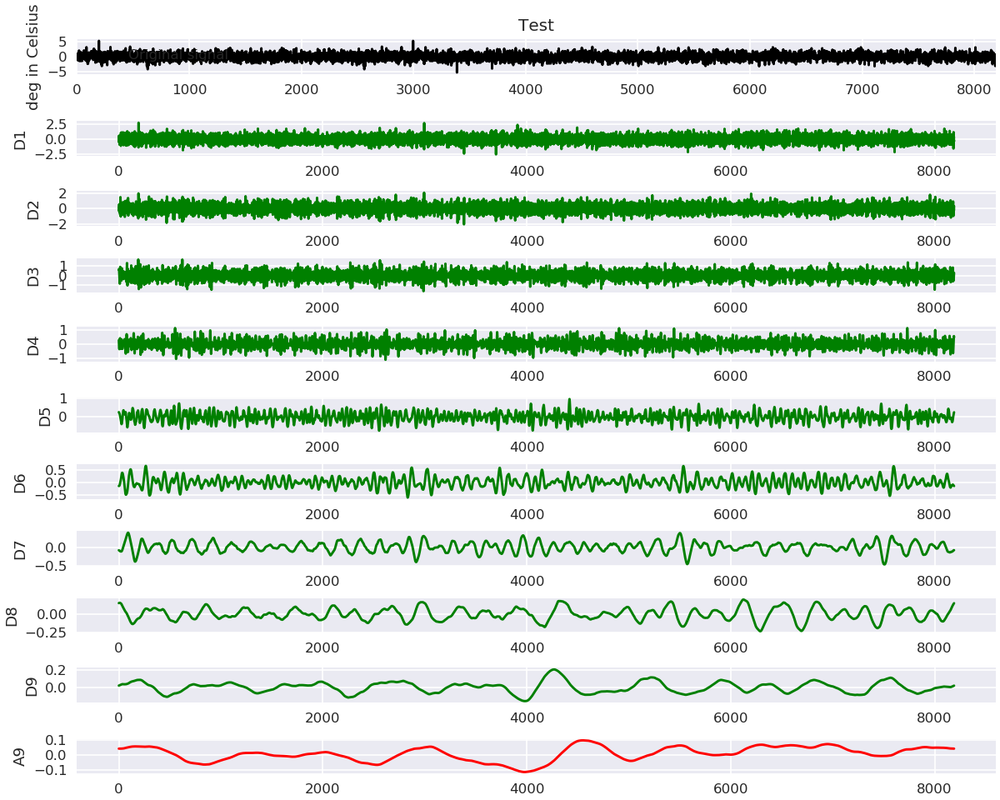

In [98]:
plot_dwt_default(prepro_ar_exp1,w=la8, title='Test',mode=wv.Modes.periodic,level=appropriate_level1, method='modwt')
plt.show()

<IPython.core.display.Javascript object>


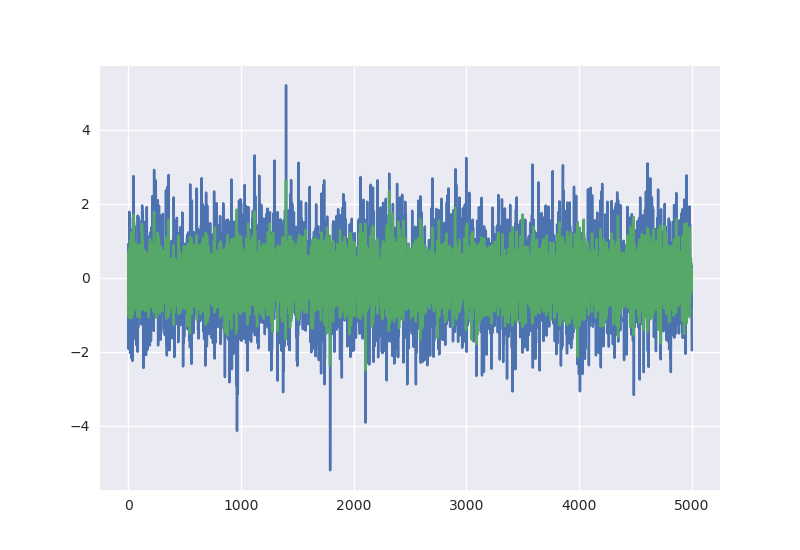

In [99]:
%matplotlib notebook
plt.plot(prepro_ar_exp1.values)
plt.plot(rev[0])
plt.show()

<IPython.core.display.Javascript object>


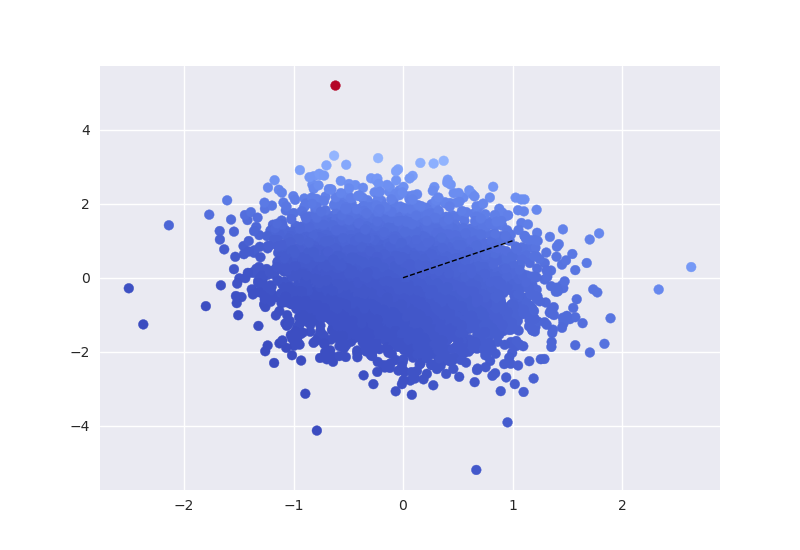

In [100]:
%matplotlib notebook
lims = [
    np.min([plt.xlim(), plt.ylim()]),  # min of both axes
    np.max([plt.xlim(), plt.ylim()]),  # max of both axes
]

plt.plot(lims, lims, linestyle='--', color='k', lw=1, scalex=False, scaley=False)
c = np.exp2(prepro_ar_exp1.values) + np.exp2(rev[0])
plt.scatter(rev[0],prepro_ar_exp1.values, c=c,  cmap=plt.cm.coolwarm)
# plt.xlim(lims)
# plt.ylim(lims)
plt.show()

#### Calculation signal to noise and visualisation

In [756]:
x = sm.add_constant(rev[1])
out = sm.OLS(prepro_ar_exp1, x).fit(cov_type='HC0')
print(out.params, sep='\n')

const   -0.000354
x1      -0.317673
dtype: float64


<IPython.core.display.Javascript object>


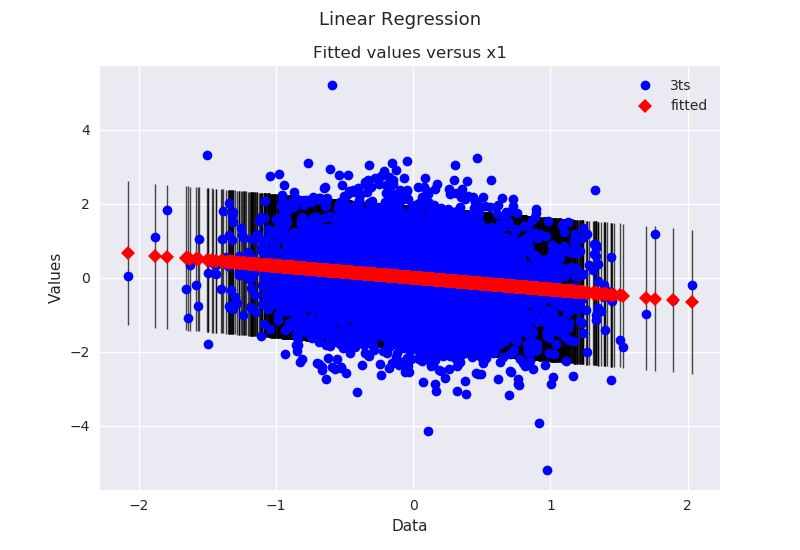

In [757]:
%matplotlib notebook 
fig, ax = plt.subplots()
fig = sm.graphics.plot_fit(out, 1, ax=ax)
# sm.graphics.plot_fit(out2, 0, ax=ax[1])
ax.set_ylabel("Values")
ax.set_xlabel("Data")
# ax[1].set_xlabel("Data")
fig.suptitle("Linear Regression")
plt.show()

In [764]:
res1 = []
res2, res3 = [], []
# titty =  0
for i, x in enumerate(rev):
    y = prepro_ar_exp1
#     if i == 0:
#         correction = np.var(x)
    x = sm.add_constant(x)
    temp = sm.OLS(y, x).fit()

    var = np.var(temp.resid)
    coeff = temp.params[1]
    const = temp.params[0]
    sn_weird =np.var(coeff*x+const)/(var)
#     if i == 0:
#         titty = sn_weird
#         res1.append(titty) 
#     else:
    res1.append(sn_weird)


<IPython.core.display.Javascript object>


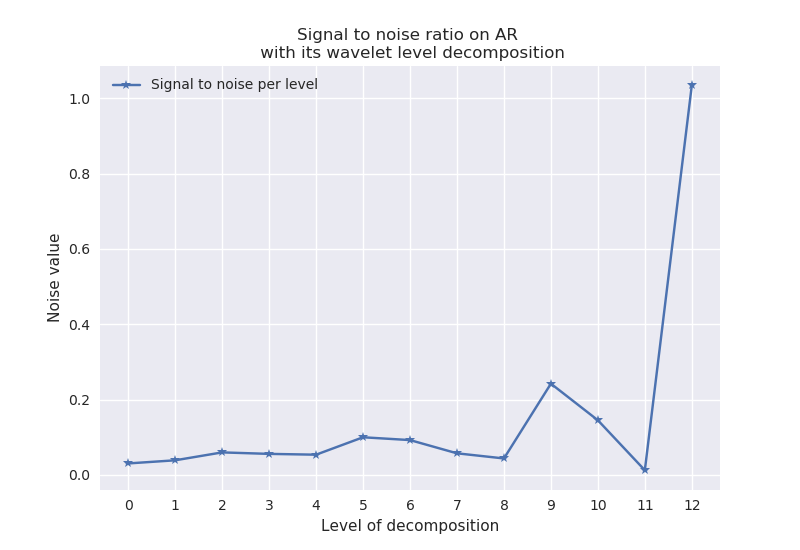

In [1025]:
%matplotlib notebook
# https://stats.stackexchange.com/questions/31158/how-to-simulate-signal-noise-ratio
# https://stats.stackexchange.com/questions/375423/estimate-signal-to-noise-ratios-by-regression
plt.plot(res1, '-*', label='Signal to noise per level')
# plt.plot(res2, '--', label='SNR regularized per level', linewidth=2.1)
# plt.plot(res3,'-*', label='Formula off Hastie')
plt.legend(loc=0)
plt.xticks(range(len(rev)))
plt.ylabel('Noise value')
plt.xlabel('Level of decomposition')
plt.title(f"Signal to noise ratio on AR \n with its wavelet level decomposition")
plt.savefig('Report/Experiment/AR and extension/SNR_AR_LA8.pdf', dpi=120)
plt.savefig('Report/Experiment/AR and extension/SNR_AR_LA8.png', dpi=120)
plt.show()

#### Investigate per level Wavelet variance, spectrum and fourier spectrum/level

In [111]:
import numpy.fft as fft

In [112]:
res1, res2, res3 = [], [], []
for _, x in enumerate(rev):
    res1.append(np.dot(x, x)/len(x))
    spectrum = fft.fft(x)
    freq = fft.fftfreq(len(spectrum))
    res2.append((freq, abs(spectrum)))
    res3.append(np.var(x, ddof=1))

<IPython.core.display.Javascript object>


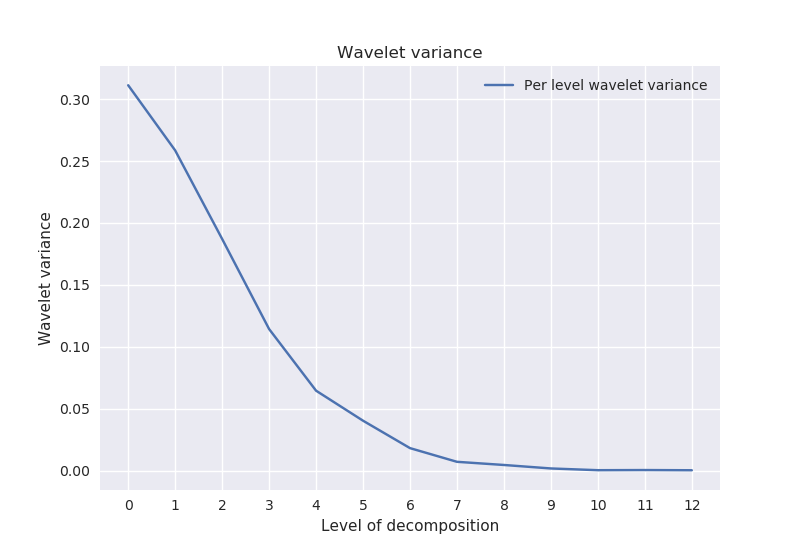

In [113]:
%matplotlib notebook
plt.plot(res1, label='Per level wavelet variance')
plt.legend(loc=0)
plt.xticks(range(len(rev)))
plt.ylabel('Wavelet variance')
plt.xlabel('Level of decomposition')
plt.title(f"Wavelet variance")
plt.show()

<IPython.core.display.Javascript object>


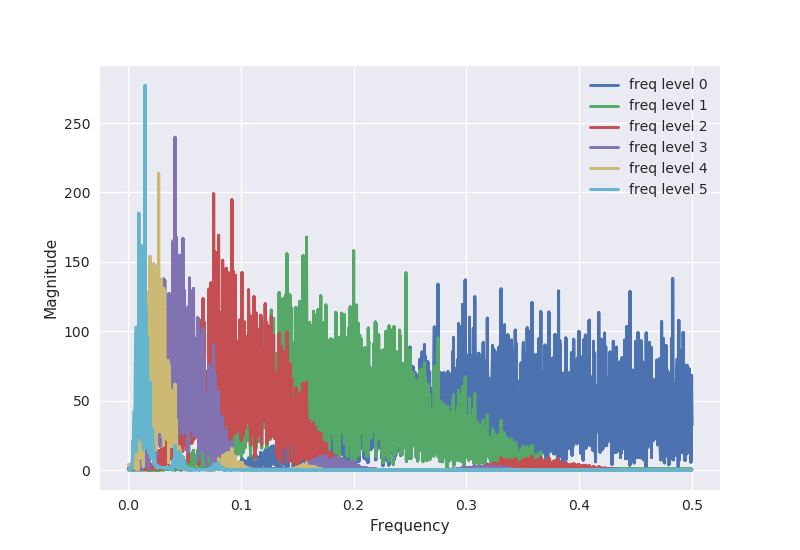

In [114]:
%matplotlib notebook
for i,_ in enumerate(rev[:-7]):
    plt.plot(abs(res2[i][0]),res2[i][1] , label=f"freq level {str(i)}", linewidth=2.1)
    plt.legend(loc=0)
plt.xlabel("Frequency")
# plt.xticks(ticks, ticks)
plt.ylabel("Magnitude")
plt.show()

<IPython.core.display.Javascript object>


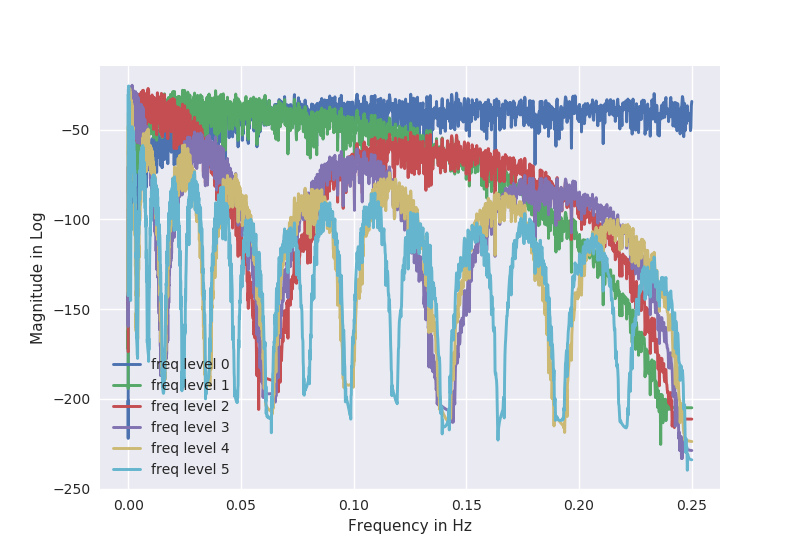

In [115]:
%matplotlib notebook
for i,signal in enumerate(rev[:-7]):
    plt.magnitude_spectrum(signal, abs(res2[i][0]) ,scale='dB', label=f"freq level {str(i)}", linewidth=2.1)
    plt.legend(loc=0)
plt.xlabel("Frequency in Hz")
plt.ylabel("Magnitude in Log")
plt.show()

<IPython.core.display.Javascript object>


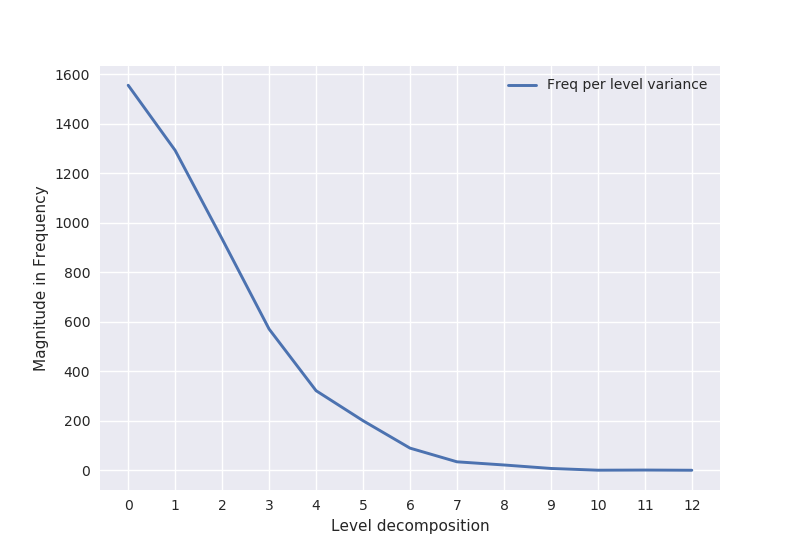

In [116]:
%matplotlib notebook
res4 = []
for i,_ in enumerate(rev):
    res4.append(np.dot(res2[i][1],res2[i][1])/len(rev[i]) - np.exp2(np.mean(prepro_ar_exp1)))
plt.plot(res4, label=f"Freq per level variance", linewidth=2.1)
plt.legend(loc=0)
plt.xticks(range(len(rev)))
plt.xlabel("Level decomposition")
plt.ylabel("Magnitude in Frequency")
plt.show()

<IPython.core.display.Javascript object>


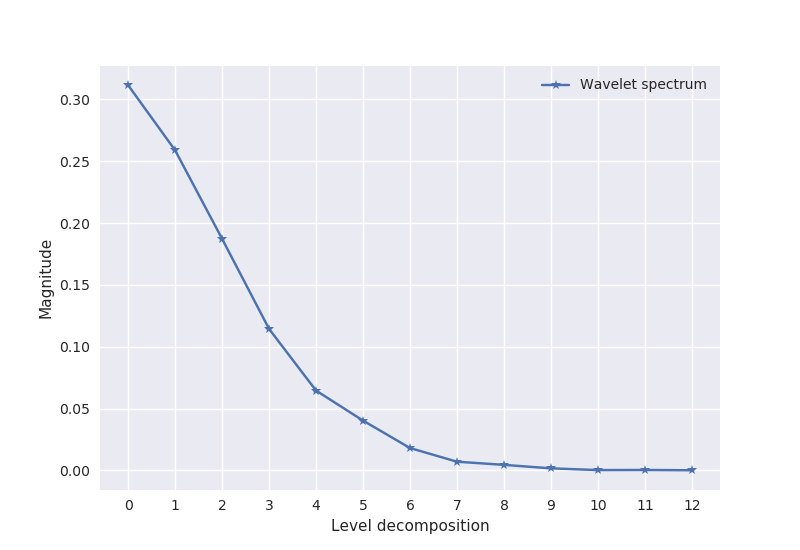

In [117]:
%matplotlib notebook
plt.plot(res3,'-*', label='Wavelet spectrum')
plt.legend(loc=0)
plt.xticks(range(len(rev)))
plt.xlabel("Level decomposition")
plt.ylabel("Magnitude")
plt.show()

<IPython.core.display.Javascript object>


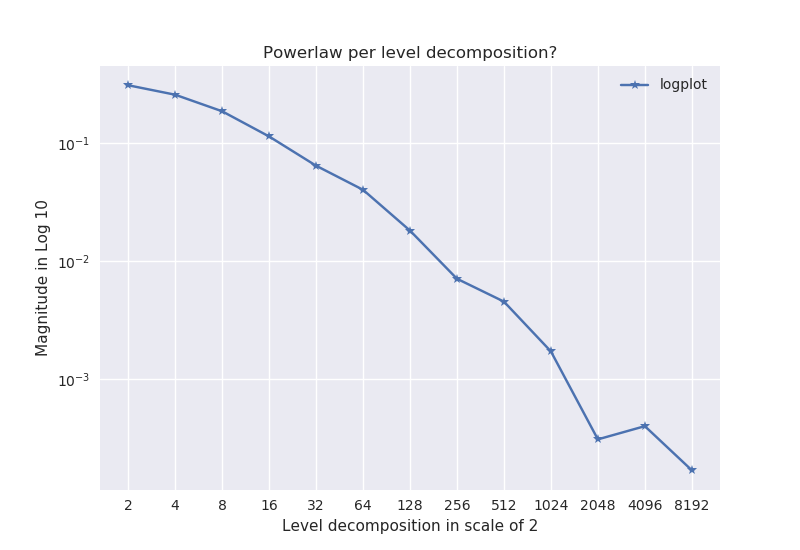

In [118]:
%matplotlib notebook
plt.semilogy(res3,'-*', label='logplot')
plt.legend(loc=0)
plt.xticks(range(len(rev)), [2**i for i in range(1, len(rev)+1)])
# plt.xscale('log', basex=2)
plt.title("Powerlaw per level decomposition?")
plt.xlabel("Level decomposition in scale of 2")
plt.ylabel("Magnitude in Log 10")
plt.show()

## (Ensemble) AR + signal

### Generate waves

In [124]:
def generate_wave(ampl, omega, length, wave_sign='sine'):
    if wave_sign =='sine':
        return  ampl* np.sin(omega * np.arange(length))
    else:
        return ampl* np.cos(omega * np.arange(length))

In [125]:
def add_noise(signal):
    temp = signal.reshape(len(signal),1)
    return temp[:,0]*np.random.randn(len(signal))

In [126]:
sine = generate_wave(5, 0.1, 5000)
cos = generate_wave(5, 0.1, 5000, wave_sign='cos')


temp = sine.reshape(len(sine), 1)
temp_noise_sine = temp[:,0]*np.random.randn(len(sine))

<IPython.core.display.Javascript object>


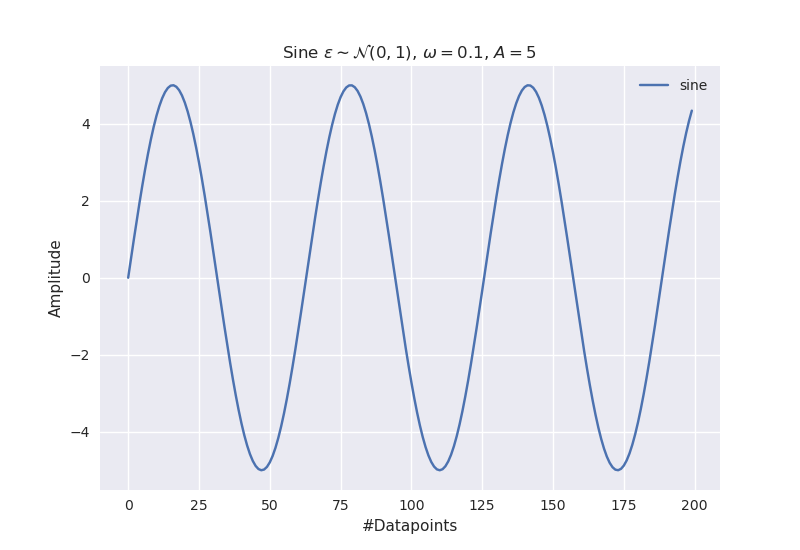

In [127]:
%matplotlib notebook
plt.plot(sine[:200], label='sine')
# plt.plot(cos[:200], label='cosine')
# plt.plot(temp_noise_sine[:200], label='noisy sine')
plt.legend(loc=0)
plt.title(r'Sine $ \epsilon \sim \mathcal{N}(0,1)$, $\omega=0.1$, $A=5$ ')
plt.ylabel('Amplitude')
plt.xlabel('#Datapoints')
plt.savefig('Report/Experiment/AR and extension/sines_no_noise.pdf', dpi=120)
plt.savefig('Report/Experiment/AR and extension/sines_no_noise.png', dpi=120)
plt.show()

### Generate AR + wave

In [128]:
synthetic_wave = dict()
synthetic_wave['ARrange'] = np.array([])
synthetic_wave['MArange'] = np.array([])
synthetic_wave['arparams'] = np.r_[1, -synthetic_wave['ARrange']]
synthetic_wave['maparams'] = np.r_[1, -synthetic_wave['MArange']]
synthetic_wave['nobs'] = 5000
synthetic_wave['startyear'] = '1900-01-1'
dates  = pd.date_range(start=synthetic_wave['startyear'], periods=synthetic_wave['nobs'], freq='D')

synthetic_wave['ARrange']= np.random.random()
synthetic_wave['arparams'] = np.r_[1, -synthetic_wave['ARrange']]
y_wave = arma_generate_sample(synthetic_wave['arparams'],synthetic_wave['maparams'], synthetic_wave['nobs'])
y_wave_noise = y_wave + temp_noise_sine
y_wave = y_wave + sine 

y_wave = pd.DataFrame(y_wave, index=dates)
y_wave_noise = pd.DataFrame(y_wave_noise, index=dates)

In [129]:
idx_datetime_2 = y_wave.index

In [130]:
ar_df_2 = pd.DataFrame(data=y_wave.values, index=pd.MultiIndex.from_product(([0], idx_datetime_2)), columns=[target_col])

In [131]:
ar_df_3 = pd.DataFrame(data=y_wave_noise.values, index=pd.MultiIndex.from_product(([0], idx_datetime_2)), columns=[target_col])

### Display AR timeseries info

<IPython.core.display.Javascript object>


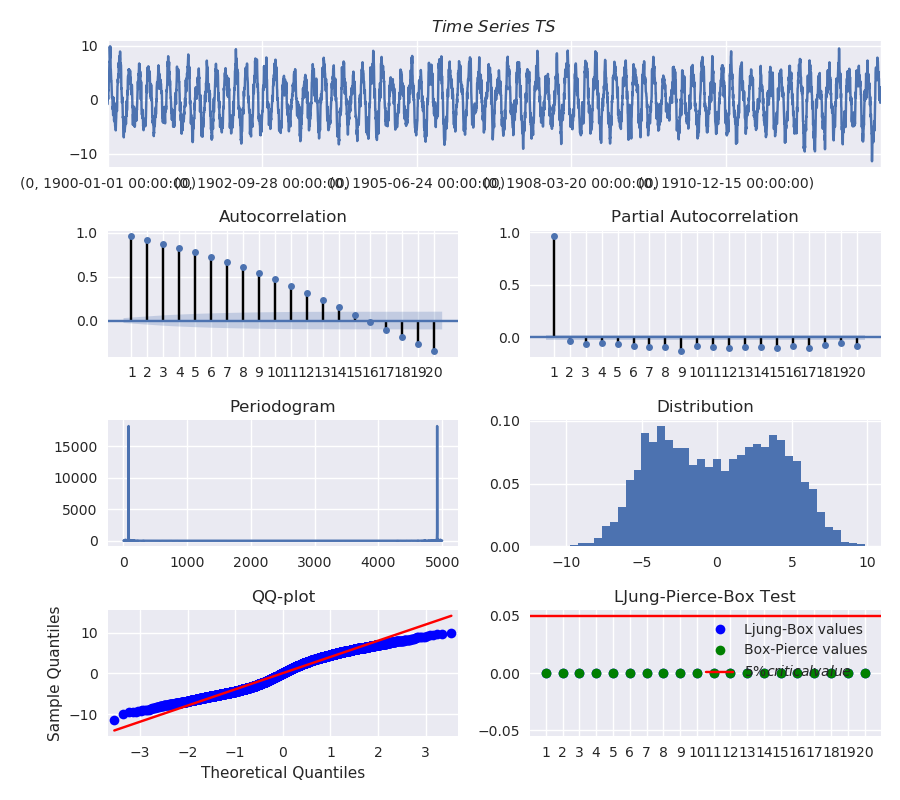

In [132]:
display_info_ts(y=ar_df_2[target_col], dates=ar_df_2.index.levels[1], figsize=(9, 8), title="TS", lags=20)

<IPython.core.display.Javascript object>


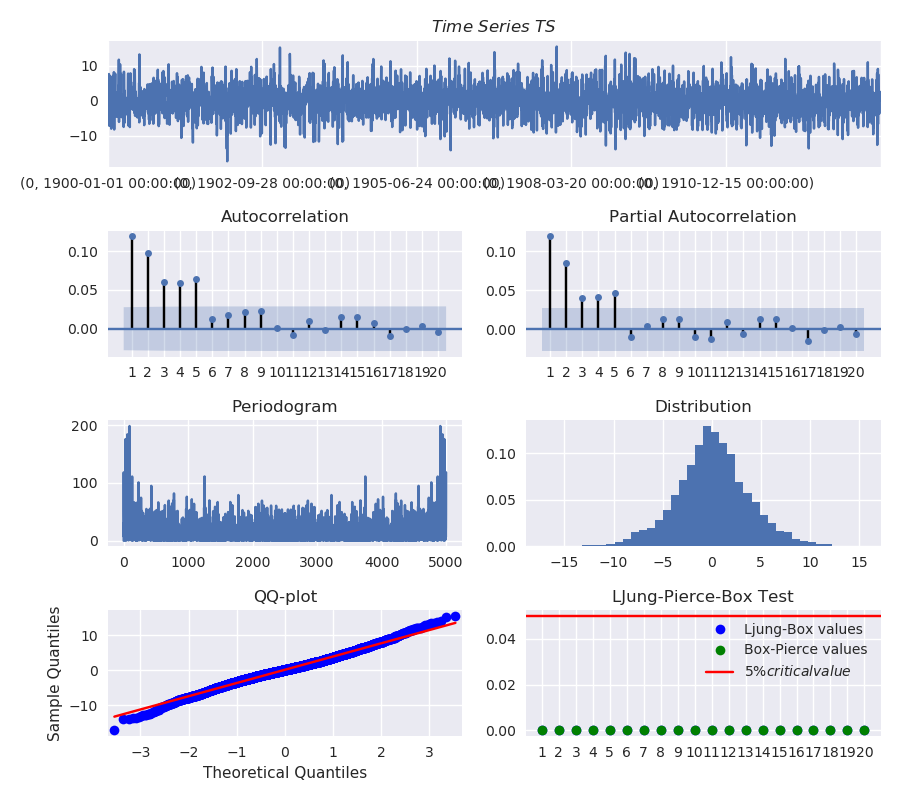

In [133]:
display_info_ts(y=ar_df_3[target_col],dates=ar_df_3.index.levels[1], figsize=(9, 8), title="TS", lags=20)

<IPython.core.display.Javascript object>


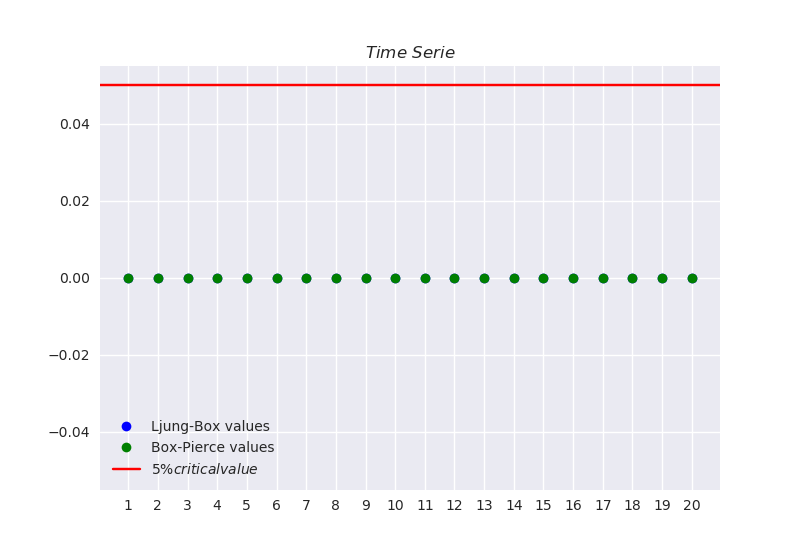

In [751]:
%matplotlib notebook
display_pierce_LJbox(y=ar_df_2[target_col], dates=ar_df_2.index.levels[1], figsize=(9, 8), title="", lags=20)

<IPython.core.display.Javascript object>


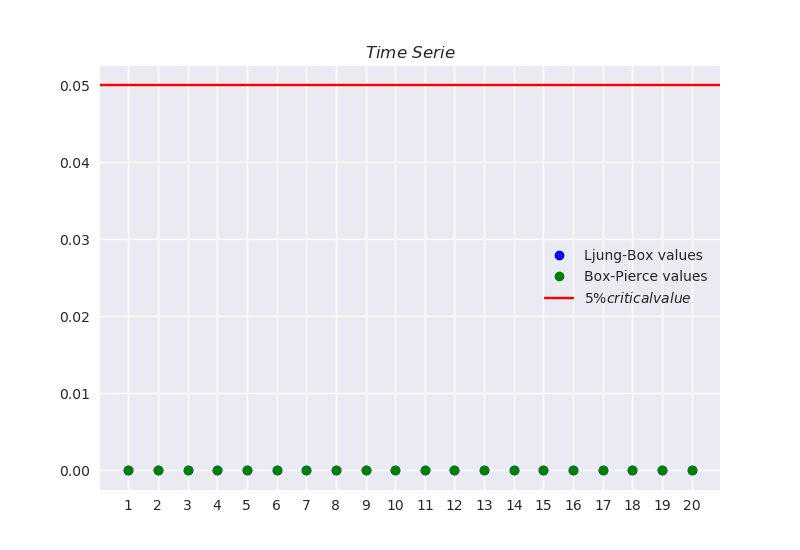

In [134]:
%matplotlib notebook
display_pierce_LJbox(y=ar_df_3[target_col], dates=ar_df_3.index.levels[1], figsize=(9, 8), title="", lags=20)

### Standardize and stationarity test of AR timeseries

In [135]:
prepro_ar_exp2 = preprocess_ts(serie=ar_df_2, to_serie=True, col=target_col)


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  8.50068193618e-312  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS True


[INFO] Time serie is gaussian like 



In [136]:
prepro_ar_exp3 = preprocess_ts(serie=ar_df_3, to_serie=True, col=target_col)


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  3.7265945147872226e-17  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is NOT stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS False


[INFO] Time serie is gaussian like 



<IPython.core.display.Javascript object>


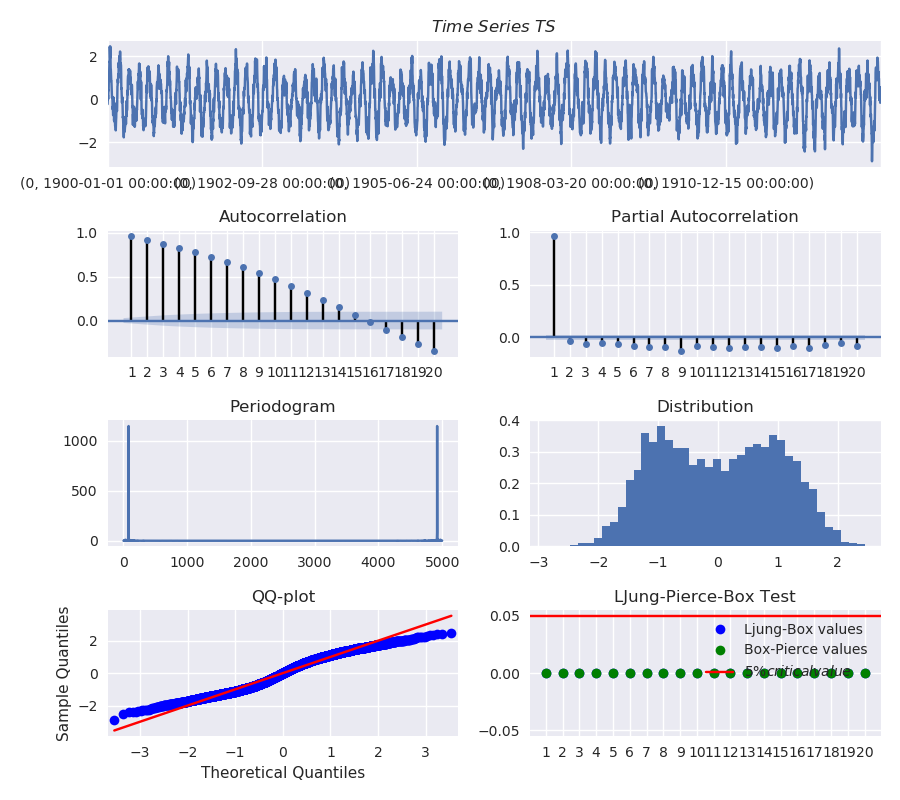

In [137]:
display_info_ts(y=prepro_ar_exp2, dates=ar_df_2.index.levels[1], figsize=(9, 8), title="TS", lags=20)

<IPython.core.display.Javascript object>


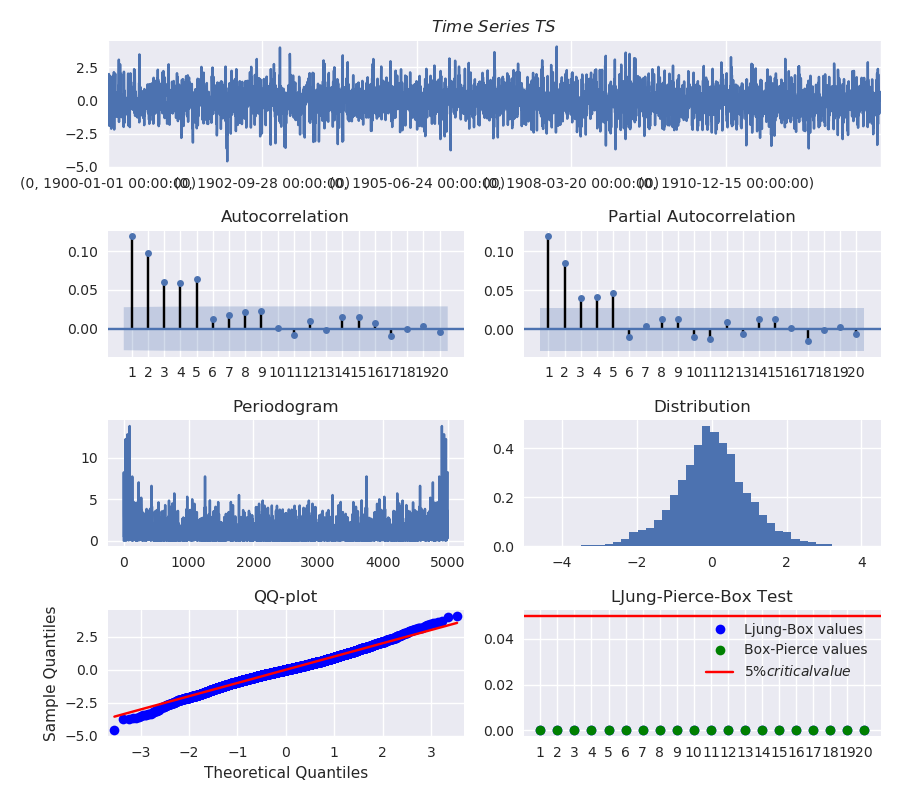

In [138]:
display_info_ts(y=prepro_ar_exp3,dates=ar_df_3.index.levels[1], figsize=(9, 8), title="TS", lags=20)

<IPython.core.display.Javascript object>


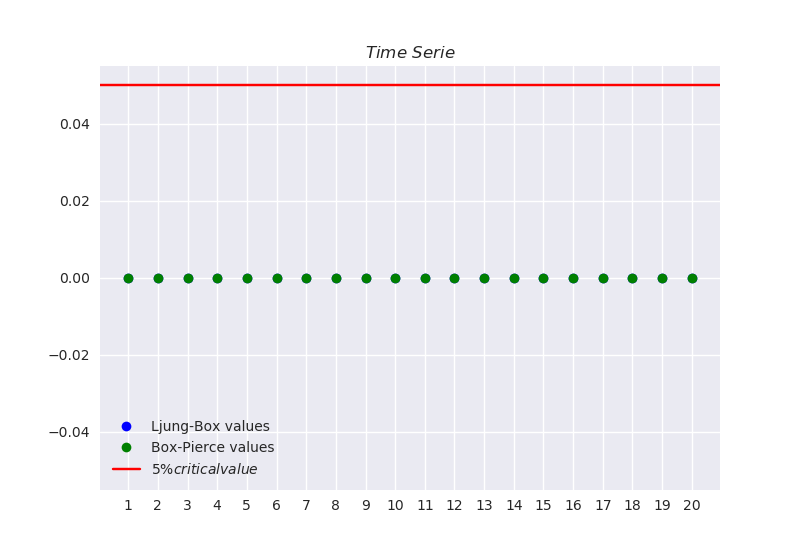

In [139]:
%matplotlib notebook
display_pierce_LJbox(y=prepro_ar_exp2, dates=ar_df_2.index.levels[1], figsize=(9, 8), title="", lags=20)

### Execute Baseline

In [141]:
appropriate_level2 = get_pad_level(prepro_ar_exp2)
levels2 = np.arange(0, appropriate_level2, 1)
print(levels2)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]


#### Tau min, max=0 no shifted lag

In [133]:
ar_exp2 = run_experiment_levels(prepro_ar_exp2, ar_df_2,rg, idx_datetime, peak_test=True,total_levels=levels2)


[INFO] Extracting level 0

[INFO] Extracting level 1

[INFO] Extracting level 2

[INFO] Extracting level 3

[INFO] Extracting level 4

[INFO] Extracting level 5

[INFO] Extracting level 6

[INFO] Extracting level 7

[INFO] Extracting level 8

[INFO] Extracting level 9

[INFO] Extracting level 10

[INFO] Extracting level 11

[INFO] Extracting level 12
Progress causal inference - traintest set 100%

/home/jier/miniconda3/envs/RGCPD/lib/python3.7/site-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


Progress causal inference - traintest set 100%

#### Tau min, max=0 shifted lag

In [134]:
ar_exp2_shift = run_experiment_levels_full_lag(prepro_ar_exp2, ar_df_2, rg, idx_datetime, w=la8, peak_test=True, total_levels=levels2)


[INFO] Extracting level 0
Progress causal inference - traintest set 100%
[INFO] Extracting level 1
Progress causal inference - traintest set 100%
[INFO] Extracting level 2
Progress causal inference - traintest set 100%
[INFO] Extracting level 3
Progress causal inference - traintest set 100%
[INFO] Extracting level 4
Progress causal inference - traintest set 100%
[INFO] Extracting level 5
Progress causal inference - traintest set 100%
[INFO] Extracting level 6
Progress causal inference - traintest set 100%
[INFO] Extracting level 7
Progress causal inference - traintest set 100%
[INFO] Extracting level 8
Progress causal inference - traintest set 100%
[INFO] Extracting level 9
Progress causal inference - traintest set 100%
[INFO] Extracting level 10
[INFO] Appropriate level is changed to  12
Progress causal inference - traintest set 100%
[INFO] Extracting level 11
[INFO] Appropriate level is changed to  12
Progress causal inference - traintest set 100%
[INFO] Extracting level 12
[INFO] A

### Visualize MCI peaks

<IPython.core.display.Javascript object>


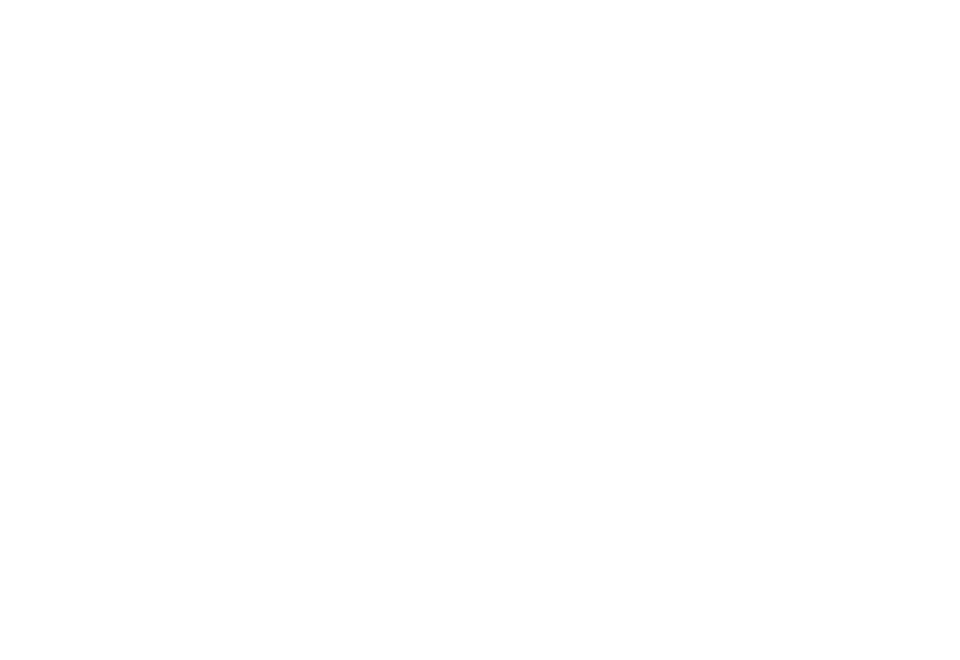

<IPython.core.display.Javascript object>


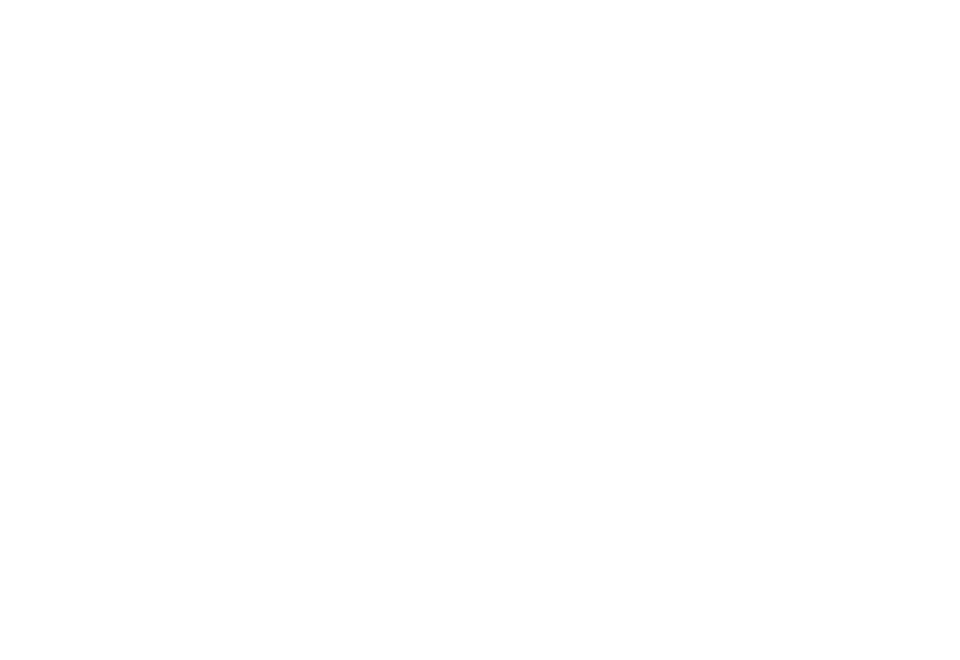

<IPython.core.display.Javascript object>


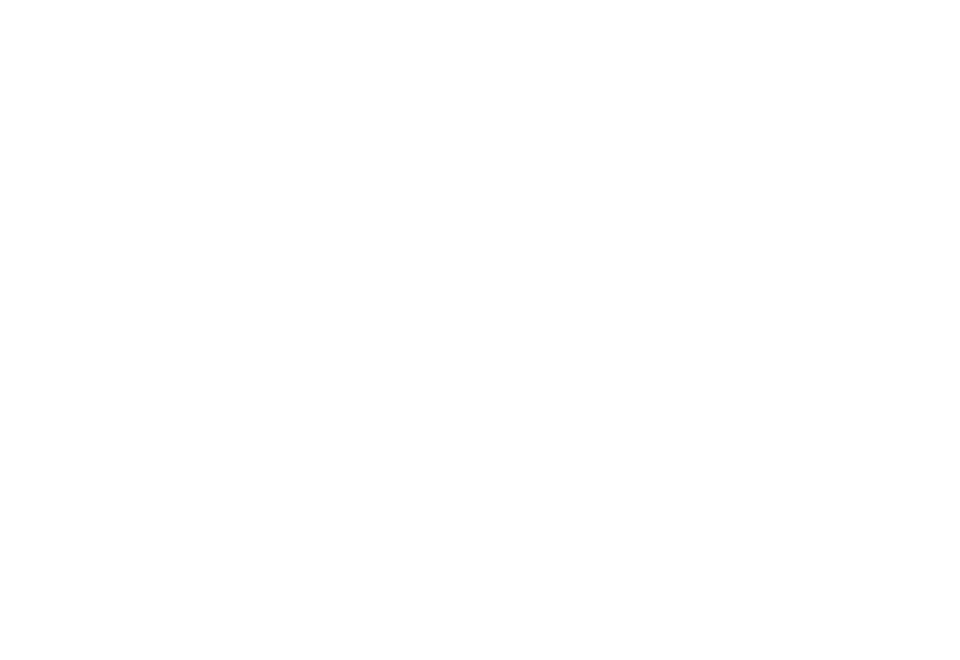

<IPython.core.display.Javascript object>


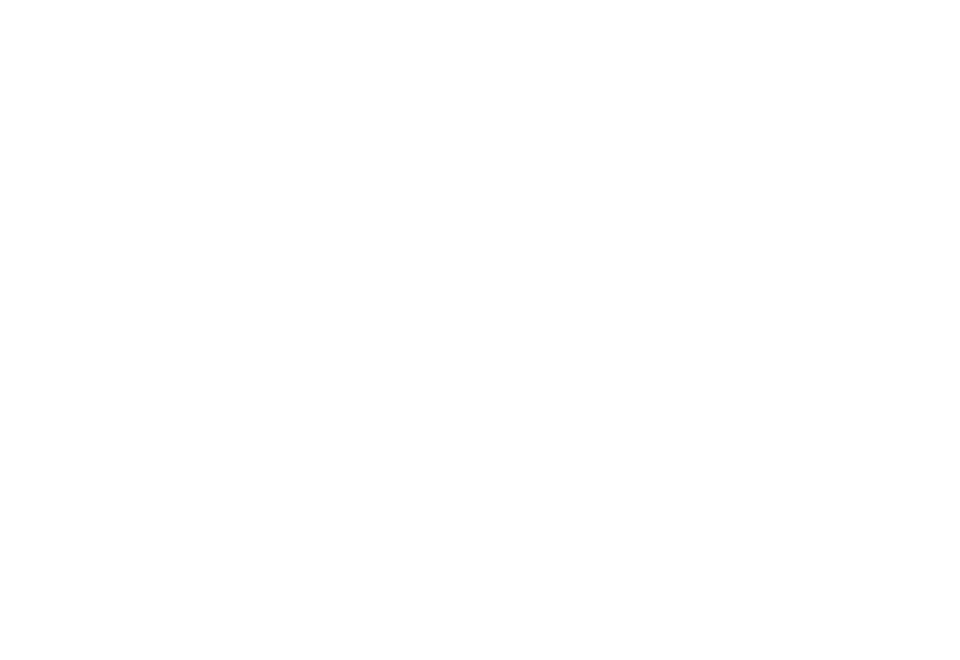

<IPython.core.display.Javascript object>


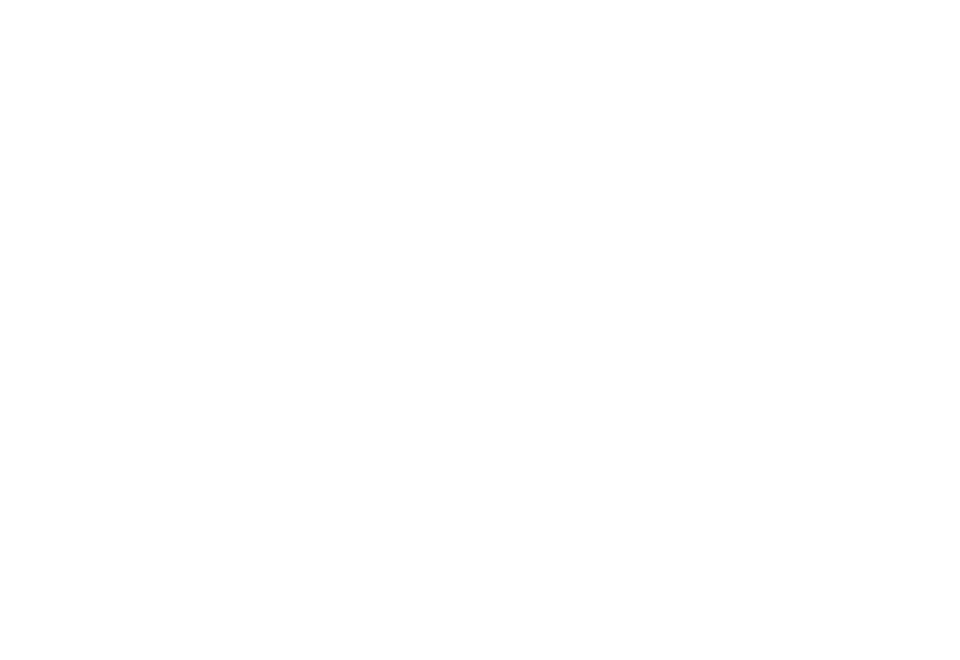

<IPython.core.display.Javascript object>


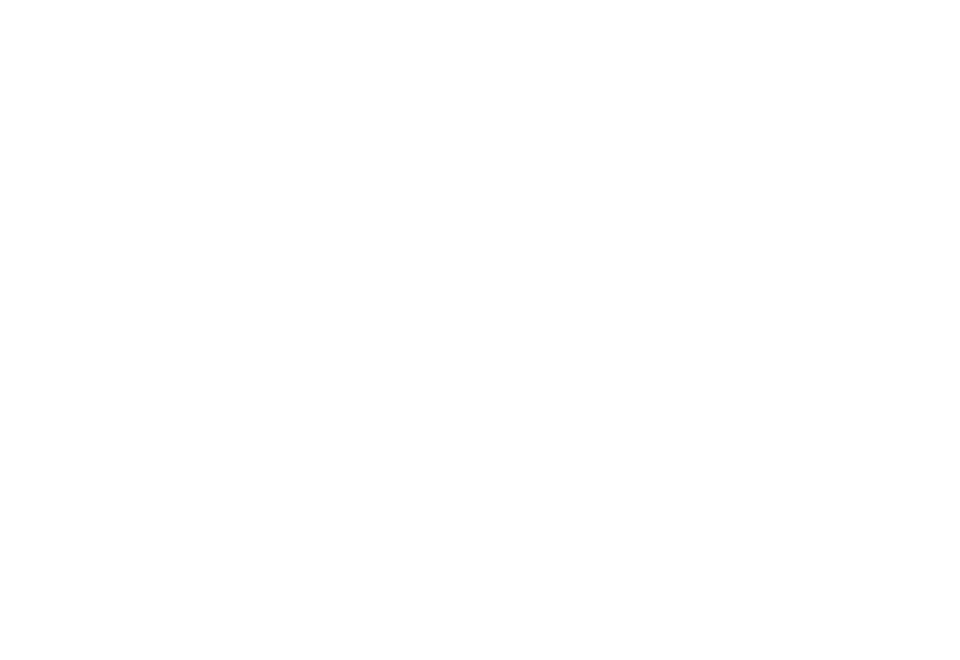

<IPython.core.display.Javascript object>


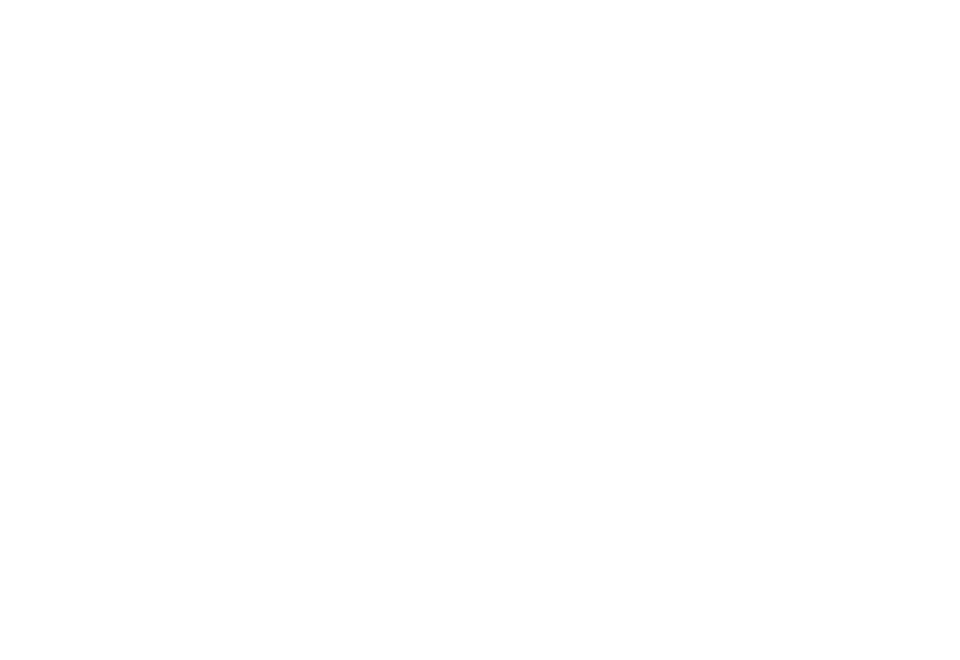

<IPython.core.display.Javascript object>


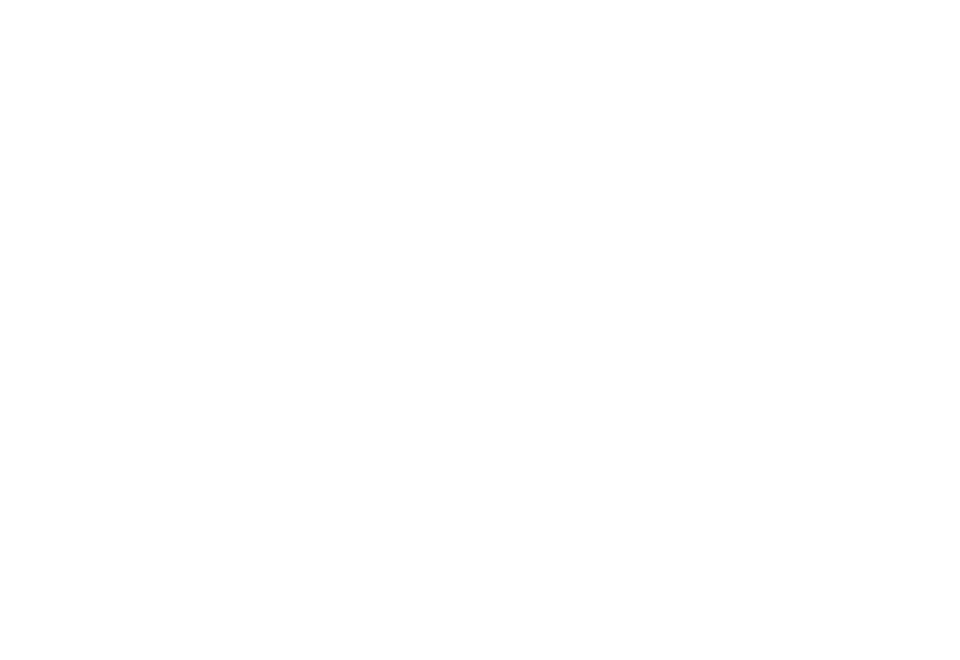

<IPython.core.display.Javascript object>


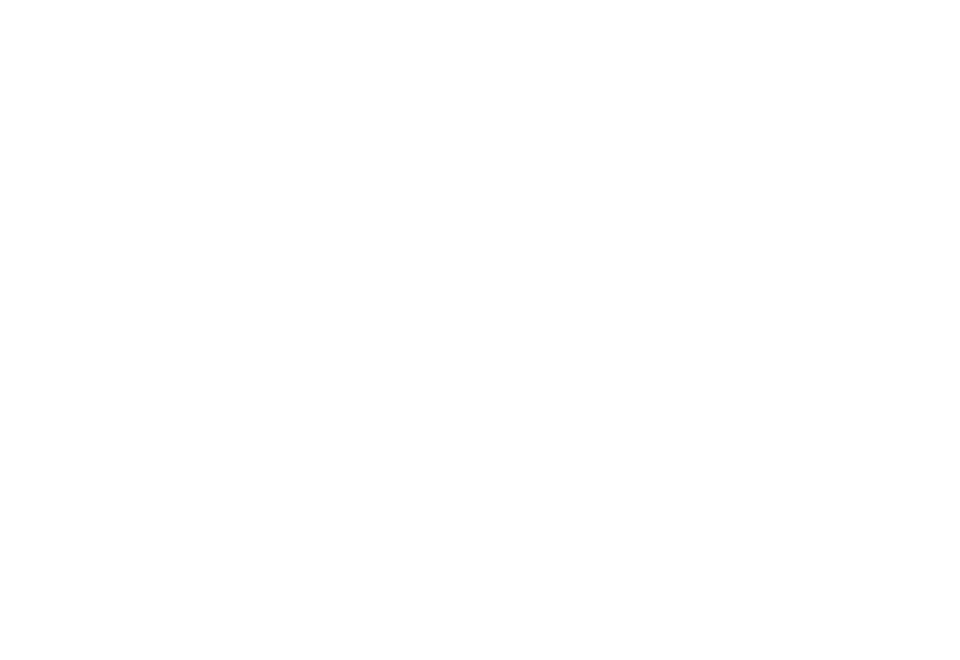

<IPython.core.display.Javascript object>


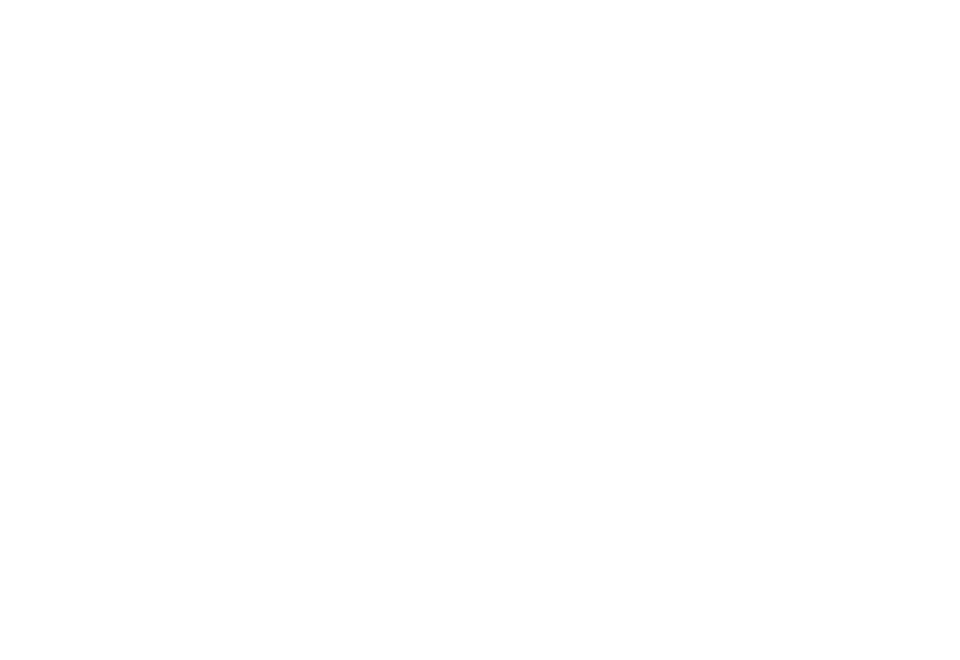

<IPython.core.display.Javascript object>


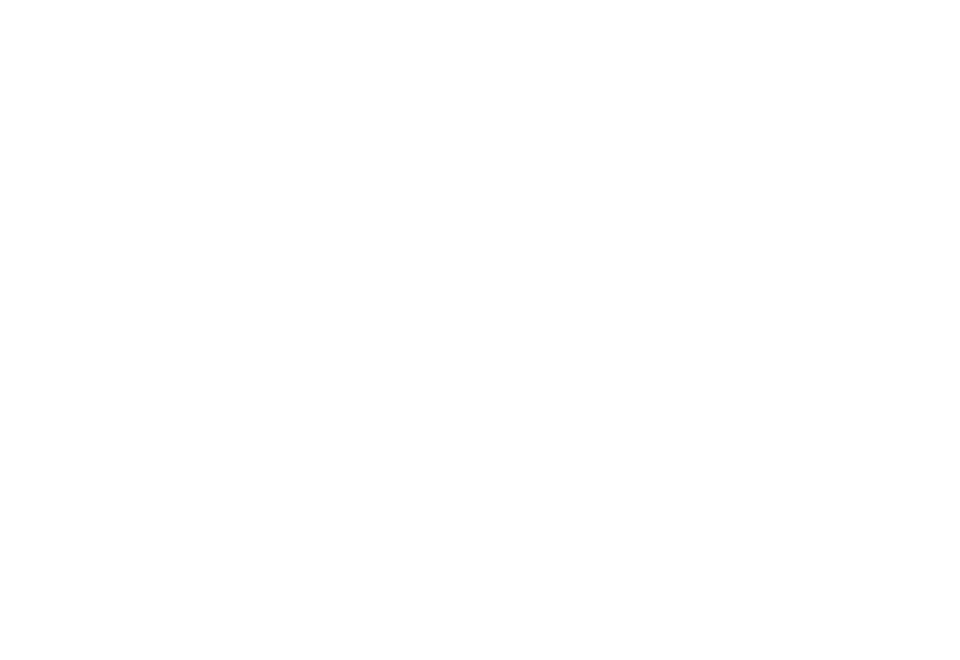

<IPython.core.display.Javascript object>


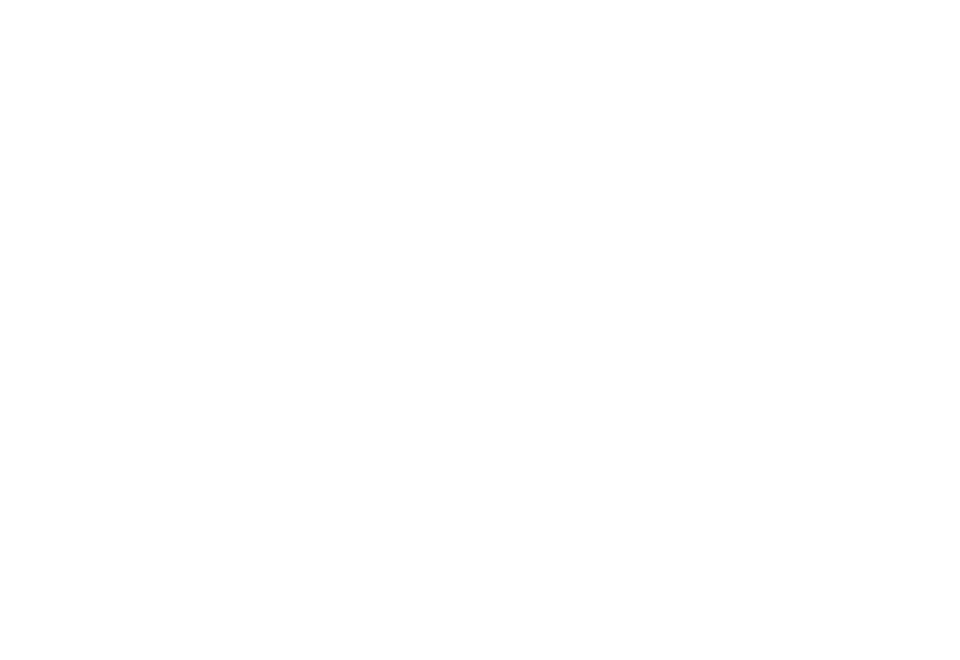

IndexError: index 12 is out of bounds for axis 0 with size 12

In [1310]:
ar_exp2_res, coeff_list2, _ = ar_exp2
for i, peak in enumerate(ar_exp2_res):
    if abs(len(ar_exp2_res) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(ar_exp2_res)-1), prec_lag=peak, path='AR and extension/noise', title=f'Baseline with different level {str(levels[i])}', show_level=True, savefig=True)
    else:
        plot_mci_pred_relation(cA=range(len(ar_exp2_res)), prec_lag=peak, path='AR and extension/noise', title=f'Baseline with different level {str(levels[i])}', show_level=True, savefig=True)

<IPython.core.display.Javascript object>


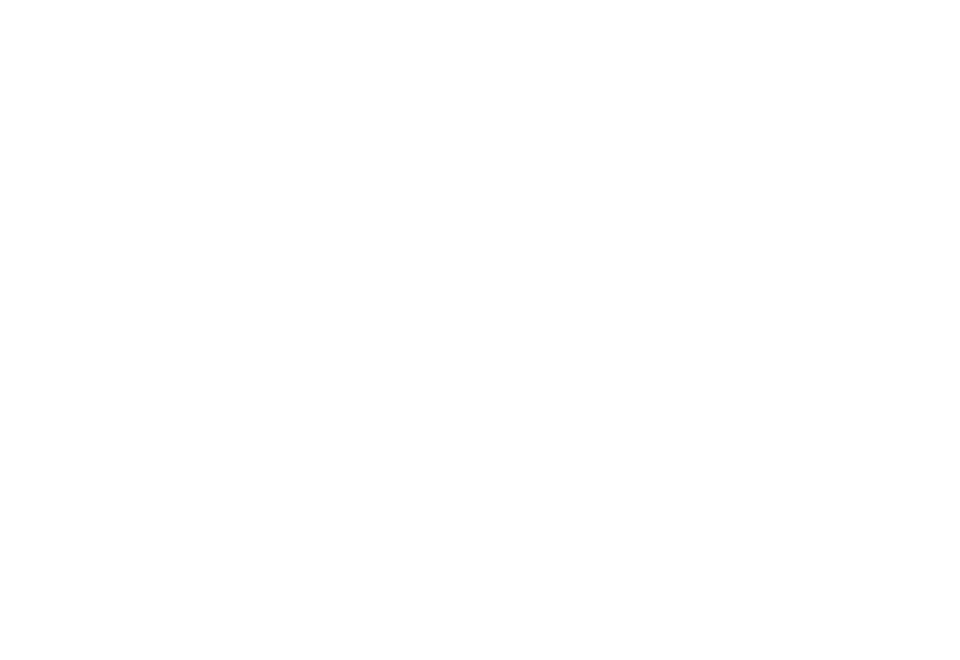

<IPython.core.display.Javascript object>


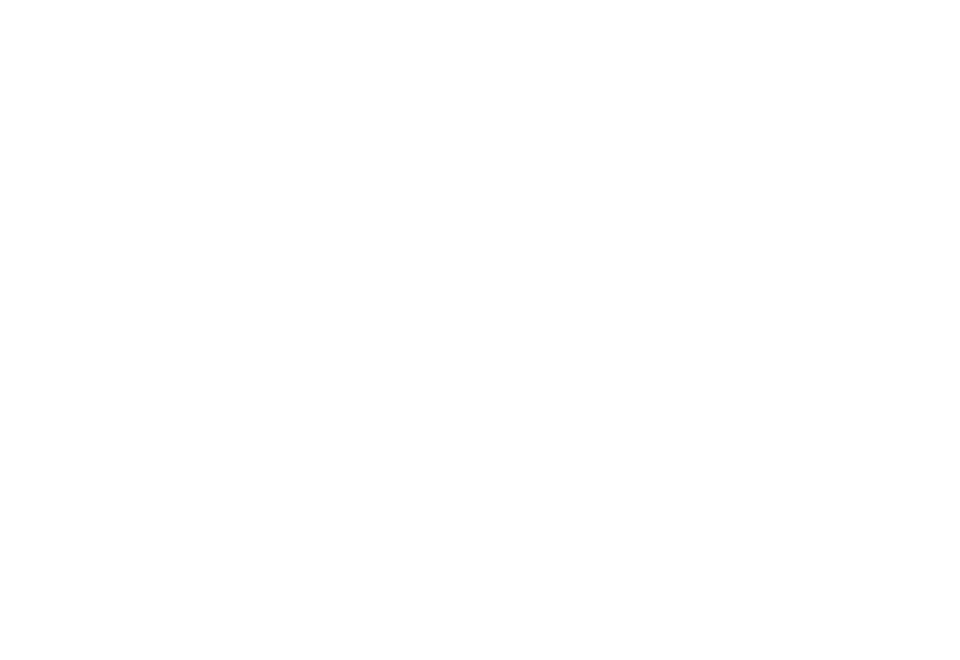

<IPython.core.display.Javascript object>


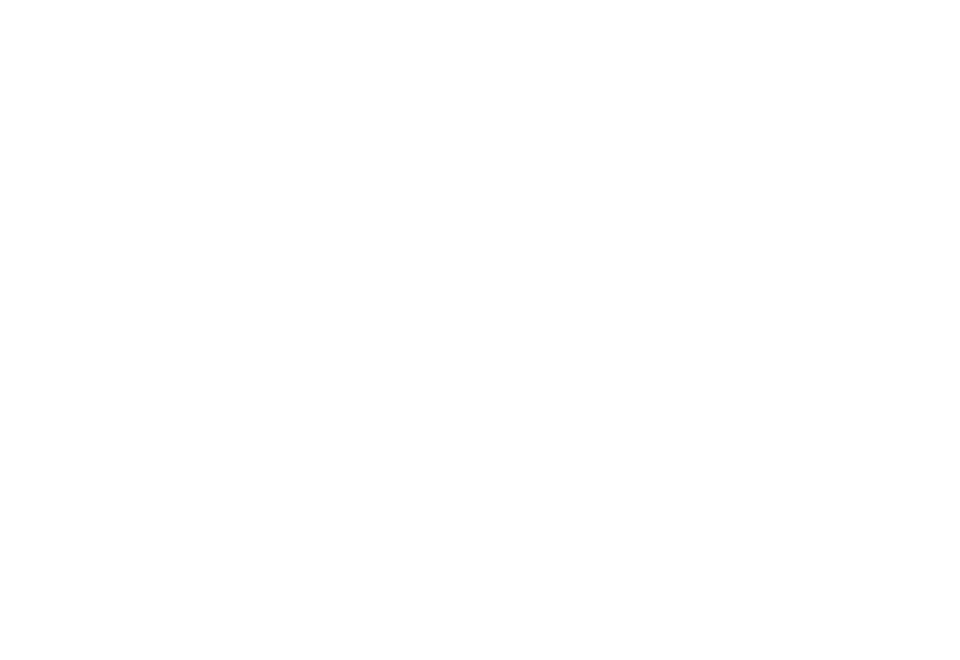

<IPython.core.display.Javascript object>


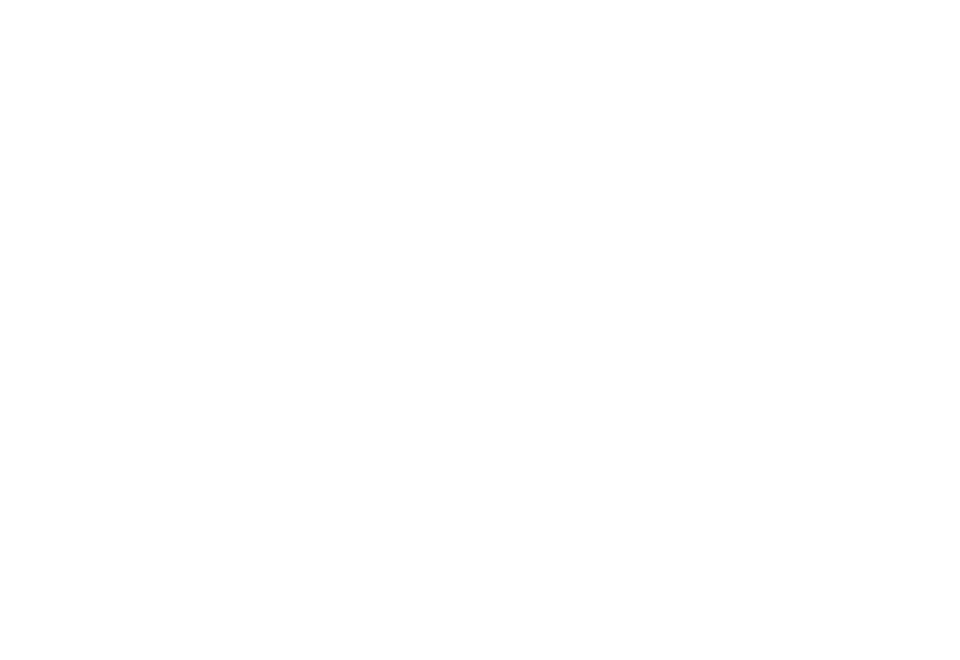

<IPython.core.display.Javascript object>


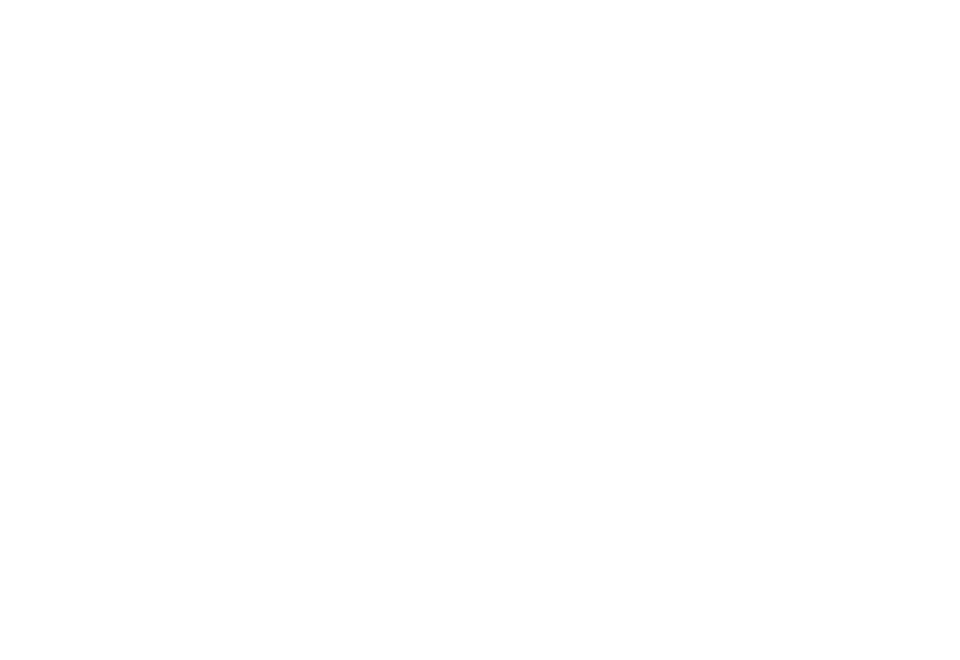

<IPython.core.display.Javascript object>


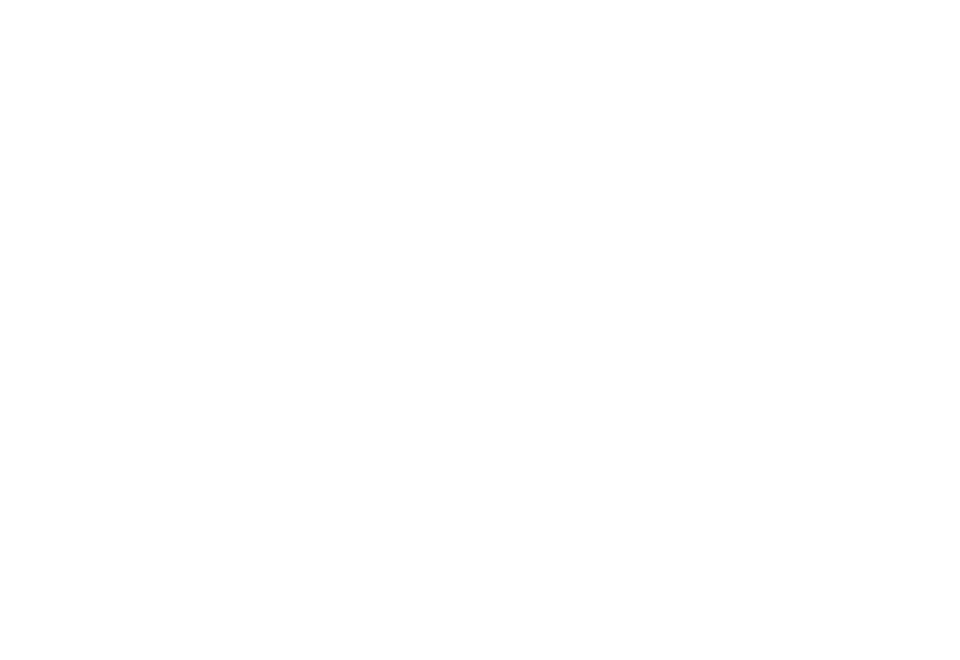

<IPython.core.display.Javascript object>


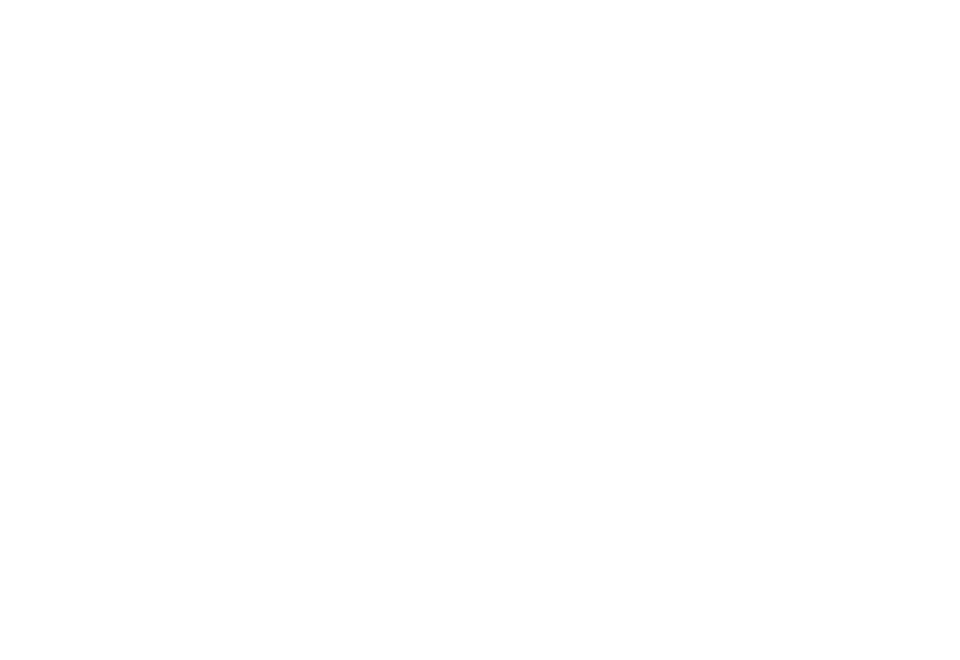

<IPython.core.display.Javascript object>


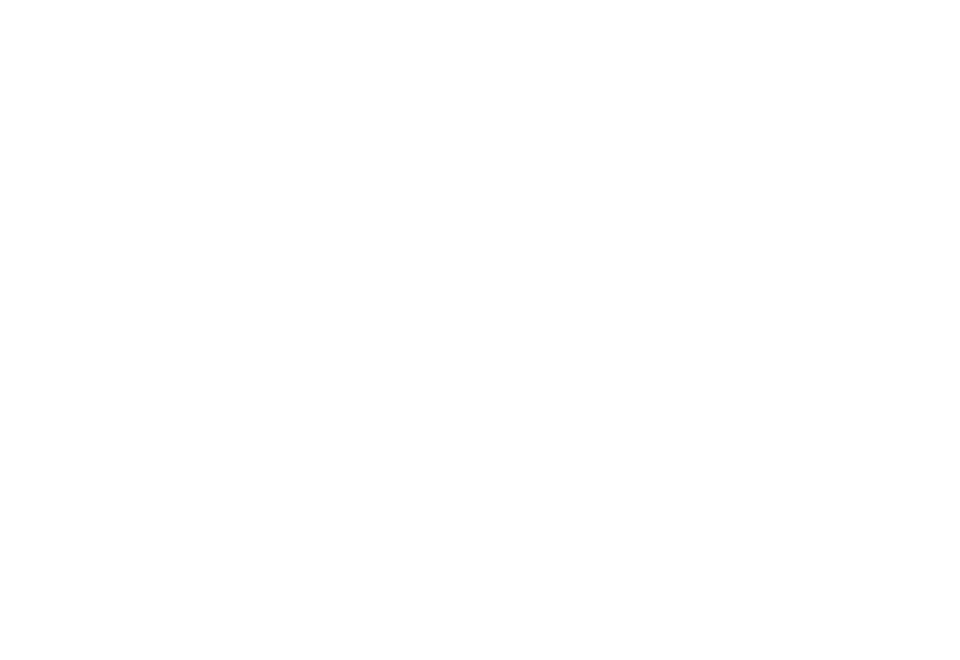

<IPython.core.display.Javascript object>


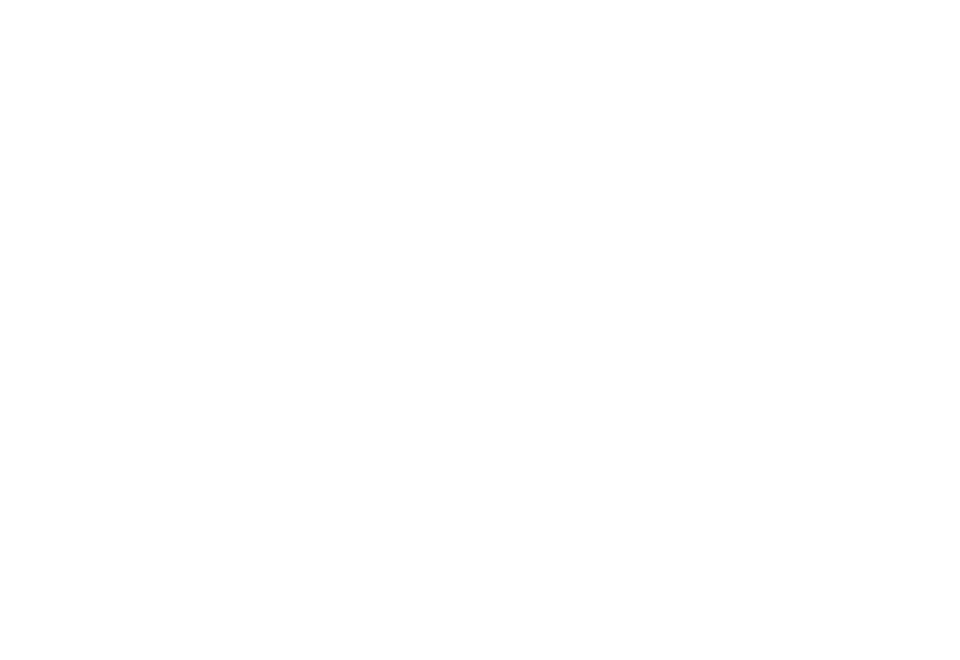

<IPython.core.display.Javascript object>


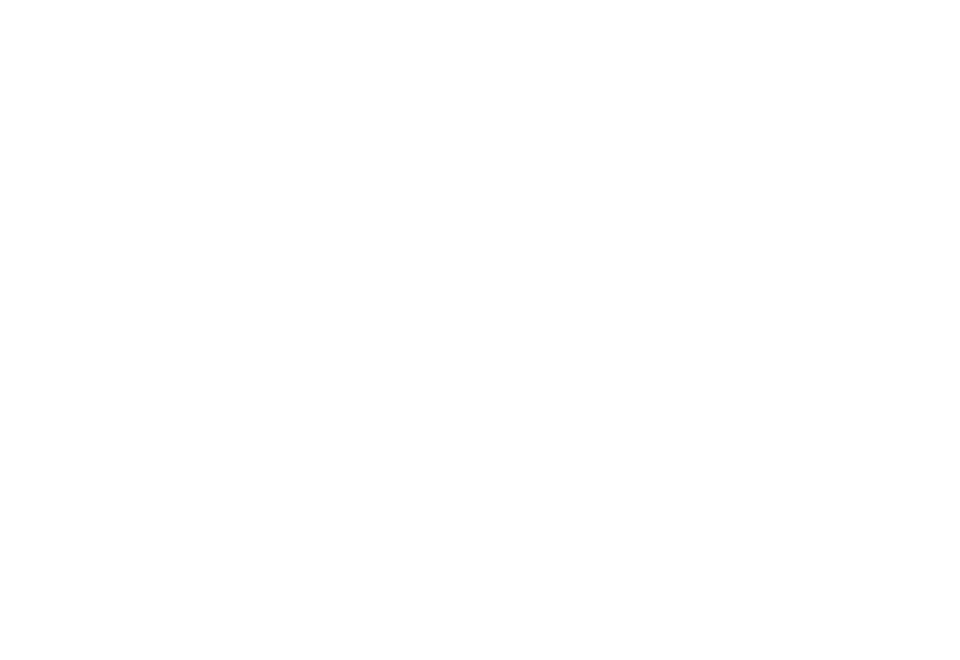

<IPython.core.display.Javascript object>


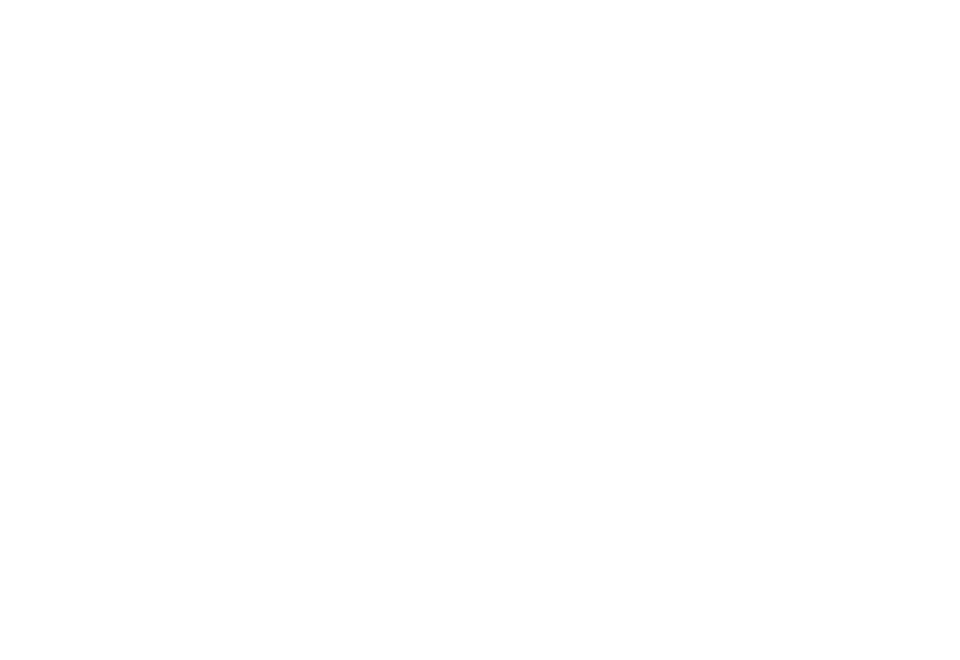

<IPython.core.display.Javascript object>


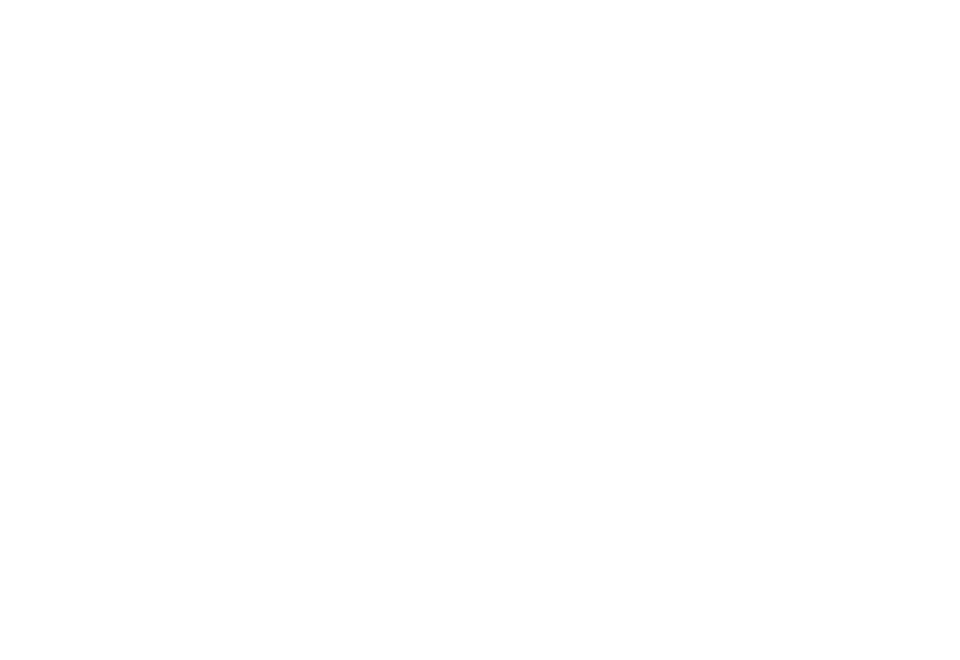

IndexError: index 12 is out of bounds for axis 0 with size 12

In [1311]:
ar_exp2_res_shift, coeff_list_shift2, _ = ar_exp2_shift
for i, peak in enumerate(ar_exp2_res_shift):
#     print(len(peak), len(ar_exp1_res_shift))
#     continue
    if abs(len(ar_exp2_res_shift) - len(peak)) >= 1:
        if abs(len(ar_exp2_res_shift) - len(peak)) == 1 :
            plot_mci_pred_relation(cA=range(len(ar_exp2_res_shift)-1), prec_lag=peak, path='AR and extension/noise/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)
        else:
            shift = abs(len(ar_exp2_res_shift) - len(peak))
            plot_mci_pred_relation(cA=range(len(ar_exp2_res_shift)-shift), prec_lag=peak, path='AR and extension/noise/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)
    else:
        plot_mci_pred_relation(cA=range(len(ar_exp2_res_shift)), prec_lag=peak, path='AR and extension/noise/shift', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=True)

### Calculate Signal to Noise ratio AR + wave

In [19]:
def mra_modwt(data, w, title, level, figsize=(8, 9), savefig=False):

    assert isinstance(w, wv.Wavelet)
    pad_width = get_pad_width(data)
    a = get_pad_data(data=data)
    temp =  wv.swt(a, w, level=level, trim_approx=True, norm=True) #[(cAn, (cDn, ...,cDn-1, cD1)]
    coeffs = [unpad_data(coeff, pad_width=pad_width) for _, coeff in enumerate(temp)]
    ylim = [data.min(), data.max()]

    fig, axes = plt.subplots(len(coeffs) + 1, figsize=figsize, dpi=120)
    fig.subplots_adjust(hspace=1.5)
    fig.suptitle(title)
    axes[0].plot(data.index, data.values,  label='Original signal')
    axes[0].set_ylabel(r'C$^{\circ}$')
#     axes[0].set_xlim(0, len(data) - 1)
#     axes[0].set_ylim(ylim[0], ylim[1])
    axes[0].legend(loc=0)


    for i, _ in enumerate(coeffs):
        ax = axes[-i - 1]
        if i == 0:
            ax.set_ylabel("A%d" % (len(coeffs) - 1))
            ax.plot(data.index, coeffs[i], 'r')

        else:
            ax.set_ylabel("D%d" % (len(coeffs) - i))
            ax.plot(data.index, coeffs[i], 'g')
        # Scale axes
#         ax.set_xlim(0, len(data) - 1)
#         ax.set_ylim(ylim[0], ylim[1])
# 
    plt.tight_layout()
    if savefig:
        plt.savefig('Report/Experiment/AR and extension/'+title+'.pdf', dpi=120)
        plt.savefig('Report/Experiment/AR and extension/'+title+'.png', dpi=120)
    plt.show()

In [30]:
mra_modwt(data=target_df, w=la8, title="MRA target", level=11, figsize=(8, 9), savefig=False)

<IPython.core.display.Javascript object>

IndexError: tuple index out of range

In [1327]:
prepro_ar_exp1

1900-01-02   -0.908592
1900-01-03   -1.839339
1900-01-04   -1.918721
1900-01-05    0.874605
1900-01-06    0.919584
                ...   
1913-09-06   -0.337866
1913-09-07    0.319563
1913-09-08   -0.254626
1913-09-09   -1.247238
1913-09-10   -1.960967
Freq: D, Name: 3ts, Length: 5000, dtype: float64

<IPython.core.display.Javascript object>


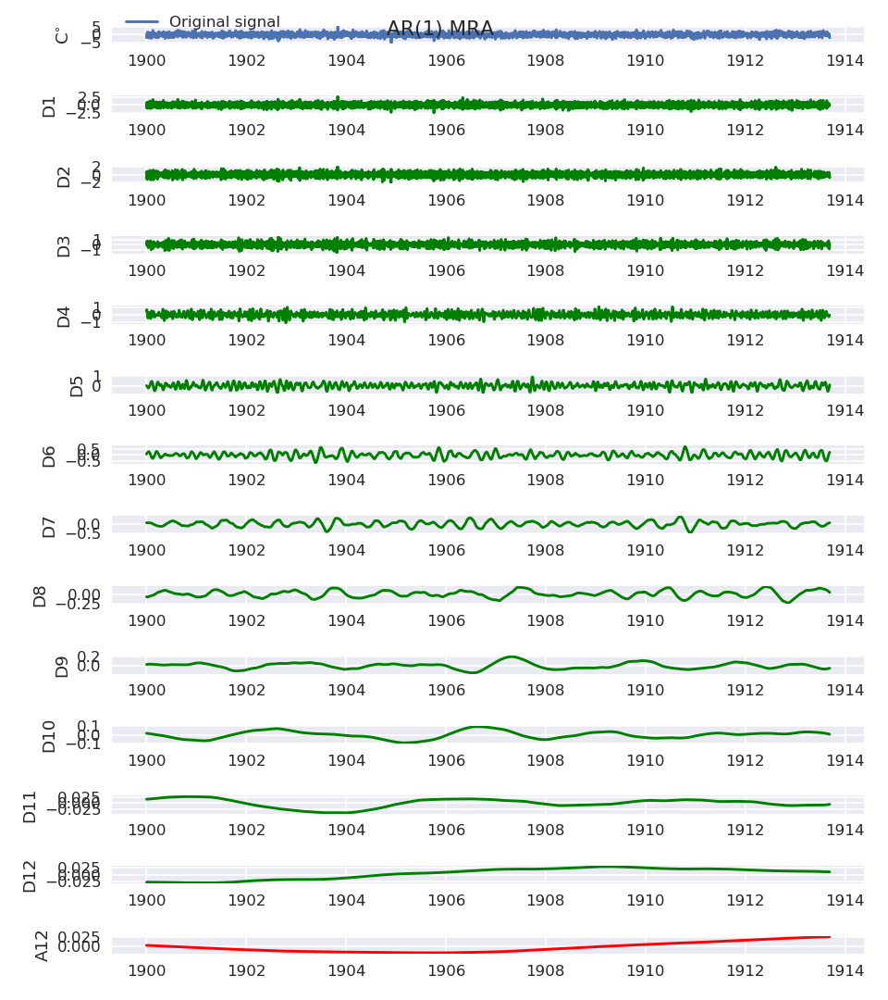

In [1326]:
rev2 = list(reversed(coeff_list2))
# plot_dwt_default(prepro_ar_exp2,w=la8, title='Test',mode=wv.Modes.periodic,level=appropriate_level2, method='modwt')
# plt.show()
mra_modwt(prepro_ar_exp1, w=la8, title='AR(1) MRA ', level=appropriate_level2-1, savefig=False)

In [138]:
res = []
# res2, res3 = [], []
for _, x in enumerate(rev2):
    y = prepro_ar_exp2
    x = sm.add_constant(x)
    temp = sm.OLS(y, x).fit()
    var = np.var(temp.resid)
    coeff = temp.params[1]
    const = temp.params[0]
    sn_weird =np.var(coeff*x+const)/(var)
    res.append(sn_weird)

<IPython.core.display.Javascript object>


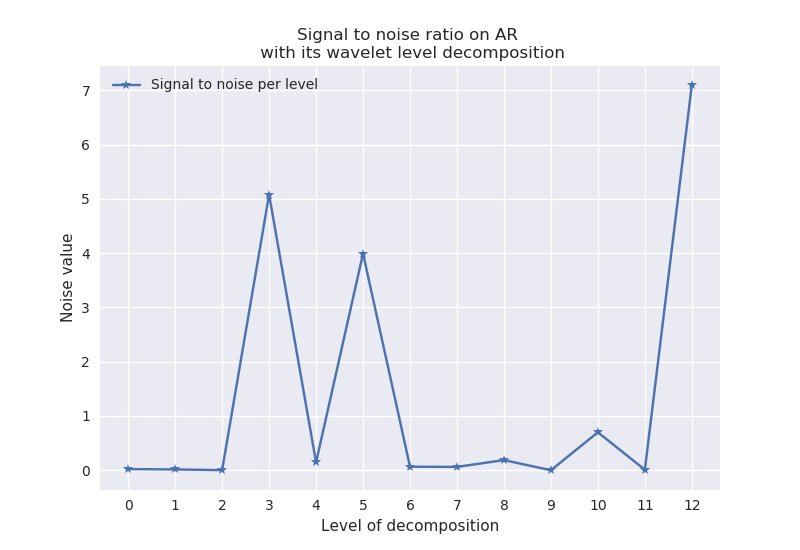

In [1033]:
%matplotlib notebook
# https://stats.stackexchange.com/questions/31158/how-to-simulate-signal-noise-ratio
# https://stats.stackexchange.com/questions/375423/estimate-signal-to-noise-ratios-by-regression
plt.plot(res, '-*', label='Signal to noise per level')

plt.legend(loc=0)
plt.xticks(range(len(rev2)))
plt.ylabel('Noise value')
plt.xlabel('Level of decomposition')
plt.title(f"Signal to noise ratio on AR \n with its wavelet level decomposition")
plt.savefig('Report/Experiment/AR and extension/SNR_AR_Noise_sineLA8.pdf', dpi=120)
plt.savefig('Report/Experiment/AR and extension/SNR_AR_Noise_sineLA8.png', dpi=120)
plt.show()

Variance of the signal = 0.9923591261359371 std dev =0.9961722371838804 
Sum of variance across all MODWT coefficients = 0.992359126137311 and Percival mra_var = 0.5171977318389003 sample good var = 0.9922379885486711  eta3 = [8192.5, 4096.0, 2047.75, 1023.625, 511.5625, 255.53125, 127.515625, 63.5078125, 31.50390625, 15.501953125, 7.5009765625, 3.50048828125] Diff-org-sample good var = 0.00012113758863996349

 Stdev details per level = [0.027071877979733778, 0.026235554118708926, 0.03993125373517621, 0.04054793307581271, 0.06357503774310509, 0.10645016717259605, 0.6368410983750163, 0.6813952266505089, 0.20814914975885526, 0.16631444054215078, 0.1341693843268059, 0.11421344628470047] and approximation = 0.020667261083902332


<IPython.core.display.Javascript object>


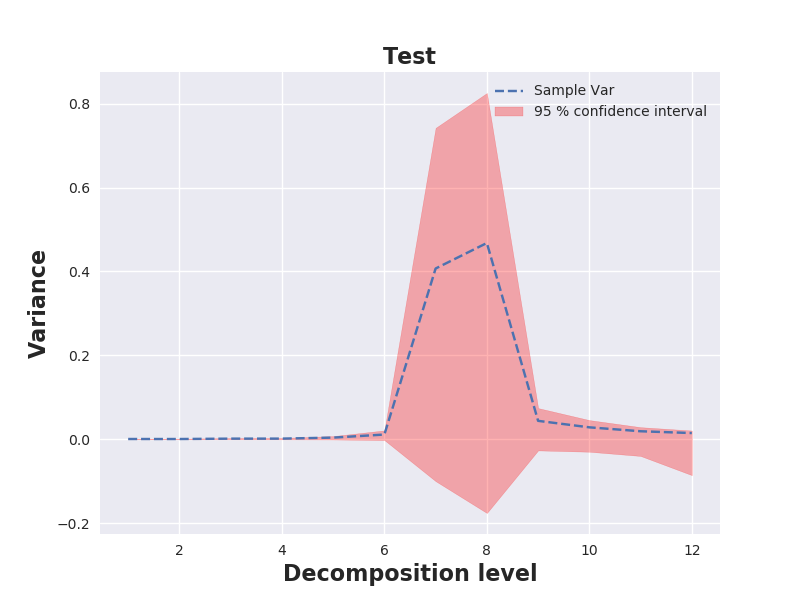

In [142]:
show_level_variance(prepro_ar_exp2, la8, appropriate_level2-1)


<IPython.core.display.Javascript object>


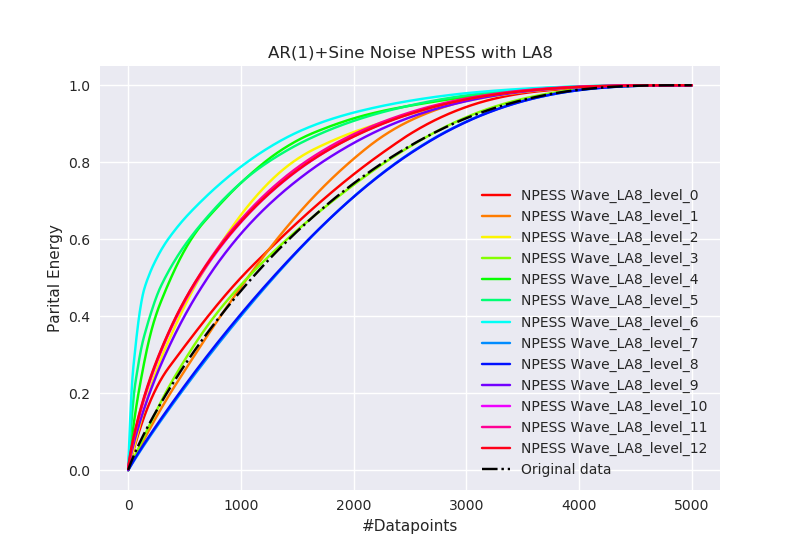

In [1325]:
%matplotlib notebook
nps_a2 = npess(prepro_ar_exp2)
coeffs_a2 = decompose_signal_modwt(prepro_ar_exp2,w=la8, mode='periodic', level=appropriate_level2-1, debug=False)
nps_coeff_a2 = np.array([npess(i) for i in coeffs_a2])
plot_npess(nps_a2,nps_coeff_a2, title='AR(1)+Sine Noise NPESS with LA8', wave_name='LA8', savefig=True)


<IPython.core.display.Javascript object>


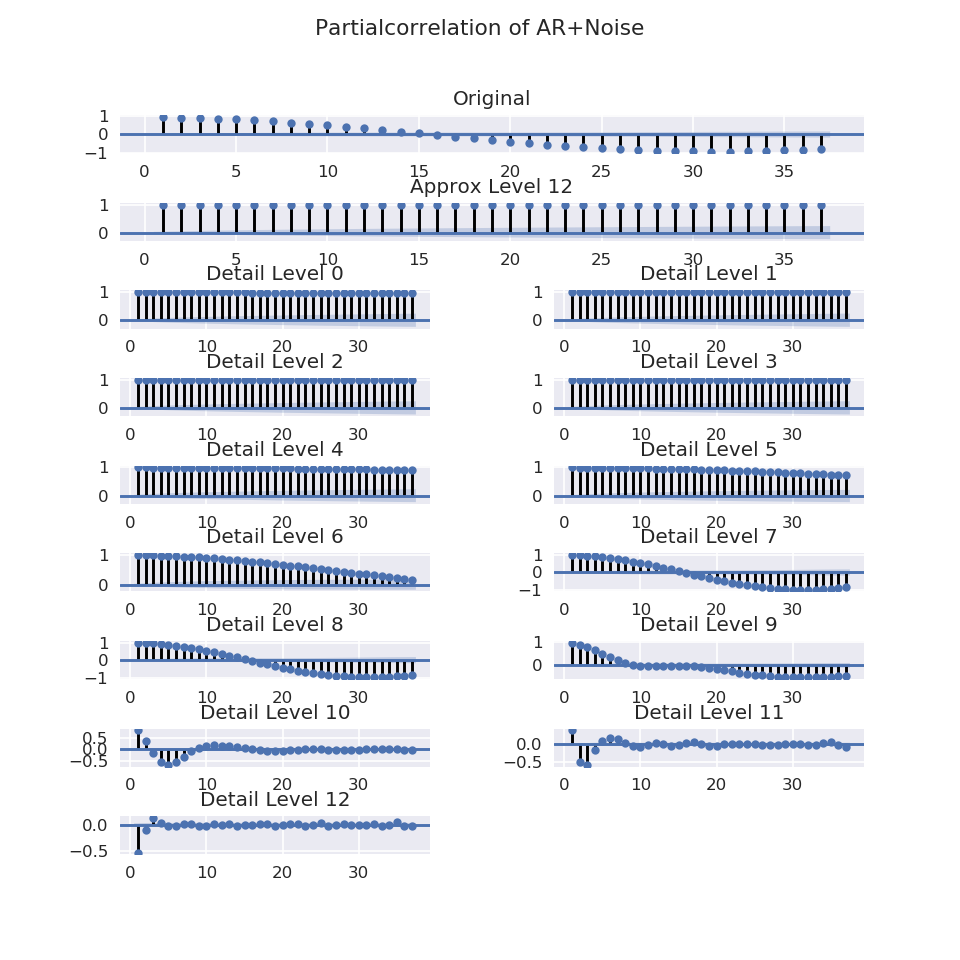

In [1235]:
show_auto_per_level(prepro_ar_exp2, coeffs_a2, title='Partialcorrelation of AR+Noise', method='autocorr', savefig=False)

In [141]:
rev3 = list(reversed(coeff_list_shift2))
resshift = []
# res2, res3 = [], []
for _, x in enumerate(rev3):
    y = prepro_ar_exp2
    x = sm.add_constant(x)
    temp = sm.OLS(y, x).fit()
    var = np.var(temp.resid)
    coeff = temp.params[1]
    const = temp.params[0]
    sn_weird =np.var(coeff*x+const)/(var)
    resshift.append(sn_weird)

<IPython.core.display.Javascript object>


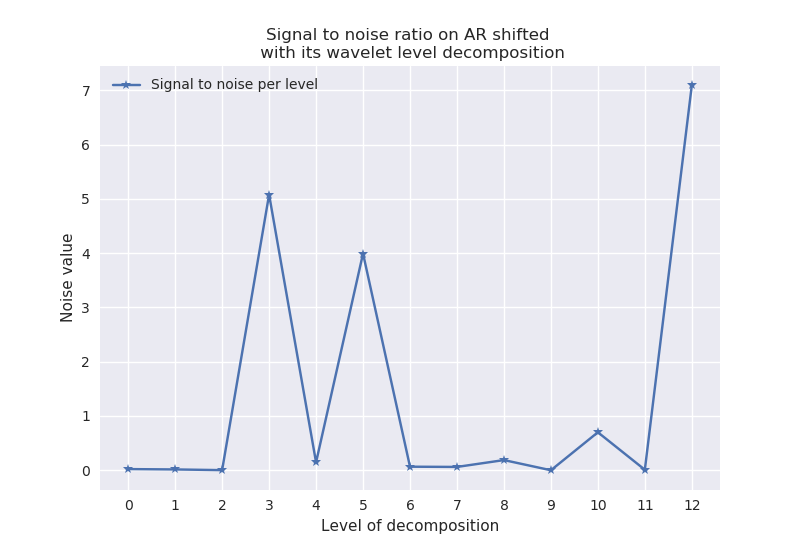

In [142]:
%matplotlib notebook
# https://stats.stackexchange.com/questions/31158/how-to-simulate-signal-noise-ratio
# https://stats.stackexchange.com/questions/375423/estimate-signal-to-noise-ratios-by-regression
plt.plot(resshift, '-*', label='Signal to noise per level')

plt.legend(loc=0)
plt.xticks(range(len(rev3)))
plt.ylabel('Noise value')
plt.xlabel('Level of decomposition')
plt.title(f"Signal to noise ratio on AR shifted \n with its wavelet level decomposition")
plt.show()

#### Investigate wavelet variance, spectrum and frequency per level decomposition

In [ ]:
# Mj = len(data) - 2**(i - 1) + 1
# result_var_level[i][0] = np.dot(details[i], details[i])/(Mj)
# result_var_level[i][1] = np.var(data)/(2*(2**(i-1)))

In [1221]:
res1, res2, res3 = [], [], []
for _, x in enumerate(rev2):
    res1.append(np.dot(x, x)/len(x))
    spectrum = fft(x)
    freq = fftfreq(len(spectrum))
    res2.append((freq, abs(spectrum)))
    res3.append(np.var(x, ddof=1))

In [1225]:
sine_freq  = [fftfreq(len(fft(sine))), abs(fft(sine))] 
temp_sine_noise_freq = [fftfreq(len(fft(temp_noise_sine))), abs(fft(temp_noise_sine))]


<IPython.core.display.Javascript object>


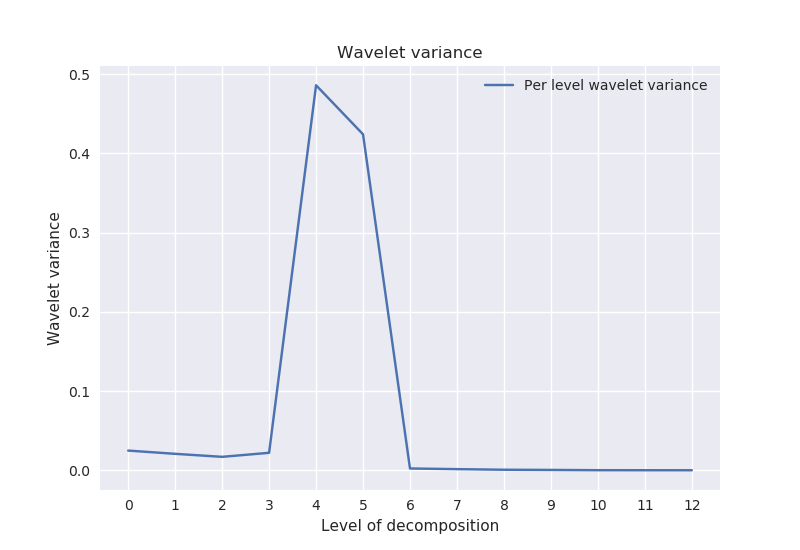

In [144]:
%matplotlib notebook
plt.plot(res1, label='Per level wavelet variance')
plt.legend(loc=0)
plt.xticks(range(len(rev)))
plt.ylabel('Wavelet variance')
plt.xlabel('Level of decomposition')
plt.title(f"Wavelet variance")
plt.show()

<IPython.core.display.Javascript object>


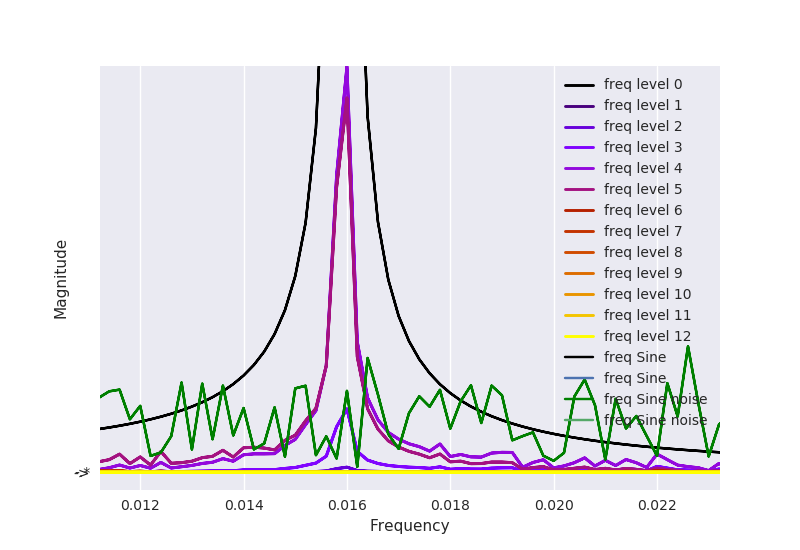

0 True
1 True
2 True
3 True
4 True
5 True
6 True
7 True
8 True
9 True
10 True
11 True
12 True


In [1234]:
%matplotlib notebook
cmap = plt.get_cmap('gnuplot')
my_colors= [cmap(i) for i in np.linspace(0,1 , len(rev2))]
for i,_ in enumerate(rev2):
    plt.plot(abs(res2[i][0]),res2[i][1] ,color=my_colors[i], label=f"freq level {str(i)}", linewidth=2.1)
    print(i, np.allclose(res2[i][0], sine_freq[0]))
    
plt.plot(abs(sine_freq[0]), sine_freq[1],'k', '->', label=f'freq Sine')
plt.plot(abs(temp_sine_noise_freq[0]), temp_sine_noise_freq[1],'g', '-.*', label=f'freq Sine noise')
plt.xlabel("Frequency")
# plt.xticks(ticks, ticks)
plt.legend(loc=0)
plt.ylabel("Magnitude")
plt.show()

<IPython.core.display.Javascript object>


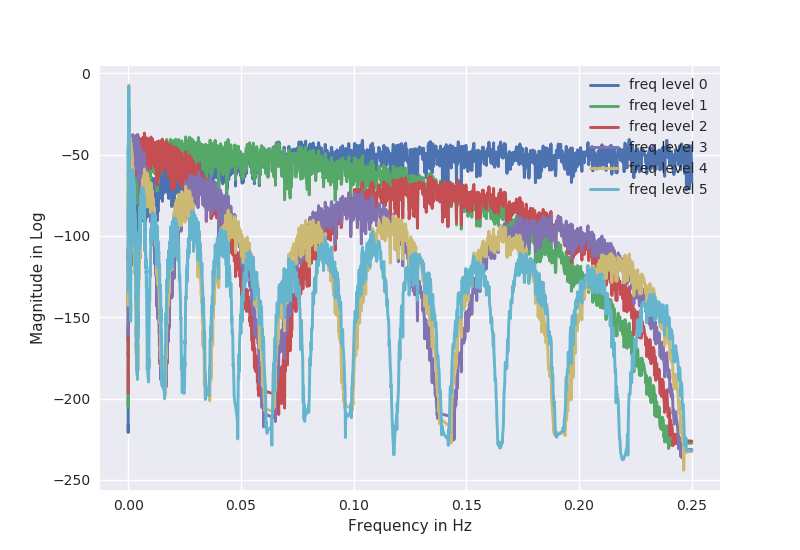

In [146]:
%matplotlib notebook
for i,signal in enumerate(rev2[:-7]):
    plt.magnitude_spectrum(signal, abs(res2[i][0]) ,scale='dB', label=f"freq level {str(i)}", linewidth=2.1)
    plt.legend(loc=0)
plt.xlabel("Frequency in Hz")
plt.ylabel("Magnitude in Log")
plt.show()

<IPython.core.display.Javascript object>


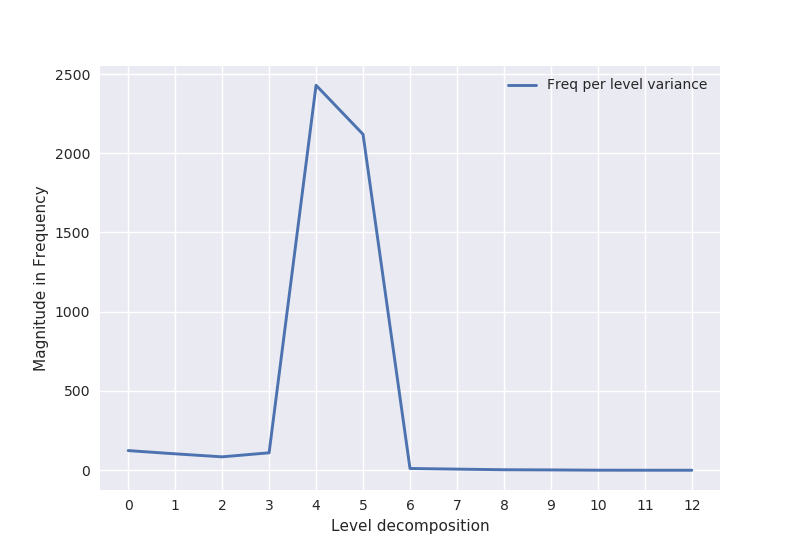

In [147]:
%matplotlib notebook
res4 = []
for i,_ in enumerate(rev2):
    res4.append(np.dot(res2[i][1],res2[i][1])/len(rev[i]) - np.exp2(np.mean(prepro_ar_exp2)))
plt.plot(res4, label=f"Freq per level variance", linewidth=2.1)
plt.legend(loc=0)
plt.xticks(range(len(rev2)))
plt.xlabel("Level decomposition")
plt.ylabel("Magnitude in Frequency")
plt.show()

<IPython.core.display.Javascript object>


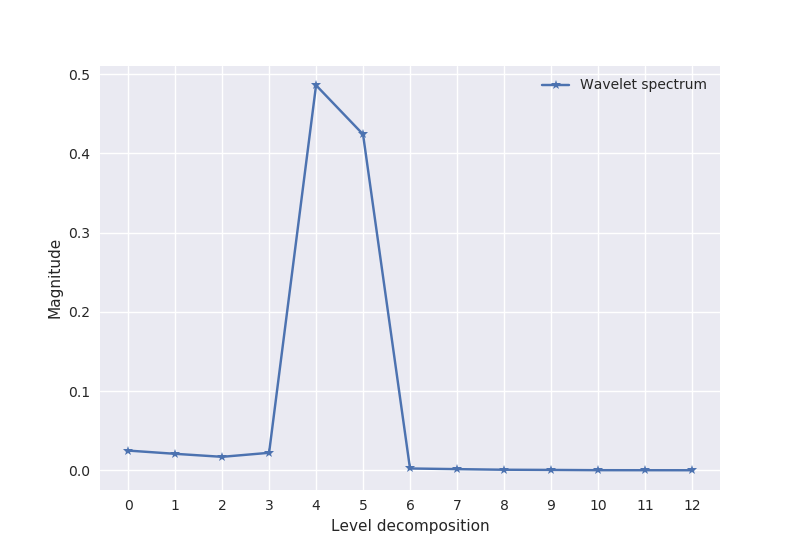

In [148]:
%matplotlib notebook
plt.plot(res3,'-*', label='Wavelet spectrum')
plt.legend(loc=0)
plt.xticks(range(len(rev)))
plt.xlabel("Level decomposition")
plt.ylabel("Magnitude")
plt.show()

<IPython.core.display.Javascript object>


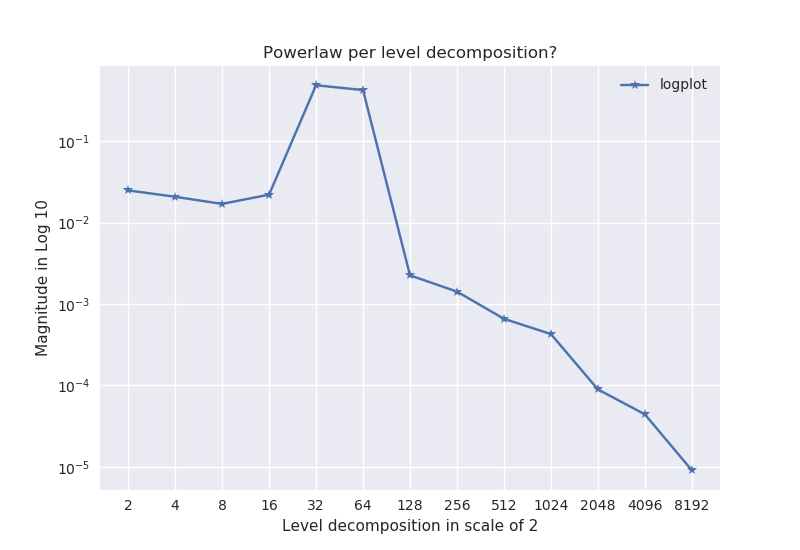

In [149]:
%matplotlib notebook
plt.semilogy(res3,'-*', label='logplot')
plt.legend(loc=0)
plt.xticks(range(len(rev2)), [2**i for i in range(1, len(rev)+1)])
# plt.xscale('log', basex=2)
plt.title("Powerlaw per level decomposition?")
plt.xlabel("Level decomposition in scale of 2")
plt.ylabel("Magnitude in Log 10")
plt.show()

# Experiment with VAR process

## VAR clean process

In [163]:
from statsmodels.tsa.varma_process import vargenerate

In [164]:
help(vargenerate)

Help on function vargenerate in module statsmodels.tsa.varma_process:

vargenerate(ar, u, initvalues=None)
    generate an VAR process with errors u
    
    similar to gauss
    uses loop
    
    Parameters
    ----------
    ar : array (nlags,nvars,nvars)
        matrix lagpolynomial
    u : array (nobs,nvars)
        exogenous variable, error term for VAR
    
    Returns
    -------
    sar : array (1+nobs,nvars)
        sample of var process, inverse filtered u
        does not trim initial condition y_0 = 0
    
    Examples
    --------
    # generate random sample of VAR
    nobs, nvars = 10, 2
    u = numpy.random.randn(nobs,nvars)
    a21 = np.array([[[ 1. ,  0. ],
                     [ 0. ,  1. ]],
    
                    [[-0.8,  0. ],
                     [ 0.,  -0.6]]])
    vargenerate(a21,u)
    
    # Impulse Response to an initial shock to the first variable
    imp = np.zeros((nobs, nvars))
    imp[0,0] = 1
    vargenerate(a21,imp)



In [165]:
nobs, nvars = 10, 2
u = np.random.randn(nobs,nvars)
a21 = np.array([[[ 1. ,  0. ],
                     [ 0. ,  1. ]],
    
                    [[-0.8,  0. ],
                     [ 0.,  -0.8]]])
vargenerate(a21, u)

array([[ 0.        ,  0.        ],
       [ 0.46246879, -0.30527386],
       [-0.32272635,  0.53194514],
       [ 0.32743395,  1.46923049],
       [-0.70100266,  0.61054436],
       [-2.74118893,  1.04305299],
       [-2.06577665,  1.56497154],
       [ 0.14405214,  1.22199622],
       [-0.65450598,  1.80837411],
       [-1.53379369,  0.07664074],
       [-1.63592593, -0.83500804]])

# Ensembles

## AR vanilla

In [827]:
def run_ar_experiments(synthetic=synthetic, rg= rg_exp, target_col=target_col, runs=3, method='vanilla', var_gauss=False):
    
    ar_sampling = []
    needed = []
    dates  = pd.date_range(start=synthetic['startyear'], periods=synthetic['nobs'], freq='D')
    
    for ar in range(runs):

        
        synthetic['ARrange']= np.random.random()
        synthetic['arparams'] = np.r_[1, -synthetic['ARrange']]
        y_ = arma_generate_sample(synthetic['arparams'],synthetic['maparams'], synthetic['nobs'])
        arma_process = ArmaProcess(ar=synthetic['arparams'], ma=synthetic['maparams'], nobs=synthetic['nobs'])
        
        if not (arma_process.isstationary and arma_process.isinvertible): 
            print('Skip')
            continue
        else:
            y_ = pd.Series(y_, index=dates)
            
        ar_df1 = pd.DataFrame(data=y_)
        idx_ar_datetime = ar_df1.index
        
        ar_df_1 = pd.DataFrame(data=y_.values, index=pd.MultiIndex.from_product(([0], idx_ar_datetime)), columns=[target_col])
        prepro_ar_exp1 = preprocess_ts(serie=ar_df_1, to_serie=True, col=target_col)
        
        appropriate_level1 = get_pad_level(prepro_ar_exp1)
        levels = np.arange(0, appropriate_level1, 1)
        
        ar_sampling.append((prepro_ar_exp1, ar_df_1))
        needed.append((levels,idx_ar_datetime))
    print('Populate AR samples done')
    res_ar = []

    if method =="noise":
        assert runs  == 10 or runs == 100, "Think of the time set the runs to ten or hundred if everything goes faster"
    for it in range(runs):
        if method == 'vanilla':
            ar_exp1 = run_experiment_levels(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1], 
                                            peak_test=True,total_levels=needed[it][0])
            ar_exp1_res, coeff_list, _ = ar_exp1
            res_ar.append((ar_exp1_res,coeff_list))
        elif method == 'lag':
            ar_exp1_shift = run_experiment_levels_full_lag(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1], 
                                            peak_test=True,total_levels=needed[it][0])
            ar_exp1_res_shift, coeff_list_shift, _ = ar_exp1_shift
            res_ar.append((ar_exp1_res,coeff_list_shift))
        elif method == 'noise':
            if var_gauss:
                ar_noise_eps  = run_experiment_levels_noise(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1],  
                                total_levels=needed[it][0], iterations=iteration, var_gauss=var_gauss)
                res_ar.append(ar_noise_eps)
            else:
                ar_noise_gamma  = run_experiment_levels_noise(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1],  
                            total_levels=needed[it][0], iterations=iteration, var_gauss=var_gauss)
                res_ar.append(ar_noise_gamma)
                
            
    print('Evaluating AR done')

    return res_ar

In [831]:
res_ar_vanilla = run_ar_experiments(runs=10)


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  0.8728213973084721  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS True

[INFO] Time serie is non-gaussian, tranforming the time serie to gaussian like approximation
[INFO] Gaussian approximation with PT p-value 0.8920316278716196 or QT 0.04382140896873668
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is stationary
[INFO] Transformed time serie is stationair ADF True,  KPSS True


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  0.516638893901942  
[INFO] Result ADF: The serie is stationary
[INFO] Result KPSS: The mean of the serie is NOT stationary
[INFO] Transformed time serie staionarity test ADF True,  KPSS False

[INFO

/home/jier/miniconda3/envs/RGCPD/lib/python3.7/site-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


Progress causal inference - traintest set 100%
[INFO] Extracting level 0

[INFO] Extracting level 1

[INFO] Extracting level 2

[INFO] Extracting level 3

[INFO] Extracting level 4

[INFO] Extracting level 5

[INFO] Extracting level 6

[INFO] Extracting level 7

[INFO] Extracting level 8

[INFO] Extracting level 9

[INFO] Extracting level 10

[INFO] Extracting level 11

[INFO] Extracting level 12
Progress causal inference - traintest set 100%
[INFO] Extracting level 0

[INFO] Extracting level 1

[INFO] Extracting level 2

[INFO] Extracting level 3

[INFO] Extracting level 4

[INFO] Extracting level 5

[INFO] Extracting level 6

[INFO] Extracting level 7

[INFO] Extracting level 8

[INFO] Extracting level 9

[INFO] Extracting level 10

[INFO] Extracting level 11

[INFO] Extracting level 12
Progress causal inference - traintest set 100%
[INFO] Extracting level 0

[INFO] Extracting level 1

[INFO] Extracting level 2

[INFO] Extracting level 3

[INFO] Extracting level 4

[INFO] Extracting 

In [ ]:
res_ar_lag = run_ar_experiments(runs=10, method='lag')

In [ ]:
res_ar_noise_eps= run_ar_experiments(runs=10, method='noise', var_gauss=True)

In [ ]:
res_ar_noise_gamma = run_ar_experiments(runs=10, method='noise')

In [828]:
def run_ar_experiments_signal(synthetic=synthetic, rg= rg_exp, target_col=target_col, runs=3, method='vanilla', 
                              var_gauss=False, innovation=False, omega=0.1):
    
    ar_sampling = []
    needed = []
    dates  = pd.date_range(start=synthetic['startyear'], periods=synthetic['nobs'], freq='D')
    sine = generate_wave(5, omega, synthetic['nobs'])
    cos = generate_wave(5, omega, synthetic['nobs'], wave_sign='cos')


    temp = sine.reshape(len(sine), 1)
    noise_sine = temp[:,0]*np.random.randn(len(sine))
    for ar in range(runs):

        
        synthetic['ARrange']= np.random.random()
        synthetic['arparams'] = np.r_[1, -synthetic['ARrange']]
        y_ = arma_generate_sample(synthetic['arparams'],synthetic['maparams'], synthetic['nobs'])
        arma_process = ArmaProcess(ar=synthetic['arparams'], ma=synthetic['maparams'], nobs=synthetic['nobs'])
        
        if not (arma_process.isstationary and arma_process.isinvertible): 
            print('Skip')
            continue
        else:
            if not innovation:
                y_ = pd.Series(y_, index=dates) + sine
            else:
                y_ = pd.Series(y_, index=dates) + noise_sine
        ar_df1 = pd.DataFrame(data=y_)
        idx_ar_datetime = ar_df1.index
        
        ar_df_1 = pd.DataFrame(data=y_.values, index=pd.MultiIndex.from_product(([0], idx_ar_datetime)), columns=[target_col])
        prepro_ar_exp1 = preprocess_ts(serie=ar_df_1, to_serie=True, col=target_col)
        
        appropriate_level1 = get_pad_level(prepro_ar_exp1)
        levels = np.arange(0, appropriate_level1, 1)
        
        ar_sampling.append((prepro_ar_exp1, ar_df_1))
        needed.append((levels,idx_ar_datetime))
    print('Populate AR samples done')
    res_ar = []

    if method =="noise":
        assert runs  == 10 or runs == 100, "Think of the time set the runs to ten or hundred if everything goes faster"
    for it in range(runs):
        if method == 'vanilla':
            ar_exp1 = run_experiment_levels(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1], 
                                            peak_test=True,total_levels=needed[it][0])
            ar_exp1_res, coeff_list, _ = ar_exp1
            res_ar.append((ar_exp1_res,coeff_list))
        elif method == 'lag':
            ar_exp1_shift = run_experiment_levels_full_lag(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1], 
                                            peak_test=True,total_levels=needed[it][0])
            ar_exp1_res_shift, coeff_list_shift, _ = ar_exp1_shift
            res_ar.append((ar_exp1_res,coeff_list_shift))
        elif method == 'noise':
            if var_gauss:
                ar_noise_eps  = run_experiment_levels_noise(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1],  
                                total_levels=needed[it][0], iterations=iteration, var_gauss=var_gauss)
                res_ar.append(ar_noise_eps)
            else:
                ar_noise_gamma  = run_experiment_levels_noise(ar_sampling[it][0], ar_sampling[it][1],rg,needed[it][1],  
                            total_levels=needed[it][0], iterations=iteration, var_gauss=var_gauss)
                res_ar.append(ar_noise_gamma)
                
            
    print('Evaluating AR done')

    return res_ar

In [ ]:
res_ar_vanilla = run_ar_experiments(runs=1000)

In [ ]:
res_ar_lag = run_ar_experiments(runs=1000, method='lag')